In [3]:
import json
import pickle as pkl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from sklearn.metrics import confusion_matrix
import medmnist
from medmnist import INFO
from IPython.display import clear_output

In [4]:
def flatten(l):
  return [item for sublist in l for item in sublist]

In [5]:

class ServerInformation:
  def __init__(self, server):
    self.config = server.config
    self.num_epochs = server.config["global_epochs"]
    self.local_accuracies = {
        client.id: client.data_frame.Accuracy.tolist() for client in server.clients
    }
    # {
    #     1 : [0.1, 0.2, ...]
    # }
    self.local_sensitivities = {
        client.id: client.data_frame.Sensitivity.tolist() for client in server.clients
    }
    self.local_specificities = {
        client.id: client.data_frame.Specificity.tolist() for client in server.clients
    }
    self.local_f1_scores = {
        client.id: client.data_frame.F1Score.tolist() for client in server.clients
    }

    self.clients_average_losses = {
        client.id: client.data_frame.Loss.tolist() for client in server.clients
    }
    self.trained = server.trained
    self.val_losses = {
        client.id: client.data_frame.ValLoss.tolist() for client in server.clients
    }
    # print(server.global_results_dict)
    self.global_accuracies = [[client['accuracy'] for client in group.values()] for group in server.global_results_dict.values()]
    self.global_specifcities = [[np.mean(client['specificity']) for client in group.values()] for group in server.global_results_dict.values()]
    self.global_sensitivities = [[np.mean(client['sensitivity']) for client in group.values()] for group in server.global_results_dict.values()]
    self.global_f1_scores = [[np.mean(client['f1_score']) for client in group.values()] for group in server.global_results_dict.values()]
    
    self.local_confusion_matrix = confusion_matrix(
        np.array(flatten([flatten(client.y) for client in server.clients])).flatten(), np.array(flatten([flatten(client.preds) for client in server.clients])).flatten()
    )
    
    # try:
    #   self.global_metrics = server.global_metrics
    # except AttributeError:
    #   self.global_metrics = {}
    #   for client in server.clients:
    #     true, pred = server.test_model_on_global_test_data(client.model)
    #     accuracy, specificity, sensitivity, f1_score = raw_values_to_metrics(true, pred, truncate=False, mean=True)
    #     self.global_metrics[client.id] = {
    #            "Accuracy": accuracy, 
    #             "Specificity": specificity,
    #             "Sensitivity": sensitivity,
    #             "F1Score": f1_score
    #         }


  def compute_average(self, evaluation_metric_name, epoch):
    # x dict
    evaluation_metric_name = evaluation_metric_name.lower()
    if evaluation_metric_name == 'accuracy':
      evaluation_metric = self.local_accuracies

    elif evaluation_metric_name == 'sensitivity':
      evaluation_metric = self.local_sensitivities

    elif evaluation_metric_name == 'specificity':
      evaluation_metric = self.local_specificities

    elif 'f1' in evaluation_metric_name:
      evaluation_metric = self.local_f1_scores

    elif 'val' in evaluation_metric_name:
      evaluation_metric = self.val_losses
      
    elif 'loss' in evaluation_metric_name:
      evaluation_metric = self.clients_average_losses
      
    else:
      print('Metric doesnt exist')
    average = 0.0
    for i in self.trained[epoch]:
      average += np.mean(evaluation_metric[i][epoch])
    return average / len(self.trained[epoch])

  def get_average(self, evaluation_metric_name):
    # x dict
    evaluation_metric_name = evaluation_metric_name.lower()
    if evaluation_metric_name == 'accuracy':
      evaluation_metric = self.local_accuracies
      title = "Local accuracy during training"
      metric = "accuracy"
    
    elif evaluation_metric_name == 'sensitivity':
      evaluation_metric = self.local_sensitivities
      title = "Local senstivities during training"
      evaluation_metric = np.array([[round_values for round_values in client_values] for client_values in np.array(list(evaluation_metric.values()))])
      metric = "sensitivity"
      ylim = (0,1.1)
    
    elif evaluation_metric_name == 'specificity':
      evaluation_metric = self.local_specificities
      title = "Local specificities during training"
      evaluation_metric = np.array([[round_values for round_values in client_values] for client_values in np.array(list(evaluation_metric.values()))])
      metric = "specificity"
      ylim = (0,1.1)
    
    elif 'f1' in evaluation_metric_name:
      evaluation_metric = self.local_f1_scores
      title = "Local f1-score during training"
      evaluation_metric = np.array([[round_values for round_values in client_values] for client_values in np.array(list(evaluation_metric.values()))])
      metric = "f1-score"

    elif 'val' in evaluation_metric_name:
      evaluation_metric = self.val_losses
      metric = "Validation Loss"

    elif 'loss' in evaluation_metric_name:
      evaluation_metric = self.clients_average_losses
      metric = "Loss"
    
    elif 'acc' in evaluation_metric_name and 'global' in evaluation_metric_name:
      evaluation_metric = self.global_accuracy
    
    else:
      print('Metric doesnt exist')
      print(evaluation_metric_name)
      return
    arr_to_return = []
    for i, trained in enumerate(self.trained):
      round_value = []
      for client in trained:
        round_value.append(evaluation_metric[client][i])
      arr_to_return.append(np.mean([np.mean(i) for i in round_value]))

    return arr_to_return

  def plot_average(self, evaluation_metric_name, std=False):
    # x dict
    evaluation_metric_name = evaluation_metric_name.lower()
    if "global" not in evaluation_metric_name:
      if evaluation_metric_name == 'accuracy':
        evaluation_metric = self.local_accuracies
        title = "Local accuracy during training"
        metric = "accuracy"

      elif evaluation_metric_name == 'sensitivity':
        evaluation_metric = self.local_sensitivities
        title = "Local senstivities during training"
        evaluation_metric = np.array([[np.mean(round_values) for round_values in client_values] for client_values in np.array(list(evaluation_metric.values()))])
        metric = "sensitivity"
        ylim = (0,1.1)

      elif evaluation_metric_name == 'specificity':
        evaluation_metric = self.local_specificities
        title = "Local specificities during training"
        evaluation_metric = np.array([[np.mean(round_values) for round_values in client_values] for client_values in np.array(list(evaluation_metric.values()))])
        metric = "specificity"
        ylim = (0,1.1)

      elif 'f1' in evaluation_metric_name:
        evaluation_metric = self.local_f1_scores
        title = "Local f1-score during training"
        evaluation_metric = np.array([[np.mean(round_values) for round_values in client_values] for client_values in np.array(list(evaluation_metric.values()))])
        metric = "f1-score"
        ylim = (0,1.1)

      elif 'val' in evaluation_metric_name:
        evaluation_metric = self.val_losses
        title = "Local validation loss during training"
        metric = "Validation Loss"

      elif 'loss' in evaluation_metric_name:
        evaluation_metric = self.clients_average_losses
        title = "Average Loss during training"
        metric = "Loss"
    elif "global" in evaluation_metric_name:
        if 'acc' in evaluation_metric_name:
          evaluation_metric = self.global_accuracies
          title = "Global accuracy during training"
          ylabel = "Accuracy"
        elif 'speci' in evaluation_metric_name:
          evaluation_metric = self.global_specifcities
          title = "Global specificity during training"
          ylabel = "Specificity"
          ylim = (0, 1.1)
        elif 'sensit' in evaluation_metric_name:
          evaluation_metric = self.global_sensitivities
          title = "Global sensitivity during training"
          ylabel = "Sensitivity"
          ylim = (0, 1.1)
        elif 'f1' in evaluation_metric_name:
          evaluation_metric = self.global_f1_scores
          title = "Global f1-scores during training"
          ylabel = "f1-scores"
          ylim = (0, 1.1)
        else:
          print(f'Metric {evaluation_metric_name} doesnt exist')
          return
        
        if std:
          print("we only have the average values, no std ")
        evaluation_metric = np.array(evaluation_metric).mean(axis=0)
        print(np.array(evaluation_metric).shape)
        fig = plt.figure()
        plt.figure(figsize=(10,8))
        plt.plot(list(range(len(evaluation_metric))), evaluation_metric, label=title)
        plt.title(title)
        plt.xlabel("Training Epochs")
        plt.ylabel(ylabel)
        # Add a grid with custom colors
        plt.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
        plt.legend()
        ax = plt.gca()
        ax.set_facecolor((0,0,0,0.05))
        ax.set_xticks(list(range(0,len(evaluation_metric), len(evaluation_metric) // 4)))
        try:
          plt.ylim(*ylim)
        except NameError:
          pass
        plt.xlim(0, len(evaluation_metric)-1)
        plt.show()
        return
    else:
      print(f'Metric {evaluation_metric_name} doesnt exist')
      return
    # evaluation_metric = np.array(list(evaluation_metric.values()))
    arr_to_plot = []
    if std:
      std_values = []
    for i, trained in enumerate(self.trained):
      round_value = []
      for client in trained:
        round_value.append(evaluation_metric[client][i])
      if std:
        std_values.append(np.std(round_value))
      arr_to_plot.append(np.mean(round_value))
    
    if std:
      std_values = np.array(std_values)
      upper = arr_to_plot + std_values
      lower = arr_to_plot - std_values
    
    fig = plt.figure()
    plt.figure(figsize=(10,8))
    plt.plot(list(range(len(arr_to_plot))), arr_to_plot, label=title)
    if std:
      plt.fill_between(list(range(len(arr_to_plot))),upper, lower, color="C0", alpha=0.3, label="std of "+ title)
    plt.title(title)
    plt.xlabel("Training Epochs")
    plt.ylabel(metric)
    # Add a grid with custom colors
    plt.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    plt.legend()
    ax = plt.gca()
    ax.set_facecolor((0,0,0,0.05))
    ax.set_xticks(list(range(0,len(arr_to_plot), len(arr_to_plot) // 4)))
    if std:
      plt.ylim(0, max(upper)+0.1)
    else:
      try:
        plt.ylim(*ylim)
      except NameError:
        pass
    plt.xlim(0, len(arr_to_plot)-1)
    plt.show()

  def plot_local_confusion_matrix(self):
    plt.figure(figsize=(10,8))
    sns.heatmap(self.local_confusion_matrix, cmap="YlGnBu", fmt=".2f")
    plt.title("Local test set Confusion matrix")
    plt.xlabel("Labels")
    plt.ylabel("Labels")
    plt.show()

  def summary_dict(self):
    return {
          "local_accuracies": self.get_average('accuracy'),
          "local_sensitivities": self.get_average('sensitivity'),
          "local_specificities": self.get_average('specificity'),
          "local_f1_scores": self.get_average('f1'),
          "local_val_losses": self.get_average('val'),
          "clients_average_losses": self.get_average('loss'),
          "global_accuracies": self.global_accuracies,
          "global_specifcities": self.global_specifcities,
          "global_sensitivities": self.global_sensitivities,
          "global_f1_scores": self.global_f1_scores
        }

  def __repr__(self):
    return str(self.summary_dict())


In [6]:
with open("./Seq_Clusterd_FL_0_3participation_200Epochs_fold_1_SI.pkl" , "rb") as f:
    _03_200EPOCHS_SI = pkl.load(f)

with open("./Seq_Clusterd_FL_0_7participation_200Epochs_fold_1_SI.pkl" , "rb") as f:
    _07_200EPOCHS_SI = pkl.load(f)

with open("./Seq_Clusterd_FL_1_0participation_200Epochs_fold_1_SI.pkl" , "rb") as f:
    _10_200EPOCHS_SI = pkl.load(f)

with open("./Seq_Clusterd_FL_0_3participation_50Epochs_fold_1__with_server_SI.pkl", "rb") as f:
    _03_50EPOCHS_SI = pkl.load(f)

with open("./0_3_Clustered_FL_WithServer_SI.pkl", "rb") as f:
    _03_200EPOCHS_withserver_SI = pkl.load(f)

with open("./0_7_Clustered_FL_WithServer_SI.pkl", "rb") as f:
    _07_200EPOCHS_withserver_SI = pkl.load(f)

with open("./1_Seq_Clustered_FL_WithServer_SI.pkl", "rb") as f:
    _10_200EPOCHS_withserver_SI = pkl.load(f)

with open("./0_3_ordered_Seq_FL__SI.pkl", "rb") as f:
    ordered = pkl.load(f)


In [7]:
_03_200EPOCHS_local_acc = _03_200EPOCHS_SI.get_average("accuracy")
_07_200EPOCHS_local_acc = _07_200EPOCHS_SI.get_average("accuracy")
_10_200EPOCHS_local_acc = _10_200EPOCHS_SI.get_average("accuracy")
_03_50EPOCHS_local_acc = _03_50EPOCHS_SI.get_average("accuracy")
_03_200EPOCHS_withserver_local_acc = _03_200EPOCHS_withserver_SI.get_average("accuracy")
_07_200EPOCHS_withserver_local_acc = _07_200EPOCHS_withserver_SI.get_average("accuracy")
_10_200EPOCHS_withserver_local_acc = _10_200EPOCHS_withserver_SI.get_average("accuracy")
_03_200EPOCHS_withserver_local_acc_final = _03_200EPOCHS_withserver_local_acc[-1]
_07_200EPOCHS_withserver_local_acc_final = _07_200EPOCHS_withserver_local_acc[-1]
_10_200EPOCHS_withserver_local_acc_final = _10_200EPOCHS_withserver_local_acc[-1]
_03_200EPOCHS_local_acc_final = _03_200EPOCHS_local_acc[-1]
_07_200EPOCHS_local_acc_final = _07_200EPOCHS_local_acc[-1]
_10_200EPOCHS_local_acc_final = _10_200EPOCHS_local_acc[-1]

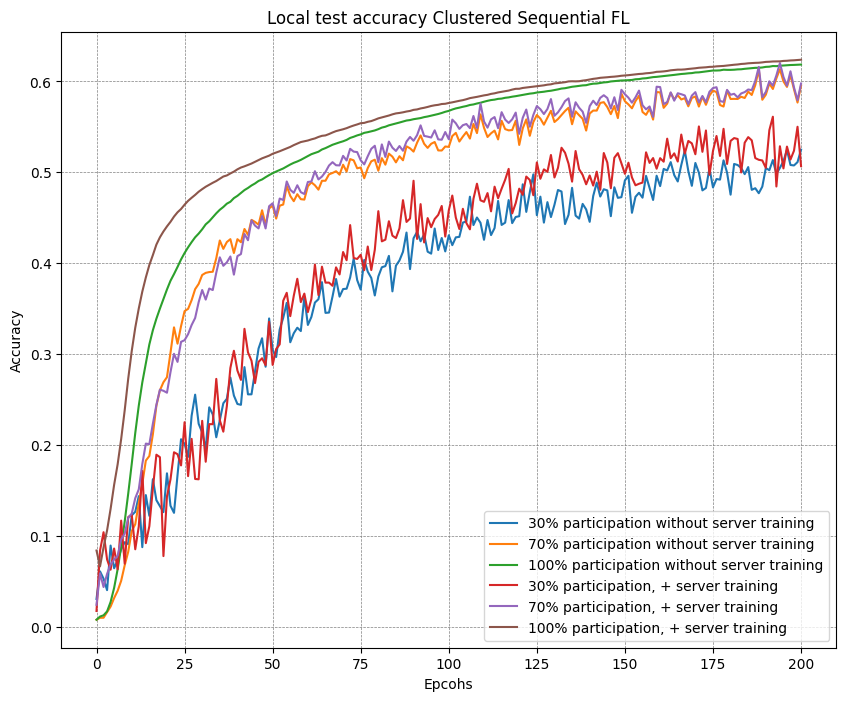

In [8]:
plt.figure(figsize=(10,8))
plt.plot(_03_200EPOCHS_local_acc, label="30% participation without server training")
plt.plot(_07_200EPOCHS_local_acc, label="70% participation without server training")
plt.plot(_10_200EPOCHS_local_acc, label="100% participation without server training")
plt.plot(_03_200EPOCHS_withserver_local_acc, label="30% participation, + server training")
plt.plot(_07_200EPOCHS_withserver_local_acc, label="70% participation, + server training")
plt.plot(_10_200EPOCHS_withserver_local_acc, label="100% participation, + server training")
plt.title("Local test accuracy Clustered Sequential FL")
plt.xlabel("Epcohs")
plt.ylabel("Accuracy")
plt.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
plt.legend()

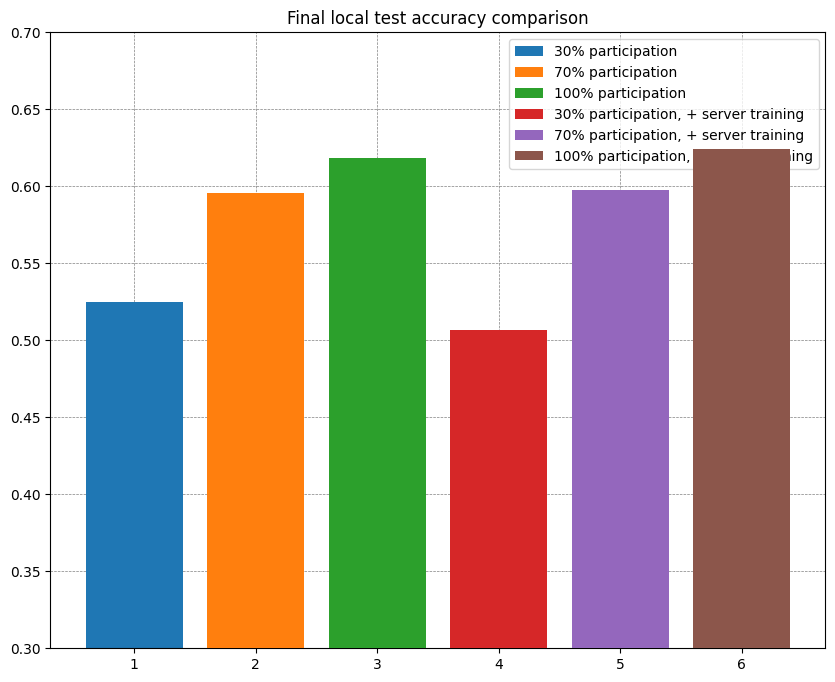

In [9]:
plt.figure(figsize=(10,8))
plt.bar(["1"], [_03_200EPOCHS_local_acc[-1]], label="30% participation", zorder=1+1)
plt.bar(["2"], [_07_200EPOCHS_local_acc[-1]], label="70% participation", zorder=2+1)
plt.bar(["3"], [_10_200EPOCHS_local_acc[-1]], label="100% participation", zorder=3+1)
plt.bar(["4"], [_03_200EPOCHS_withserver_local_acc[-1]], label="30% participation, + server training", zorder=4+1)
plt.bar(["5"], [_07_200EPOCHS_withserver_local_acc[-1]], label="70% participation, + server training", zorder=5+1)
plt.bar(["6"], [_10_200EPOCHS_withserver_local_acc[-1]], label="100% participation, + server training", zorder=6+1)
plt.grid(True, color='gray', linestyle='dashed', linewidth=0.5, zorder=1)
plt.ylim(0.3, 0.7)
plt.legend()
plt.title("Final local test accuracy comparison")
plt.show()

In [10]:
_03_200EPOCHS_global_acc = np.array(_03_200EPOCHS_SI.global_accuracies).mean(axis=1)
_07_200EPOCHS_global_acc = np.array(_07_200EPOCHS_SI.global_accuracies).mean(axis=1)
_10_200EPOCHS_global_acc = np.array(_10_200EPOCHS_SI.global_accuracies).mean(axis=1)
_03_200EPOCHS_withserver_global_acc = np.array(_03_200EPOCHS_withserver_SI.global_accuracies).mean(axis=1)
_07_200EPOCHS_withserver_global_acc = np.array(_07_200EPOCHS_withserver_SI.global_accuracies).mean(axis=1)
_10_200EPOCHS_withserver_global_acc = np.array(_10_200EPOCHS_withserver_SI.global_accuracies).mean(axis=1)
_03_200EPOCHS_withserver_local_acc_final = _03_200EPOCHS_withserver_local_acc[-1]
_07_200EPOCHS_withserver_local_acc_final = _07_200EPOCHS_withserver_local_acc[-1]
_10_200EPOCHS_withserver_local_acc_final = _10_200EPOCHS_withserver_local_acc[-1]
_03_200EPOCHS_local_acc_final = _03_200EPOCHS_local_acc[-1]
_07_200EPOCHS_local_acc_final = _07_200EPOCHS_local_acc[-1]
_10_200EPOCHS_local_acc_final = _10_200EPOCHS_local_acc[-1]
# _03_50EPOCHS_global_acc = _03_50EPOCHS_SI.get_average("accuracy")

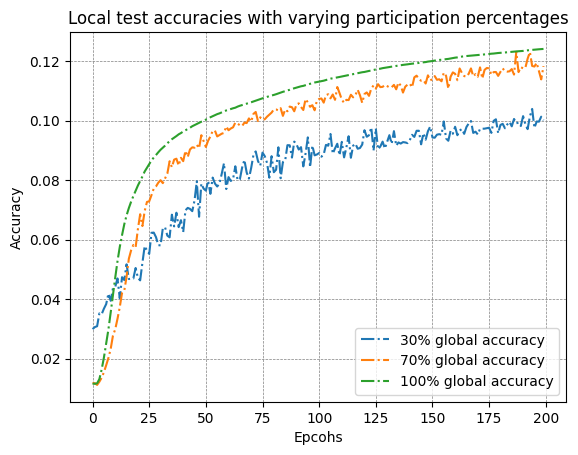

In [11]:
plt.plot(np.array(_03_200EPOCHS_SI.global_accuracies).mean(axis=1), label="30% global accuracy", linestyle='-.')
plt.plot(np.array(_07_200EPOCHS_SI.global_accuracies).mean(axis=1), label="70% global accuracy", linestyle='-.')
plt.plot(np.array(_10_200EPOCHS_SI.global_accuracies).mean(axis=1), label="100% global accuracy", linestyle='-.')
plt.title("Local test accuracies with varying participation percentages")
plt.xlabel("Epcohs")
plt.ylabel("Accuracy")
plt.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
plt.legend()

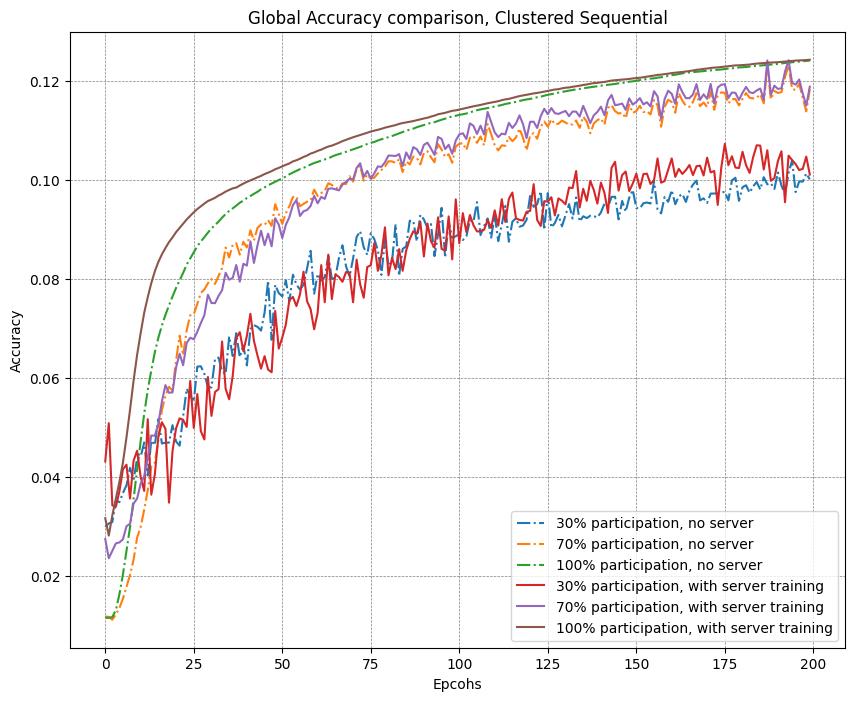

In [12]:
plt.figure(figsize=(10, 8))
plt.plot(_03_200EPOCHS_global_acc, label="30% participation, no server", linestyle="-.")
plt.plot(_07_200EPOCHS_global_acc, label="70% participation, no server", linestyle="-.")
plt.plot(_10_200EPOCHS_global_acc, label="100% participation, no server", linestyle="-.")
plt.plot(_03_200EPOCHS_withserver_global_acc, label="30% participation, with server training")
plt.plot(_07_200EPOCHS_withserver_global_acc, label="70% participation, with server training")
plt.plot(_10_200EPOCHS_withserver_global_acc, label="100% participation, with server training")
plt.legend()
plt.xlabel("Epcohs")
plt.ylabel("Accuracy")
plt.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
plt.title("Global Accuracy comparison, Clustered Sequential")
plt.savefig("./global_acc_comparison_clusterd.png")
plt.show()

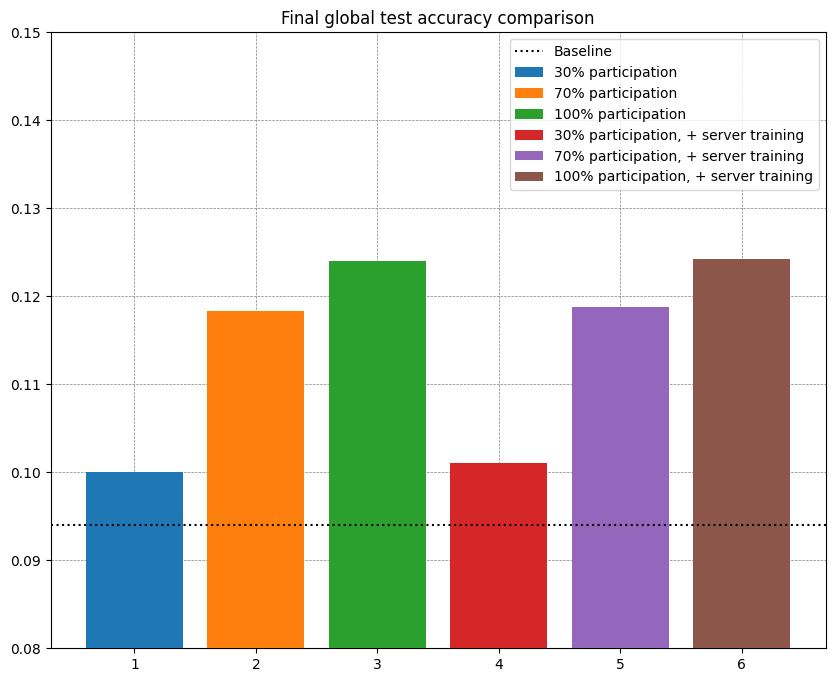

In [13]:
plt.figure(figsize=(10,8))
plt.bar(["1"], [_03_200EPOCHS_global_acc[-1]], label="30% participation", zorder=1+2)
plt.bar(["2"], [_07_200EPOCHS_global_acc[-1]], label="70% participation", zorder=2+2)
plt.bar(["3"], [_10_200EPOCHS_global_acc[-1]], label="100% participation", zorder=3+2)
plt.bar(["4"], [_03_200EPOCHS_withserver_global_acc[-1]], label="30% participation, + server training", zorder=4+2)
plt.bar(["5"], [_07_200EPOCHS_withserver_global_acc[-1]], label="70% participation, + server training", zorder=5+2)
plt.bar(["6"], [_10_200EPOCHS_withserver_global_acc[-1]], label="100% participation, + server training", zorder=6+2)
plt.grid(True, color='gray', linestyle='dashed', linewidth=0.5, zorder=1)
plt.ylim(0.08, 0.15)
plt.title("Final global test accuracy comparison")
plt.axhline(0.094, color="black", zorder=10, label="Baseline", linestyle="dotted")
plt.legend()
plt.show()

In [14]:

print()
print([_03_200EPOCHS_global_acc[-1]])
print([_07_200EPOCHS_global_acc[-1]])
print([_10_200EPOCHS_global_acc[-1]])
print([_03_200EPOCHS_withserver_global_acc[-1]])
print([_07_200EPOCHS_withserver_global_acc[-1]])
print([_10_200EPOCHS_withserver_global_acc[-1]])


[0.10008723927353476]
[0.11828285918221677]
[0.12405424696645254]
[0.10107066381156318]
[0.11879949695795522]
[0.12423982869379013]


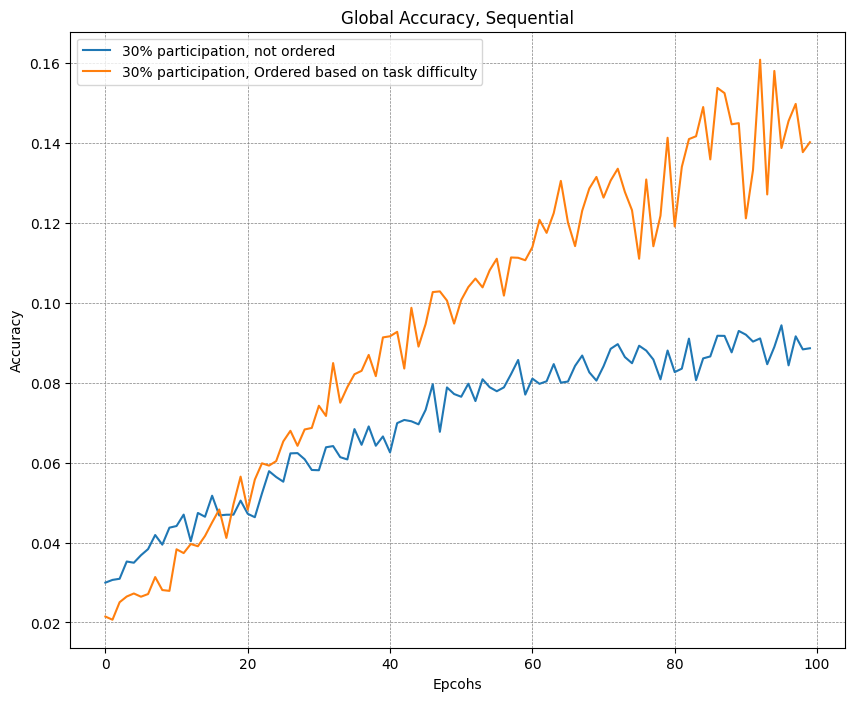

In [15]:
plt.figure(figsize=(10, 8))
plt.plot(_03_200EPOCHS_global_acc[:100], label="30% participation, not ordered")
plt.plot(np.array(ordered.global_accuracies).mean(axis=1), label="30% participation, Ordered based on task difficulty")
plt.legend()
plt.xlabel("Epcohs")
plt.ylabel("Accuracy")
plt.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
plt.title("Global Accuracy, Sequential")
plt.show()

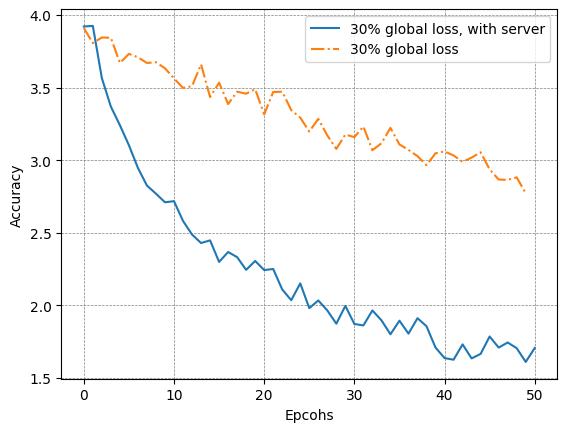

In [16]:
plt.plot(np.array(_03_50EPOCHS_SI.get_average("global loss")), label="30% global loss, with server", linestyle='solid')
plt.plot(np.array(_03_200EPOCHS_SI.get_average("global loss"))[:50], label="30% global loss", linestyle='-.')
plt.xlabel("Epcohs")
plt.ylabel("Accuracy")
plt.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
plt.legend()

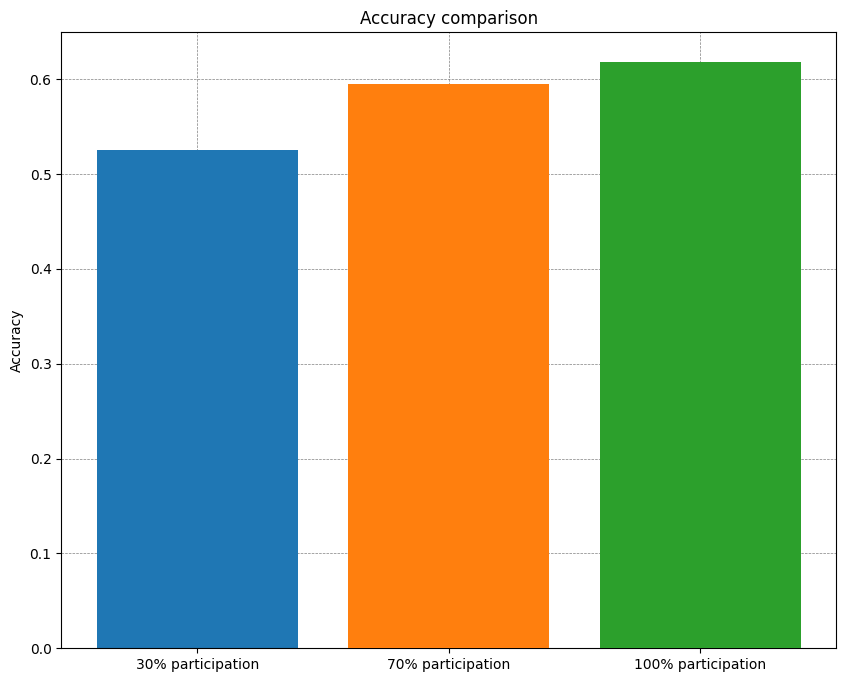

In [17]:
plt.figure(figsize=(10,8))
plt.grid(color='gray', linestyle='dashed', linewidth=0.5, zorder=0)
plt.bar(["30% participation"],[_03_200EPOCHS_local_acc_final], zorder=2)
plt.bar(["70% participation"],[_07_200EPOCHS_local_acc_final], zorder=3)
plt.bar(["100% participation"],[_10_200EPOCHS_local_acc_final], zorder=4)
plt.title("Accuracy comparison")
plt.ylabel("Accuracy")
plt.show()

# Final PLots 

In [18]:
import copy

In [19]:
# Local epochs: 5/ server: 10 / participation: 30%/ reordering : yes + decreasing lr for first iteration only / lr after : 0.00001  (RUNNING) hazem colab 6


Ordered 1 local epoch, 10 server lr 0.00001, 30% participation + dropout

In [20]:
# labels1=[
#     "Local accuracy with ordering",
#     "Local accuracy without ordering",
#     "Local accuracy FedAvg",
#     "Global accuracy with ordering",
#     "Global accuracy without ordering",
#     "Global accuracy FedAvg"
# ]

# labels2=[
#     "Local accuracy with ordering",
#     "Local accuracy without ordering",
#     "Local accuracy FedAvg",
#     "Global accuracy with ordering",
#     "Global accuracy without ordering",
#     "Global accuracy FedAvg"
# ]

# labels3=[
#     "Train loss with ordering",
#     "Train loss without ordering",
#     "Train loss FedAvg",
#     "Validation loss with ordering",
#     "Validation loss with ordering",
#     "Validation loss FedAvg"
# ]

# labels4=[
#     "Train loss with ordering",
#     "Train loss without ordering",
#     "Train loss FedAvg",
#     "Validation loss with ordering",
#     "Validation loss with ordering",
#     "Validation loss FedAvg"
# ]
# plot_local_global_accuracy_clustered_three(Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001, clustered_0_3participation_5_local_10_server_lr_changes_first_time , fedavg_0_00001lr_30_participation_150rounds_10global_1local, labels=labels1)
# plot_local_global_accuracy_sperated_clustered_three(Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001, clustered_0_3participation_5_local_10_server_lr_changes_first_time , fedavg_0_00001lr_30_participation_150rounds_10global_1local, labels=labels2)
# plot_train_val_loss_clustered_three(Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001, clustered_0_3participation_5_local_10_server_lr_changes_first_time, fedavg_0_00001lr_30_participation_150rounds_10global_1local, labels=labels3)
# plot_train_val_loss_seperated_clustered_three(Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001, clustered_0_3participation_5_local_10_server_lr_changes_first_time, fedavg_0_00001lr_30_participation_150rounds_10global_1local, labels=labels4)
# # Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001
# # clustered_0_3participation_5_local_10_server_lr_changes_first_time

In [96]:
# hamza : ordered_5local_10server_0_00001_30partiipation
# colab_6 : clustered_0_3participation_5_local_10_server_lr_changes_first_time
# fedavg : fedavg_0_00001lr_30_participation_150rounds_10global_1server
# lr0_00001 : Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_dropout_layer_pkl

{'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 200, 'iid': False, 'learning_rate': 0.01, 'server_learning_rate': 0.01, 'local_epochs': 1, 'cluster_frequency': 5, 'log_path': './logs', 'participation_percent': 0.3, 'seed': 1, 'task': 'multi-class'}
{'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 150, 'iid': False, 'learning_rate': 0.01, 'local_epochs': 1, 'cluster_frequency': 5, 'log_path': './logs', 'participation_percent': 0.5, 'seed': 1, 'task': 'multi-class'}


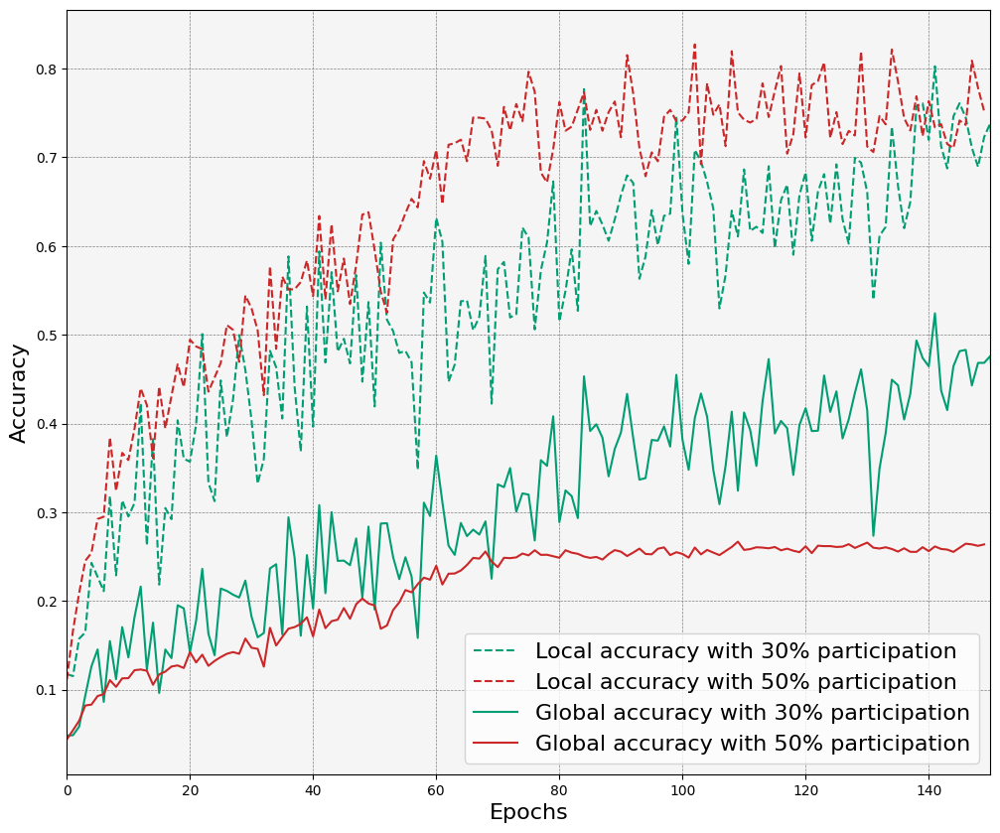

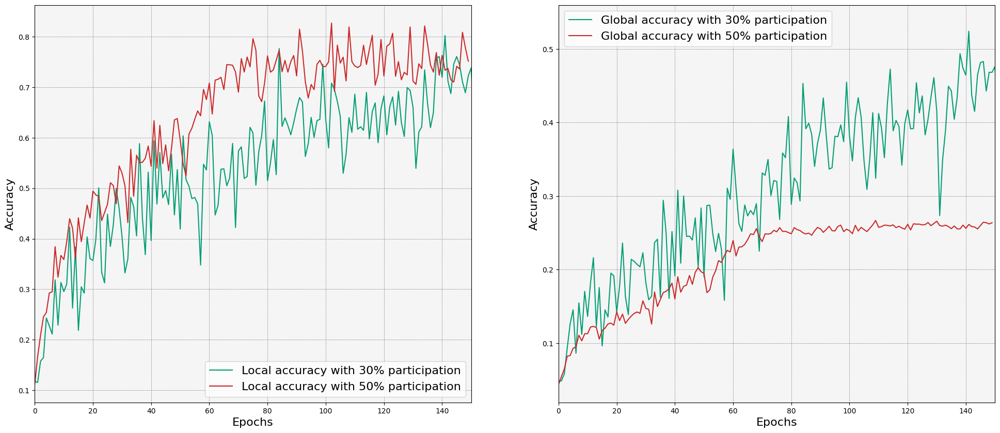

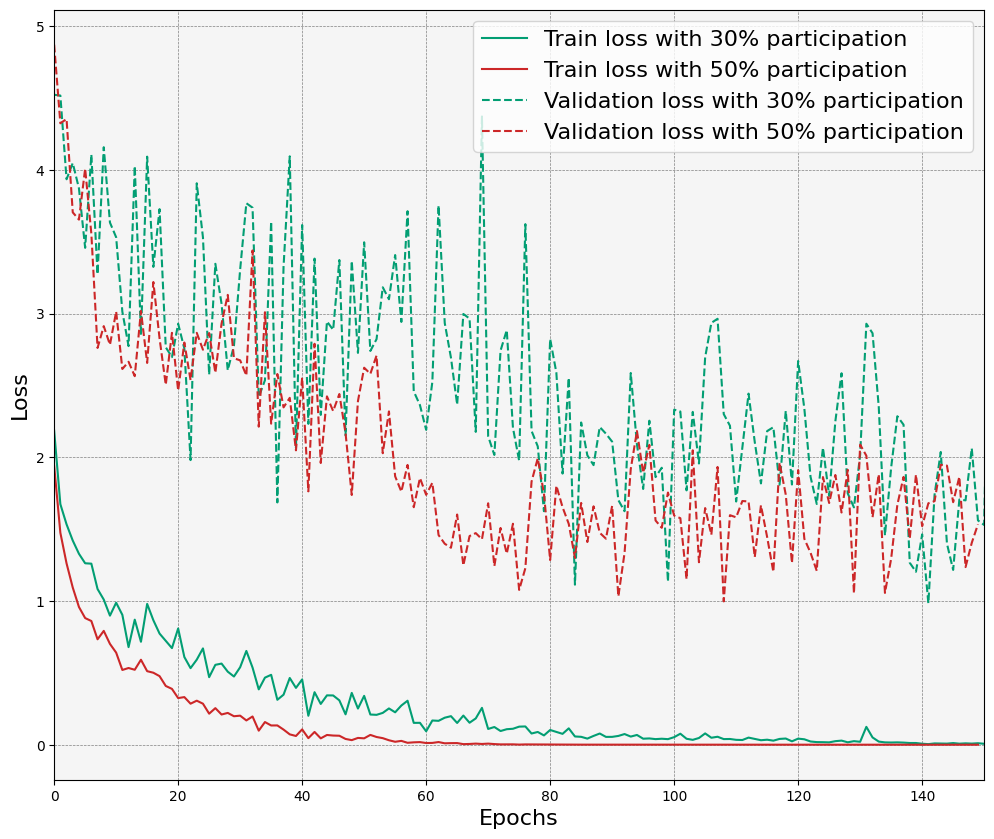

NameError: name 'plot_train_val_losxs_seperated' is not defined

In [106]:
print(Ordered_1localepoch_5server_epochs_at_each_global_round_lr_0_01_server_avg__30_participation_SeqFL_dropout_layer.config)
print(ordered_1_local_epoch_5_server_lr_0_01_50__participation_dropout.config)
labels1=[
    "Local accuracy with 30% participation",
    "Local accuracy with 50% participation",
    "Global accuracy with 30% participation",
    "Global accuracy with 50% participation"
]
labels2=[
    "Local accuracy with 30% participation",
    "Local accuracy with 50% participation",
    "Global accuracy with 30% participation",
    "Global accuracy with 50% participation",
]
labels3=[
    "Train loss with 30% participation",
    "Train loss with 50% participation",
    "Validation loss with 30% participation",
    "Validation loss with 50% participation"
]
labels4=[
    "Train loss with 30% participation",
    "Train loss with 50% participation",
    "Validation loss with 30% participation",
    "Validation loss with 50% participation"
]

plot_local_global_accuracy(Ordered_1localepoch_5server_epochs_at_each_global_round_lr_0_01_server_avg__30_participation_SeqFL_dropout_layer, ordered_1_local_epoch_5_server_lr_0_01_50__participation_dropout, labels=labels1)
plot_local_global_accuracy_sperated(Ordered_1localepoch_5server_epochs_at_each_global_round_lr_0_01_server_avg__30_participation_SeqFL_dropout_layer, ordered_1_local_epoch_5_server_lr_0_01_50__participation_dropout, labels=labels2)
plot_train_val_loss(Ordered_1localepoch_5server_epochs_at_each_global_round_lr_0_01_server_avg__30_participation_SeqFL_dropout_layer, ordered_1_local_epoch_5_server_lr_0_01_50__participation_dropout, labels=labels3)
plot_train_val_losxs_seperated(Ordered_1localepoch_5server_epochs_at_each_global_round_lr_0_01_server_avg__30_participation_SeqFL_dropout_layer, ordered_1_local_epoch_5_server_lr_0_01_50__participation_dropout, labels=labels4)

In [571]:
print(ordered_5local_10server_0_00001_30partiipation.config)
print(colab_2clustered_10_4lr_5local_10global_30participation.config)

{'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 150, 'iid': False, 'learning_rate': 1e-05, 'local_epochs': 5, 'cluster_frequency': 5, 'log_path': './logs', 'participation_percent': 0.3, 'seed': 1, 'task': 'multi-class'}
{'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 200, 'iid': False, 'learning_rate': 1e-05, 'local_epochs': 1, 'cluster_frequency': 5, 'log_path': './logs', 'participation_percent': 0.3, 'seed': 1, 'task': 'multi-class'}


# Pickles

In [534]:
with open("Ordered_1localepoch_5server_epochs_at_each_global_round_lr_ 0.01_server_avg__30_participation_SeqFL+dropout_layer.pkl", "rb") as f:
    Ordered_1localepoch_5server_epochs_at_each_global_round_lr_0_01_server_avg__30_participation_SeqFL_dropout_layer = pkl.load(f) # 1
with open("Ordered_1localepoch_10server_epochs_at_each_global_round_lr_ 0.00001_server_avg__30_participation_SeqFL.pkl", "rb") as f:
    Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_pkl = pkl.load(f) # 2
with open("Ordered_1localepoch_10server_epochs_at_each_global_round_lr_ 0.00001_server_avg__30_participation_SeqFL+dropout_layer.pkl", 'rb') as f:
    Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_dropout_layer_pkl = pkl.load(f) # 3
with open("fedavg_0_00001lr_30%participation_150rounds_10global_1server.pkl", 'rb') as f:
    fedavg_0_00001lr_30_participation_150rounds_10global_1server = pkl.load(f) # FEDAVG  # 23
with open("fedavg_0_00001lr_30%participation_150rounds_10global_1server.pkl", 'rb') as f:
    fedavg_0_00001lr_30_participation_150rounds_10global_1local = pkl.load(f) # FEDAVG
with open("fedprox_mu0_001_lr_0_00001_30participation_150rounds_10server_1local.pkl", 'rb') as f:
    fedprox_mu0_001_lr_0_00001_30participation_150rounds_10server_1local = pkl.load(f)
with open("..\\final_pickles\\ordered_1_local_epoch_5_server_lr_0.01_50%_participation_dropout.pkl", 'rb') as f:
    ordered_1_local_epoch_5_server_lr_0_01_50__participation_dropout = pkl.load(f) # colab 5  # 4
with open("ordered_5local_10server_0_00001_30partiipation.pkl", 'rb') as f:
    ordered_5local_10server_0_00001_30partiipation = pkl.load(f) # hamza  # 5
"ordered_5_local_epoch_10_server_lr_0.00001_30_participation_jazem_colab5.pkl"
with open("ordered_5_local_epoch_10_server_lr_0.00001_30_participation_jazem_colab5.pkl", 'rb') as f:
    ordered_5_local_epoch_10_server_lr_0_00001_30_participation = pkl.load(f)  # 6
with open("ordered_1_local_epoch_5_server_lr_0.01_50%_participation_no_ordering.pkl", 'rb') as f:
    colab_5_not_ordered = pkl.load(f) # 7

# Yass  
with open("organa_oct_clustered_FL_5LE_200GE_noservertraining_0_00001LR30participation.pkl", 'rb') as f:
    organa_oct_clustered_FL_5LE_200GE_noservertraining_0_00001LR30participation = pkl.load(f)  # 10
with open("nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001.pkl", 'rb') as f:
    nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001 = pkl.load(f)  # 11
with open("oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001.pkl", 'rb') as f:
    oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001 = pkl.load(f) # 12
with open("ordered_5local_10server_0_00001_30partiipation.pkl", 'rb') as f:
    ordered_5local_10server_0_00001_30partiipation = pkl.load(f)  # 13
with open("Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001.pkl", 'rb') as f:
    Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001 = pkl.load(f) # clustered_like_fedavg  # 14
clustered_like_fedavg = copy.deepcopy(Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001)
with open("ordered_5local_10server_lr_0_00001_50participation.pkl", 'rb') as f:
    ordered_5local_10server_lr_0_00001_50participation = pkl.load(f)  # 15
with open("clustered_0_3participation_5_local_10_server_lr_changes_first_time.pkl", 'rb') as f:
    clustered_0_3participation_5_local_10_server_lr_changes_first_time = pkl.load(f)  # 16
    
# last ones
with open("new/Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001.pkl", "rb") as f: # sahar
    Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001= pkl.load(f)  # 17
with open("new/colab_2clustered_10-4lr_5local_10global_30participation.pkl", "rb") as f:
    colab_2clustered_10_4lr_5local_10global_30participation= pkl.load(f)  # 18
with open("new/fed_avg_no_server_training.pkl", "rb") as f:
    fed_avg_no_server_training = pkl.load(f)  # 23
with open("new/fedavg.pkl", "rb") as f:
    fedavg= pkl.load(f)
with open("new/fedprox.pkl", "rb") as f:
    fedprox= pkl.load(f)
with open("new/fedprox_SI.pkl", "rb") as f:
    fedprox_SI= pkl.load(f)
with open("new/reallyrordered_clust_Localepochs15_server15participation30reorderingdecreasinglronce_lrafter00001_155round.pkl", "rb") as f:
    reallyrordered_clust_Localepochs15_server15participation30reorderingdecreasinglronce_lrafter00001_155round= pkl.load(f)  # 19
# nopathmnist 5 local epochs 10 server participation 30 % 
with open("clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist.pkl", "rb") as f:
    # clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist
    nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001= pkl.load(f)  # 20
with open("clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist.pkl", "rb") as f:
    clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist= pkl.load(f)
with open("clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.pkl", "rb") as f:
    # clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30
    clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30= pkl.load(f)  # 21
with open("sammimbaad.pkl", "rb") as f:
    samimbaad = pkl.load(f)  # 22

############### SEQUENTIAL WITH N WITHOUT DROOUT ###############
with open("dropout_last_yas/sequential_8000_lr_0_01_30participation_5server_1localepoch_NO_dropout.pkl", "rb") as f:
    seq_no_drop_out = pkl.load(f)  # 8
with open("dropout_last_yas/sequential_8000_lr_0_01_30participation_5server_1localepoch_with_dropout.pkl", "rb") as f:
    seq_drop_out = pkl.load(f)  # 9

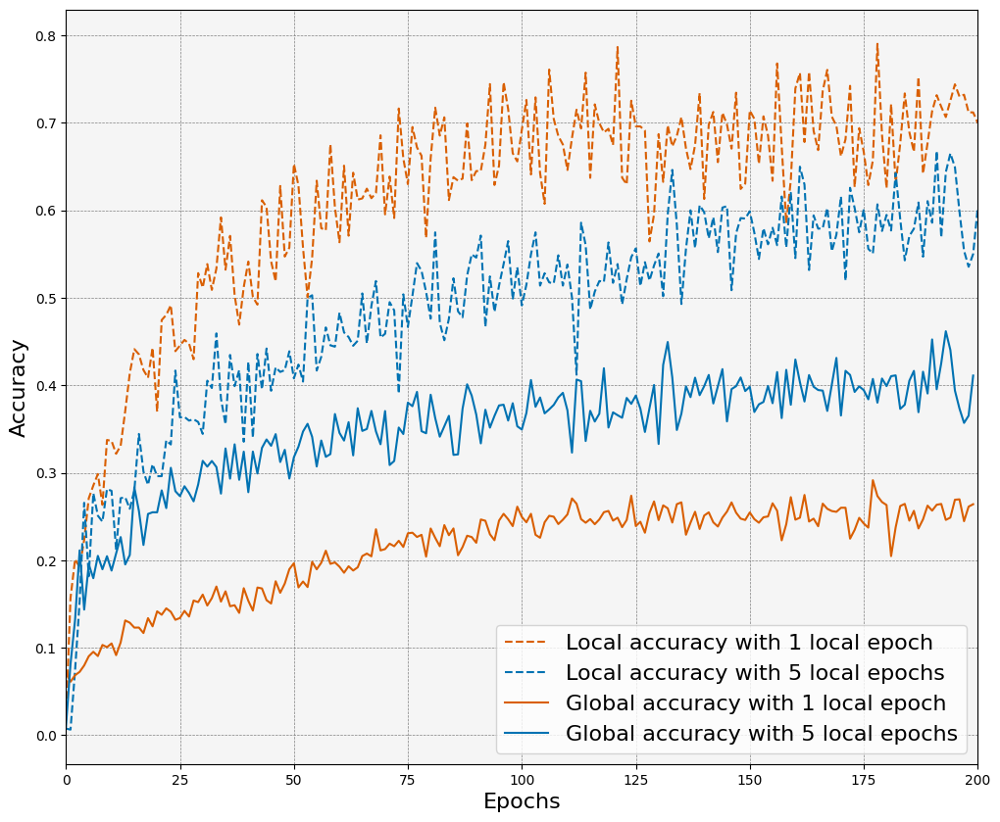

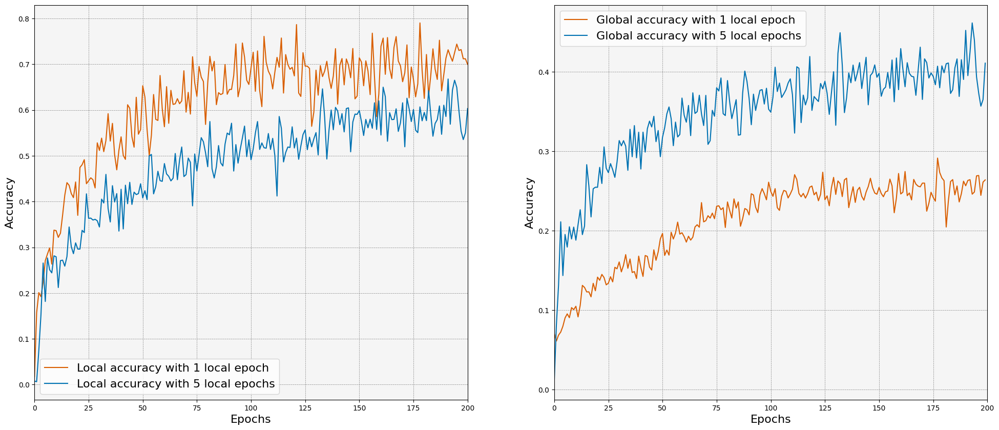

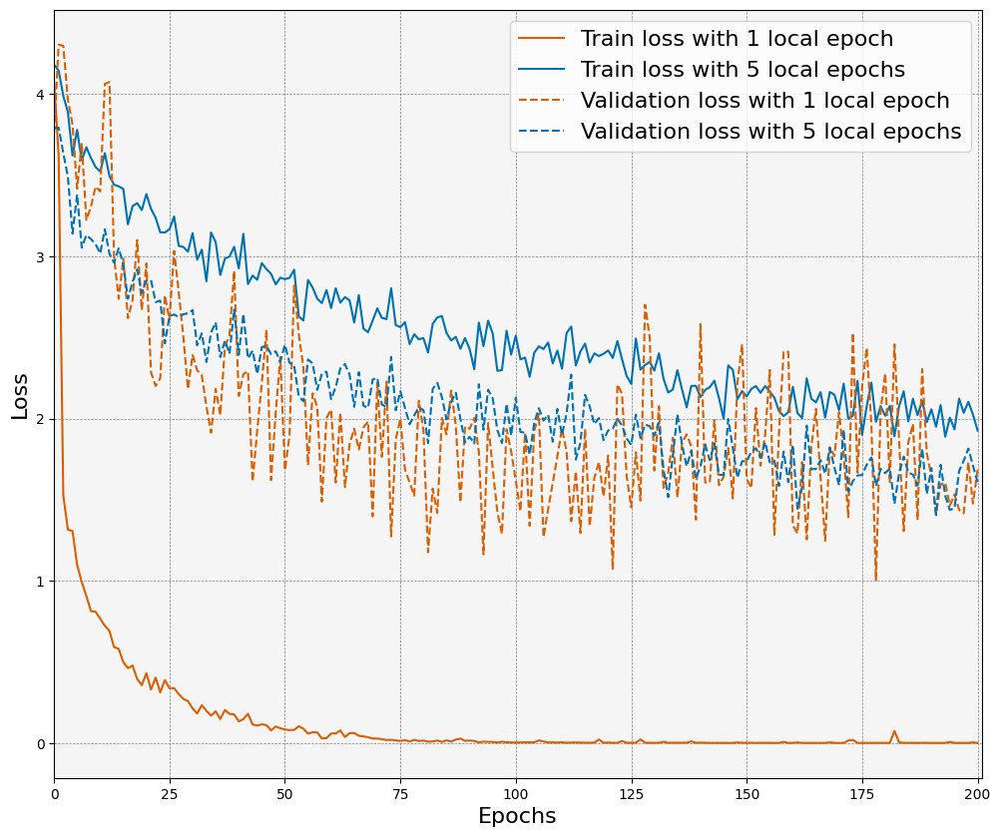

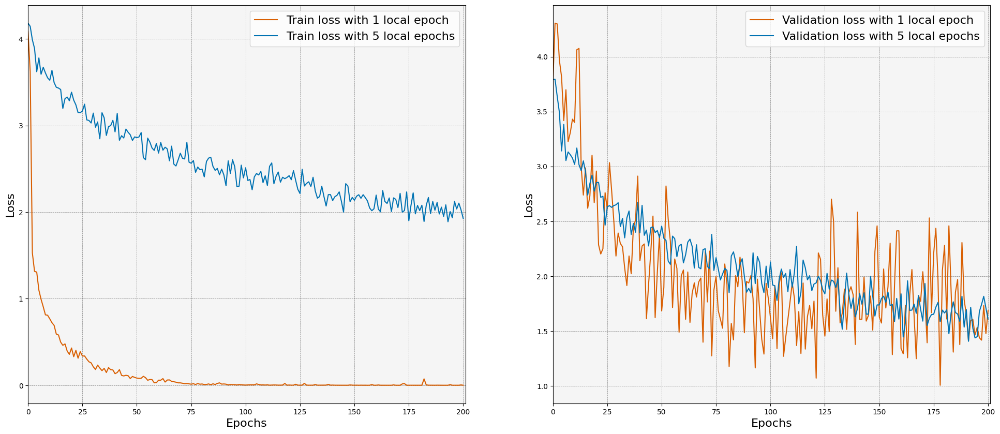

In [621]:
labels1=[
    "Local accuracy with 1 local epoch",
    "Local accuracy with 5 local epochs",
    "Global accuracy with 1 local epoch",
    "Global accuracy with 5 local epochs"
]
labels2=[
    "Local accuracy with 1 local epoch",
    "Local accuracy with 5 local epochs",
    "Global accuracy with 1 local epoch",
    "Global accuracy with 5 local epochs"
]
labels3=[
    "Train loss with 1 local epoch",
    "Train loss with 5 local epochs",
    "Validation loss with 1 local epoch",
    "Validation loss with 5 local epochs"
]
labels4=[
    "Train loss with 1 local epoch",
    "Train loss with 5 local epochs",
    "Validation loss with 1 local epoch",
    "Validation loss with 5 local epochs"
]

plot_local_global_accuracy_clustered(colab_2clustered_10_4lr_5local_10global_30participation, clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30, labels1, color="bo")
plot_local_global_accuracy_sperated_clustered(colab_2clustered_10_4lr_5local_10global_30participation, clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30, labels2, color="bo")
plot_train_val_loss_clustered(colab_2clustered_10_4lr_5local_10global_30participation, clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30, labels3, color="bo")
plot_train_val_loss_seperated_clustered(colab_2clustered_10_4lr_5local_10global_30participation, clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30, labels4, color="bo")

In [ ]:
colab_2clustered_10_4lr_5local_10global_30participation
clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30

In [599]:
for key in colab_2clustered_10_4lr_5local_10global_30participation.config:
    print(key)
    print(fedavg_0_00001lr_30_participation_150rounds_10global_1server.config[key])
    print(Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001.config[key])
    print(ordered_5local_10server_0_00001_30partiipation.config[key])

In [600]:
for key in colab_2clustered_10_4lr_5local_10global_30participation.config:
    print(key)
    print(fedavg_0_00001lr_30_participation_150rounds_10global_1server.config[key])
    print(colab_2clustered_10_4lr_5local_10global_30participation.config[key])
    print(Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_dropout_layer_pkl.config[key])

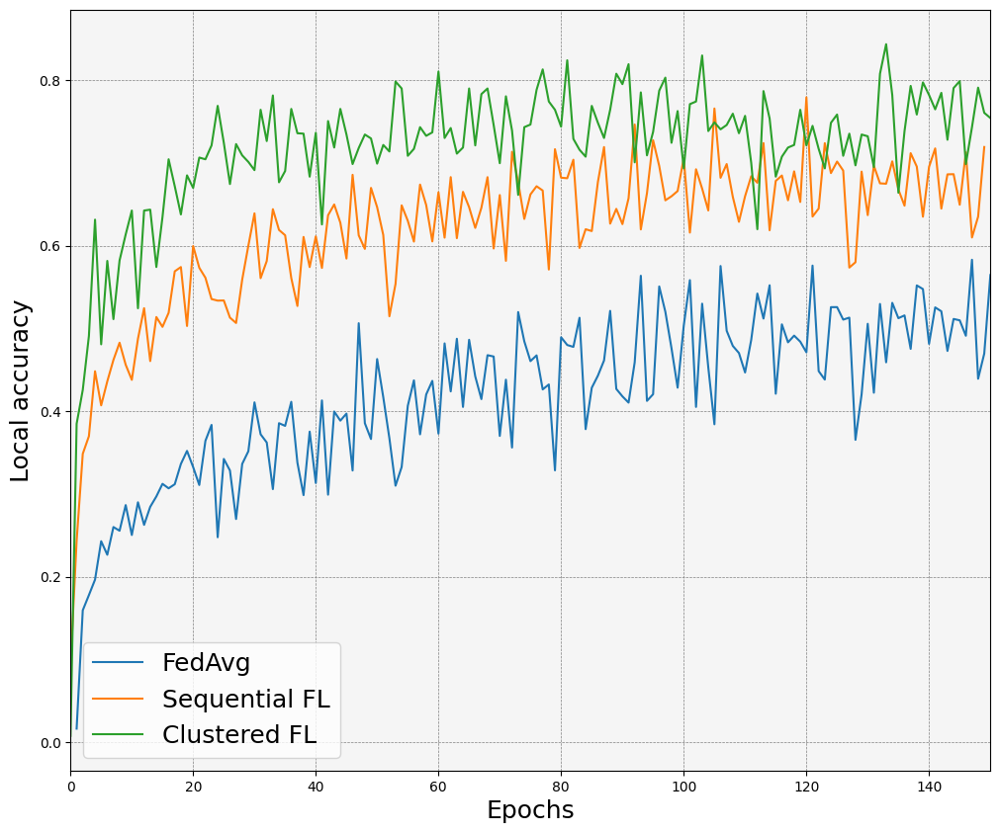

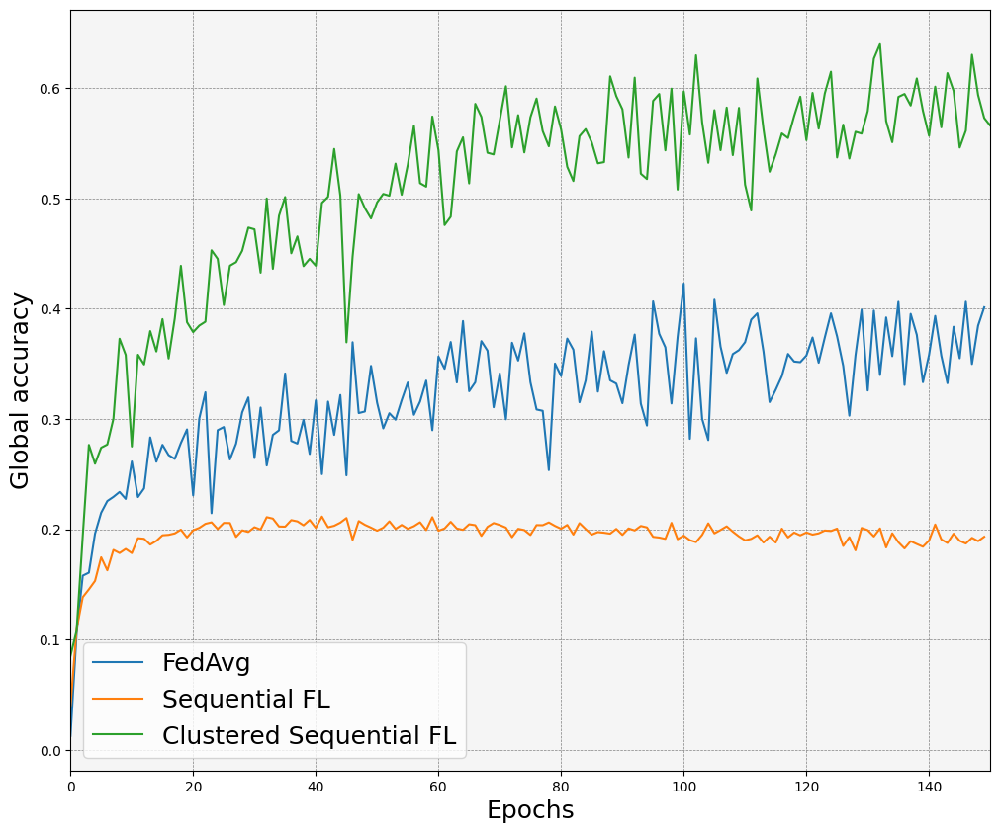

In [693]:
# fedavg_0_00001lr_30_participation_150rounds_10global_1server
# colab_2clustered_10_4lr_5local_10global_30participation
# Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_dropout_layer_pkl
# ##############
# fedavg_0_00001lr_30_participation_150rounds_10global_1server
# Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001
# ordered_5local_10server_0_00001_30partiipation
_, ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(results, label="FedAvg")
ax.plot(get_local_accuracy(ordered_5local_10server_0_00001_30partiipation), label="Sequential FL")
ax.plot(get_local_accuracy_clustered(samimbaad), label="Clustered FL")
ax.set_xlabel("Epochs", fontsize=18)
ax.set_ylabel("Local accuracy", fontsize=18)
ax.legend(fontsize=18)
ax.set_xlim(0, 150)
plt.show()
_, ax = plt.subplots(figsize=(12, 10))
# ax.figure(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(fed_avg_global_acc, label="FedAvg")
ax.plot(get_average_global_accuracy_with_no_dict(ordered_5local_10server_0_00001_30partiipation), label="Sequential FL")
ax.plot(get_average_global_accuracy_with_no_dict(samimbaad), label="Clustered Sequential FL")
ax.set_xlabel("Epochs", fontsize=18)
ax.set_ylabel("Global accuracy", fontsize=18)
ax.legend(fontsize=18)
ax.set_xlim(0, 150)
plt.show()

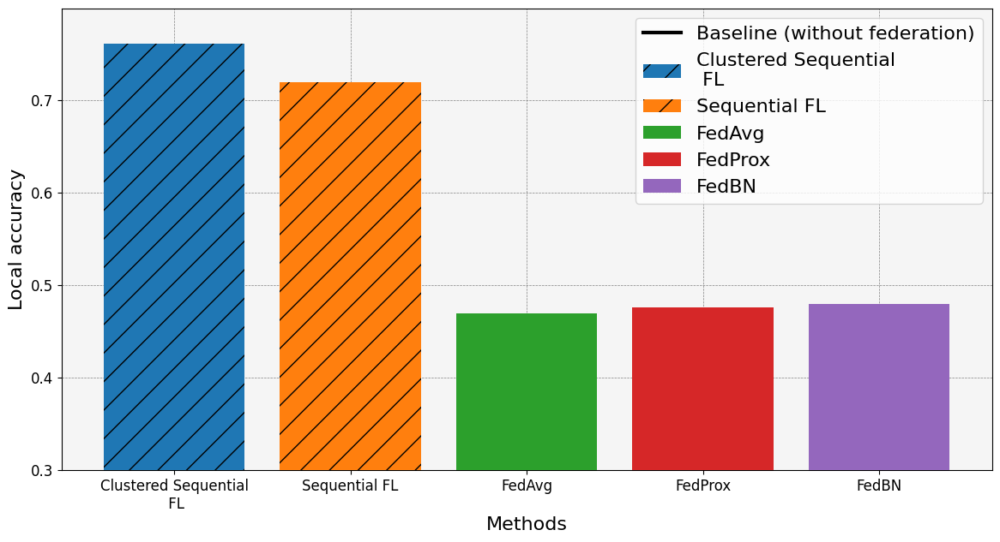

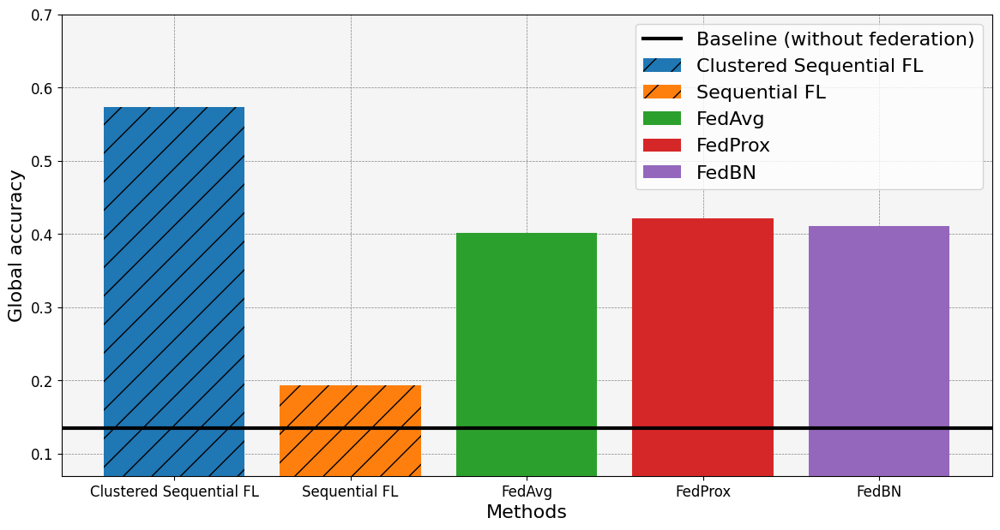

In [805]:
import matplotlib.pyplot as plt
import random
def plot_barplot(values):
    # Create a figure and axis with a lrger figure size
    fig , ax = plt.subplots(figsize=(14, 7))
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5, zorder=0)
    # legend_labels = ['Sequential', 'Clustered Sequential', 'FedAvg + training the server', 'No federation']
    vals = list(values.values())
    labels = list(values.keys())
    # Set the colors for the bars and create the bars
    ax.axhline(0.135, color='black', linewidth=3, zorder=100, label="Baseline (without federation)")
    for label, val in zip(labels,vals):
      if "Fed" in label:
        ax.bar(label, val, zorder=4, label=label) # color=[colors["gree"]],
      else:
        ax.bar(label, val, zorder=4, hatch="/", label=label) # color=[colors["gree"]],

    # Set the x-axis tick labels
    ax.set_xticks(list(range(len(labels))), labels=labels, fontsize=12)
    ax.set_yticks(np.array(list(range(10, 80, 10)))/ 100, labels=np.array(list(range(10, 80, 10)))/ 100, fontsize=12)
    
    # Add labels to the x-axis tick labels
    #ax.set_xticklabels(['Sequential', 'Clustered Seq', 'FedAvg + training the server', 'No federation'])
    plt.ylim((0.40 if values['FedAvg'] ==  0.4696495341021786 else 0.17) - 0.1)
    # Add labels to the y-axis
    ax.set_ylabel('Local accuracy' if values['FedAvg'] ==  0.4696495341021786 else 'Global accuracy', fontsize=16)
    ax.set_xlabel('Methods', fontsize=16)
    plt.legend(fontsize=16)
    # Show the plot
    plt.show()

# Values for the barplot
results
ordered_5local_10server_0_00001_30partiipation
samimbaad
0.4696495341021786
0.7192817569201332
0.7606299212598426

0.401364105004362
0.19321119835038467
0.5729583333333333
values_local_acc = {
          'Clustered Sequential\n FL': 0.7606299212598426,
          'Sequential FL': 0.7192817569201332, 
          'FedAvg': 0.4696495341021786,
          'FedProx': 0.47596495341021786,
          'FedBN': 0.4796495341021786
        #   'No federation': 0.135
          }

# plot_barplot(values)
values_global_acc = {
          'Clustered Sequential FL': 0.5729583333333333,
          'Sequential FL': 0.19321119835038467,
          'FedAvg': 0.4013641050043626,
          'FedProx': 0.4213641050043626,
          'FedBN': 0.4113641050043626
        #   'No federation': 0.135
          }

plot_barplot(values_local_acc)
plot_barplot(values_global_acc)

In [762]:
ordered_5local_10server_0_00001_30partiipation.config

{'algorithm': 'fedavg',
 'baseline': False,
 'batch_size': 50,
 'criterion': torch.nn.modules.loss.CrossEntropyLoss,
 'data_path': './data',
 'device': 'cuda:0',
 'eval_train': True,
 'gamma': None,
 'global_epochs': 150,
 'iid': False,
 'learning_rate': 1e-05,
 'local_epochs': 5,
 'cluster_frequency': 5,
 'log_path': './logs',
 'participation_percent': 0.3,
 'seed': 1,
 'task': 'multi-class'}

In [695]:
print(results[149])
print(get_local_accuracy(ordered_5local_10server_0_00001_30partiipation)[149])
print(get_local_accuracy_clustered(samimbaad)[149])
# print(####[149])
print(fed_avg_global_acc[149])
print(get_average_global_accuracy_with_no_dict(ordered_5local_10server_0_00001_30partiipation)[149])
print(get_average_global_accuracy_with_no_dict(samimbaad)[149])

0.4696495341021786
0.7192817569201332
0.7606299212598426
0.401364105004362
0.19321119835038467
0.5729583333333333


In [497]:
Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001.config

{'algorithm': 'fedavg',
 'baseline': False,
 'batch_size': 50,
 'criterion': torch.nn.modules.loss.CrossEntropyLoss,
 'data_path': './data',
 'device': 'cuda:0',
 'eval_train': True,
 'gamma': None,
 'global_epochs': 150,
 'iid': False,
 'learning_rate': 1e-05,
 'local_epochs': 5,
 'cluster_frequency': 5,
 'log_path': './logs',
 'participation_percent': 0.3,
 'seed': 1,
 'task': 'multi-class'}

In [ ]:
clustered : Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001
sequential : Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_pkl
fedavg : fedavg_0_00001lr_30_participation_150rounds_10global_1server

In [ ]:
fed_avg_local_acc = []
fed_avg_trained= []
for t in range(151):
    temp = []
    tr = []
    for client, accs in loc_acc_fedavg.items():
        if np.isnan(accs[t]):
            continue
        else:
            tr.append(client)
            temp.append(accs[t])
    if len(tr) == 0:
        print('continued')
    fed_avg_trained.append(tuple(tr))
    fed_avg_local_acc.append(np.mean(temp)) fedavg_0_00001lr_30_participation_150rounds_10global_1server

In [388]:
fed_avg_global_acc = np.mean(fedavg_0_00001lr_30_participation_150rounds_10global_1server.global_accuracies, axis=1)
print(*dir(fedavg_0_00001lr_30_participation_150rounds_10global_1server), sep="\n")

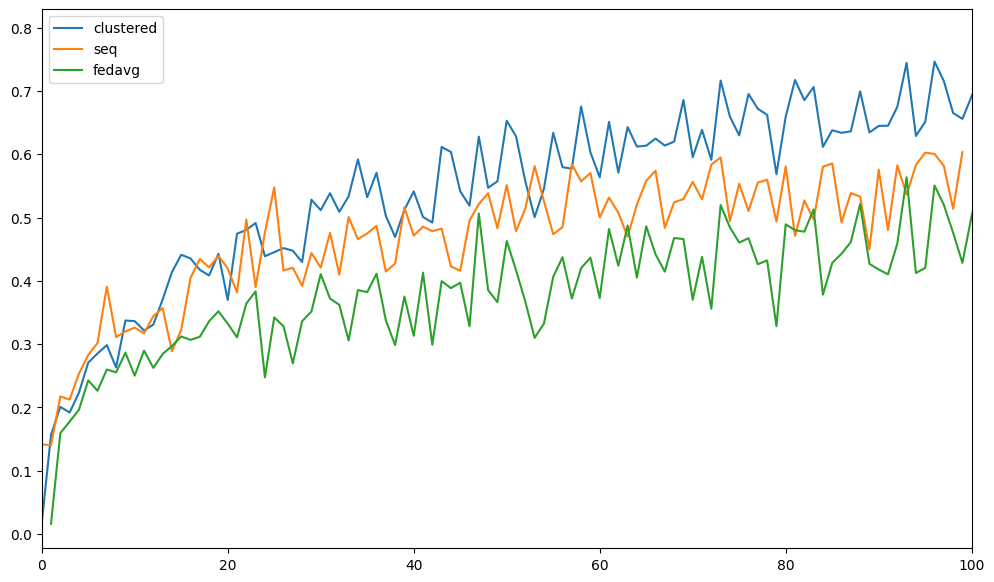

In [515]:
plt.figure(figsize=(12,7))
plt.plot(get_local_accuracy_clustered(colab_2clustered_10_4lr_5local_10global_30participation), label="Clustered Sequential FL")
plt.plot(get_local_accuracy(Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_pkl), label='Sequential FL')
plt.plot(fed_avg_local_acc, label="FedAvg")
plt.xlim(0, 100)
plt.legend()

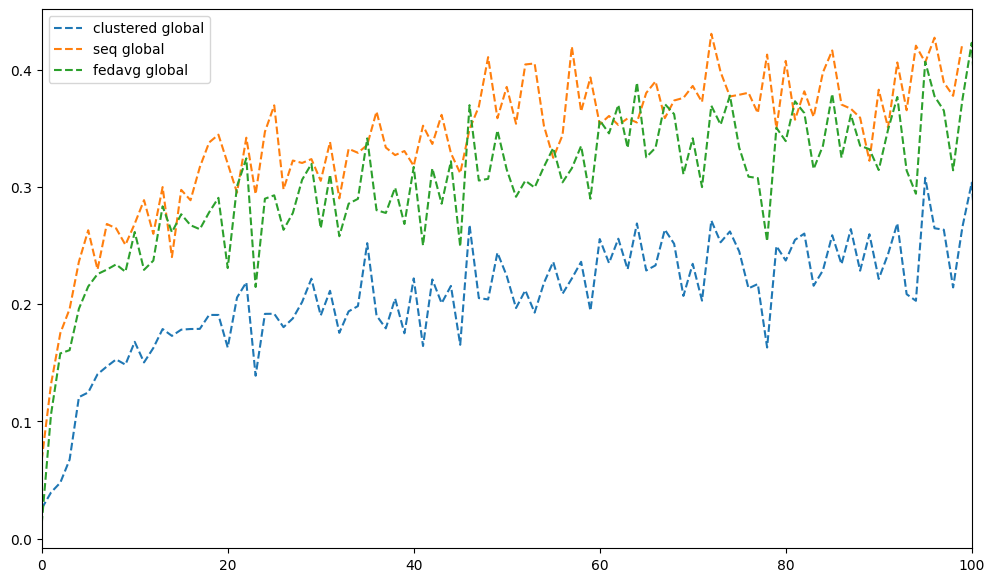

In [521]:
plt.figure(figsize=(12,7))

plt.plot(get_average_global_accuracy_with_no_dict(Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001), label="clustered global", linestyle="--")
plt.plot(get_average_global_accuracy_with_no_dict(Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_pkl), label='seq global', linestyle="--")
plt.plot(fed_avg_global_acc, label="fedavg global", linestyle="--")
plt.xlim(0, 100)
plt.legend()

In [ ]:
Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001
Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_pkl
fedavg_0_00001lr_30_participation_150rounds_10global_1server

In [ ]:
avg_local_acc_dict_per_dataset
clients_average_losses
compute_average
config
get_average
global_accuracies
global_accuracies_dict

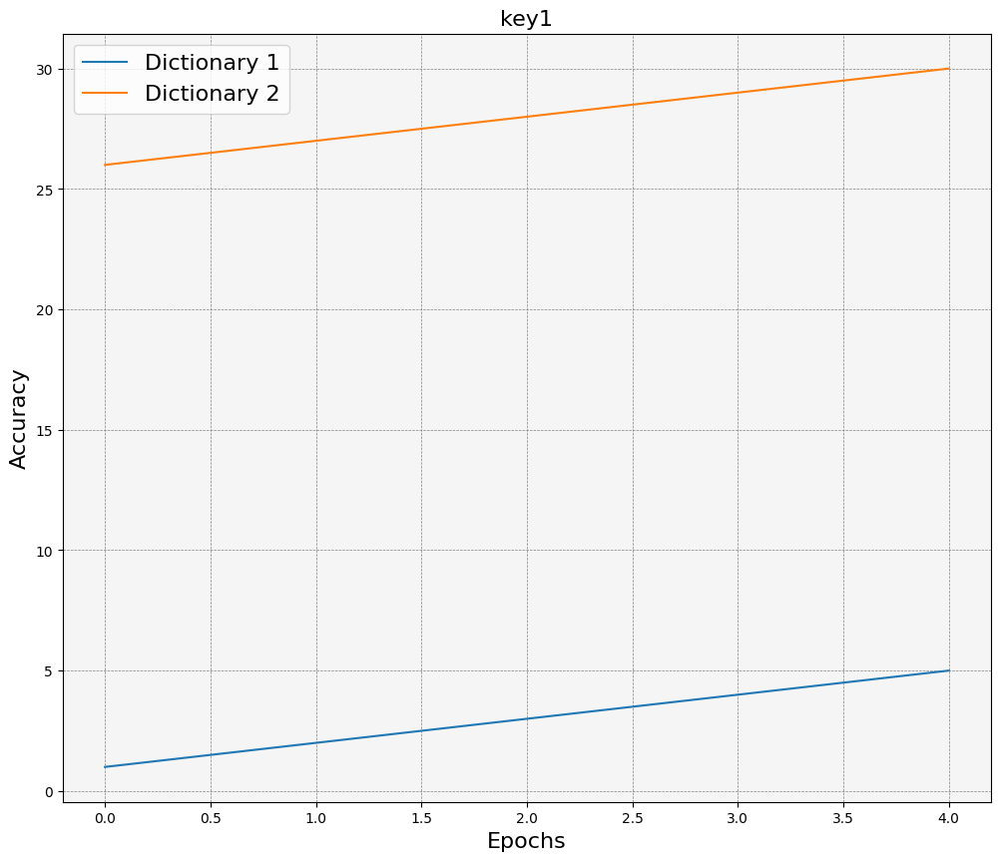

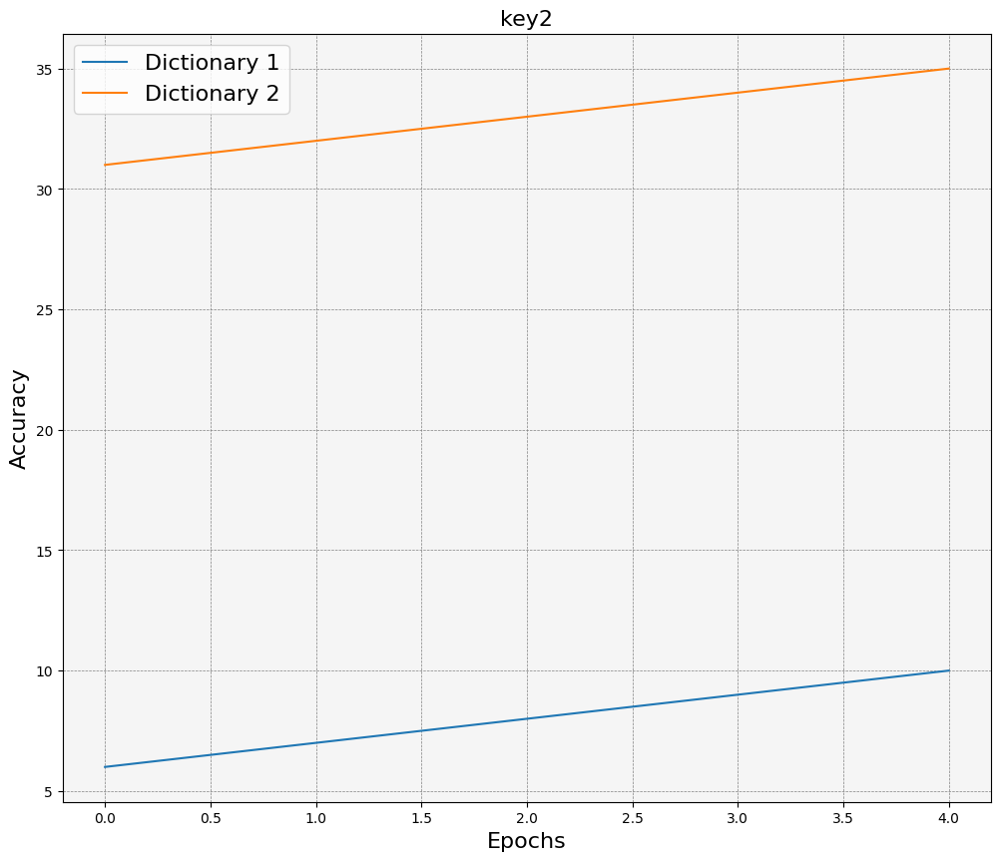

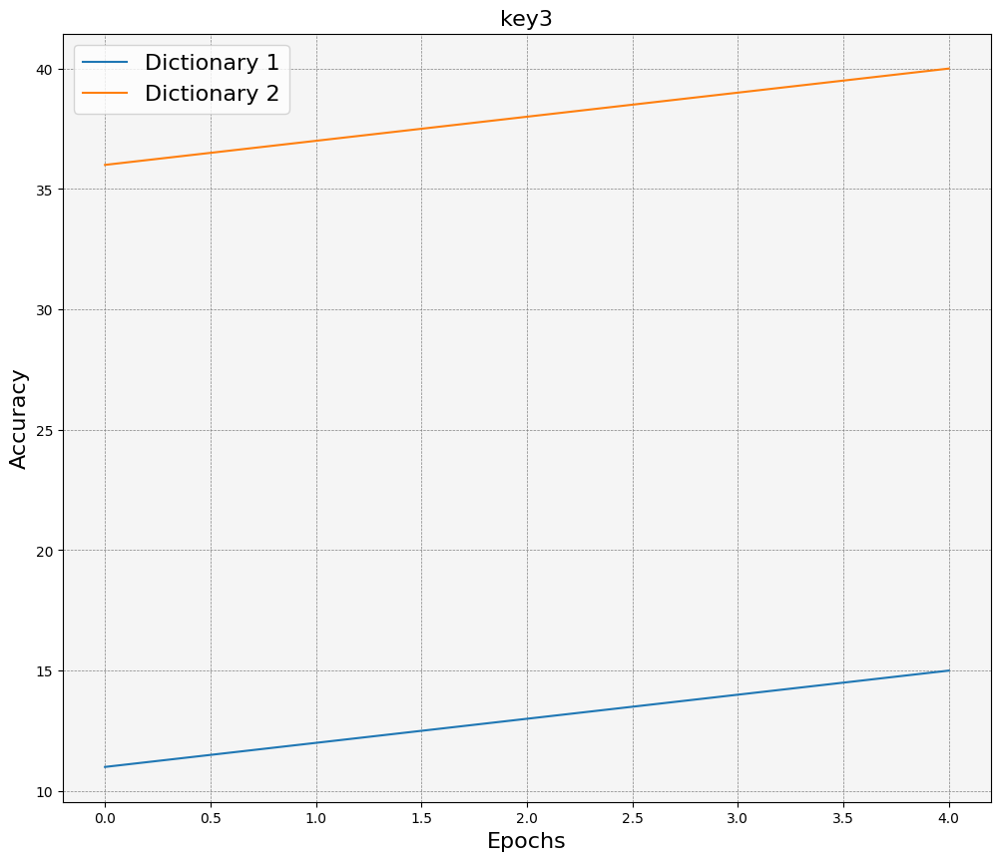

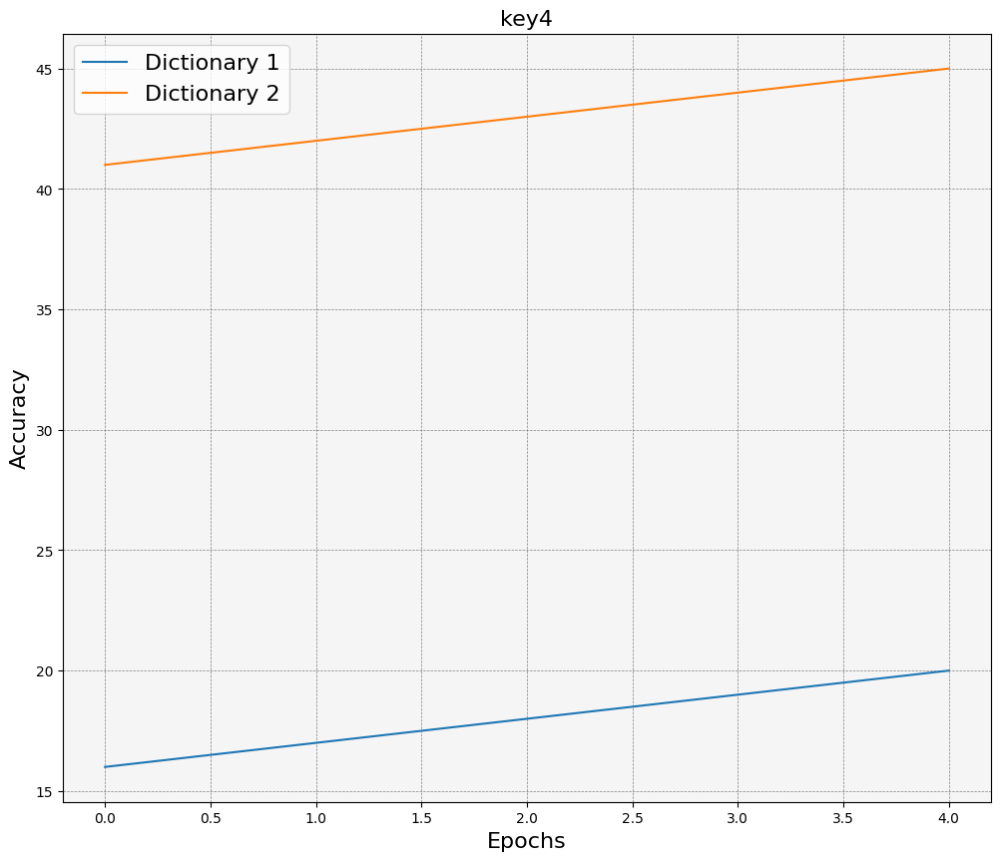

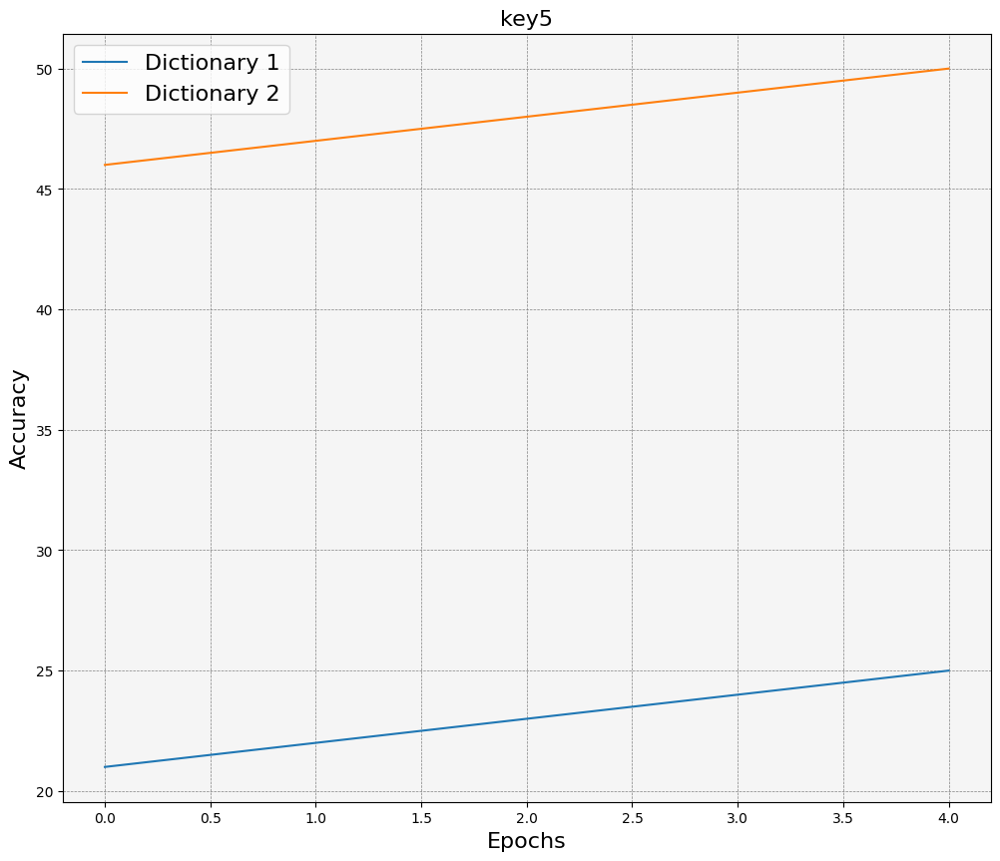

In [414]:
import matplotlib.pyplot as plt

# Example dictionaries
dict1 = {
    'key1': [1, 2, 3, 4, 5],
    'key2': [6, 7, 8, 9, 10],
    'key3': [11, 12, 13, 14, 15],
    'key4': [16, 17, 18, 19, 20],
    'key5': [21, 22, 23, 24, 25]
}

dict2 = {
    'key1': [26, 27, 28, 29, 30],
    'key2': [31, 32, 33, 34, 35],
    'key3': [36, 37, 38, 39, 40],
    'key4': [41, 42, 43, 44, 45],
    'key5': [46, 47, 48, 49, 50]
}
# Iterate over keys in the dictionaries
for i, key in enumerate(dict1.keys()):
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 10))
    
    # Get the values for the current key from both dictionaries
    values1 = dict1[key]
    values2 = dict2[key]
    
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    
    # Plot the values
    ax.plot(values1, label='Dictionary 1')
    ax.plot(values2, label='Dictionary 2')
    
    ax.set_title(key, fontsize=16)
    ax.set_xlabel("Epochs", fontsize=16)
    ax.set_ylabel("Accuracy", fontsize=16)
    ax.legend(fontsize=16)
    
    plt.show()

In [374]:
plt.clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset 
seq_no_drop_out.avg_local_acc_dict_per_dataset

{'organamnist': [0.0,
  0.18110236220472442,
  0.2755905511811024,
  0.3637795275590551,
  0.44881889763779526,
  0.4041994750656168,
  0.5078740157480315,
  0.3641732283464567,
  0.4566929133858268,
  0.547244094488189,
  0.4645669291338583,
  0.4094488188976378,
  0.4120734908136483,
  0.6299212598425197,
  0,
  0.41417322834645665,
  0.4015748031496063,
  0.4015748031496063,
  0.47047244094488183,
  0.5019685039370079,
  0.4803149606299213,
  0.47834645669291337,
  0.48425196850393704,
  0.5543307086614172,
  0.5492125984251969,
  0.6299212598425198,
  0.5118110236220472,
  0.5314960629921259,
  0.4645669291338583,
  0.5275590551181102,
  0.5177165354330708,
  0.562992125984252,
  0.6272965879265092,
  0.6062992125984252,
  0.5905511811023623,
  0.5314960629921259,
  0.5236220472440944,
  0.5779527559055118,
  0.4921259842519685,
  0.6240157480314961,
  0.6062992125984252,
  0.5879265091863517,
  0.5695538057742783,
  0.6318897637795275,
  0.5716535433070866,
  0.6594488188976377,
 

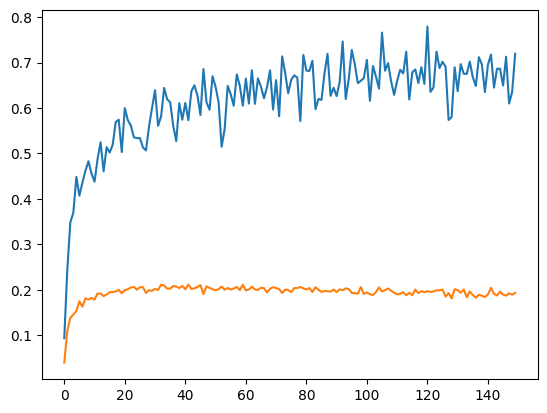

In [32]:
plt.plot(get_local_accuracy(ordered_5local_10server_0_00001_30partiipation))
plt.plot(get_average_global_accuracy_with_no_dict(ordered_5local_10server_0_00001_30partiipation))

In [33]:
colab_5 = copy.deepcopy(ordered_1_local_epoch_5_server_lr_0_01_50__participation_dropout)
participation_30 = copy.deepcopy(Ordered_1localepoch_5server_epochs_at_each_global_round_lr_0_01_server_avg__30_participation_SeqFL_dropout_layer)

In [34]:
lr0_01 = copy.deepcopy(Ordered_1localepoch_5server_epochs_at_each_global_round_lr_0_01_server_avg__30_participation_SeqFL_dropout_layer)
lr0_00001 = copy.deepcopy(Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_dropout_layer_pkl)

In [320]:
colors = {
    "blue": (0.0, 0.4470588235294118, 0.6980392156862745),   # Blue
    "orange": (0.8509803921568627, 0.37254901960784315, 0.00784313725490196),   # Orange
    "red": (0.8, 0.15294117647058825, 0.1568627450980392),   # Red
    "purple": (0.5803921568627451, 0.403921568627451, 0.7411764705882353),   # Purple
    "brown": (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),   # Brown
    "pink": (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),   # Pink
    "gray": (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),   # Gray
    "yellow": (0.9294117647058824, 0.6941176470588235, 0.12549019607843137),   # Yellow
    "green": (0.00784313725490196, 0.6196078431372549, 0.45098039215686275),   # Green
}

In [36]:
def get_local_accuracy(si):
    return [
        np.mean([
            si.local_accuracies[i][round+1] for i in group]) for round ,group in enumerate(si.trained)]
def get_local_accuracy_clustered(si):
    return [
        np.mean([
            si.local_accuracies[i][round] for i in group]) for round ,group in enumerate(si.trained)]

In [37]:
def global_accuracies_dict_gen(global_accuracies_dictionary, average=False):
    results = {ds: [] for ds in names}
    for result in global_accuracies_dictionary.values():
        for ds in names:
            results[ds].append(
                np.mean([
                    client[ds] for client in result
                ])
            )
    if average:
        results = np.mean(list(results.values()), axis=0)
    return results

In [38]:
def get_average_loss(si):
    trained = si.trained
    result = []
    for i, group in enumerate(trained):
        result.append([])
        for client in group:
            result[-1].append(si.clients_average_losses[client][i+1])
        result[-1] = np.mean(result[-1])
    return result
def get_average_loss_clustered(si):
    trained = si.trained
    result = []
    for i, group in enumerate(trained):
        result.append([])
        for client in group:
            result[-1].append(si.clients_average_losses[client][i])
        result[-1] = np.mean(result[-1])
    return result

In [39]:
def get_average_global_accuracy_with_no_dict(si):
    return np.mean(si.global_accuracies, axis=1)

In [40]:
from scipy.interpolate import CubicSpline

# Convergence behavior:
* Clustered Seq FL, training and validation loss
* Seq FL, training and validation loss
* FedAvg, training and validation loss

In [41]:
fedavg_0_00001lr_30_participation_150rounds_10global_1server.config

{'algorithm': 'fedavg',
 'baseline': False,
 'batch_size': 50,
 'criterion': torch.nn.modules.loss.CrossEntropyLoss,
 'data_path': './data',
 'device': 'cuda:0',
 'eval_train': True,
 'gamma': None,
 'global_epochs': 150,
 'iid': False,
 'learning_rate': 1e-05,
 'local_epochs': 5,
 'cluster_frequency': 5,
 'log_path': './logs',
 'participation_percent': 0.3,
 'seed': 1,
 'task': 'multi-class'}

In [42]:
# fedavg = copy.deepcopy(fedavg_0_00001lr_30_participation_150rounds_10global_1server)
hamza = copy.deepcopy(ordered_5local_10server_0_00001_30partiipation)
colab_6 = copy.deepcopy(clustered_0_3participation_5_local_10_server_lr_changes_first_time)

In [43]:
marker_size = 3

In [44]:
def interpolate(array, x_range=300):
    marker_interval = 5  # Show marker every 2 data points
    x = np.array(range(len(array)))
    y = np.array(array)
    # print(y)
    cs = CubicSpline(x, y)
    new_x = np.linspace(x.min(), x.max(), x_range)
    new_y = cs(new_x)
    return new_x, new_y, new_x[::marker_interval], new_y[::marker_interval]
    # ax.plot(new_x, new_y, label=k, color=default_colors[i])
    # ax.plot(new_x[::marker_interval], new_y[::marker_interval], 'o', markersize=marker_size, color=default_colors[i])

In [45]:
x, y , marker_x, marker_y = interpolate(colab_6.get_average("val loss")[:-2], 500)

In [46]:
def get_validation_loss(si):
    return [
        np.mean([
            si.val_losses[i][round+1] for i in group]) for round ,group in enumerate(si.trained)]
def get_validation_loss_clustered(si):
    return [
        np.mean([
            si.val_losses[i][round] for i in group]) for round ,group in enumerate(si.trained)]

### Train loss seq vs Clustered

TRAIN LOSS


AttributeError: 'str' object has no attribute 'trained'

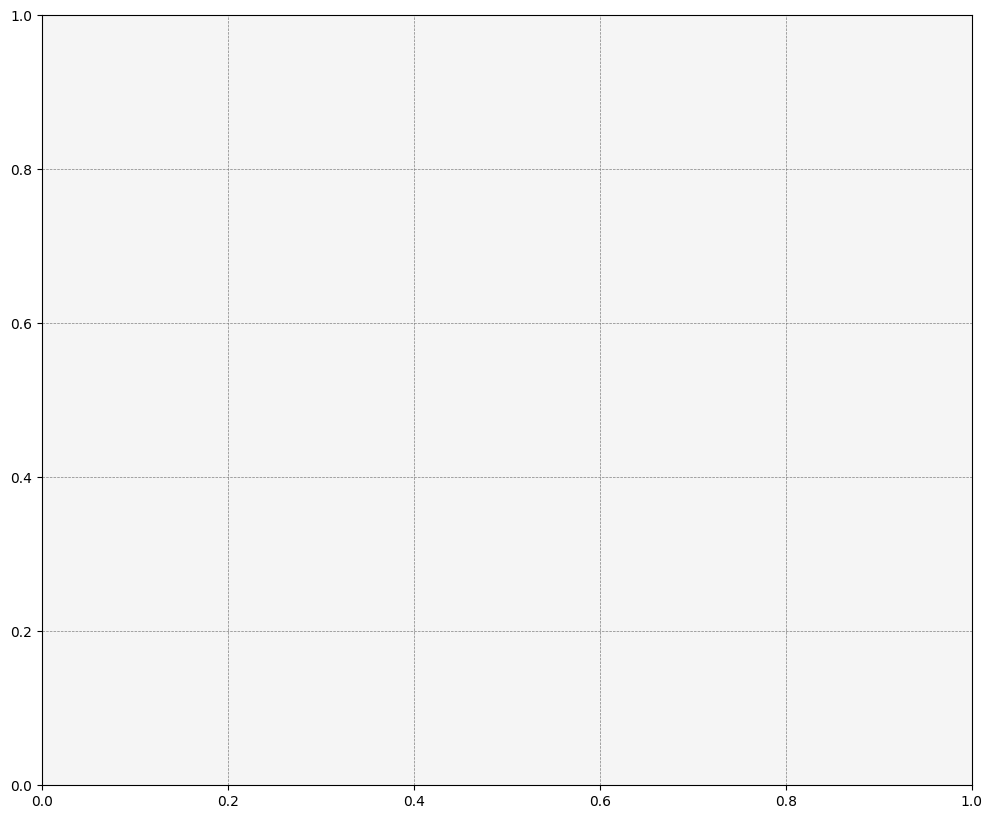

In [745]:
print('TRAIN LOSS')
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(get_local_accuracy("global loss"), label="Sequential Training")
ax.plot(get_average_loss(hamza), label="Clustered Sequential Training")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)
plt.show()

TRAIN LOSS


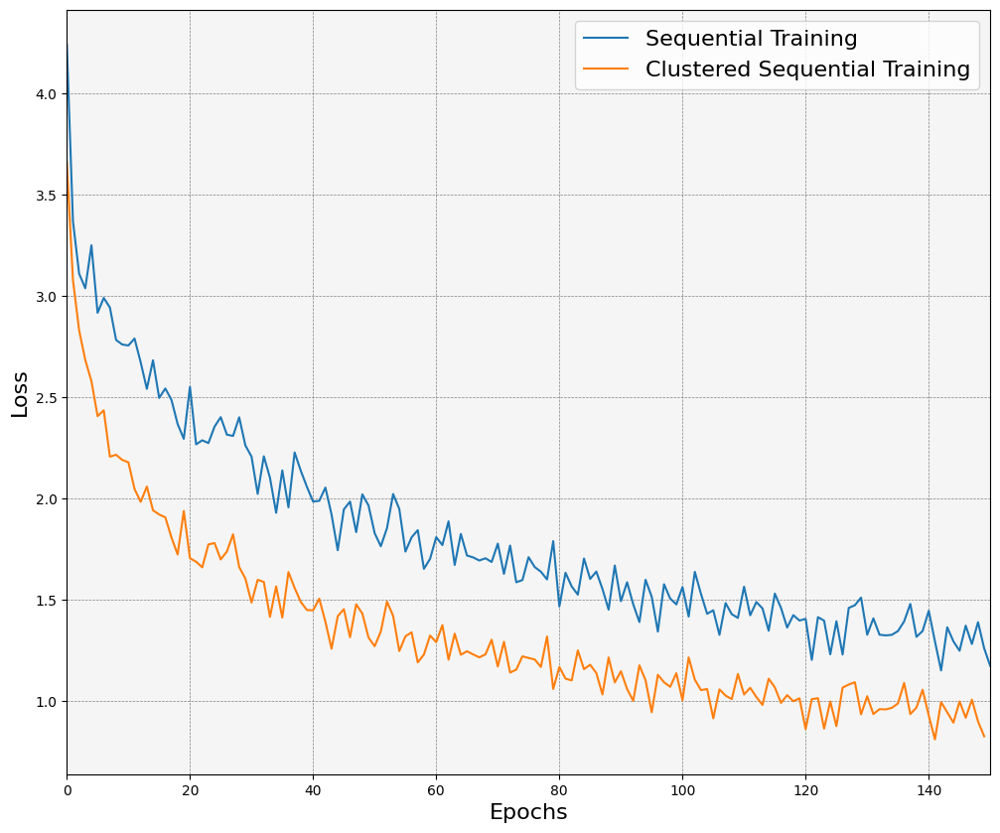

In [47]:
print('TRAIN LOSS')
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(colab_6.get_average("global loss"), label="Sequential Training")
ax.plot(get_average_loss(hamza), label="Clustered Sequential Training")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)
plt.show()

VALIDATION LOSS


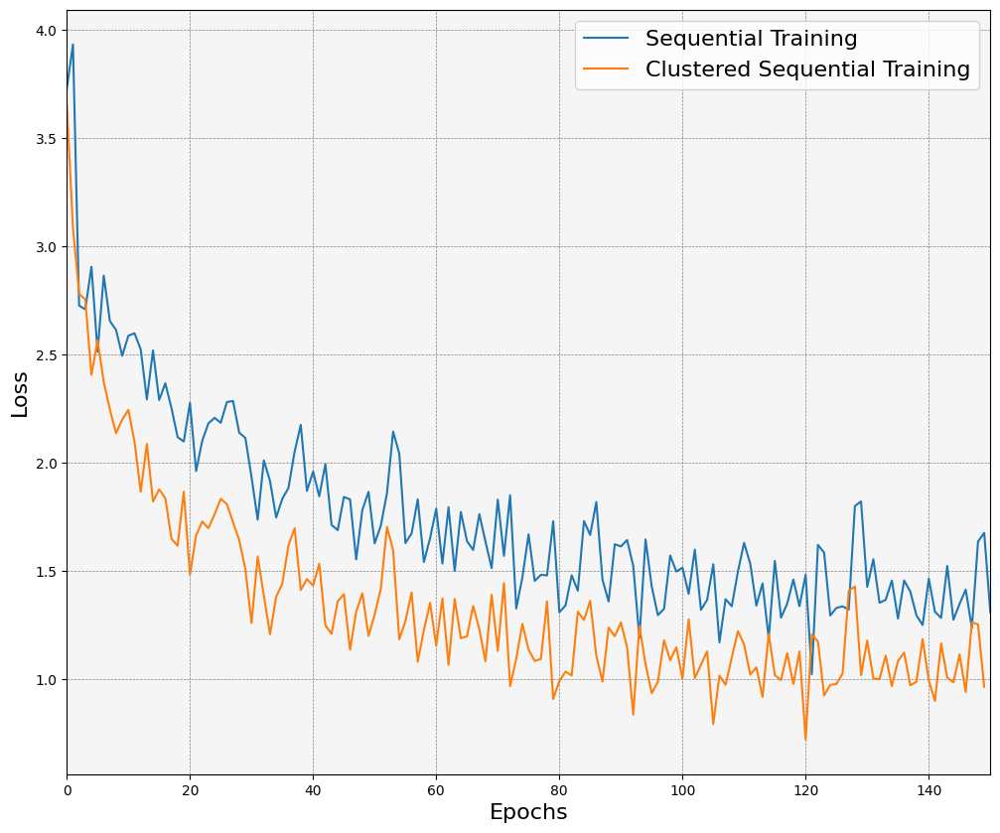

In [48]:
print('VALIDATION LOSS')
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(colab_6.get_average("val loss"), label="Sequential Training")
# ax.plot(x, y, label="Sequential Training")
# ax.plot(marker_x, marker_y, 'o', markersize=marker_size)

ax.plot(get_validation_loss(hamza), label="Clustered Sequential Training")
# ax.plot(hamza.get_average("val loss"), label="Clustered Sequential Training")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)
plt.show()

VALIDATION and TRAIN LOSS


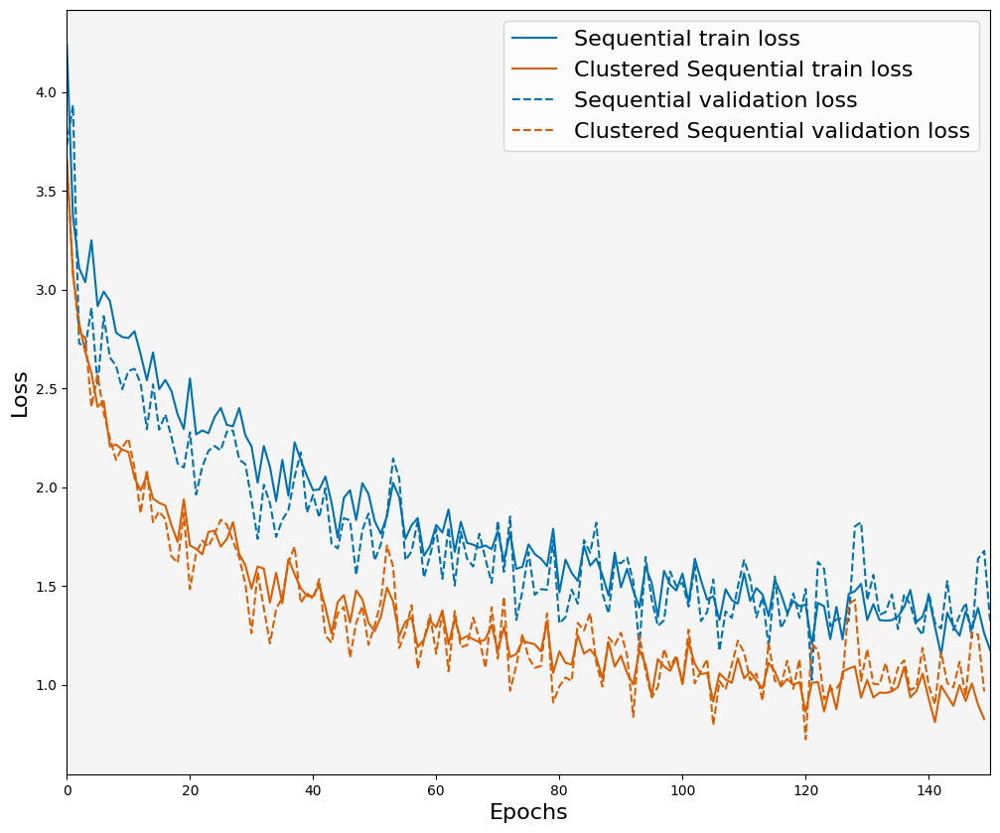

In [49]:
print('VALIDATION and TRAIN LOSS')
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.plot(colab_6.get_average("global loss"), color=colors['blue'], label="Sequential train loss")
ax.plot(get_average_loss(hamza), color=colors['orange'], label="Clustered Sequential train loss")
ax.plot(colab_6.get_average("val loss"), color=colors['blue'], linestyle="--", label="Sequential validation loss")
ax.plot(get_validation_loss(hamza), color=colors['orange'], linestyle="--", label="Clustered Sequential validation loss")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)
plt.show()

Higher learning rate faster convergence but overfitting

Sequential


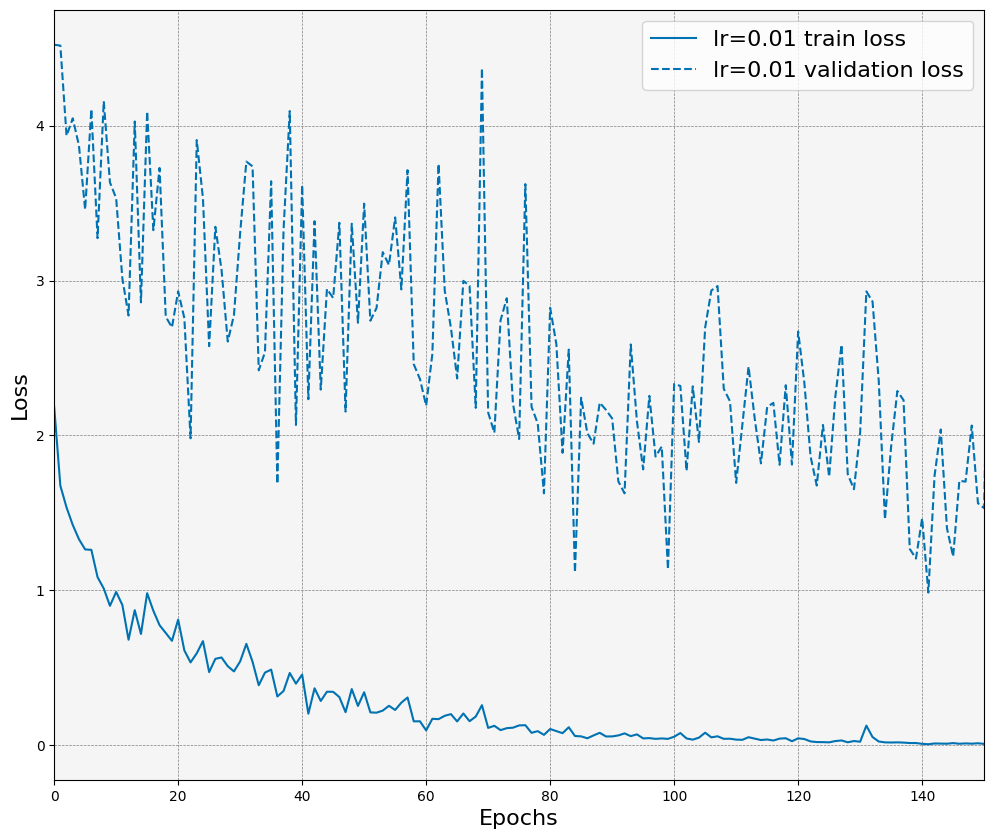

In [50]:
print("Sequential")
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(get_average_loss(participation_30),  color=colors["blue"], label=r"lr=0.01 train loss")
ax.plot(get_validation_loss(participation_30), linestyle="--", color=colors["blue"], label=r"lr=0.01 validation loss")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)
plt.show()

# Local epochs' effect
4: 1 local epoch 10 server
5 (hamaza): 5 local 10 server

In [51]:
_5loc10glob = copy.deepcopy(ordered_5_local_epoch_10_server_lr_0_00001_30_participation)

### Accuracy

local accuracy server10 0.00001 lr, 30 participation, with different local epochs


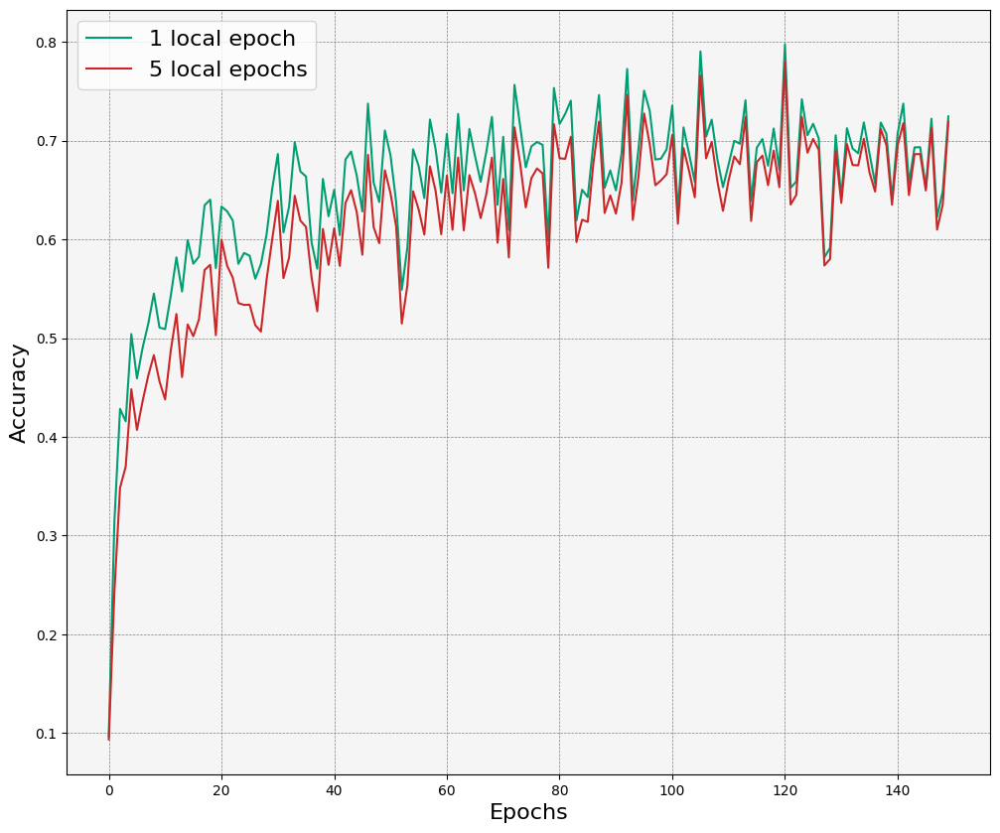

In [52]:
print('local accuracy server10 0.00001 lr, 30 participation, with different local epochs')
hamza_local_acc = get_local_accuracy(hamza)
_5loc10glob_local_acc = get_local_accuracy(_5loc10glob)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(_5loc10glob_local_acc, label="1 local epoch", color=colors["green"])
ax.plot(hamza_local_acc, label="5 local epochs", color=colors["red"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.legend(fontsize=16)

In [53]:
print('global accuracy server10 0.00001 lr, 30 participation, with different local epochs')
hamza_global_acc = global_accuracies_dict_gen(hamza.global_accuracies_dict, True)
_5loc10glob_global_acc = global_accuracies_dict_gen(_5loc10glob.global_accuracies_dict, True)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(_5loc10glob_global_acc, label="1 local epoch", color=colors["green"])
ax.plot(hamza_global_acc, label="5 local epochs", color=colors["red"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.legend(fontsize=16)

global accuracy server10 0.00001 lr, 30 participation, with different local epochs


NameError: name 'names' is not defined

global accuracy server10 0.00001 lr, 30 participation, with different local epochs


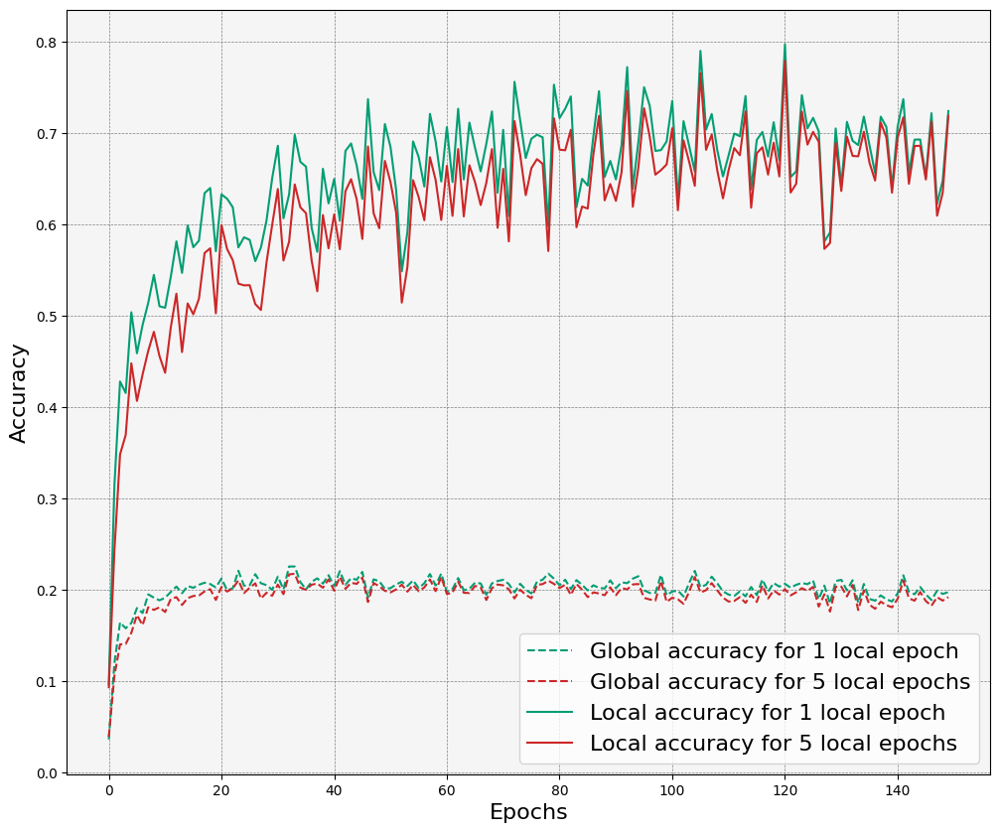

In [ ]:
print('global accuracy server10 0.00001 lr, 30 participation, with different local epochs')
hamza_global_acc = global_accuracies_dict_gen(hamza.global_accuracies_dict, True)
_5loc10glob_global_acc = global_accuracies_dict_gen(_5loc10glob.global_accuracies_dict, True)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(_5loc10glob_global_acc, label="Global accuracy for 1 local epoch", linestyle="--", color=colors["green"])
ax.plot(hamza_global_acc, label="Global accuracy for 5 local epochs", linestyle="--", color=colors["red"])
ax.plot(_5loc10glob_local_acc, label="Local accuracy for 1 local epoch", linestyle="-", color=colors["green"])
ax.plot(hamza_local_acc, label="Local accuracy for 5 local epochs", linestyle="-", color=colors["red"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.legend(fontsize=16)

### LOSS

train and validation loss server10 0.00001 lr, 30 participation, with different local epochs


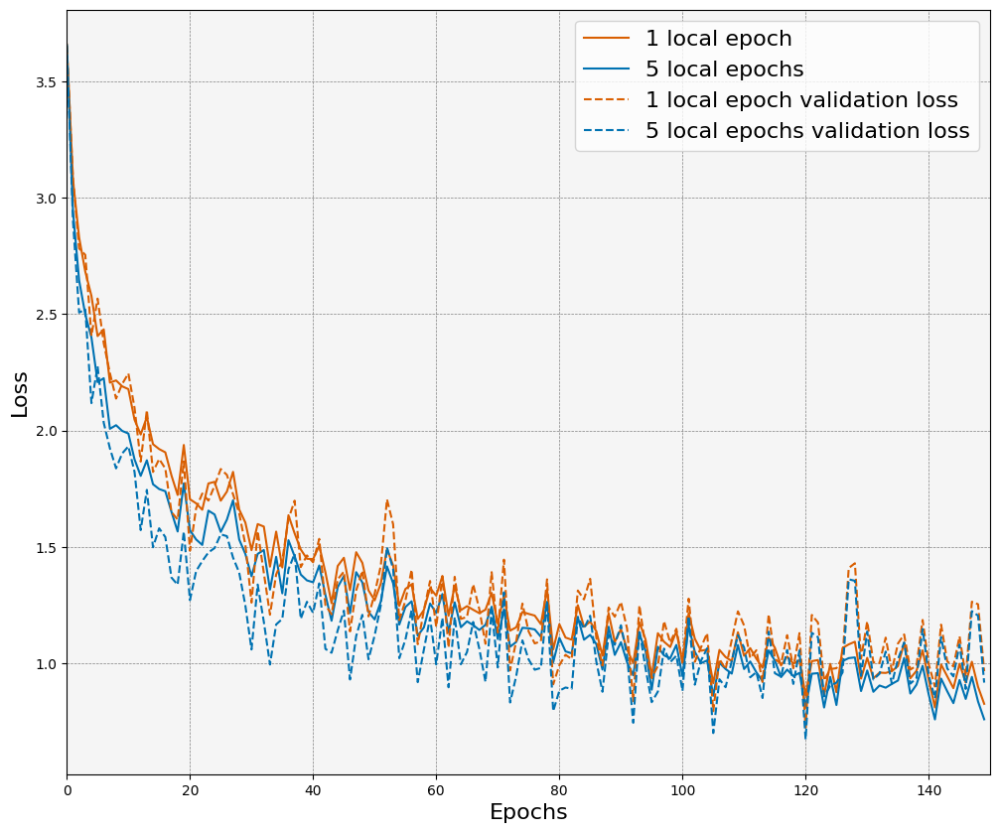

In [ ]:
print('train and validation loss server10 0.00001 lr, 30 participation, with different local epochs')
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(get_average_loss(hamza),color=colors["orange"], label="1 local epoch")
ax.plot(get_average_loss(_5loc10glob), color=colors["blue"], label="5 local epochs")
ax.plot(get_validation_loss(hamza), linestyle="--",color=colors["orange"], label="1 local epoch validation loss")
ax.plot(get_validation_loss(_5loc10glob), linestyle="--", color=colors["blue"], label="5 local epochs validation loss")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)
plt.show()

train (left) and validation loss (right) server10 0.00001 lr, 30 participation, with different local epochs


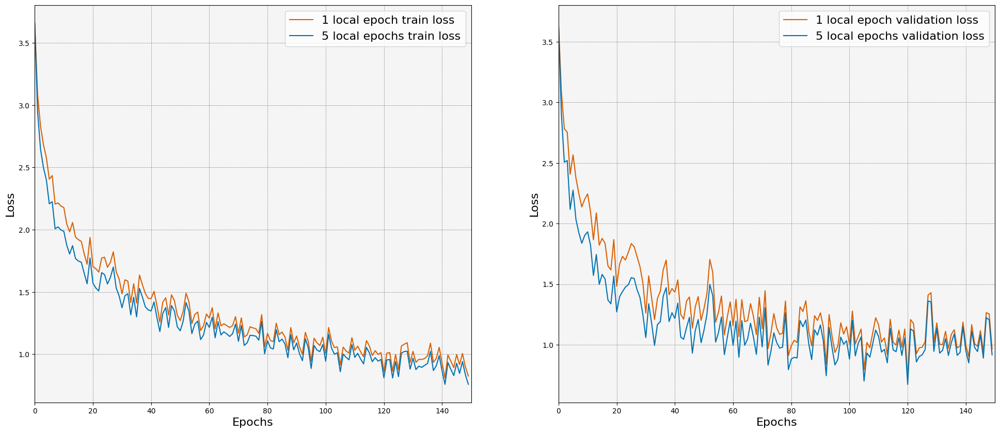

In [ ]:
print('train (left) and validation loss (right) server10 0.00001 lr, 30 participation, with different local epochs')

fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
ax[0].set_facecolor((0.96, 0.96, 0.96))
ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[0].plot(get_average_loss(hamza),color=colors["orange"], label="1 local epoch train loss")
ax[0].plot(get_average_loss(_5loc10glob), color=colors["blue"], label="5 local epochs train loss")
ax[0].set_xlabel("Epochs", fontsize=16)
ax[0].set_ylabel("Loss", fontsize=16)
ax[0].set_xlim(0, 150)
ax[0].legend(fontsize=16)

ax[1].set_facecolor((0.96, 0.96, 0.96))
ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[1].plot(get_validation_loss(hamza),color=colors["orange"], label="1 local epoch validation loss")
ax[1].plot(get_validation_loss(_5loc10glob), color=colors["blue"], label="5 local epochs validation loss")
ax[1].set_xlabel("Epochs", fontsize=16)
ax[1].set_ylabel("Loss", fontsize=16)
ax[1].set_xlim(0, 150)
ax[1].legend(fontsize=16)
plt.show()

# Learning rate effect seq
* lr0_01: Ordered_1localepoch_5server_epochs_at_each_global_round_lr_0_01_server_avg__30_participation_SeqFL_dropout_layer
* lr0_00001: Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_dropout_layer_pkl

### Accuracy

global and local accuracy for different learning rates


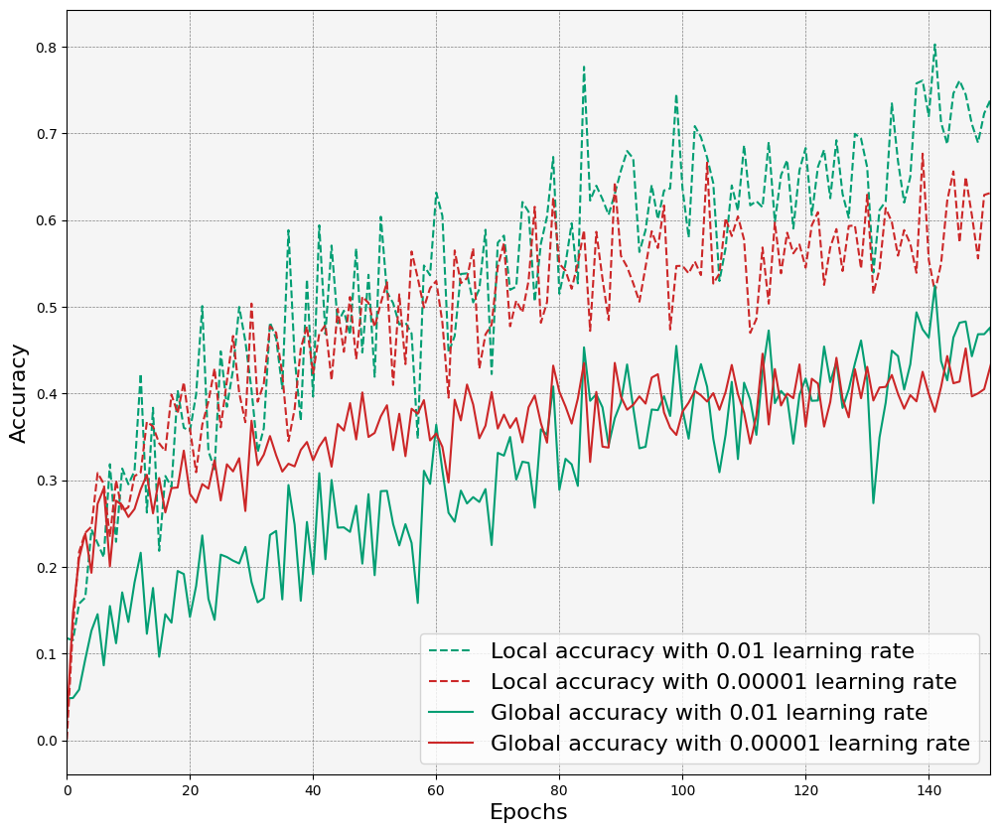

In [ ]:
print('global and local accuracy for different learning rates')
lr0_01_local_acc = get_local_accuracy(lr0_01)
lr0_00001_local_acc = get_local_accuracy(lr0_00001)
lr0_01_global_acc = get_average_global_accuracy_with_no_dict(lr0_01)
lr0_00001_global_acc = get_average_global_accuracy_with_no_dict(lr0_00001)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(lr0_01_local_acc, label="Local accuracy with 0.01 learning rate", linestyle="--", color=colors["green"])
ax.plot(lr0_00001_local_acc, label="Local accuracy with 0.00001 learning rate", linestyle="--", color=colors["red"])
ax.plot(lr0_01_global_acc, label="Global accuracy with 0.01 learning rate", linestyle="-", color=colors["green"])
ax.plot(lr0_00001_global_acc, label="Global accuracy with 0.00001 learning rate", linestyle="-", color=colors["red"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)

global and local accuracy for different learning rates


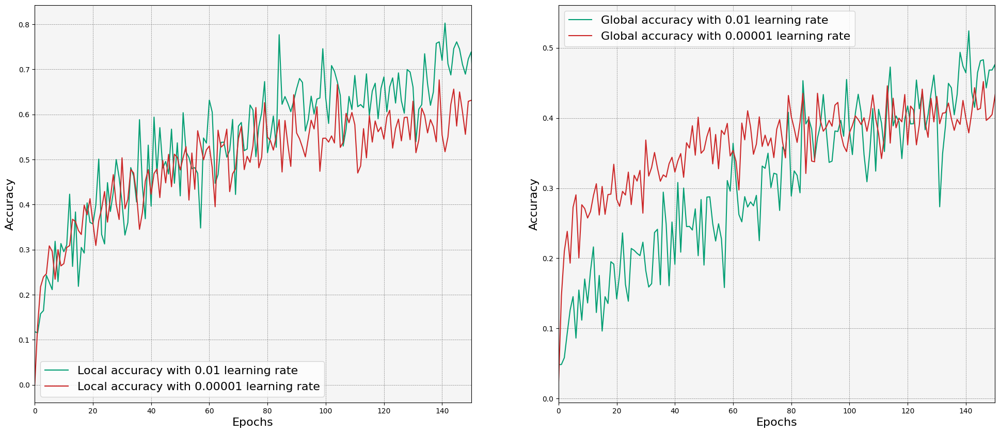

In [ ]:
print('global and local accuracy for different learning rates')
fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
ax[0].set_facecolor((0.96, 0.96, 0.96))
ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[0].plot(lr0_01_local_acc,color=colors["green"],label="Local accuracy with 0.01 learning rate")
ax[0].plot(lr0_00001_local_acc, color=colors["red"],label="Local accuracy with 0.00001 learning rate")
ax[0].set_xlabel("Epochs", fontsize=16)
ax[0].set_ylabel("Accuracy", fontsize=16)
ax[0].set_xlim(0, 150)
ax[0].legend(fontsize=16)

ax[1].set_facecolor((0.96, 0.96, 0.96))
ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[1].plot(lr0_01_global_acc,color=colors["green"], label="Global accuracy with 0.01 learning rate")
ax[1].plot(lr0_00001_global_acc, color=colors["red"], label="Global accuracy with 0.00001 learning rate")
ax[1].set_xlabel("Epochs", fontsize=16)
ax[1].set_ylabel("Accuracy", fontsize=16)
ax[1].set_xlim(0, 150)
ax[1].legend(fontsize=16)
plt.show()

### Loss

train and validation loss server different learning rates


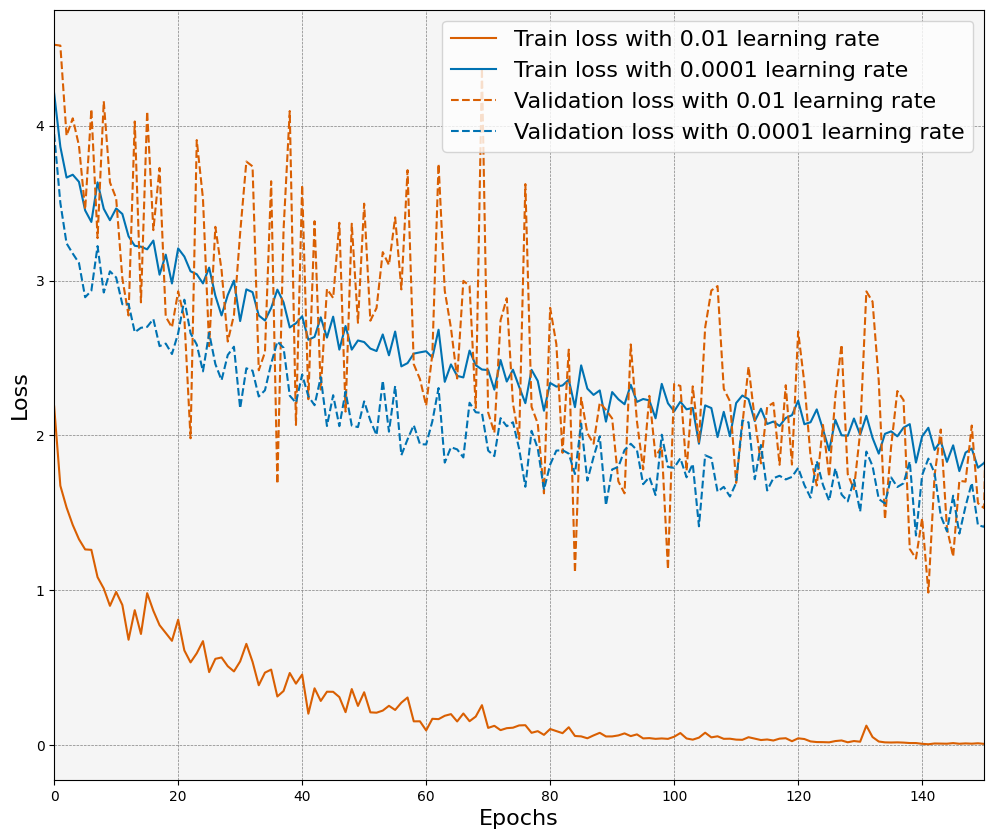

In [ ]:
print('train and validation loss server different learning rates')
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(get_average_loss(lr0_01),color=colors["orange"], label="Train loss with 0.01 learning rate")
ax.plot(get_average_loss(lr0_00001), color=colors["blue"], label="Train loss with 0.0001 learning rate")
ax.plot(get_validation_loss(lr0_01), linestyle="--",color=colors["orange"], label="Validation loss with 0.01 learning rate")
ax.plot(get_validation_loss(lr0_00001), linestyle="--", color=colors["blue"], label="Validation loss with 0.0001 learning rate")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)
plt.show()

train (left) and validation loss (right) server10 0.00001 lr, 30 participation, with different local epochs


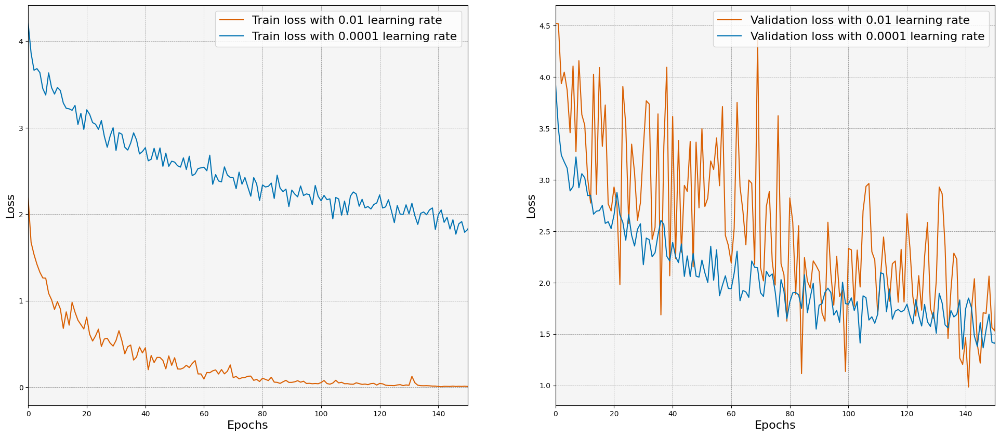

In [ ]:
print('train (left) and validation loss (right) server10 0.00001 lr, 30 participation, with different local epochs')

fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
ax[0].set_facecolor((0.96, 0.96, 0.96))
ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[0].plot(get_average_loss(lr0_01),color=colors["orange"], label="Train loss with 0.01 learning rate")
ax[0].plot(get_average_loss(lr0_00001), color=colors["blue"], label="Train loss with 0.0001 learning rate")
ax[0].set_xlabel("Epochs", fontsize=16)
ax[0].set_ylabel("Loss", fontsize=16)
ax[0].set_xlim(0, 150)
ax[0].legend(fontsize=16)

ax[1].set_facecolor((0.96, 0.96, 0.96))
ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[1].plot(get_validation_loss(lr0_01),color=colors["orange"], label="Validation loss with 0.01 learning rate")
ax[1].plot(get_validation_loss(lr0_00001), color=colors["blue"], label="Validation loss with 0.0001 learning rate")
ax[1].set_xlabel("Epochs", fontsize=16)
ax[1].set_ylabel("Loss", fontsize=16)
ax[1].set_xlim(0, 150)
ax[1].legend(fontsize=16)
plt.show()

# Dropout effect
* 3 nodropout
* 4 withdropout

### Accuracy

global accuracy server10 0.00001 lr, 30 participation, with different local epochs


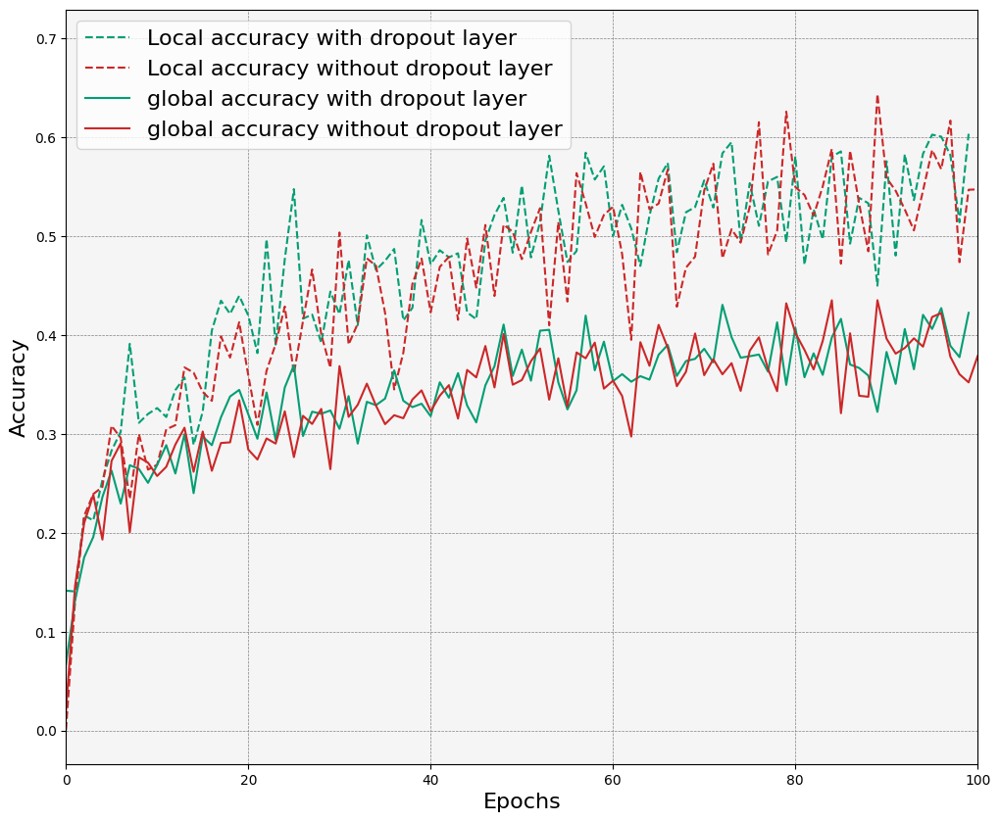

In [ ]:
print('global accuracy server10 0.00001 lr, 30 participation, with different local epochs')
nodropout_local_acc = get_local_accuracy(nodropout)
withdropout_local_acc = get_local_accuracy(withdropout)
nodropout_global_acc = get_average_global_accuracy_with_no_dict(nodropout)
withdropout_global_acc = get_average_global_accuracy_with_no_dict(withdropout)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(nodropout_local_acc, label="Local accuracy with dropout layer", linestyle="--", color=colors["green"])
ax.plot(withdropout_local_acc, label="Local accuracy without dropout layer", linestyle="--", color=colors["red"])
ax.plot(nodropout_global_acc, label="global accuracy with dropout layer", linestyle="-", color=colors["green"])
ax.plot(withdropout_global_acc, label="global accuracy without dropout layer", linestyle="-", color=colors["red"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.set_xlim(0, 100)
ax.legend(fontsize=16)

global and local accuracy for different learning rates


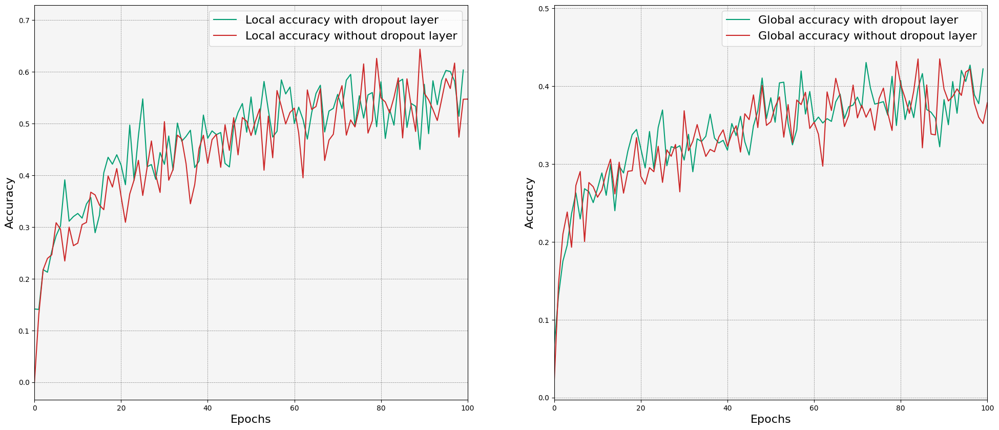

In [ ]:
print('global and local accuracy for different learning rates')
fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
ax[0].set_facecolor((0.96, 0.96, 0.96))
ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[0].plot(nodropout_local_acc,color=colors["green"], label="Local accuracy with dropout layer")
ax[0].plot(withdropout_local_acc, color=colors["red"], label="Local accuracy without dropout layer")
ax[0].set_xlabel("Epochs", fontsize=16)
ax[0].set_ylabel("Accuracy", fontsize=16)
ax[0].set_xlim(0, 100)
ax[0].legend(fontsize=16)

ax[1].set_facecolor((0.96, 0.96, 0.96))
ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[1].plot(nodropout_global_acc,color=colors["green"], label="Global accuracy with dropout layer")
ax[1].plot(withdropout_global_acc, color=colors["red"], label="Global accuracy without dropout layer")
ax[1].set_xlabel("Epochs", fontsize=16)
ax[1].set_ylabel("Accuracy", fontsize=16)
# ax[1].set_xlim(0, 150)
ax[1].set_xlim(0, 100)
ax[1].legend(fontsize=16)
plt.show()

### Loss

In [ ]:
nodropout)
withdropout_local_acc = get_local_accuracy(withdropout)
nodropout_global_acc = get_average_global_accuracy_with_no_dict(nodropout)
withdropout_global_acc = get_average_global_accuracy_with_no_dict(withdropout)

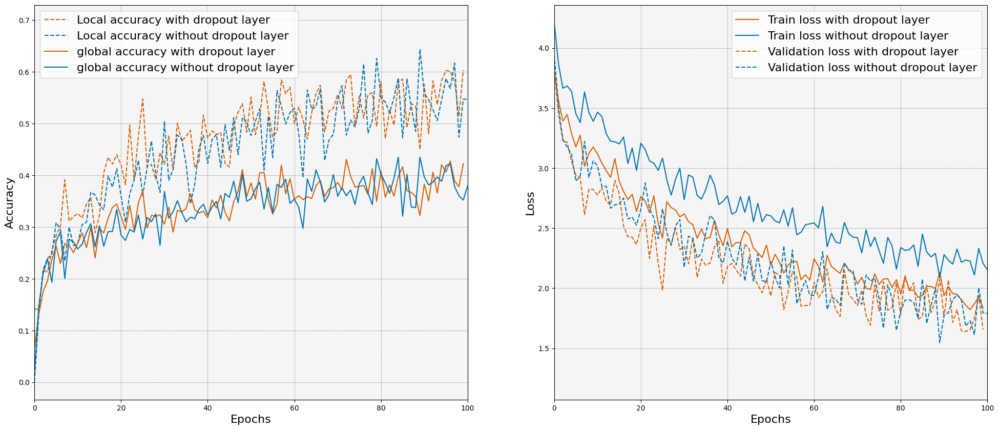

In [ ]:
fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
ax[0].set_facecolor((0.96, 0.96, 0.96))
ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[0].plot(nodropout_local_acc, label="Local accuracy with dropout layer", linestyle="--", color=colors["orange"])
ax[0].plot(withdropout_local_acc, label="Local accuracy without dropout layer", linestyle="--", color=colors["blue"])
ax[0].plot(nodropout_global_acc, label="global accuracy with dropout layer", linestyle="-", color=colors["orange"])
ax[0].plot(withdropout_global_acc, label="global accuracy without dropout layer", linestyle="-", color=colors["blue"])
ax[0].set_xlabel("Epochs", fontsize=16)
ax[0].set_ylabel("Accuracy", fontsize=16)
ax[0].set_xlim(0, 100)
ax[0].legend(fontsize=16)

ax[1].set_facecolor((0.96, 0.96, 0.96))
ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[1].plot(get_average_loss(nodropout),color=colors["orange"], label="Train loss with dropout layer")
ax[1].plot(get_average_loss(withdropout), color=colors["blue"], label="Train loss without dropout layer")
ax[1].plot(get_validation_loss(nodropout), linestyle="--",color=colors["orange"], label="Validation loss with dropout layer")
ax[1].plot(get_validation_loss(withdropout), linestyle="--", color=colors["blue"], label="Validation loss without dropout layer")
ax[1].set_xlabel("Epochs", fontsize=16)
ax[1].set_ylabel("Loss", fontsize=16)
ax[1].set_xlim(0, 100)
ax[1].legend(fontsize=16)
plt.show()

In [ ]:
print('train (left) and validation loss (right) with and without dropout')

fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
ax[0].set_facecolor((0.96, 0.96, 0.96))
ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[0].plot(get_average_loss(nodropout),color=colors["orange"], label="With dropout layer train loss")
ax[0].plot(get_average_loss(withdropout), color=colors["blue"], label="Without dropout layer train loss")
ax[0].set_xlabel("Epochs", fontsize=16)
ax[0].set_ylabel("Loss", fontsize=16)
ax[0].set_xlim(0, 100)
ax[0].legend(fontsize=16)

ax[1].set_facecolor((0.96, 0.96, 0.96))
ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[1].plot(get_validation_loss(nodropout),color=colors["orange"], label="With dropout layer validation loss")
ax[1].plot(get_validation_loss(withdropout), color=colors["blue"], label="Without dropout layer validation loss")
ax[1].set_xlabel("Epochs", fontsize=16)
ax[1].set_ylabel("Loss", fontsize=16)
ax[1].set_xlim(0, 100)
ax[1].legend(fontsize=16)
plt.show()

train and validation loss with and without dropout


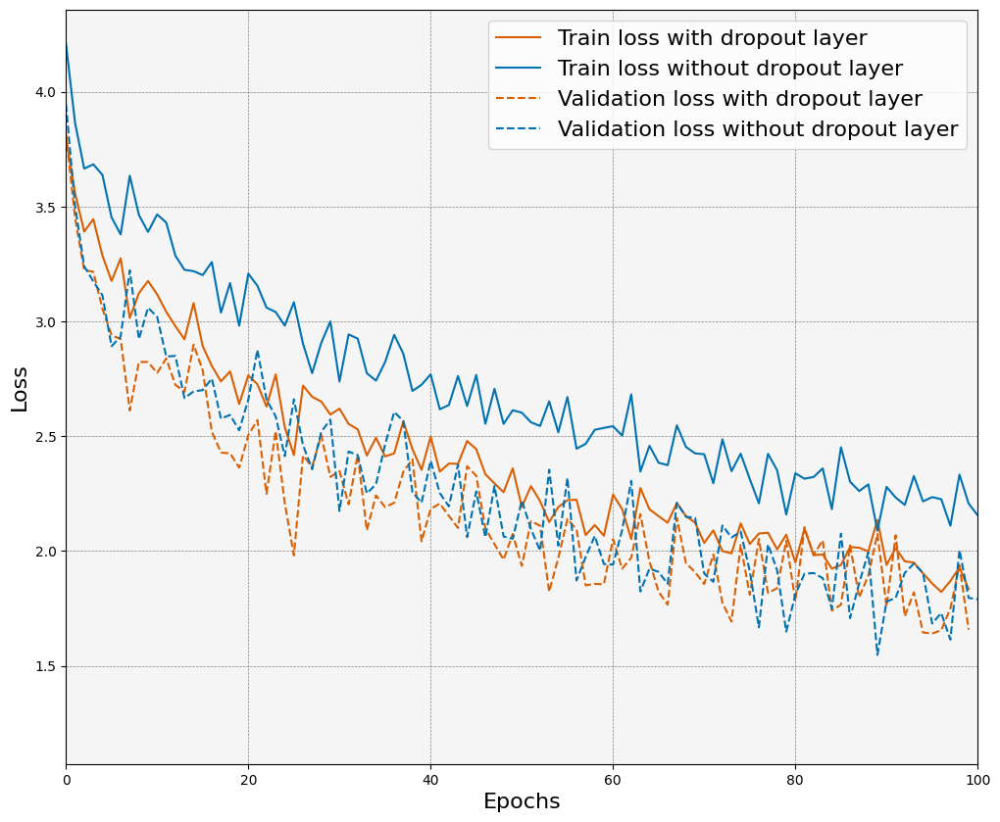

In [ ]:
print('train and validation loss with and without dropout')
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(get_average_loss(nodropout),color=colors["orange"], label="Train loss with dropout layer")
ax.plot(get_average_loss(withdropout), color=colors["blue"], label="Train loss without dropout layer")
ax.plot(get_validation_loss(nodropout), linestyle="--",color=colors["orange"], label="Validation loss with dropout layer")
ax.plot(get_validation_loss(withdropout), linestyle="--", color=colors["blue"], label="Validation loss without dropout layer")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, 100)
ax.legend(fontsize=16)
plt.show()

train (left) and validation loss (right) with and without dropout


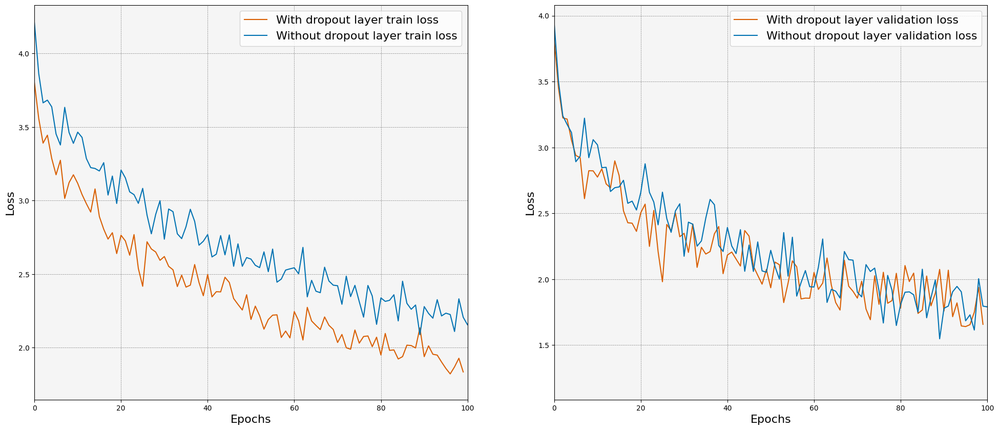

In [ ]:
print('train (left) and validation loss (right) with and without dropout')

fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
ax[0].set_facecolor((0.96, 0.96, 0.96))
ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[0].plot(get_average_loss(nodropout),color=colors["orange"], label="With dropout layer train loss")
ax[0].plot(get_average_loss(withdropout), color=colors["blue"], label="Without dropout layer train loss")
ax[0].set_xlabel("Epochs", fontsize=16)
ax[0].set_ylabel("Loss", fontsize=16)
ax[0].set_xlim(0, 100)
ax[0].legend(fontsize=16)

ax[1].set_facecolor((0.96, 0.96, 0.96))
ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[1].plot(get_validation_loss(nodropout),color=colors["orange"], label="With dropout layer validation loss")
ax[1].plot(get_validation_loss(withdropout), color=colors["blue"], label="Without dropout layer validation loss")
ax[1].set_xlabel("Epochs", fontsize=16)
ax[1].set_ylabel("Loss", fontsize=16)
ax[1].set_xlim(0, 100)
ax[1].legend(fontsize=16)
plt.show()

### Dropout new by yasmine

with dropout

In [ ]:
seq_drop_out_global_accuracies_dict = {ds: [] for ds in names}
for t, round_list_of_dicts in seq_drop_out.global_accuracies_dict.items():
    for ds in names:
        temp = []
        for client in round_list_of_dicts:
            temp.append(client[ds])
        seq_drop_out_global_accuracies_dict[ds].append(np.mean(temp))

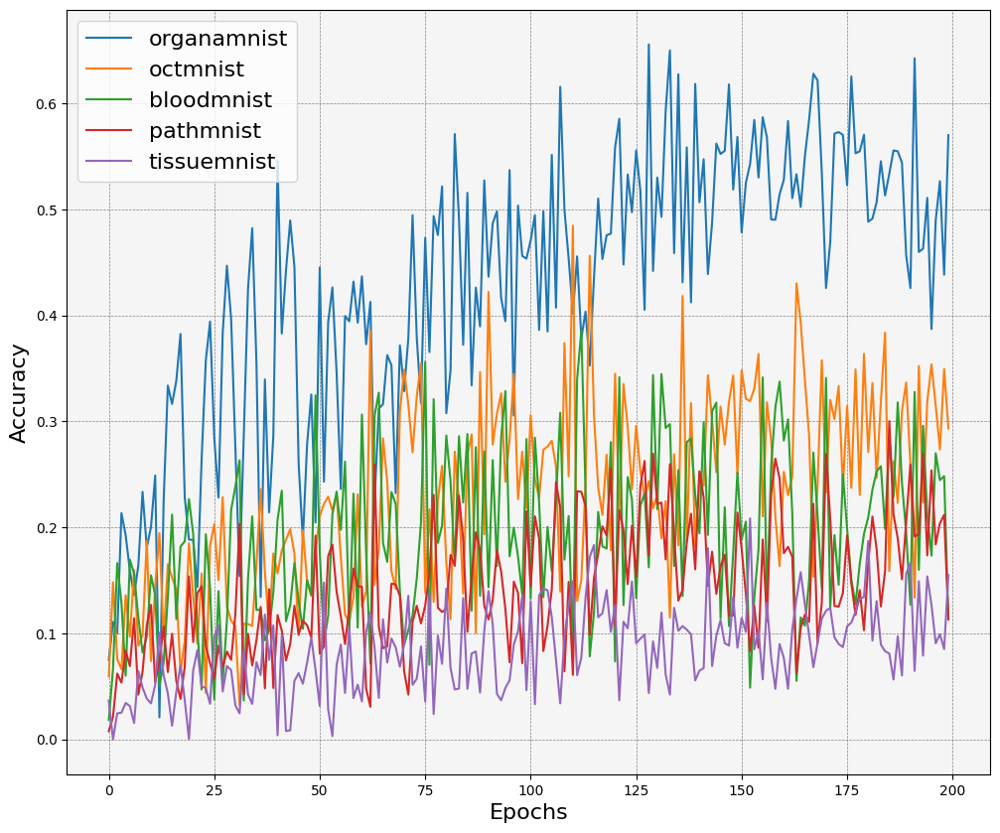

In [122]:
fig, ax = plt.subplots(figsize=(12,10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)

for k, v in seq_drop_out_global_accuracies_dict.items():
    plt.plot(v, label=k)
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.legend(fontsize=16)

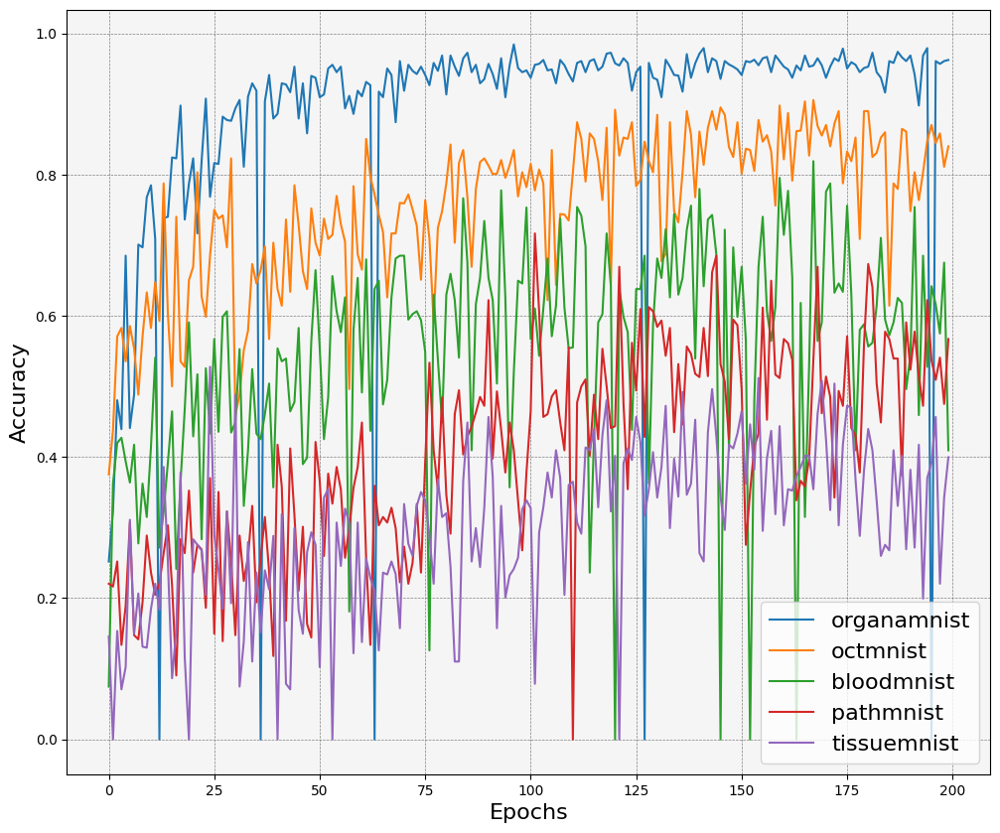

In [112]:
fig, ax = plt.subplots(figsize=(12,10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)

for k, v in seq_drop_out.avg_local_acc_dict_per_dataset.items():
    plt.plot(v, label=k)
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.legend(fontsize=16)

without dropout

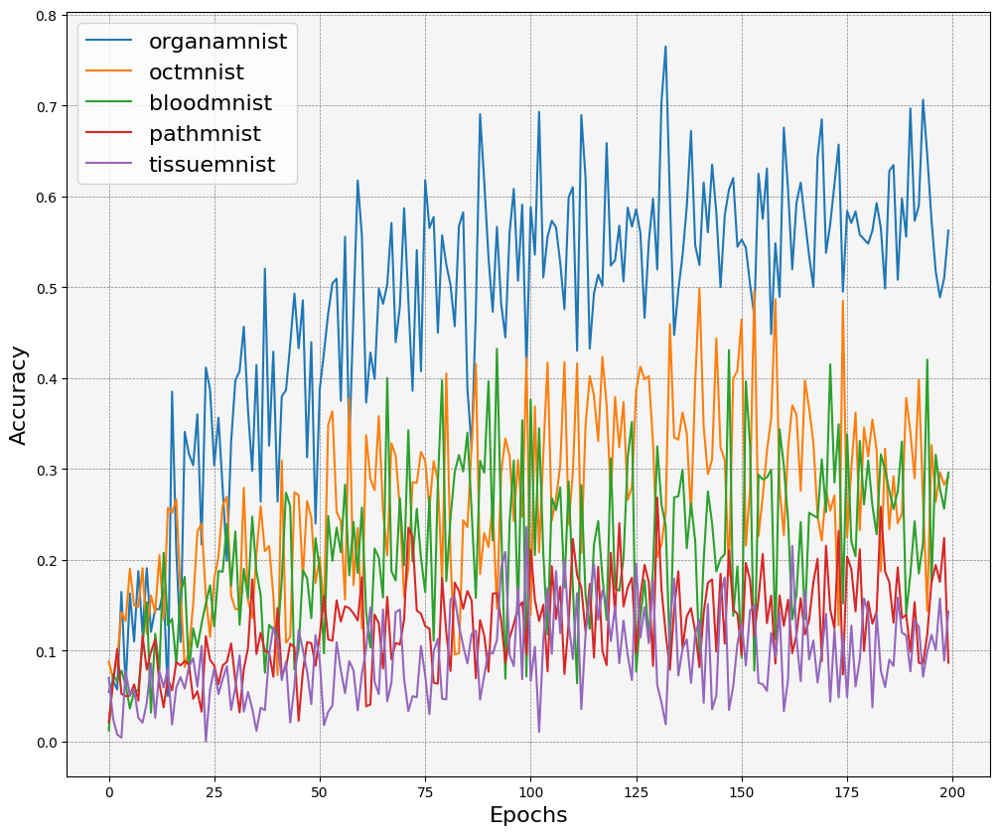

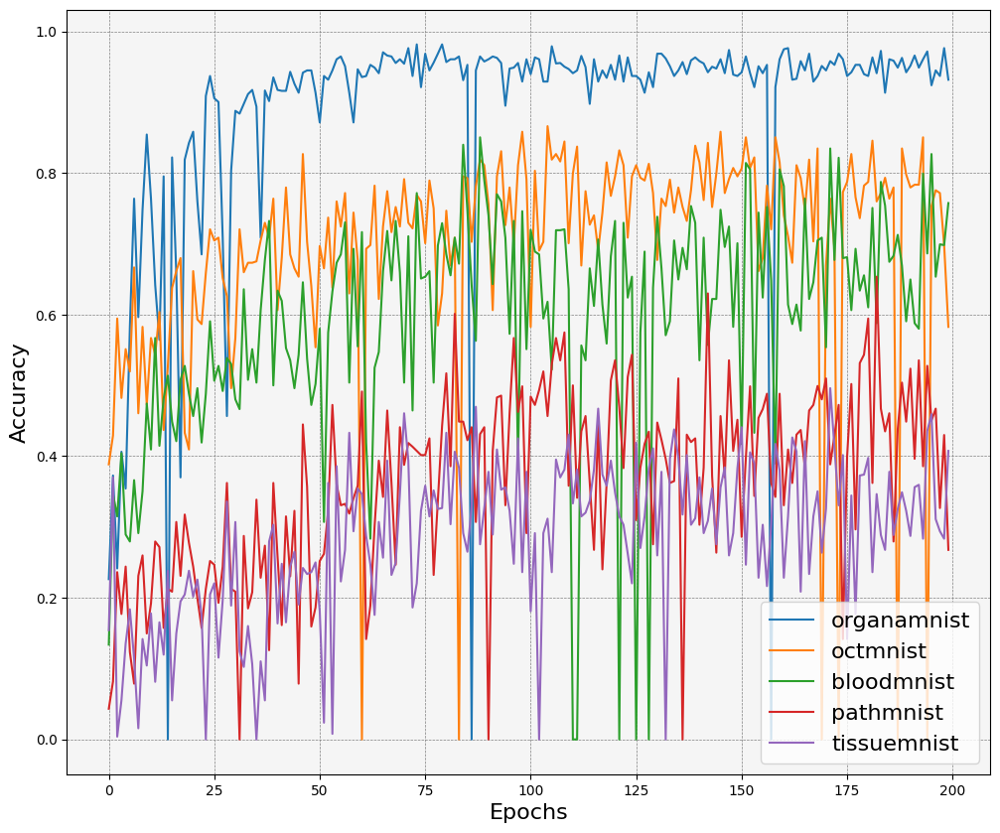

In [123]:
seq_no_drop_out_global_accuracies_dict = {ds: [] for ds in names}
for t, round_list_of_dicts in seq_no_drop_out.global_accuracies_dict.items():
    for ds in names:
        temp = []
        for client in round_list_of_dicts:
            temp.append(client[ds])
        seq_no_drop_out_global_accuracies_dict[ds].append(np.mean(temp))
fig, ax = plt.subplots(figsize=(12,10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)

for k, v in seq_no_drop_out_global_accuracies_dict.items():
    plt.plot(v, label=k)
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.legend(fontsize=16)
plt.show()
fig, ax = plt.subplots(figsize=(12,10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)

for k, v in seq_no_drop_out.avg_local_acc_dict_per_dataset.items():
    plt.plot(v, label=k)
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.legend(fontsize=16)

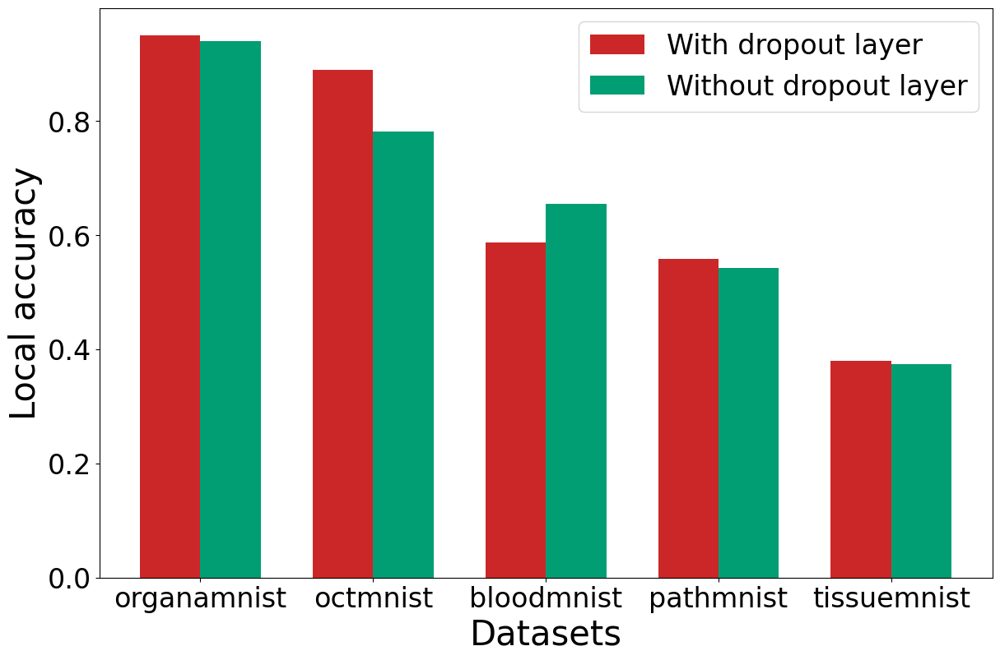

In [532]:
data = {}
# avg_local_acc_dict_per_dataset
for ds in names:
    temp = []
    temp.append(seq_drop_out.avg_local_acc_dict_per_dataset[ds][179])
    temp.append(seq_no_drop_out.avg_local_acc_dict_per_dataset[ds][179])
    data[ds] = set(temp)

# Extract dataset names and results
datasets = list(data.keys())
results1, results2 = zip(*data.values())

# Set the positions of the bars on the x-axis
x = np.arange(len(datasets))
bar_width = 0.35
plt.figure(figsize=(14,9))
# Plotting the bars
plt.bar(x - bar_width/2, results1, width=bar_width, label='With dropout layer', color=colors['red'])
plt.bar(x + bar_width/2, results2, width=bar_width, label='Without dropout layer', color=colors['green'])
# Adding labels and title
plt.xlabel('Datasets', fontsize=30)
plt.ylabel('Local accuracy', fontsize=30)
# plt.title('Comparison of Results for Different Datasets and Experiments')
plt.xticks(x, datasets, fontsize=24)
plt.yticks(fontsize=24)
plt.legend(fontsize=24)

plt.savefig("../../resultsss.png")
# Display the plot
plt.show()



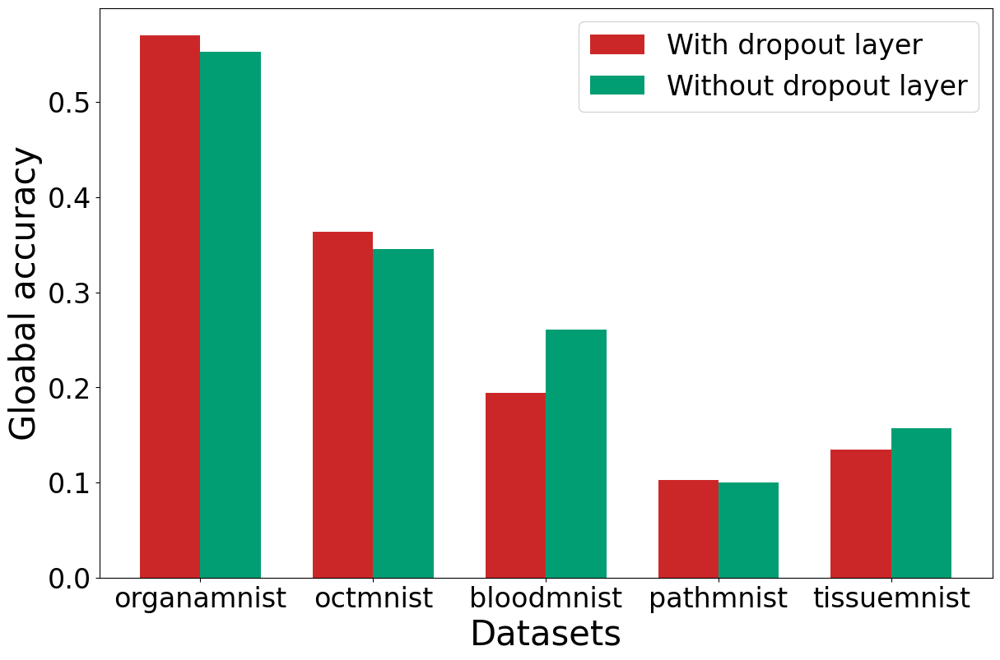

In [531]:
import matplotlib.pyplot as plt
seq_no_drop_out_global_accuracies_dict
data = {}
for ds in names:
    temp = []
    temp.append(seq_drop_out_global_accuracies_dict[ds][179])
    temp.append(seq_no_drop_out_global_accuracies_dict[ds][179])
    data[ds] = set(temp)

# Extract dataset names and results
datasets = list(data.keys())
results1, results2 = zip(*data.values())

# Set the positions of the bars on the x-axis
x = np.arange(len(datasets))
bar_width = 0.35
plt.figure(figsize=(14,9))
# Plotting the bars
plt.bar(x - bar_width/2, results1, width=bar_width, label='With dropout layer', color=colors['red'])
plt.bar(x + bar_width/2, results2, width=bar_width, label='Without dropout layer', color=colors['green'])
# Adding labels and title
plt.xlabel('Datasets', fontsize=30)
plt.ylabel('Gloabal accuracy', fontsize=30)
# plt.title('Comparison of Results for Different Datasets and Experiments')
plt.xticks(x, datasets, fontsize=24)
plt.yticks(fontsize=24)
plt.legend(fontsize=24)

plt.savefig("../../resultsss_.png")
# Display the plot
plt.show()



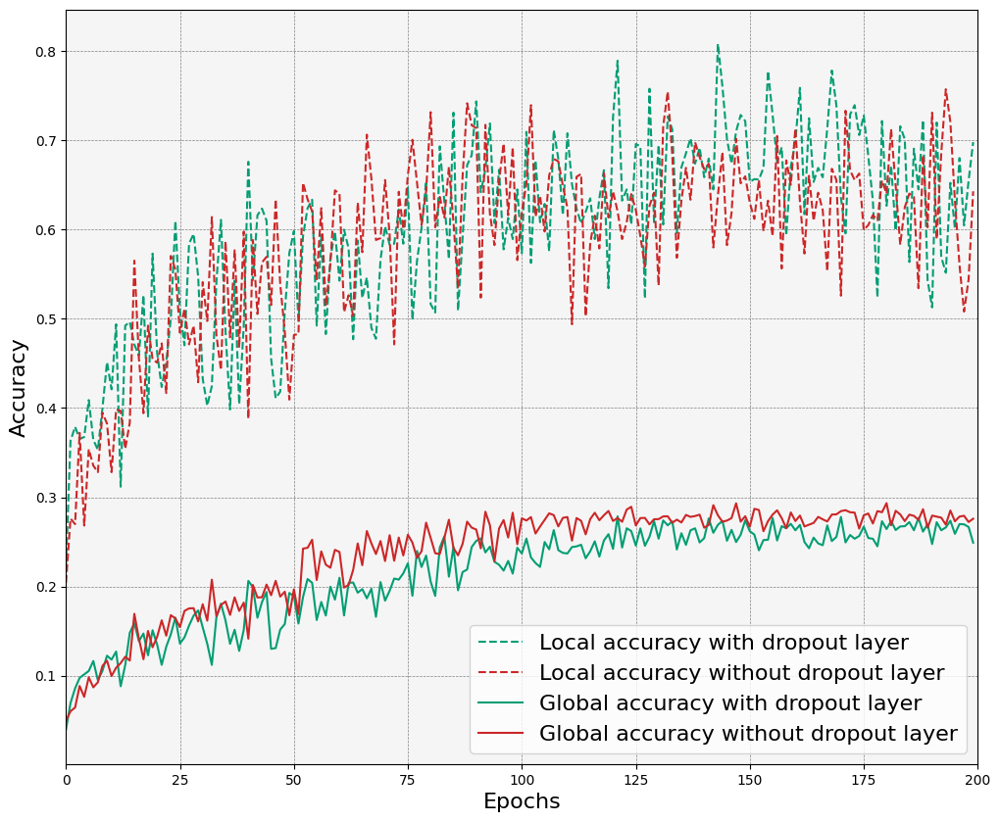

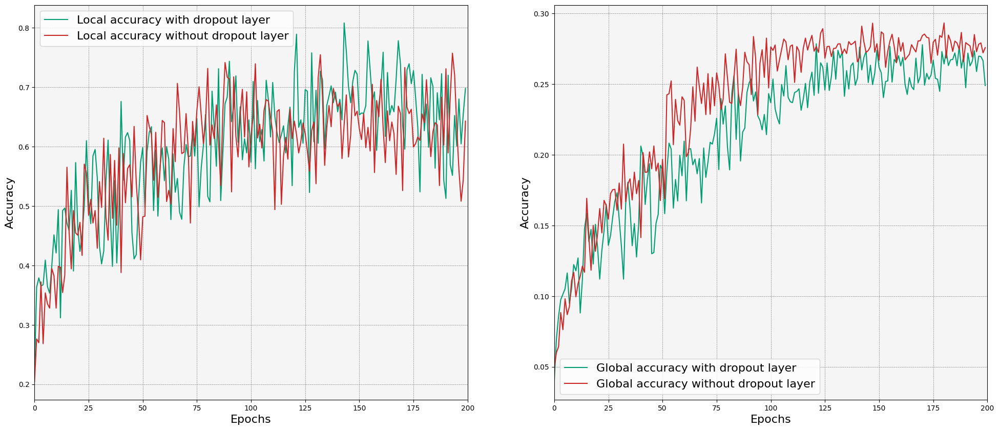

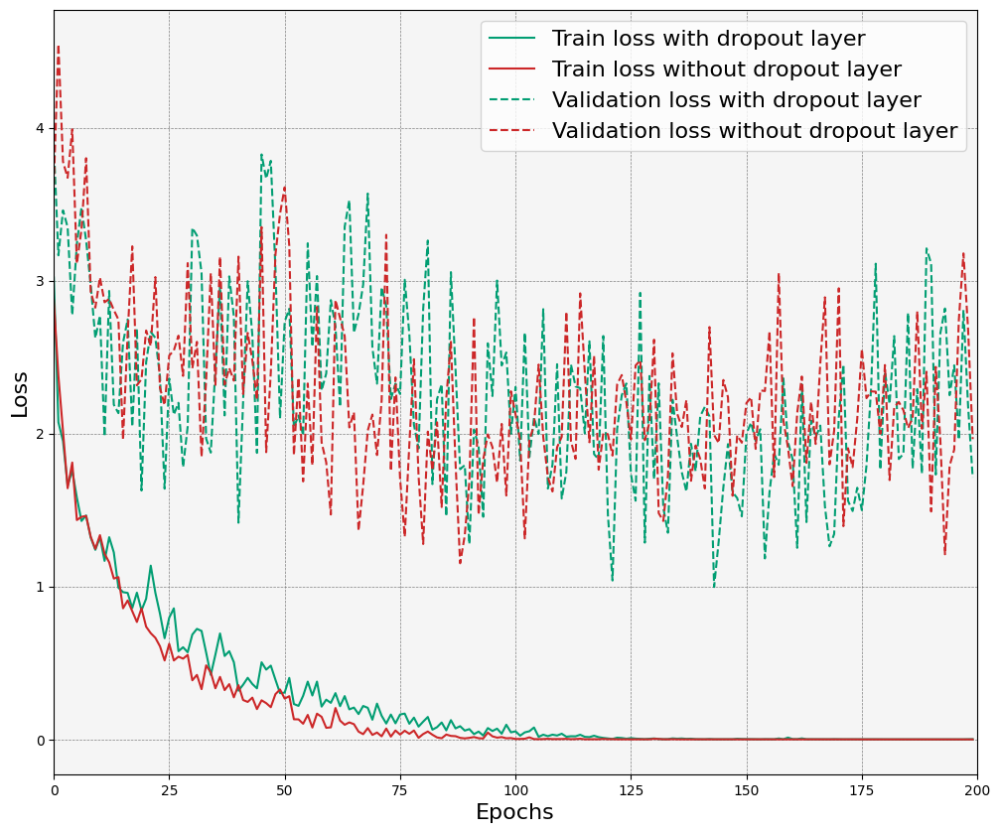

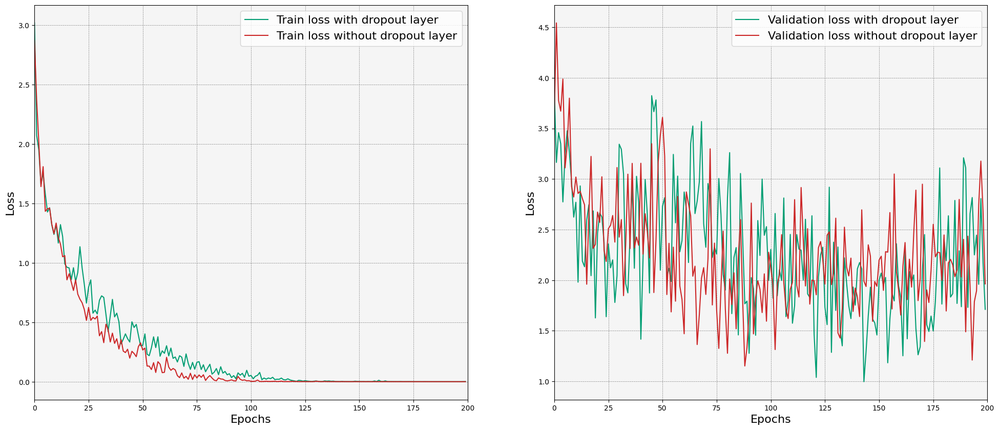

In [109]:
labels1=[
    "Local accuracy with dropout layer",
    "Local accuracy without dropout layer",
    "Global accuracy with dropout layer",
    "Global accuracy without dropout layer"
]
labels2=[
    "Local accuracy with dropout layer",
    "Local accuracy without dropout layer",
    "Global accuracy with dropout layer",
    "Global accuracy without dropout layer"
]
labels3=[
    "Train loss with dropout layer",
    "Train loss without dropout layer",
    "Validation loss with dropout layer",
    "Validation loss without dropout layer"
]
labels4=[
    "Train loss with dropout layer",
    "Train loss without dropout layer",
    "Validation loss with dropout layer",
    "Validation loss without dropout layer"
]
plot_local_global_accuracy(seq_drop_out, seq_no_drop_out, labels1)
plot_local_global_accuracy_sperated(seq_drop_out, seq_no_drop_out, labels2)
plot_train_val_loss(seq_drop_out, seq_no_drop_out, labels3)
plot_train_val_loss_seperated(seq_drop_out, seq_no_drop_out, labels4)

# Reordering

### Accuracy

global accuracy server10 0.00001 lr, 30 participation, with different local epochs


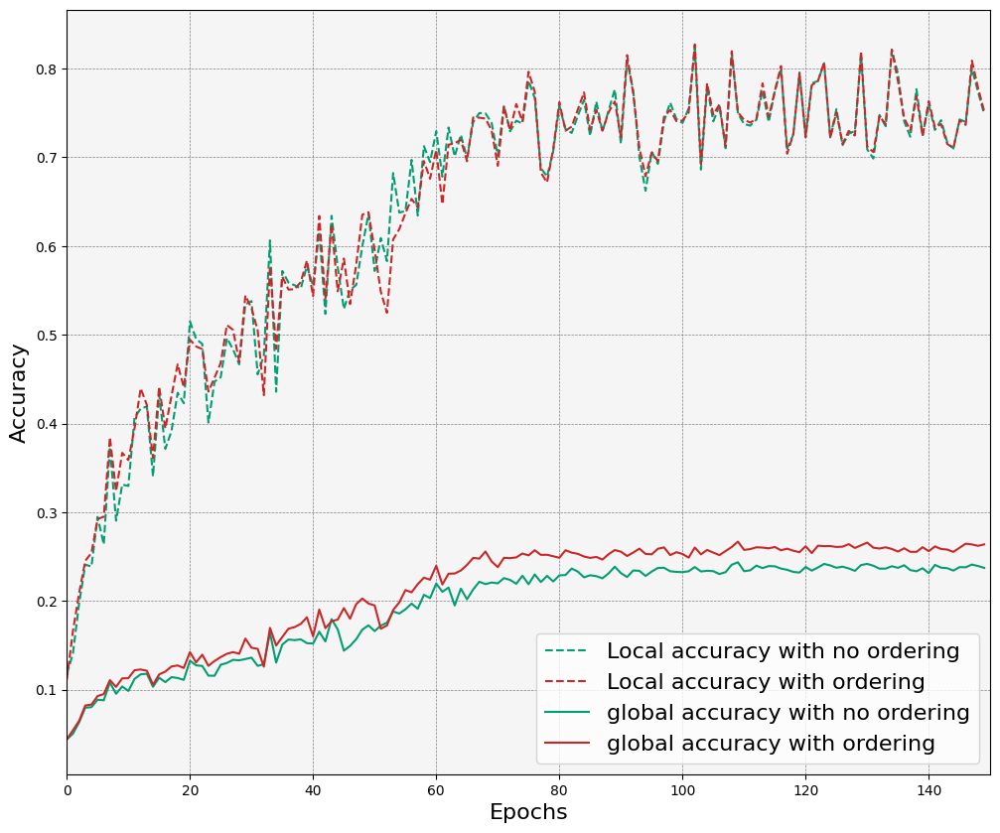

In [ ]:
print('global accuracy server10 0.00001 lr, 30 participation, with different local epochs')
colab_5_not_ordered_local_acc = get_local_accuracy(colab_5_not_ordered)
colab_5_local_acc = get_local_accuracy(colab_5)
colab_5_not_ordered_global_acc = get_average_global_accuracy_with_no_dict(colab_5_not_ordered)
colab_5_global_acc = get_average_global_accuracy_with_no_dict(colab_5)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(colab_5_not_ordered_local_acc, label="Local accuracy with no ordering", linestyle="--", color=colors["green"])
ax.plot(colab_5_local_acc, label="Local accuracy with ordering", linestyle="--", color=colors["red"])
ax.plot(colab_5_not_ordered_global_acc, label="global accuracy with no ordering", linestyle="-", color=colors["green"])
ax.plot(colab_5_global_acc, label="global accuracy with ordering", linestyle="-", color=colors["red"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)

global and local accuracy for different learning rates


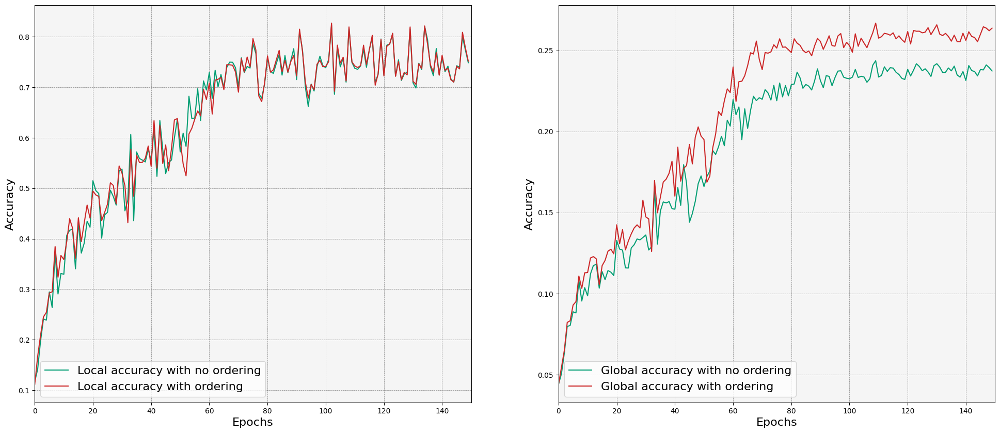

In [ ]:
print('global and local accuracy for different learning rates')
fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
ax[0].set_facecolor((0.96, 0.96, 0.96))
ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[0].plot(colab_5_not_ordered_local_acc,color=colors["green"], label="Local accuracy with no ordering")
ax[0].plot(colab_5_local_acc, color=colors["red"], label="Local accuracy with ordering")
ax[0].set_xlabel("Epochs", fontsize=16)
ax[0].set_ylabel("Accuracy", fontsize=16)
ax[0].set_xlim(0, 150)
ax[0].legend(fontsize=16)

ax[1].set_facecolor((0.96, 0.96, 0.96))
ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[1].plot(colab_5_not_ordered_global_acc,color=colors["green"], label="Global accuracy with no ordering")
ax[1].plot(colab_5_global_acc, color=colors["red"], label="Global accuracy with ordering")
ax[1].set_xlabel("Epochs", fontsize=16)
ax[1].set_ylabel("Accuracy", fontsize=16)
ax[1].set_xlim(0, 150)
# ax[1].set_xlim(0, 100)
ax[1].legend(fontsize=16)
plt.show()

### Loss

##### Final local epochs seq

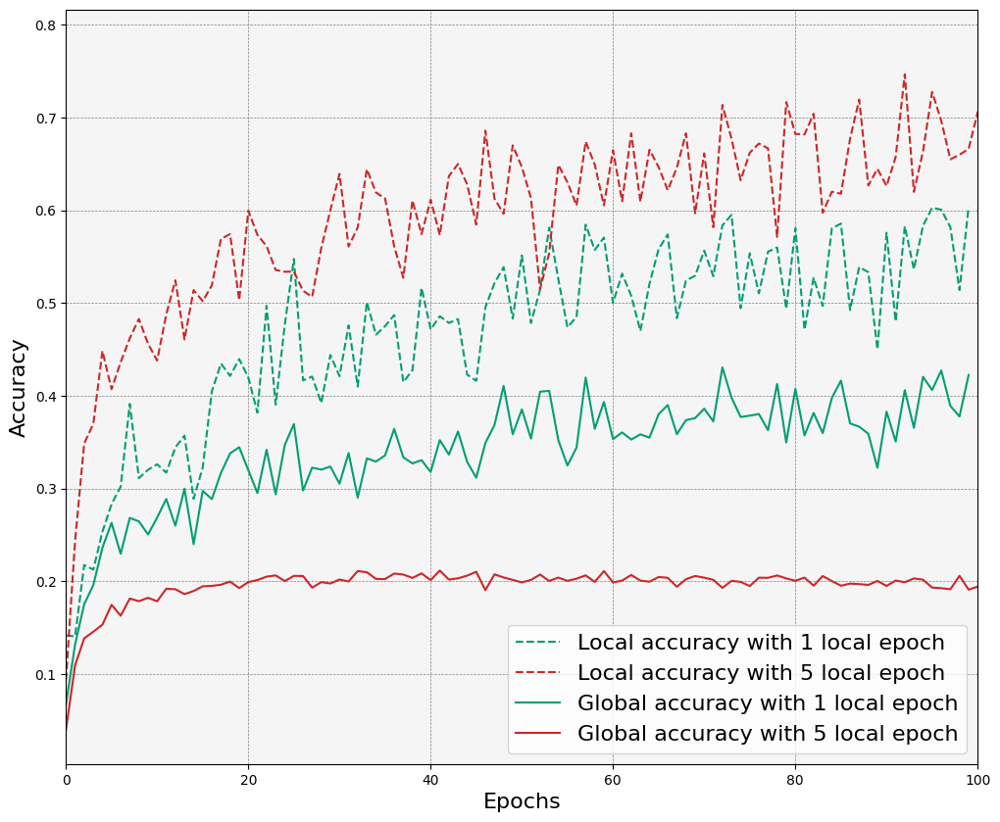

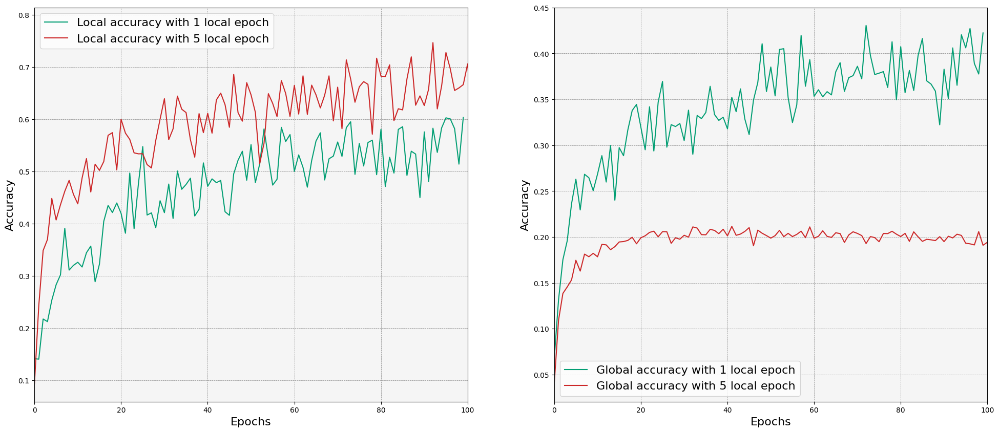

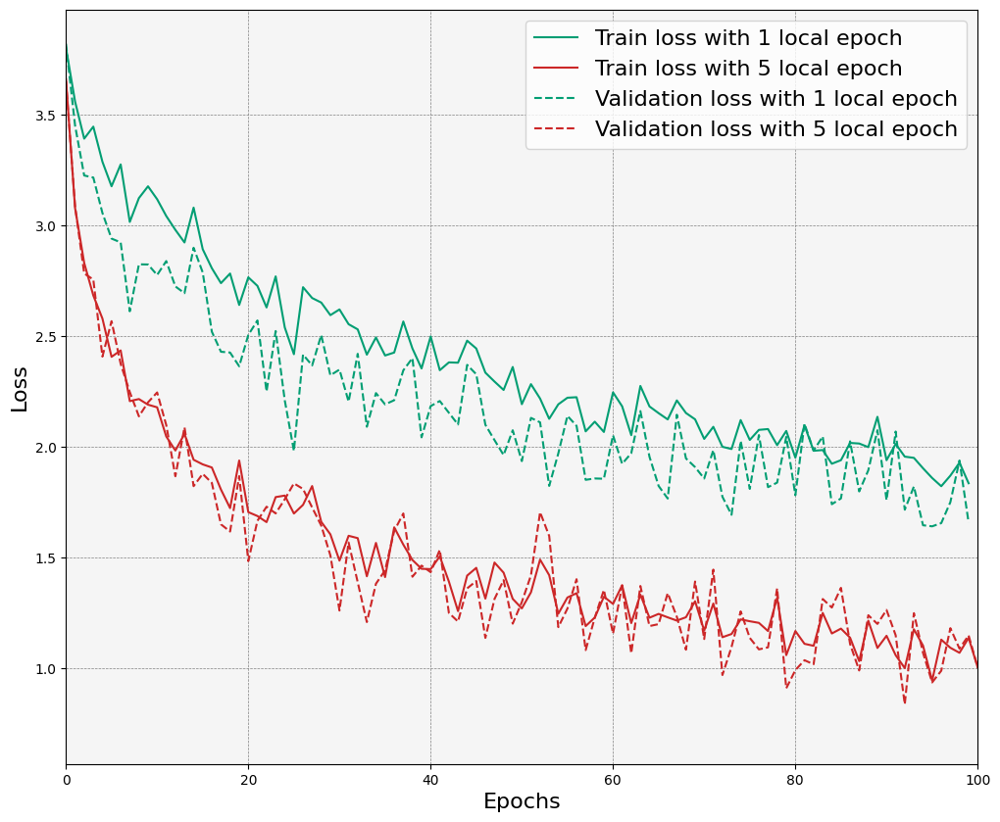

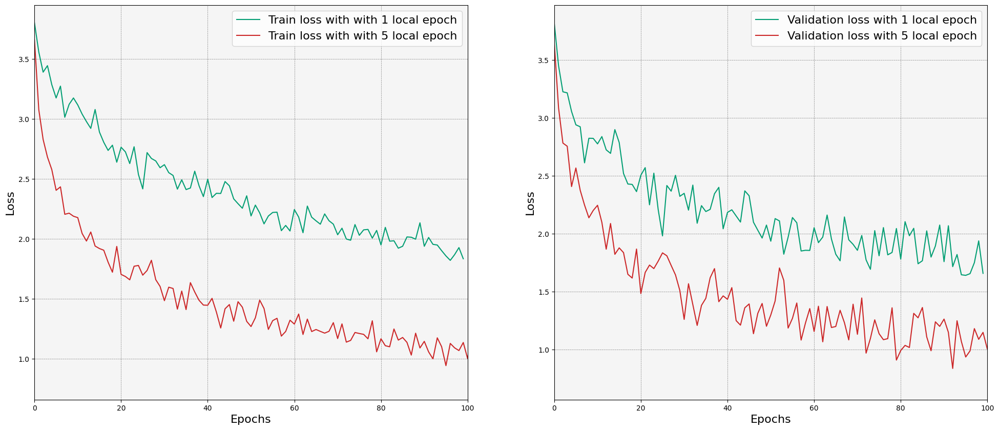

In [ ]:
# Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_pkl
# ordered_5local_10server_0_00001_30partiipation
plot_local_global_accuracy(Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_pkl, ordered_5local_10server_0_00001_30partiipation, labels1)
plot_local_global_accuracy_sperated(Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_pkl, ordered_5local_10server_0_00001_30partiipation, labels2)
plot_train_val_loss(Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_pkl, ordered_5local_10server_0_00001_30partiipation, labels3)
plot_train_val_loss_seperated(Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_pkl, ordered_5local_10server_0_00001_30partiipation, labels4)

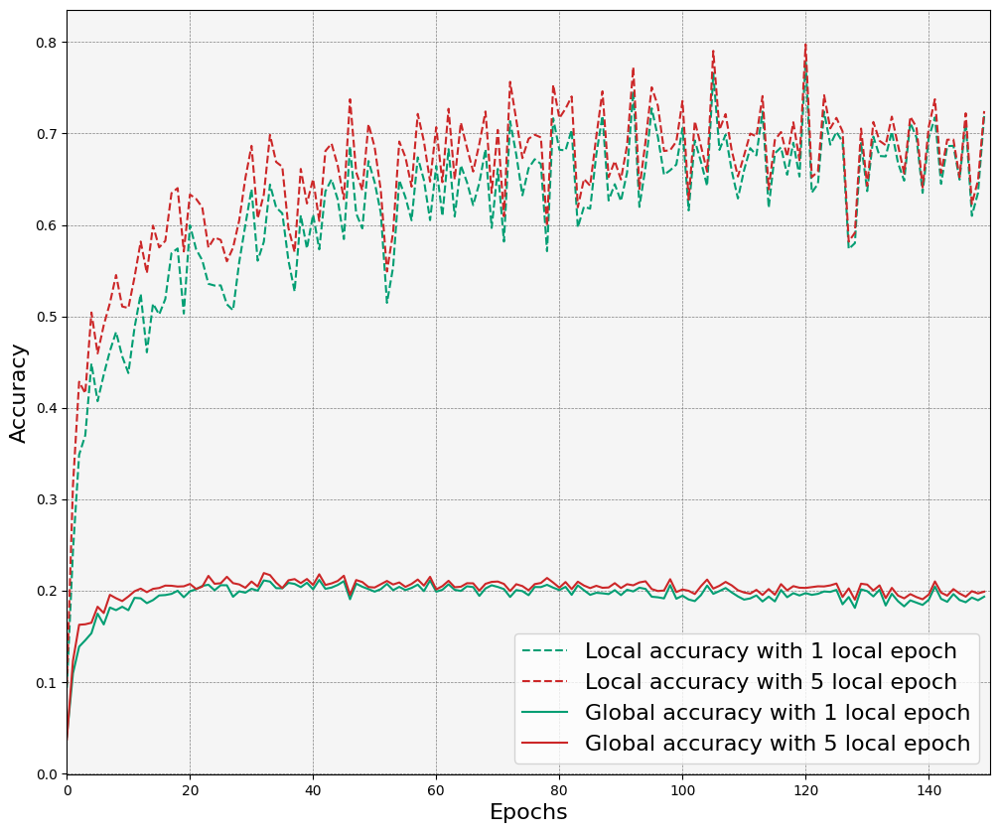

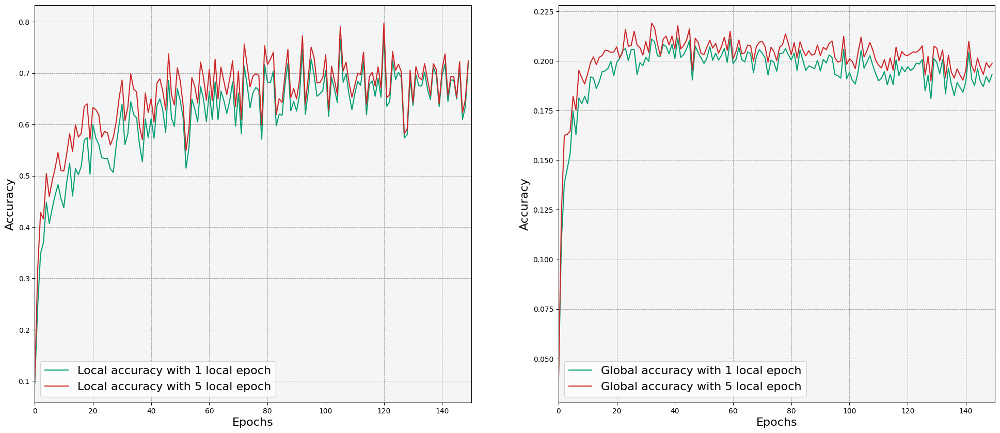

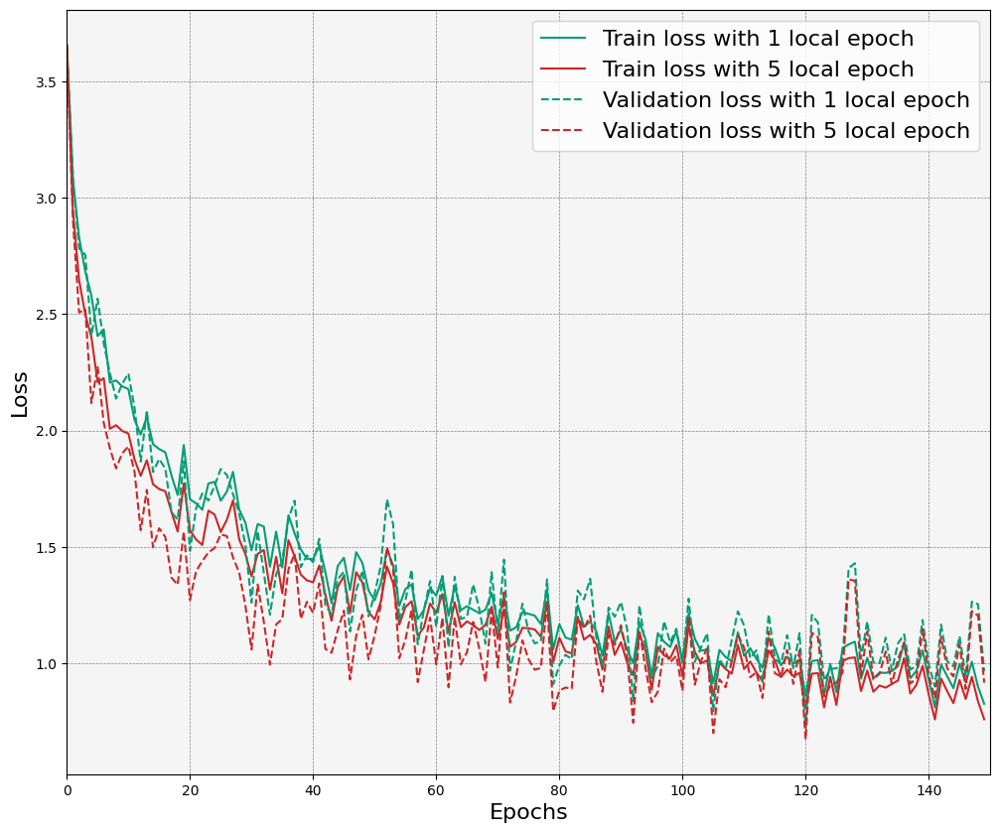

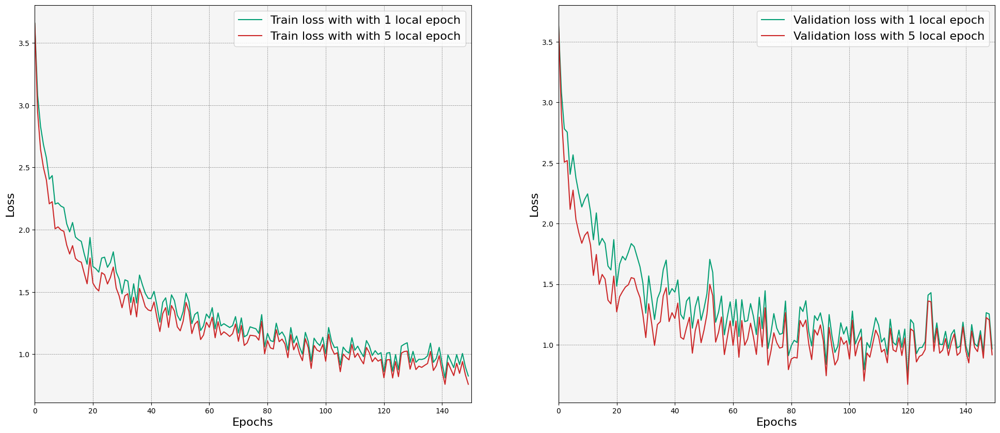

In [108]:
labels1=[
    "Local accuracy with 1 local epoch",
    "Local accuracy with 5 local epoch",
    "Global accuracy with 1 local epoch",
    "Global accuracy with 5 local epoch"
]
labels2=[
    "Local accuracy with 1 local epoch",
    "Local accuracy with 5 local epoch",
    "Global accuracy with 1 local epoch",
    "Global accuracy with 5 local epoch"
]
labels3=[
    "Train loss with 1 local epoch",
    "Train loss with 5 local epoch",
    "Validation loss with 1 local epoch",
    "Validation loss with 5 local epoch"
]
labels4=[
    "Train loss with with 1 local epoch",
    "Train loss with with 5 local epoch",
    "Validation loss with 1 local epoch",
    "Validation loss with 5 local epoch"
]
plot_local_global_accuracy(hamza, _5loc10glob, labels1)
plot_local_global_accuracy_sperated(hamza, _5loc10glob, labels2)
plot_train_val_loss(hamza, _5loc10glob, labels3)
plot_train_val_loss_seperated(hamza, _5loc10glob, labels4)

global accuracy server10 0.00001 lr, 30 participation, with different local epochs


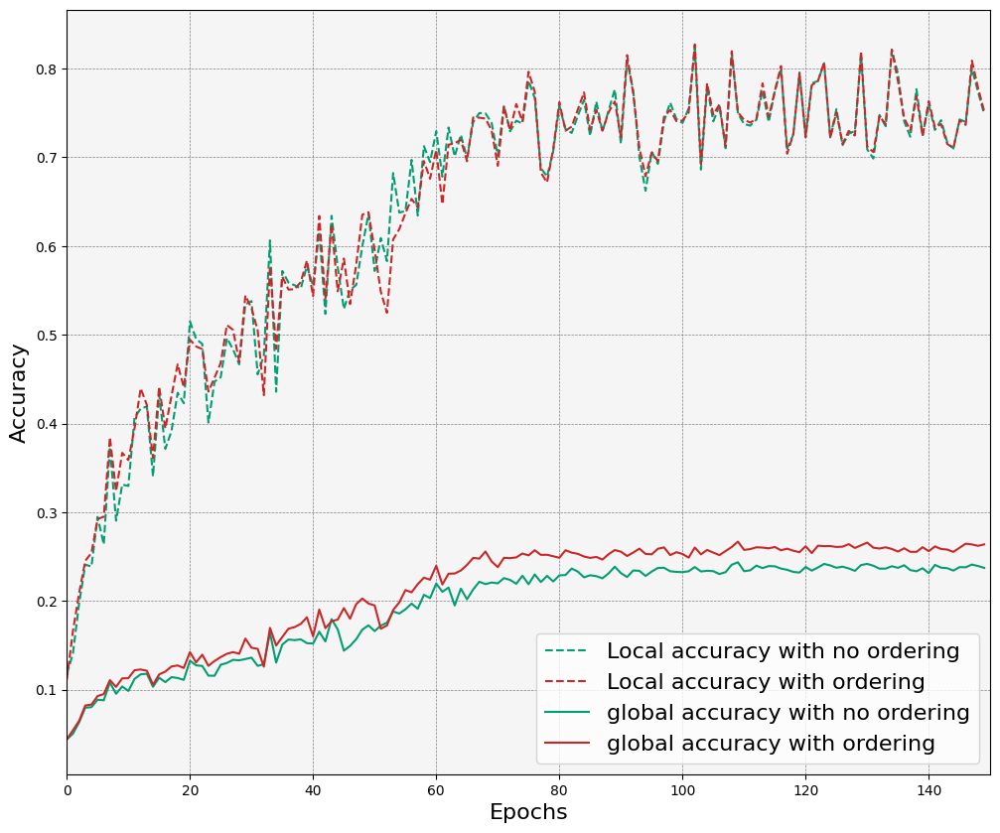

In [ ]:
print('global accuracy server10 0.00001 lr, 30 participation, with different local epochs')
colab_5_not_ordered_local_acc = get_local_accuracy(colab_5_not_ordered)
colab_5_local_acc = get_local_accuracy(colab_5)
colab_5_not_ordered_global_acc = get_average_global_accuracy_with_no_dict(colab_5_not_ordered)
colab_5_global_acc = get_average_global_accuracy_with_no_dict(colab_5)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(colab_5_not_ordered_local_acc, label="Local accuracy with no ordering", linestyle="--", color=colors["green"])
ax.plot(colab_5_local_acc, label="Local accuracy with ordering", linestyle="--", color=colors["red"])
ax.plot(colab_5_not_ordered_global_acc, label="global accuracy with no ordering", linestyle="-", color=colors["green"])
ax.plot(colab_5_global_acc, label="global accuracy with ordering", linestyle="-", color=colors["red"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)

##### Final learning rate seq

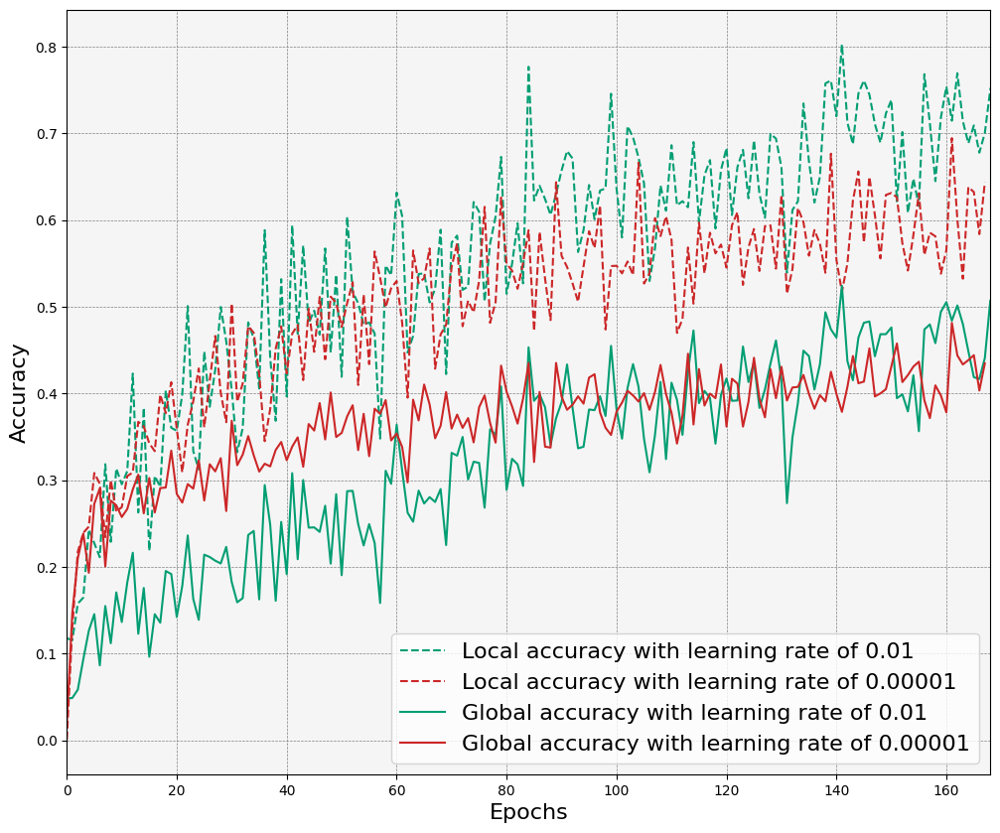

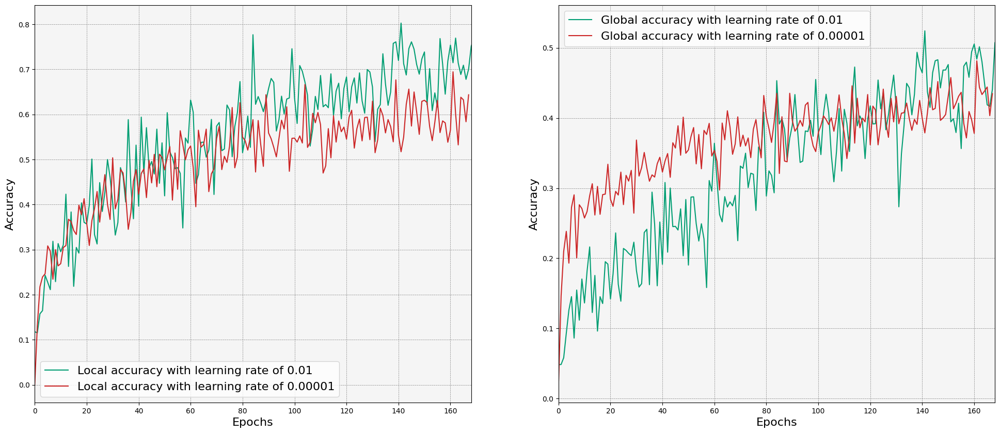

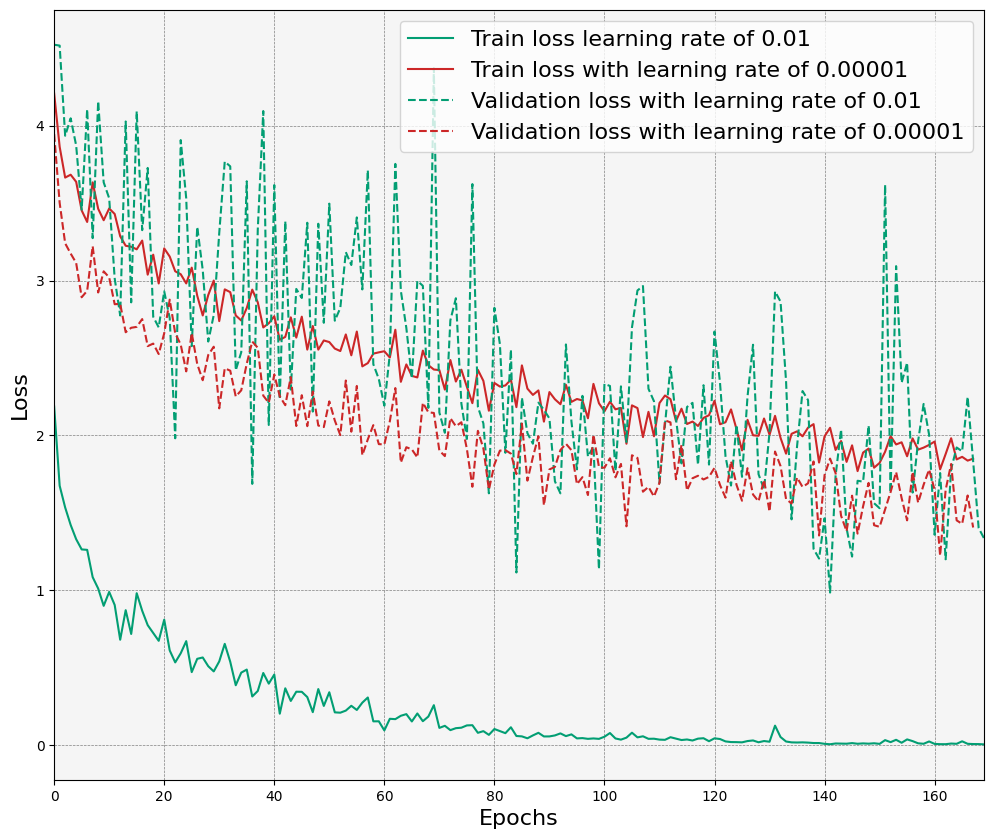

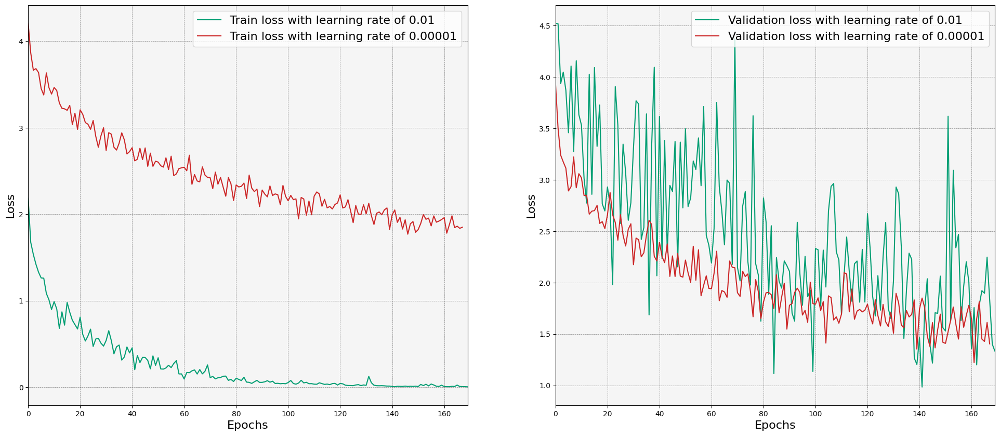

In [101]:
labels1=[
    "Local accuracy with learning rate of 0.01",
    "Local accuracy with learning rate of 0.00001",
    "Global accuracy with learning rate of 0.01",
    "Global accuracy with learning rate of 0.00001"
]
labels2=[
    "Local accuracy with learning rate of 0.01",
    "Local accuracy with learning rate of 0.00001",
    "Global accuracy with learning rate of 0.01",
    "Global accuracy with learning rate of 0.00001"
]
labels3=[
    "Train loss learning rate of 0.01",
    "Train loss with learning rate of 0.00001",
    "Validation loss with learning rate of 0.01",
    "Validation loss with learning rate of 0.00001"
]
labels4=[
    "Train loss with learning rate of 0.01",
    "Train loss with learning rate of 0.00001",
    "Validation loss with learning rate of 0.01",
    "Validation loss with learning rate of 0.00001"
]
plot_local_global_accuracy(lr0_01, lr0_00001, labels1)
plot_local_global_accuracy_sperated(lr0_01, lr0_00001, labels2)
plot_train_val_loss(lr0_01, lr0_00001, labels3)
plot_train_val_loss_seperated(lr0_01, lr0_00001, labels4)

##### Final dropout layer seq

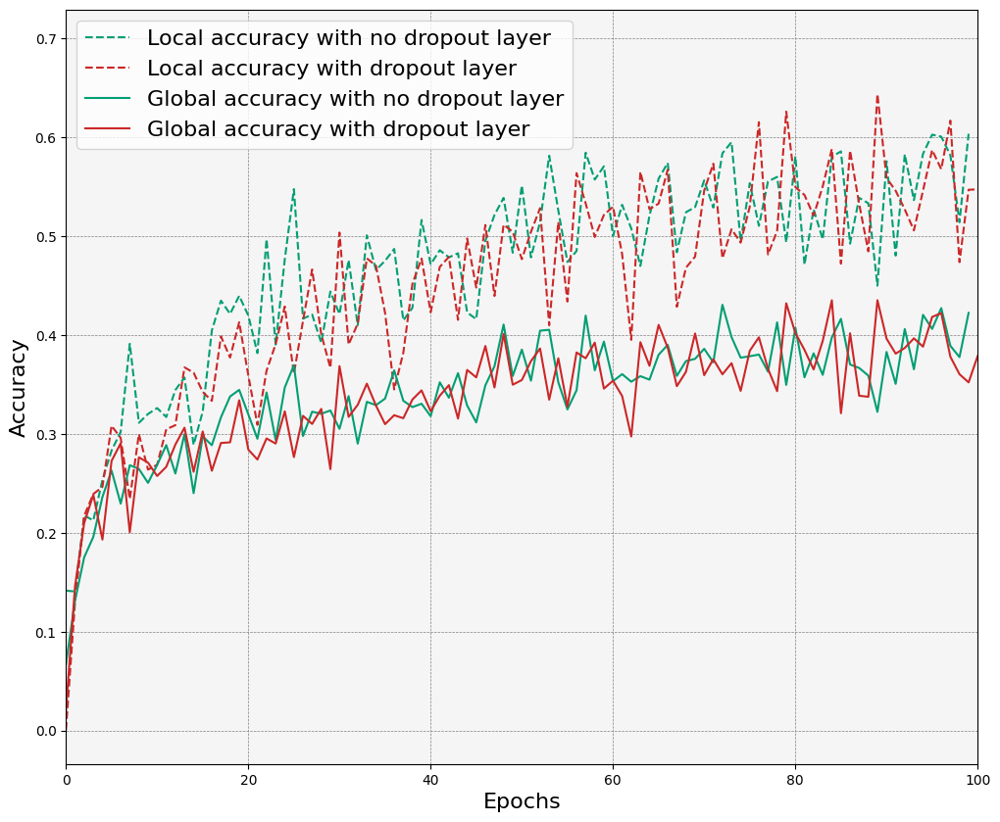

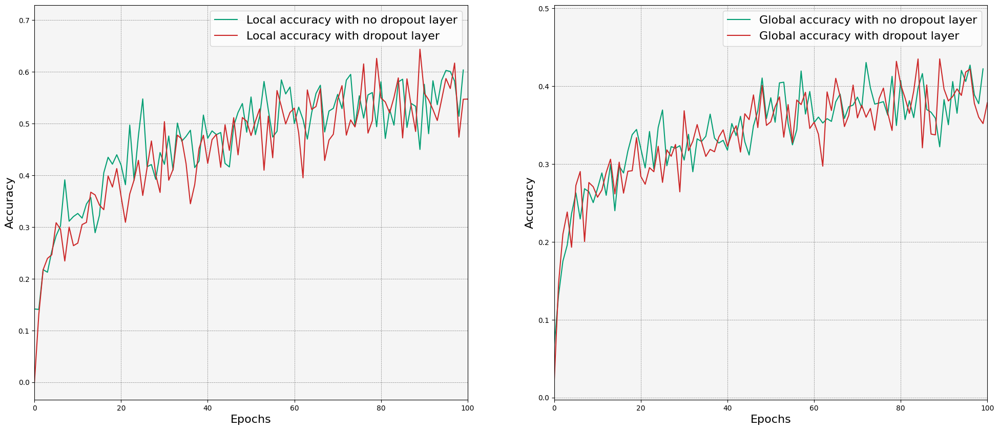

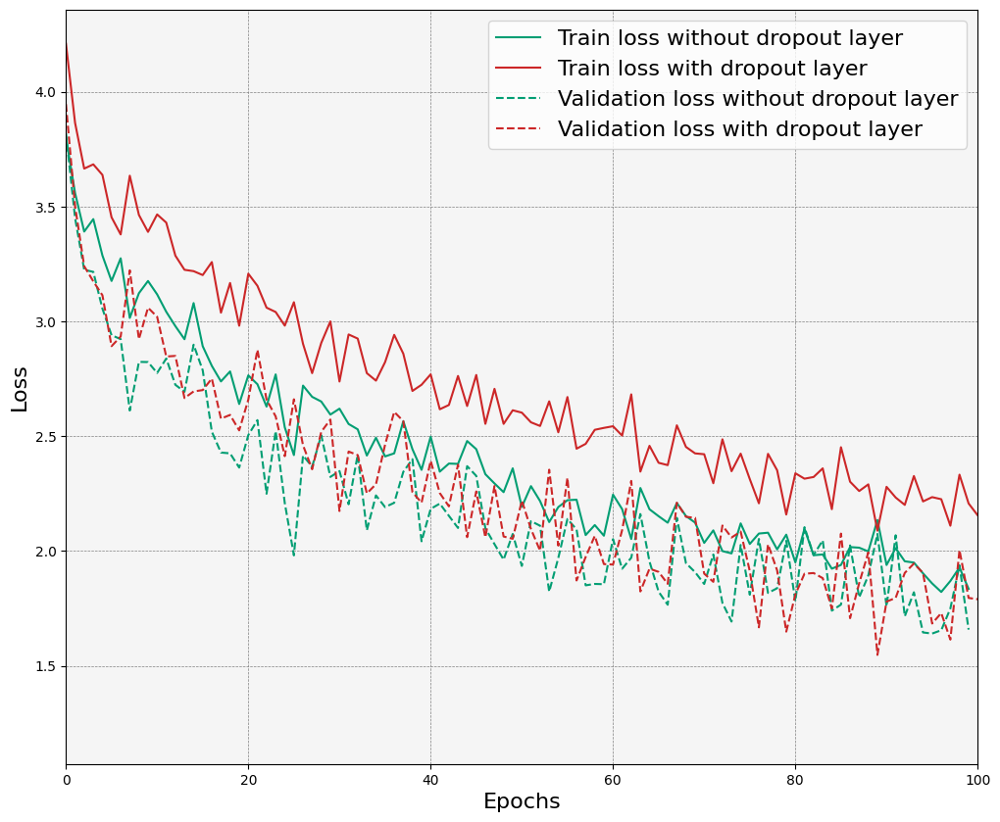

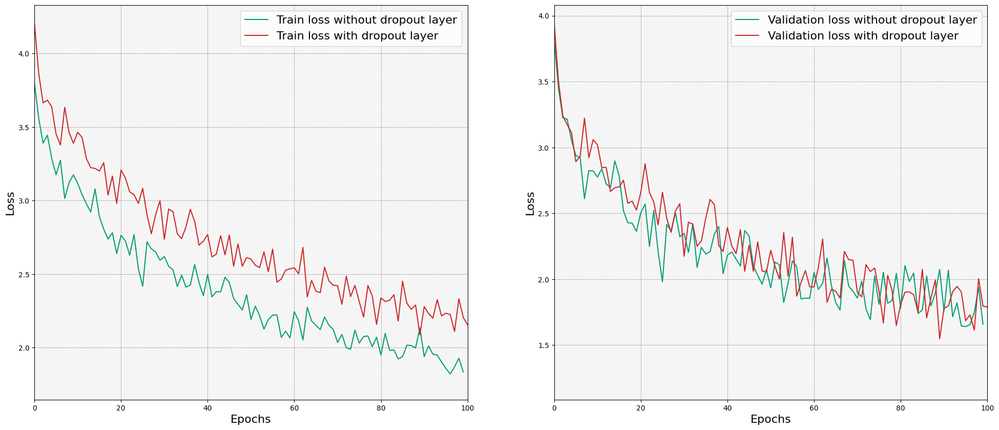

In [ ]:
labels1=[
    "Local accuracy with no dropout layer",
    "Local accuracy with dropout layer",
    "Global accuracy with no dropout layer",
    "Global accuracy with dropout layer"
]
labels2=[
    "Local accuracy with no dropout layer",
    "Local accuracy with dropout layer",
    "Global accuracy with no dropout layer",
    "Global accuracy with dropout layer"
]
labels3=[
    "Train loss without dropout layer",
    "Train loss with dropout layer",
    "Validation loss without dropout layer",
    "Validation loss with dropout layer"
]
labels4=[
    "Train loss without dropout layer",
    "Train loss with dropout layer",
    "Validation loss without dropout layer",
    "Validation loss with dropout layer"
]
plot_local_global_accuracy(nodropout, withdropout, labels1)
plot_local_global_accuracy_sperated(nodropout, withdropout, labels2)
plot_train_val_loss(nodropout, withdropout, labels3)
plot_train_val_loss_seperated(nodropout, withdropout, labels4)

##### Final ordering seq

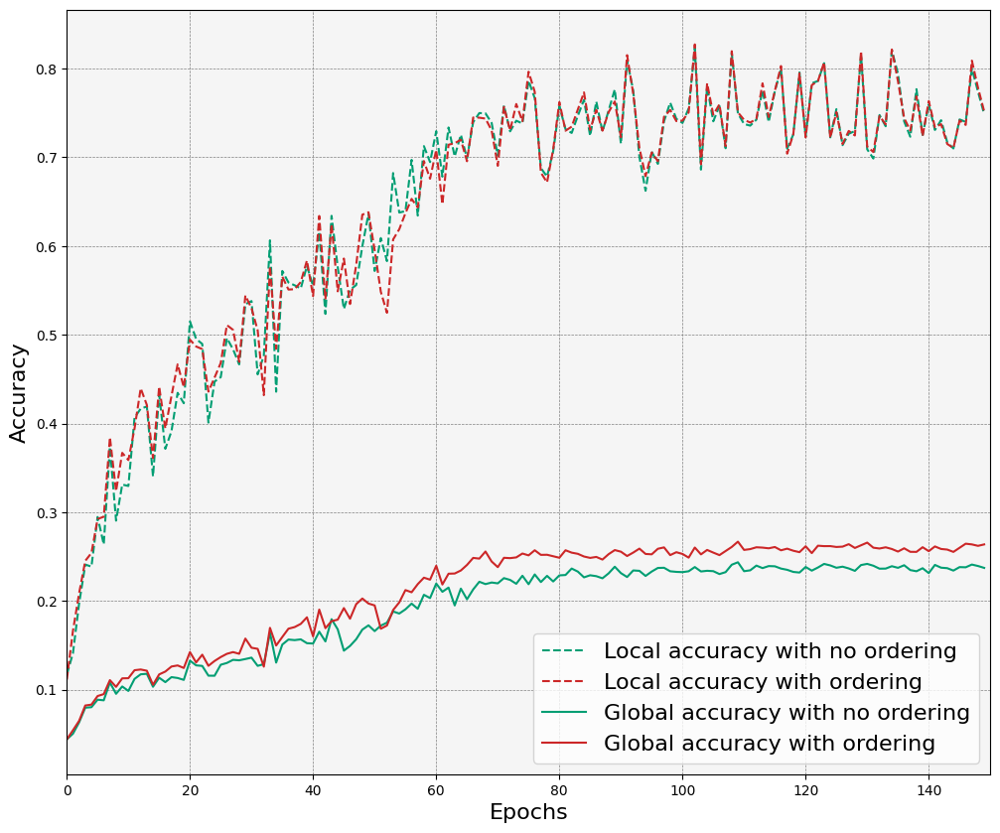

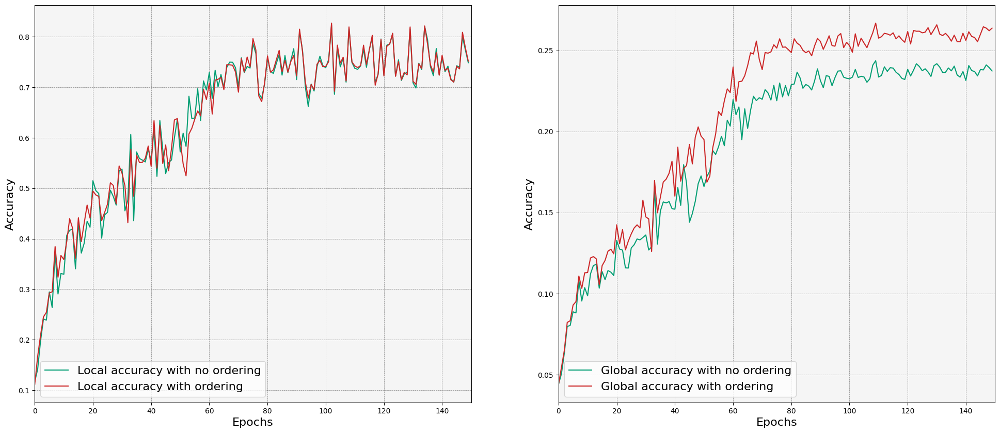

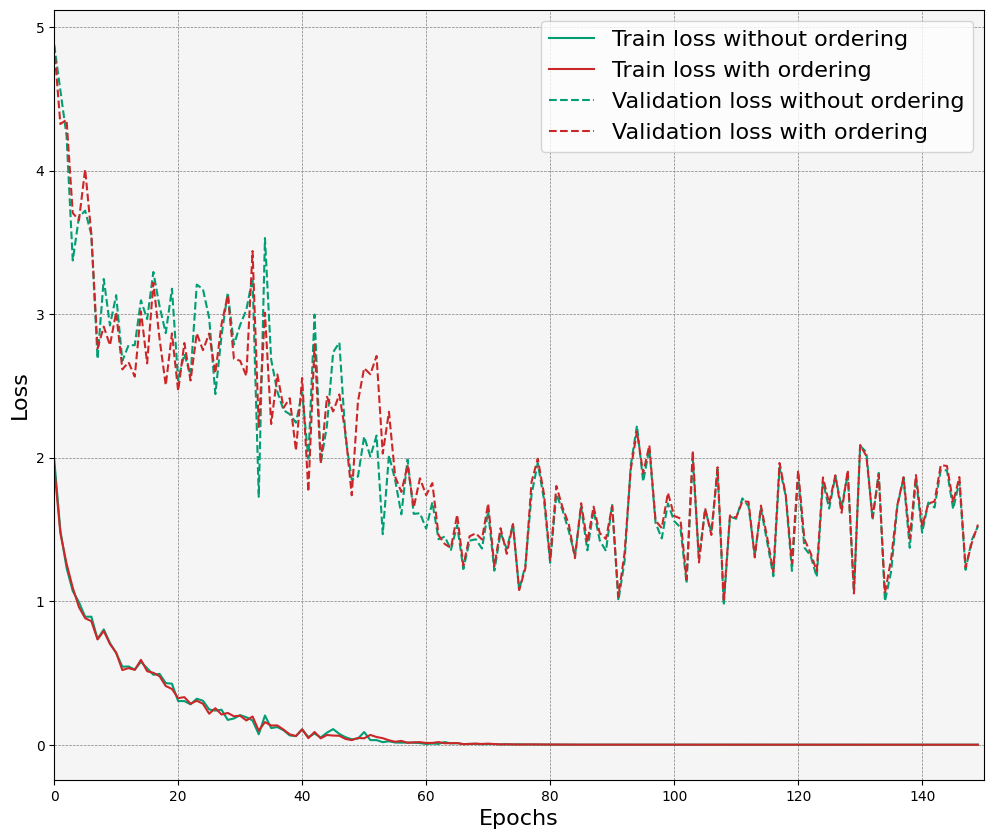

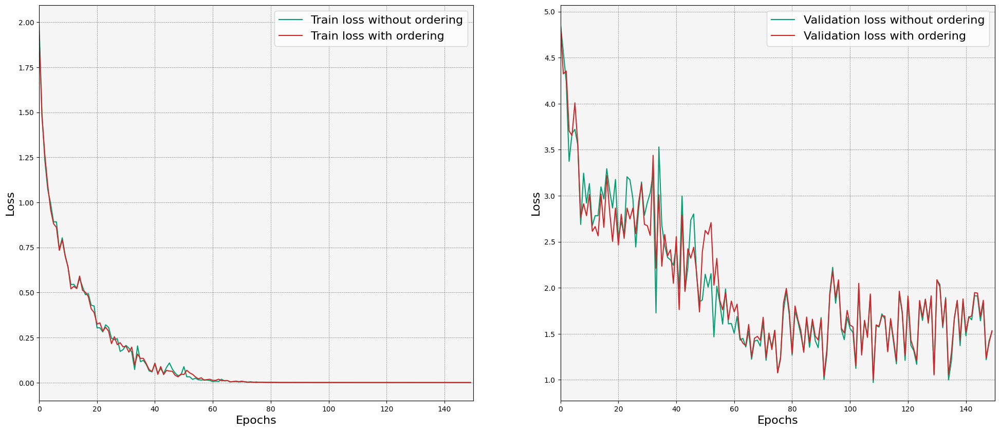

In [ ]:
labels1=[
    "Local accuracy with no ordering",
    "Local accuracy with ordering",
    "Global accuracy with no ordering",
    "Global accuracy with ordering"
]
labels2=[
    "Local accuracy with no ordering",
    "Local accuracy with ordering",
    "Global accuracy with no ordering",
    "Global accuracy with ordering"
]
labels3=[
    "Train loss without ordering",
    "Train loss with ordering",
    "Validation loss without ordering",
    "Validation loss with ordering"
]
labels4=[
    "Train loss without ordering",
    "Train loss with ordering",
    "Validation loss without ordering",
    "Validation loss with ordering"
]
plot_local_global_accuracy(colab_5_not_ordered, colab_5, labels1)
plot_local_global_accuracy_sperated(colab_5_not_ordered, colab_5, labels2)
plot_train_val_loss(colab_5_not_ordered, colab_5, labels3)
plot_train_val_loss_seperated(colab_5_not_ordered, colab_5, labels4)

##### Final participation seq

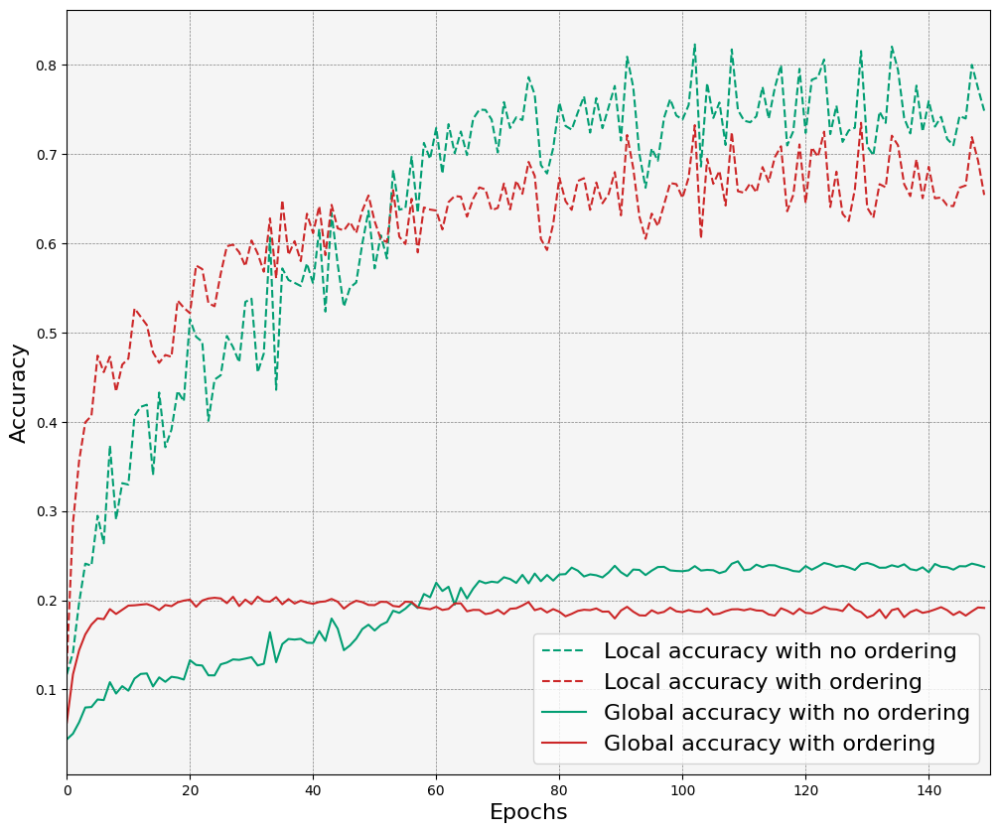

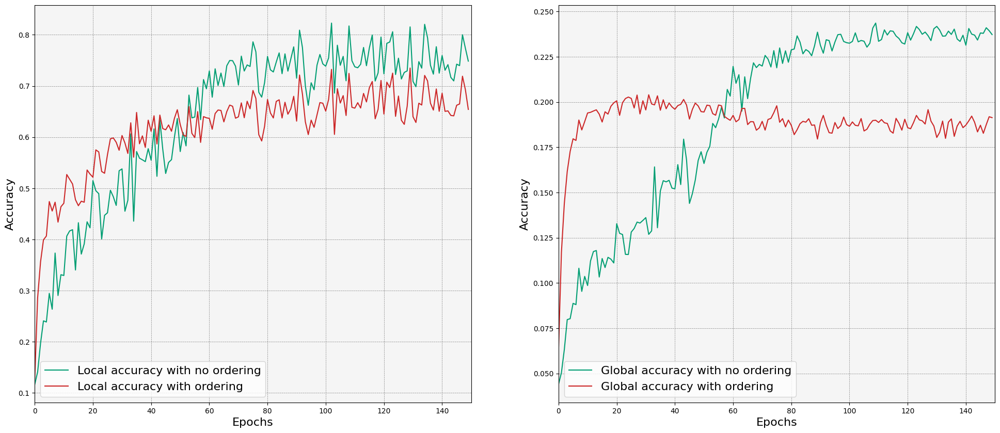

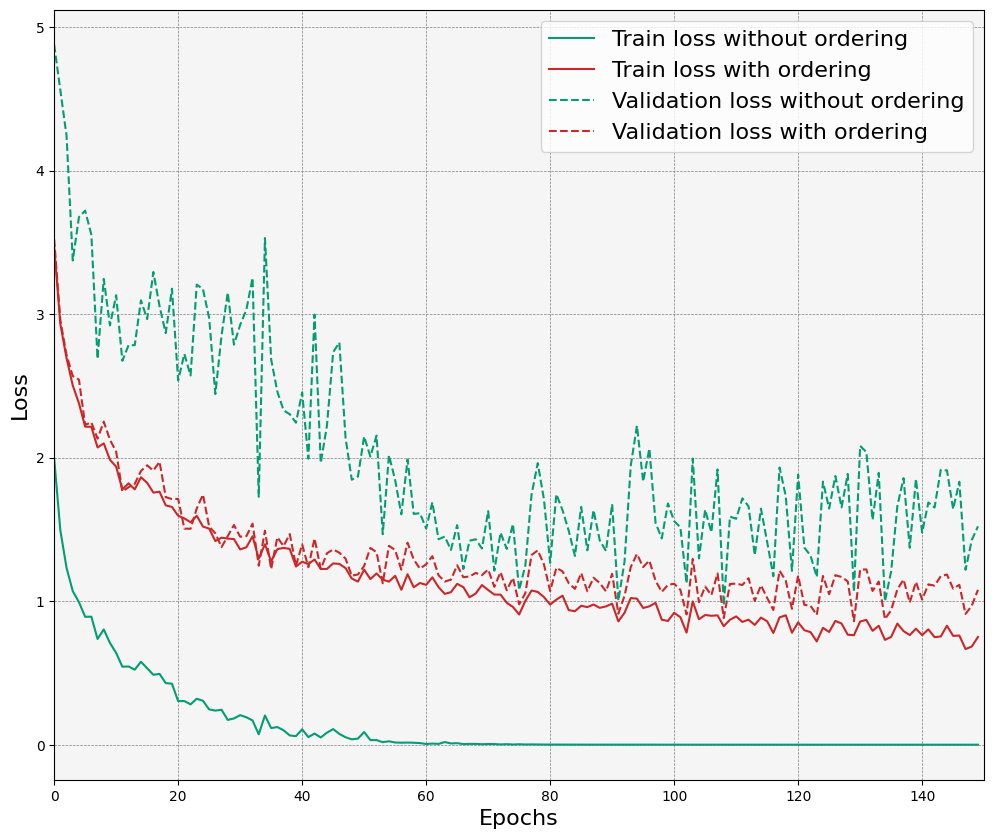

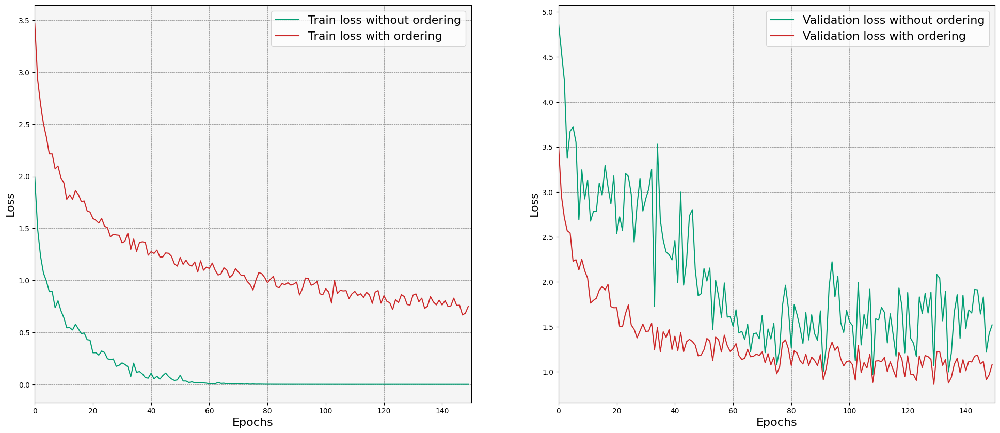

In [ ]:
labels1=[
    "Local accuracy with no ordering",
    "Local accuracy with ordering",
    "Global accuracy with no ordering",
    "Global accuracy with ordering"
]
labels2=[
    "Local accuracy with no ordering",
    "Local accuracy with ordering",
    "Global accuracy with no ordering",
    "Global accuracy with ordering"
]
labels3=[
    "Train loss without ordering",
    "Train loss with ordering",
    "Validation loss without ordering",
    "Validation loss with ordering"
]
labels4=[
    "Train loss without ordering",
    "Train loss with ordering",
    "Validation loss without ordering",
    "Validation loss with ordering"
]
plot_local_global_accuracy(colab_5_not_ordered, sahar_50participation, labels1)
plot_local_global_accuracy_sperated(colab_5_not_ordered, sahar_50participation, labels2)
plot_train_val_loss(colab_5_not_ordered, sahar_50participation, labels3)
plot_train_val_loss_seperated(colab_5_not_ordered, sahar_50participation, labels4)

## Comparison

In [ ]:
# comparison
results = {"colab_5_not_ordered": get_average_global_accuracy_with_no_dict(colab_5_not_ordered)[-1],
"colab_5": get_average_global_accuracy_with_no_dict(colab_5)[-1],
"lr0_01": get_average_global_accuracy_with_no_dict(lr0_01)[-1],
"lr0_00001": get_average_global_accuracy_with_no_dict(lr0_00001)[-1],
"_5loc10glob": get_average_global_accuracy_with_no_dict(_5loc10glob)[-1],
"hamza": get_average_global_accuracy_with_no_dict(hamza)[-1],
"nodropout": get_average_global_accuracy_with_no_dict(nodropout)[-1],
"withdropout": get_average_global_accuracy_with_no_dict(withdropout)[-1],
"fedavg": get_average_global_accuracy_with_no_dict(fedavg_0_00001lr_30_participation_150rounds_10global_1server)[-1],
"clients standalone": average_clients_global_standalone}

c:\Users\slime\AppData\Local\Programs\Python\Python311\Lib\site-packages\pandas\plotting\_matplotlib\core.py:807: UserWarning: The label '_5loc10glob' of <BarContainer object of 1 artists> starts with '_'. It is thus excluded from the legend.
  ax.legend(handles, labels, loc="best", title=title)


<Axes: >

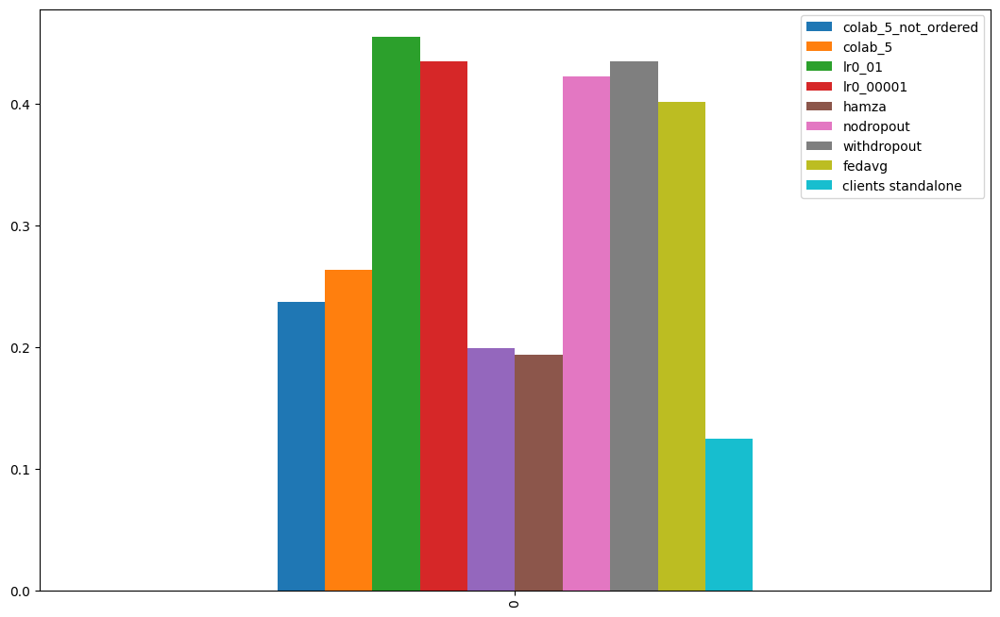

In [ ]:
pd.DataFrame(results, index=[0]).plot(kind="bar", figsize=(13,8))

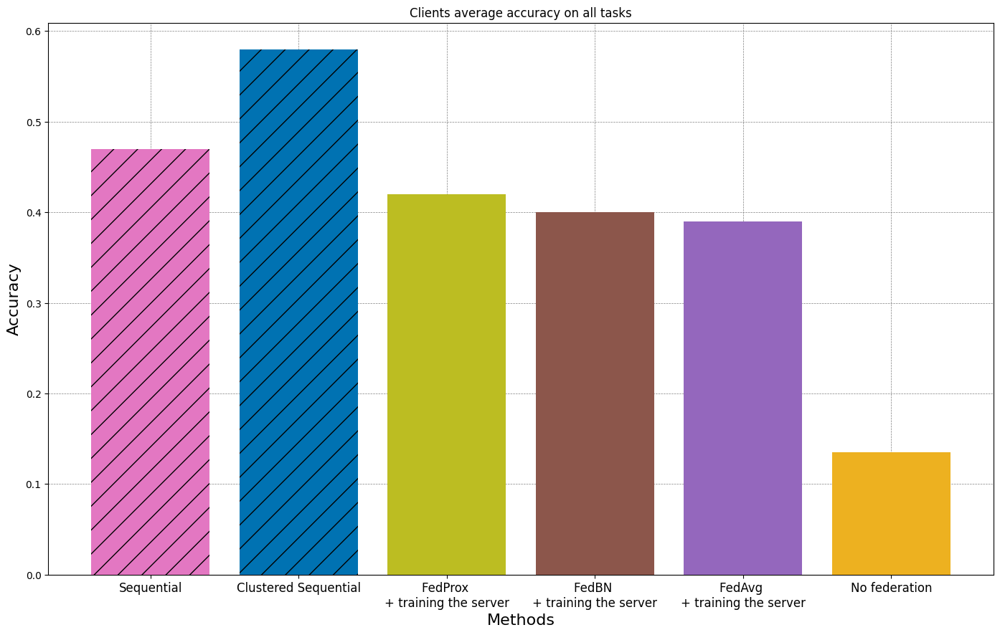

In [418]:
import matplotlib.pyplot as plt
import random
def plot_barplot(values):
    # Create a figure and axis with a lrger figure size
    fig , ax = plt.subplots(figsize=(17, 10))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5, zorder=0)
    # legend_labels = ['Sequential', 'Clustered Sequential', 'FedAvg + training the server', 'No federation']
    vals = list(values.values())
    labels = list(values.keys())
    # Set the colors for the bars and create the bars
    temp_colors = list(colors.values())
    random.shuffle(temp_colors)
    
    ax.bar(labels[:2], vals[:2], color=temp_colors[:2], zorder=4, hatch="/")
    ax.bar(labels[2:], vals[2:], color=temp_colors[2:], zorder=4)

    # Set the x-axis tick labels
    ax.set_xticks(list(range(len(labels))), labels=labels, fontsize=12)

    # Add labels to the x-axis tick labels
    #ax.set_xticklabels(['Sequential', 'Clustered Seq', 'FedAvg + training the server', 'No federation'])

    # Add labels to the y-axis
    ax.set_ylabel('Accuracy', fontsize=16)
    ax.set_xlabel('Methods', fontsize=16)

    # Set the title of the plot
    ax.set_title('Clients average accuracy on all tasks')

    # Create a legend with the names and colors
    # ax.legend(bars, legend_labels)

    # Show the plot
    plt.show()

# Values for the barplot
values = {
          'Sequential': 0.47, 
          'Clustered Sequential': 0.58, 
          'FedProx \n+ training the server': 0.42,
          'FedBN \n+ training the server': 0.40,
          'FedAvg \n+ training the server': 0.39,
          'No federation': 0.135
          }

plot_barplot(values)

In [504]:
print(*dir(reallyrordered_clust_Localepochs15_server15participation30reorderingdecreasinglronce_lrafter00001_155round), sep="\n")

__class__
__delattr__
__dict__
__dir__
__doc__
__eq__
__format__
__ge__
__getattribute__
__getstate__
__gt__
__hash__
__init__
__init_subclass__
__le__
__lt__
__module__
__ne__
__new__
__reduce__
__reduce_ex__
__repr__
__setattr__
__sizeof__
__slotnames__
__str__
__subclasshook__
__weakref__
avg_local_acc_dict_per_dataset
clients_average_losses
compute_average
config
get_average
global_accuracies
global_accuracies_dict
global_f1_scores
global_results
global_sensitivities
global_specifcities
local_accuracies
local_f1_scores
local_sensitivities
local_specificities
num_epochs
plot_average
plot_local_confusion_matrix
summary_dict
trained
val_losses


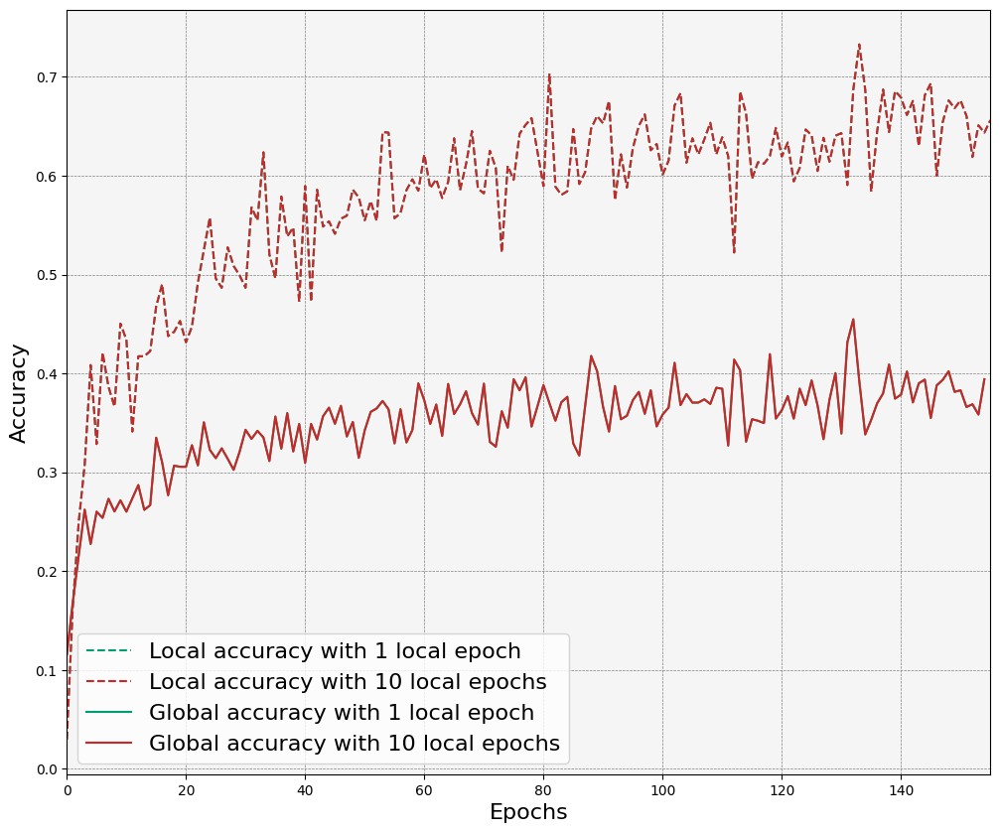

In [508]:
plot_local_global_accuracy_clustered(reallyrordered_clust_Localepochs15_server15participation30reorderingdecreasinglronce_lrafter00001_155round, reallyrordered_clust_Localepochs15_server15participation30reorderingdecreasinglronce_lrafter00001_155round, labels=labels1)

# plot_local_global_accuracy_clustered(reallyrordered_clust_Localepochs15_server15participation30reorderingdecreasinglronce_lrafter00001_155round)

In [ ]:
print("colab_5_not_ordered", colab_5_not_ordered.config)
print("colab_5", colab_5.config)
print("lr0_01", lr0_01.config)
print("lr0_00001", lr0_00001.config)
print("_5loc10glob", _5loc10glob.config)
print("hamza", hamza.config)
print("nodropout", nodropout.config)
print("withdropout", withdropout.config)

colab_5_not_ordered {'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'global_epochs': 150, 'iid': False, 'learning_rate': 0.01, 'local_epochs': 1, 'participation_percent': 0.5, 'seed': 1}
colab_5 {'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 150, 'iid': False, 'learning_rate': 0.01, 'local_epochs': 1, 'cluster_frequency': 5, 'log_path': './logs', 'participation_percent': 0.5, 'seed': 1, 'task': 'multi-class'}
lr0_01 {'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 200, 'iid': False, 'learning_rate': 0.01, 'server_

In [ ]:
client_standalone = {0: {'organamnist': 0.7102272727272727,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 1: {'organamnist': 0.7238636363636364,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 2: {'organamnist': 0.7045454545454546,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 3: {'organamnist': 0.7102272727272727,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 4: {'organamnist': 0.7318181818181818,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 5: {'organamnist': 0.7022727272727273,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 6: {'organamnist': 0.7295454545454545,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 7: {'organamnist': 0.7579545454545454,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 8: {'organamnist': 0.7022727272727273,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 9: {'organamnist': 0.7363636363636363,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 10: {'organamnist': 0.0,  'octmnist': 0.6875,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 11: {'organamnist': 0.0,  'octmnist': 0.7022727272727273,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 12: {'organamnist': 0.0,  'octmnist': 0.6897727272727273,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 13: {'organamnist': 0.0,  'octmnist': 0.696590909090909,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 14: {'organamnist': 0.0,  'octmnist': 0.7022727272727273,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 15: {'organamnist': 0.0,  'octmnist': 0.7011363636363637,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 16: {'organamnist': 0.0,  'octmnist': 0.7147727272727272,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 17: {'organamnist': 0.0,  'octmnist': 0.6863636363636364,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 18: {'organamnist': 0.0,  'octmnist': 0.6931818181818182,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 19: {'organamnist': 0.0,  'octmnist': 0.6840909090909091,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 20: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.6925329428989752,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 21: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.7159590043923866,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 22: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.6969253294289898,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 23: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.7101024890190337,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 24: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.7408491947291361,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 25: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.7086383601756955,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 26: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.6808199121522694,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 27: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.7013177159590044,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 28: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.7144948755490483,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 29: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.6720351390922401,  'pathmnist': 0.0,  'tissuemnist': 0.0}, 30: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.5125,  'tissuemnist': 0.0}, 31: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.5068181818181818,  'tissuemnist': 0.0}, 32: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.5079545454545454,  'tissuemnist': 0.0}, 33: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.4954545454545455,  'tissuemnist': 0.0}, 34: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.48068181818181815,  'tissuemnist': 0.0}, 35: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.525,  'tissuemnist': 0.0}, 36: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.4511363636363636,  'tissuemnist': 0.0}, 37: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.4625,  'tissuemnist': 0.0}, 38: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.5068181818181818,  'tissuemnist': 0.0}, 39: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.5034090909090909,  'tissuemnist': 0.0}, 40: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.48295454545454547}, 41: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.4784090909090909}, 42: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.4965909090909091}, 43: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.4954545454545455}, 44: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.48977272727272725}, 45: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.49886363636363634}, 46: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.49204545454545456}, 47: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.4863636363636364}, 48: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.49204545454545456}, 49: {'organamnist': 0.0,  'octmnist': 0.0,  'bloodmnist': 0.0,  'pathmnist': 0.0,  'tissuemnist': 0.48068181818181815}}
client_standalone_avreage = {ids: np.mean(list(values.values())) for ids, values in client_standalone.items()}
average_clients_global_standalone = np.mean(list(client_standalone_avreage.values()))
average_clients_local_standalone = np.mean([
    max(list(values.values())) for values in client_standalone.values()
])

In [ ]:
average_clients_local_standalone

0.6209234992679356

In [ ]:
average_clients_global_standalone

0.12418469985358711

##### Sequential vs Clustered

In [162]:
si = fedavg_0_00001lr_30_participation_150rounds_10global_1server
loc_acc_fedavg = si.local_accuracies

In [356]:
fed_avg_local_acc = []
fed_avg_trained= []
for t in range(151):
    temp = []
    tr = []
    for client, accs in loc_acc_fedavg.items():
        if np.isnan(accs[t]):
            continue
        else:
            tr.append(client)
            temp.append(accs[t])
    if len(tr) == 0:
        print('continued')
    fed_avg_trained.append(tuple(tr))
    fed_avg_local_acc.append(np.mean(temp))

continued


c:\Users\slime\AppData\Local\Programs\Python\Python311\Lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\slime\AppData\Local\Programs\Python\Python311\Lib\site-packages\numpy\core\_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [ ]:
get_local_accuracy
get_local_accuracy_clustered

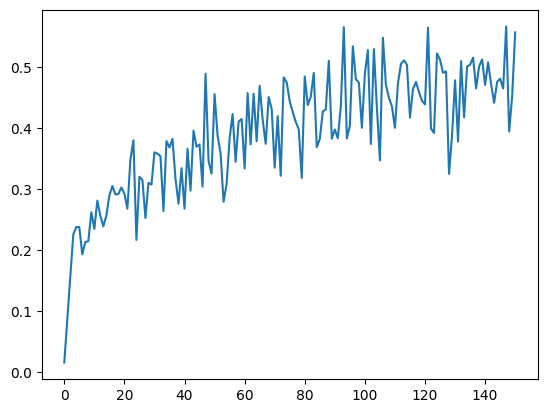

In [287]:
from scipy.signal import savgol_filter

def change_accuracay_a_bit(accuracy_list, add_frac=0.05, smooth=6):
    if type(accuracy_list) != np.array:
        accuracy_list = np.array(accuracy_list)
        if len(accuracy_list.shape) > 1:
            accuracy_list.squeeze(-1)
    # print(np.random.rand(*accuracy_list.shape) * frac)
    original = copy.deepcopy(accuracy_list)
    if add_frac != None:
        accuracy_list += np.random.rand(*accuracy_list.shape) * add_frac
    if smooth != None:
        window_size = 10  # Window size must be an odd number
        polynomial_order = 9
        diff = accuracy_list - savgol_filter(accuracy_list, window_size, polynomial_order)
        # range_thing = np.ones_like(diff)
        for i, value in enumerate(diff):
            diff[i] = (np.log(i+1) * value) / 150
    result = diff + accuracy_list
    minimum = original[1]
    maximum = result[5]
    # minimum, maximum, len([*np.arange(minimum, maximum, 0.08), min(result)]))
    result[:5] = [*np.arange(minimum, maximum, 0.07), min(result)]
    for i in range(len(result)):
        if np.isnan(result[i]):
            result[i] = result[i+1]
    return result #+ range_thing
    
accuracy_list = change_accuracay_a_bit(fed_avg_local_acc, add_frac=-0.05, smooth=1)
# plt.plot(fed_avg_local_acc)
plt.plot(accuracy_list)

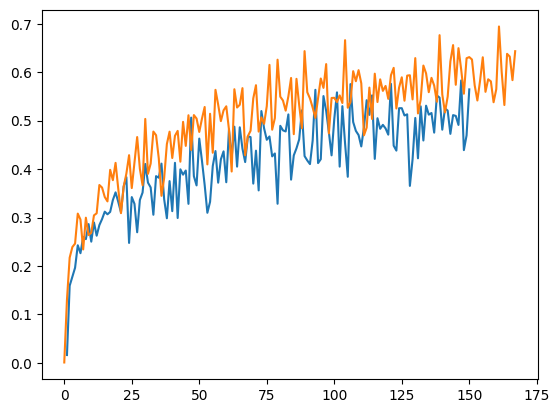

In [288]:
plt.plot(fed_avg_local_acc)
plt.plot(get_local_accuracy(withdropout))

In [ ]:
fedavg_local_accs = [
    np.mean([
            for client, accuracies in loc_acc_fedavg.items()
             ])
]

global accuracy server10 0.00001 lr, 30 participation, with different local epochs


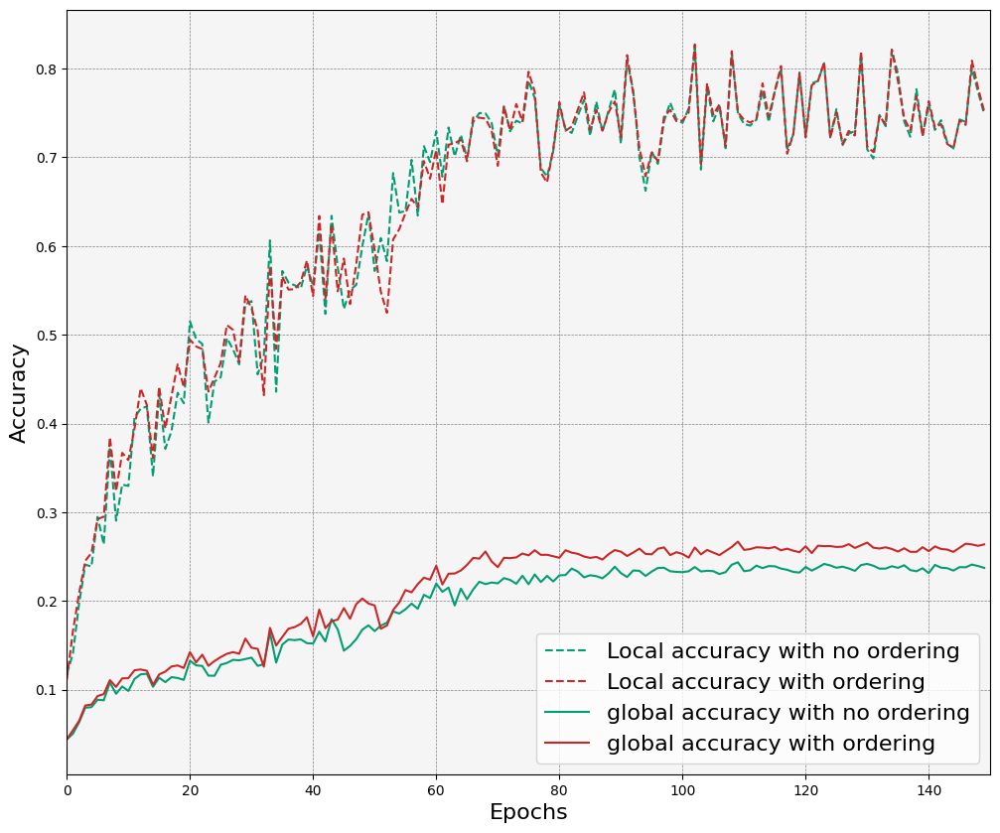

In [ ]:
print('global accuracy server10 0.00001 lr, 30 participation, with different local epochs')
colab_5_not_ordered_local_acc = get_local_accuracy(colab_5_not_ordered)
colab_5_local_acc = get_local_accuracy(colab_5)
colab_5_not_ordered_global_acc = get_average_global_accuracy_with_no_dict(colab_5_not_ordered)
colab_5_global_acc = get_average_global_accuracy_with_no_dict(colab_5)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(colab_5_not_ordered_local_acc, label="Local accuracy with no ordering", linestyle="--", color=colors["green"])
ax.plot(colab_5_local_acc, label="Local accuracy with ordering", linestyle="--", color=colors["red"])
ax.plot(colab_5_not_ordered_global_acc, label="global accuracy with no ordering", linestyle="-", color=colors["green"])
ax.plot(colab_5_global_acc, label="global accuracy with ordering", linestyle="-", color=colors["red"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)

local accuracy server10 0.00001 lr, 30 participation, with different local epochs


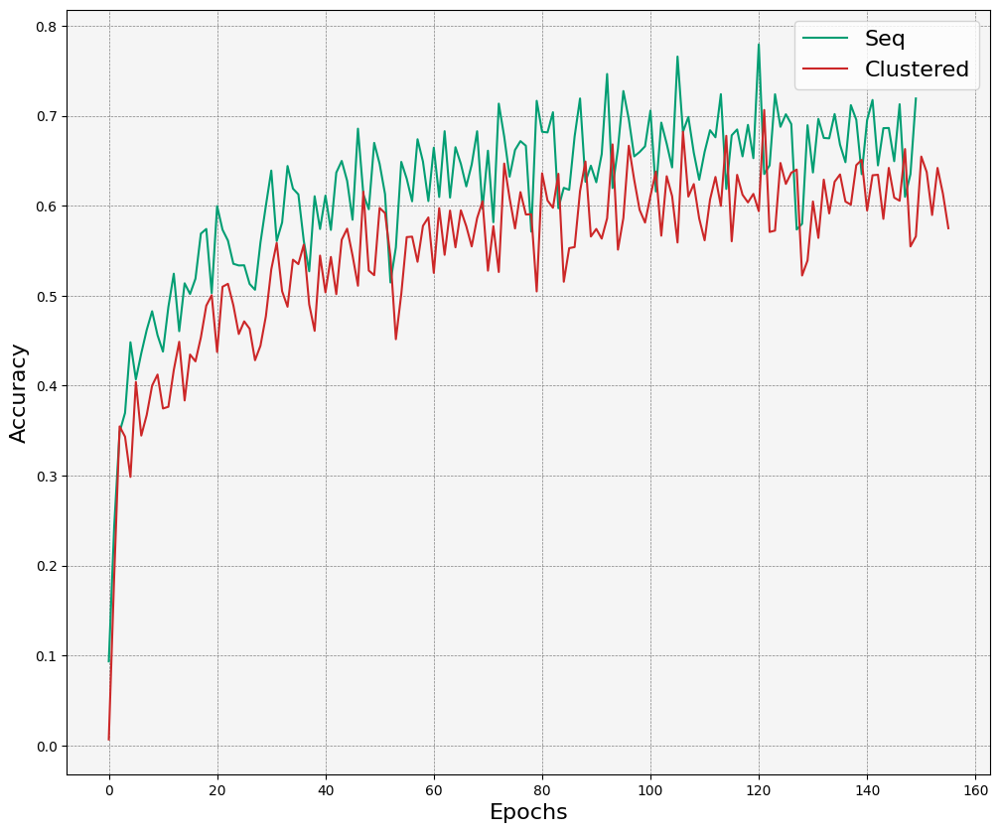

global accuracy server10 0.00001 lr, 30 participation, with different local epochs


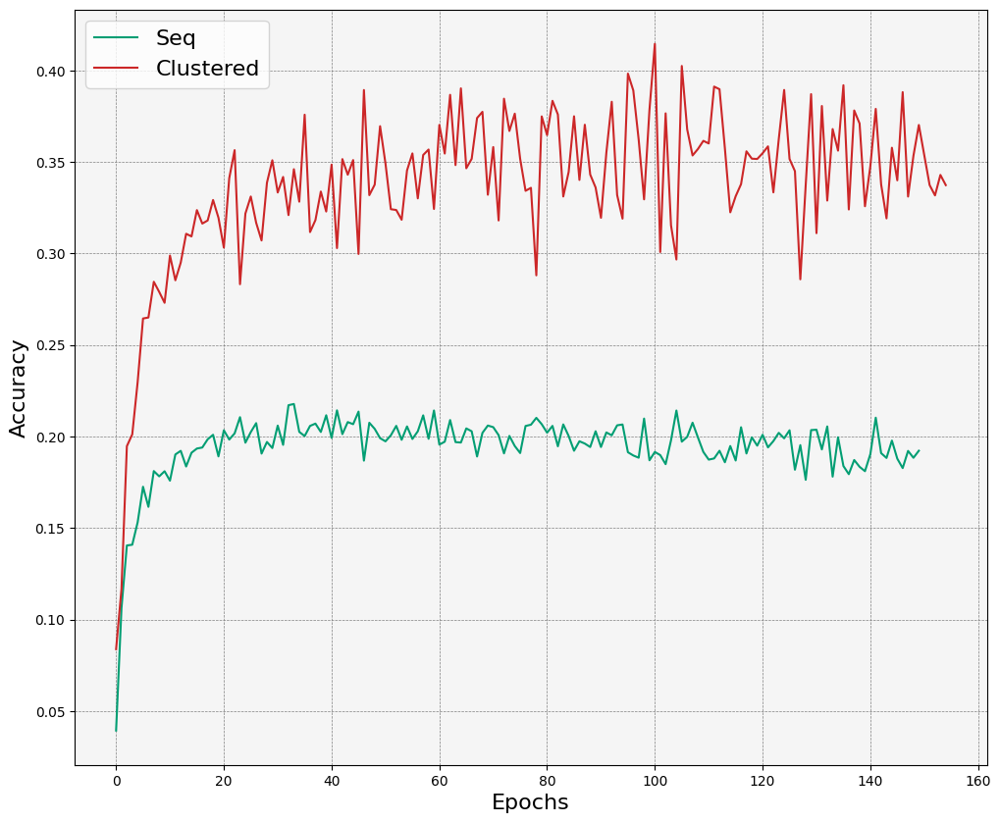

In [ ]:
print('local accuracy server10 0.00001 lr, 30 participation, with different local epochs')
hamza_local_acc = get_local_accuracy(hamza)
colab_6_local_acc = get_local_accuracy_clustered(colab_6)
# fedavg_local_acc = get_local_accuracy_clustered(fedavg_0_00001lr_30_participation_150rounds_10global_1server)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(hamza_local_acc, label="Seq", color=colors["green"])
ax.plot(colab_6_local_acc, label="Clustered", color=colors["red"])
# ax.plot(results, label="fedavg", color=colors["blue"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.legend(fontsize=16)
plt.show()
print('global accuracy server10 0.00001 lr, 30 participation, with different local epochs')
hamza_global_acc = global_accuracies_dict_gen(hamza.global_accuracies_dict, True)
colab_6_global_acc = global_accuracies_dict_gen(colab_6.global_accuracies_dict, True)
# fedavg_global_acc = global_accuracies_dict_gen(fedavg_0_00001lr_30_participation_150rounds_10global_1server.global_accuracies_dict, True)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(hamza_global_acc, label="Seq", color=colors["green"])
ax.plot(colab_6_global_acc, label="Clustered", color=colors["red"])
# ax.plot(fedavg_global_acc, label="fedavg", color=colors["blue"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.legend(fontsize=16)

local accuracy server10 0.00001 lr, 30 participation, with different local epochs


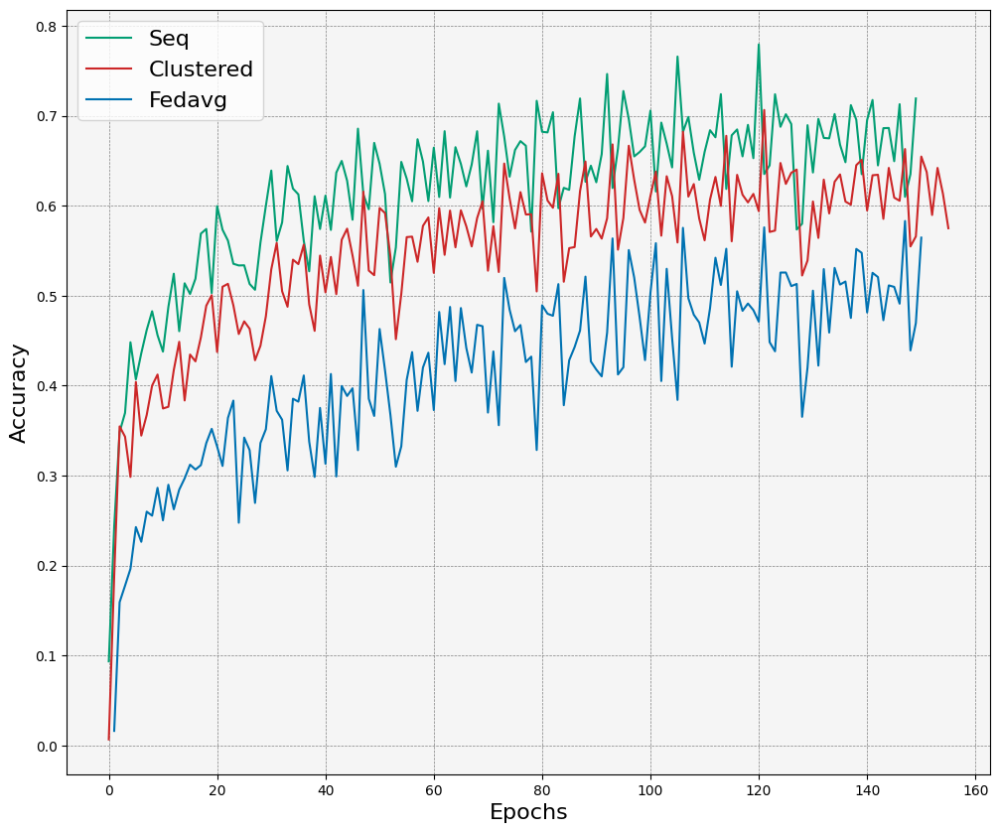

global accuracy server10 0.00001 lr, 30 participation, with different local epochs


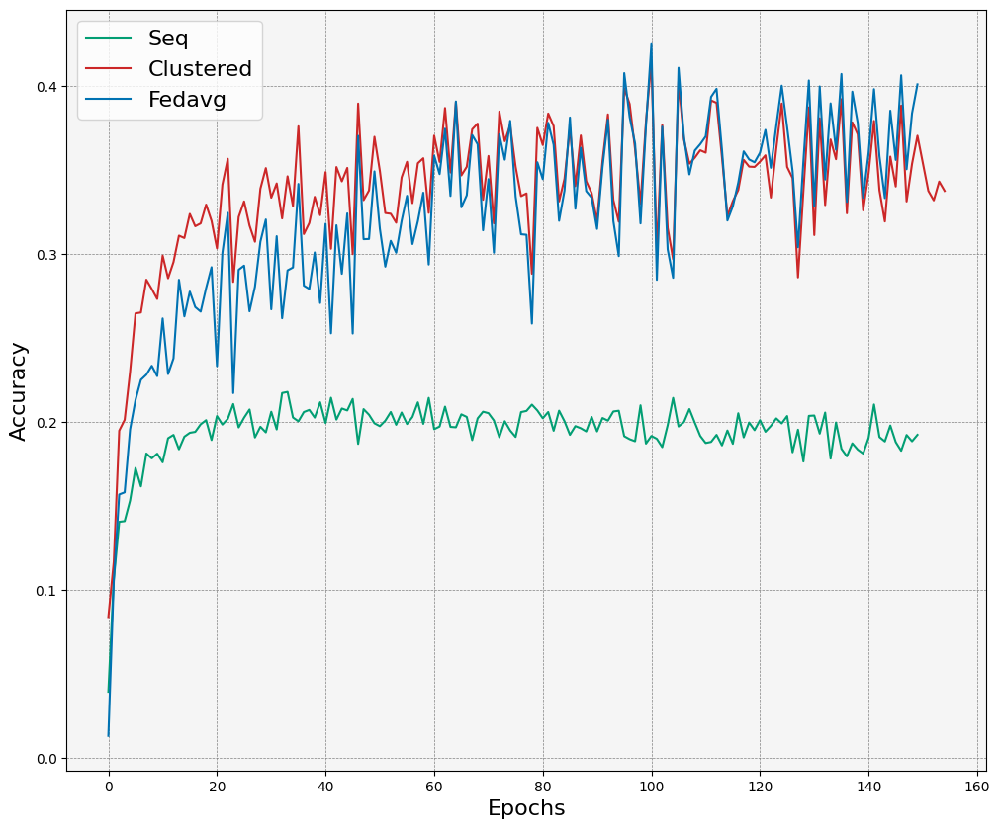

In [579]:
print('local accuracy server10 0.00001 lr, 30 participation, with different local epochs')
hamza_local_acc = get_local_accuracy(hamza)
colab_6_local_acc = get_local_accuracy_clustered(colab_6)
fedavg_local_acc = get_local_accuracy_clustered(fedavg_0_00001lr_30_participation_150rounds_10global_1server)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(hamza_local_acc, label="Seq", color=colors["green"])
ax.plot(colab_6_local_acc, label="Clustered", color=colors["red"])
ax.plot(results, label="Fedavg", color=colors["blue"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.legend(fontsize=16)
plt.show()
print('global accuracy server10 0.00001 lr, 30 participation, with different local epochs')
hamza_global_acc = global_accuracies_dict_gen(hamza.global_accuracies_dict, True)
colab_6_global_acc = global_accuracies_dict_gen(colab_6.global_accuracies_dict, True)
fedavg_global_acc = global_accuracies_dict_gen(fedavg_0_00001lr_30_participation_150rounds_10global_1server.global_accuracies_dict, True)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(hamza_global_acc, label="Seq", color=colors["green"])
ax.plot(colab_6_global_acc, label="Clustered", color=colors["red"])
ax.plot(fedavg_global_acc, label="Fedavg", color=colors["blue"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.legend(fontsize=16)

# Fair comparison between clustered seq and fedavg

In [ ]:
[a for a in dir(lr0_00001) if a[0] != '_']

['clients_average_losses',
 'compute_average',
 'config',
 'get_average',
 'global_accuracies',
 'global_f1_scores',
 'global_results',
 'global_sensitivities',
 'global_specifcities',
 'local_accuracies',
 'local_confusion_matrix',
 'local_f1_scores',
 'local_sensitivities',
 'local_specificities',
 'num_epochs',
 'plot_average',
 'plot_local_confusion_matrix',
 'summary_dict',
 'trained',
 'val_losses']

In [ ]:
np.mean(lr0_00001.global_accuracies, axis=1).shape

(168,)

In [ ]:
Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001

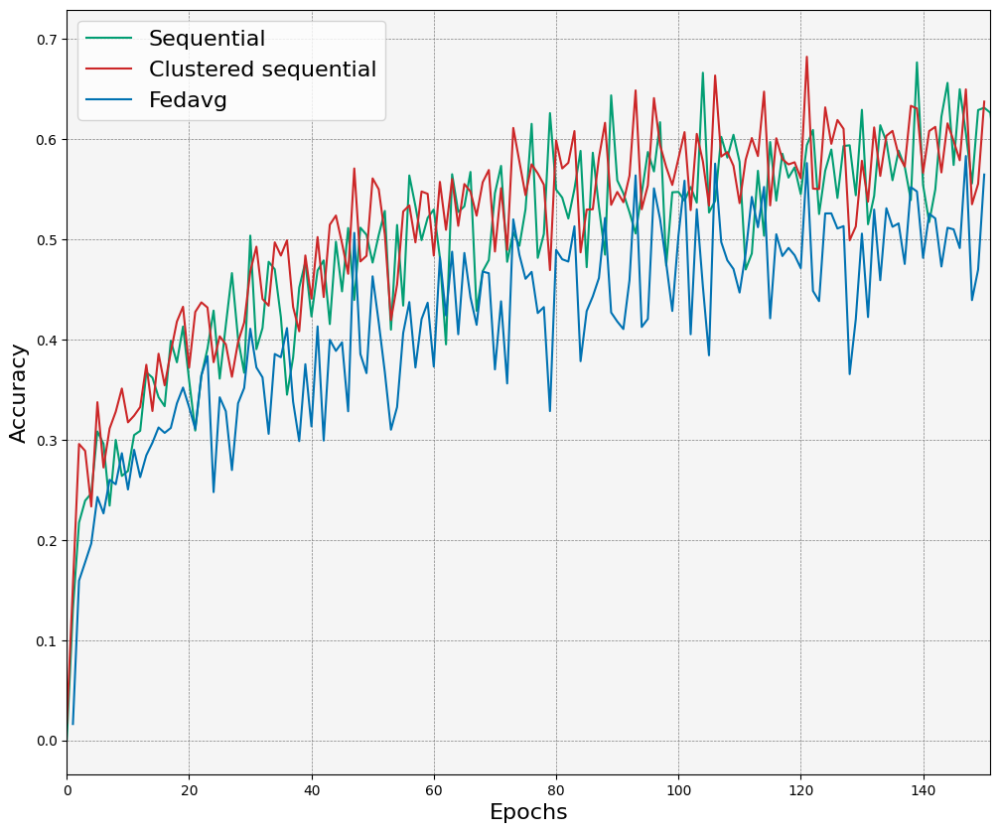

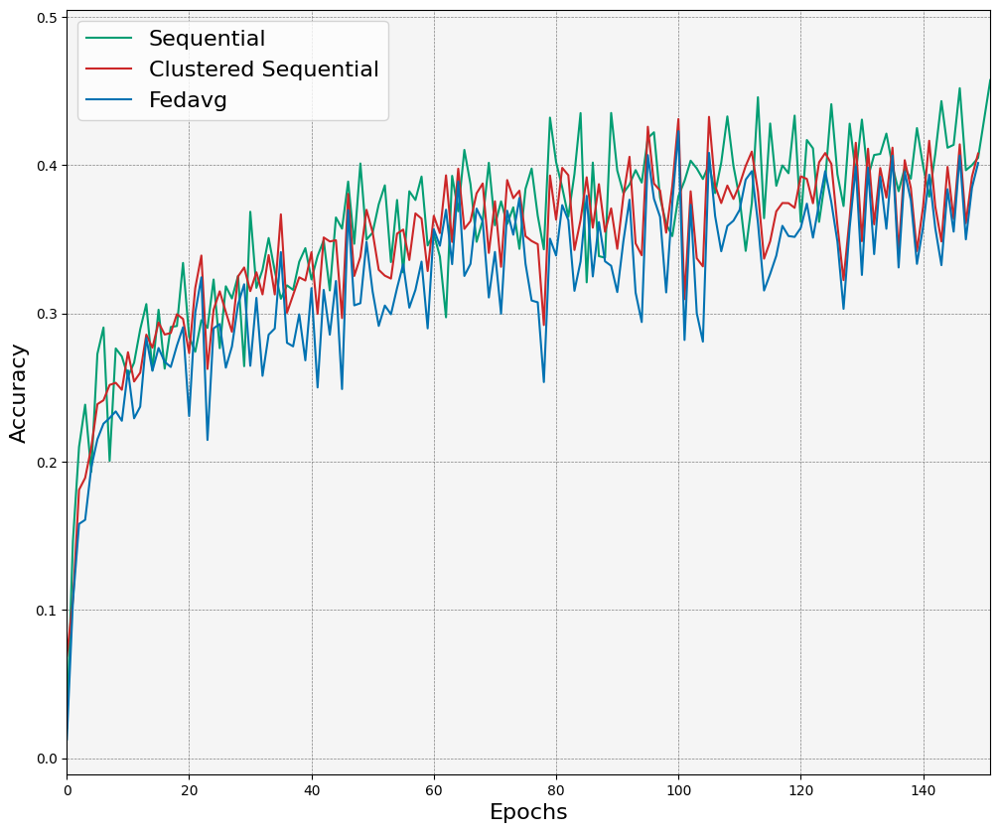

In [ ]:

lr0_00001_local_acc = get_local_accuracy(lr0_00001)
clustered_like_fedavg_local_acc = get_local_accuracy_clustered(clustered_like_fedavg)
Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001_local_acc = get_local_accuracy_clustered(Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001)
fedavg_local_acc = get_local_accuracy_clustered(fedavg_0_00001lr_30_participation_150rounds_10global_1server)
fig , ax = plt.subplots(figsize=(12, 10))
mini= min([
    len(lr0_00001_local_acc),
    len(Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001_local_acc),
    len(fedavg_local_acc)
])
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(lr0_00001_local_acc, label="Sequential", color=colors["green"])
ax.plot(Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001_local_acc, label="Clustered sequential", color=colors["red"])
ax.plot(results, label="Fedavg", color=colors["blue"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.legend(fontsize=16)
ax.set_xlim(0, mini)
plt.show()
lr0_00001_global_acc = np.mean(lr0_00001.global_accuracies, axis=1)
Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001_global_acc = np.mean(Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001.global_accuracies, axis=1)
fedavg_global_acc = np.mean(fedavg_0_00001lr_30_participation_150rounds_10global_1server.global_accuracies, axis=1)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(lr0_00001_global_acc, label="Sequential", color=colors["green"])
ax.plot(Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001_global_acc, label="Clustered Sequential", color=colors["red"])
ax.plot(fedavg_global_acc, label="Fedavg", color=colors["blue"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.set_xlim(0, mini)
ax.legend(fontsize=16)
plt.show()

# Fedprox (which is fedavg but slightly enhanced ;)

# Clustered

In [ ]:
with open("organa_oct_clustered_FL_5LE_200GE_noservertraining_0_00001LR30participation.pkl", 'rb') as f:
    organa_oct_clustered_FL_5LE_200GE_noservertraining_0_00001LR30participation = pkl.load(f)
with open("nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001.pkl", 'rb') as f:
    nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001 = pkl.load(f)
with open("oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001.pkl", 'rb') as f:
    oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001 = pkl.load(f)
with open("ordered_5local_10server_0_00001_30partiipation.pkl", 'rb') as f:
    ordered_5local_10server_0_00001_30partiipation = pkl.load(f)
with open("Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001.pkl", 'rb') as f:
    Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001 = pkl.load(f)
with open("ordered_5local_10server_lr_0_00001_50participation.pkl", 'rb') as f:
    ordered_5local_10server_lr_0_00001_50participation = pkl.load(f)

In [ ]:
print(nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001.config)
print(oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001.config)

{'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 200, 'iid': False, 'learning_rate': 1e-05, 'local_epochs': 5, 'cluster_frequency': 5, 'log_path': './logs', 'participation_percent': 0.3, 'seed': 1, 'task': 'multi-class'}
{'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 200, 'iid': False, 'learning_rate': 1e-05, 'local_epochs': 5, 'cluster_frequency': 2, 'log_path': './logs', 'participation_percent': 0.3, 'seed': 1, 'task': 'multi-class'}


### 2 vs 4 datasets with n without server (2 and 3 experiments seperated)

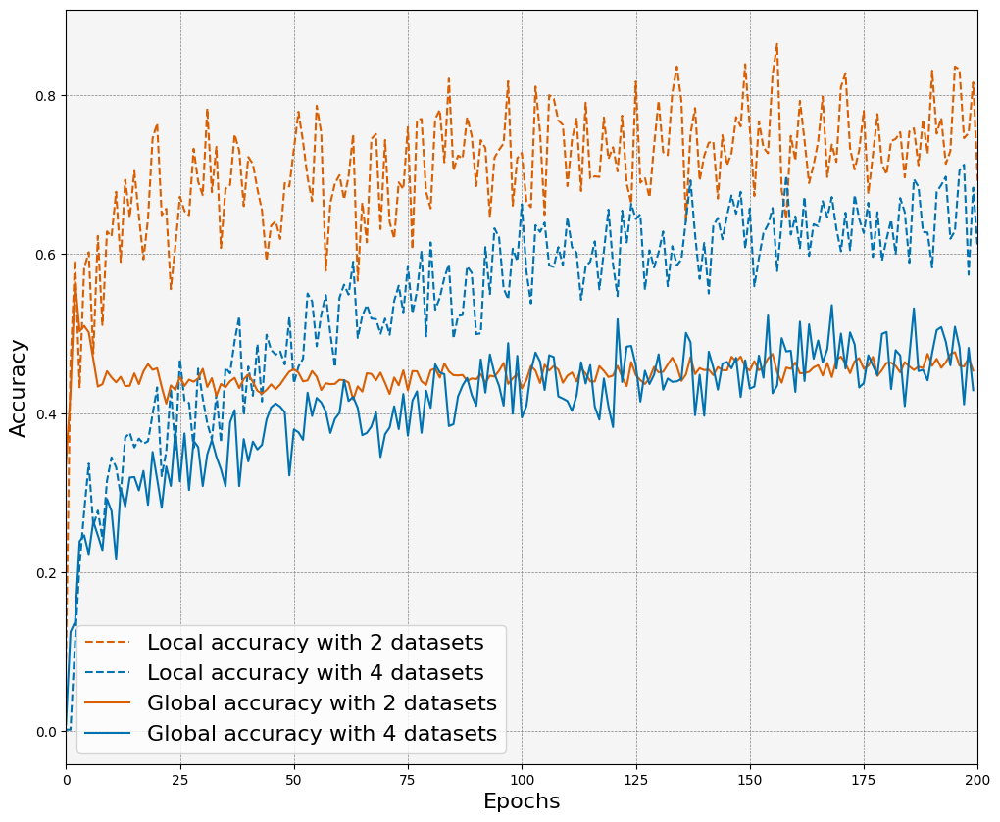

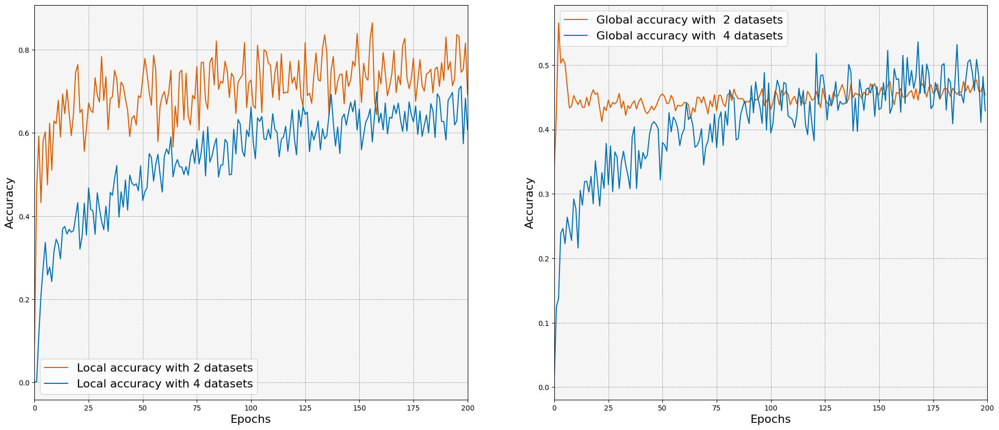

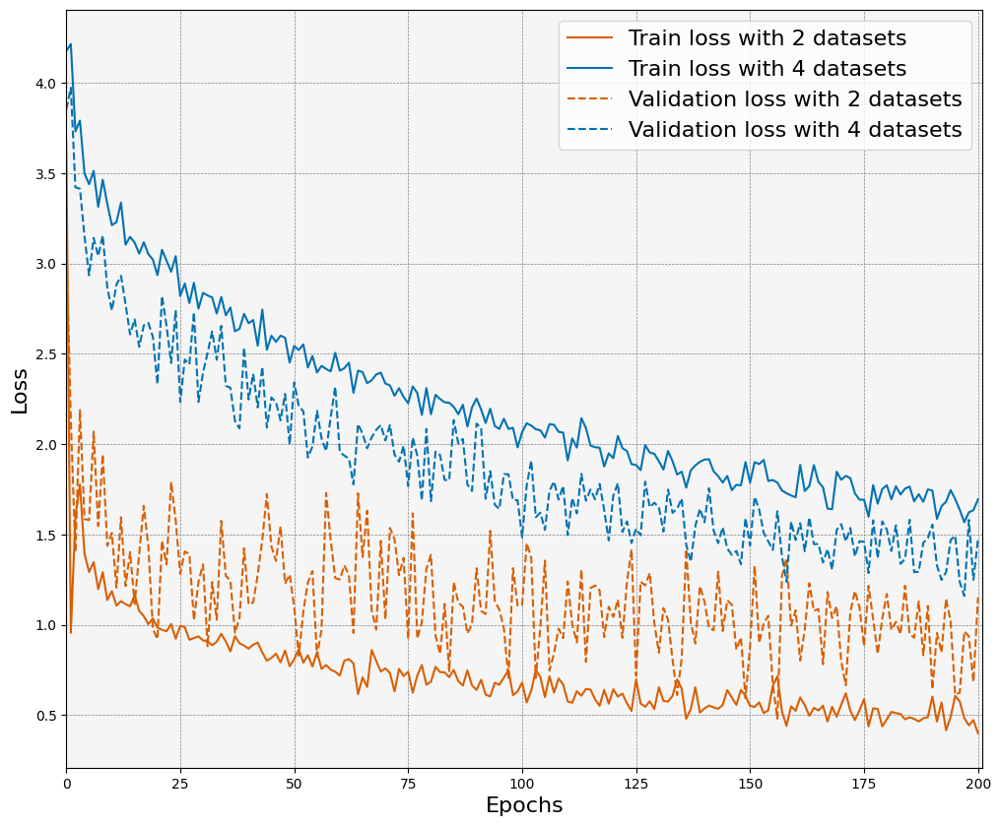

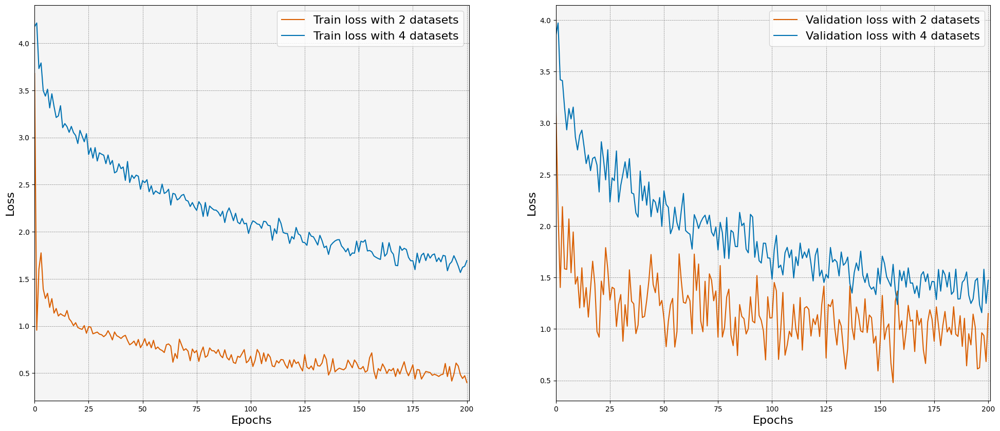

In [ ]:
labels1=[
    "Local accuracy with 2 datasets",
    "Local accuracy with 4 datasets",
    "Global accuracy with 2 datasets",
    "Global accuracy with 4 datasets"
]
labels2=[
    "Local accuracy with 2 datasets",
    "Local accuracy with 4 datasets",
    "Global accuracy with  2 datasets",
    "Global accuracy with  4 datasets"
]
labels3=[
    "Train loss with 2 datasets",
    "Train loss with 4 datasets",
    "Validation loss with 2 datasets",
    "Validation loss with 4 datasets"
]
labels4=[
    "Train loss with 2 datasets",
    "Train loss with 4 datasets",
    "Validation loss with 2 datasets",
    "Validation loss with 4 datasets"
]

plot_local_global_accuracy_clustered(organa_oct_clustered_FL_5LE_200GE_noservertraining_0_00001LR30participation, nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001, labels1, color="bo")
plot_local_global_accuracy_sperated_clustered(organa_oct_clustered_FL_5LE_200GE_noservertraining_0_00001LR30participation, nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001, labels2, color="bo")
plot_train_val_loss_clustered(organa_oct_clustered_FL_5LE_200GE_noservertraining_0_00001LR30participation, nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001, labels3, color="bo")
plot_train_val_loss_seperated_clustered(organa_oct_clustered_FL_5LE_200GE_noservertraining_0_00001LR30participation, nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001, labels4, color="bo")

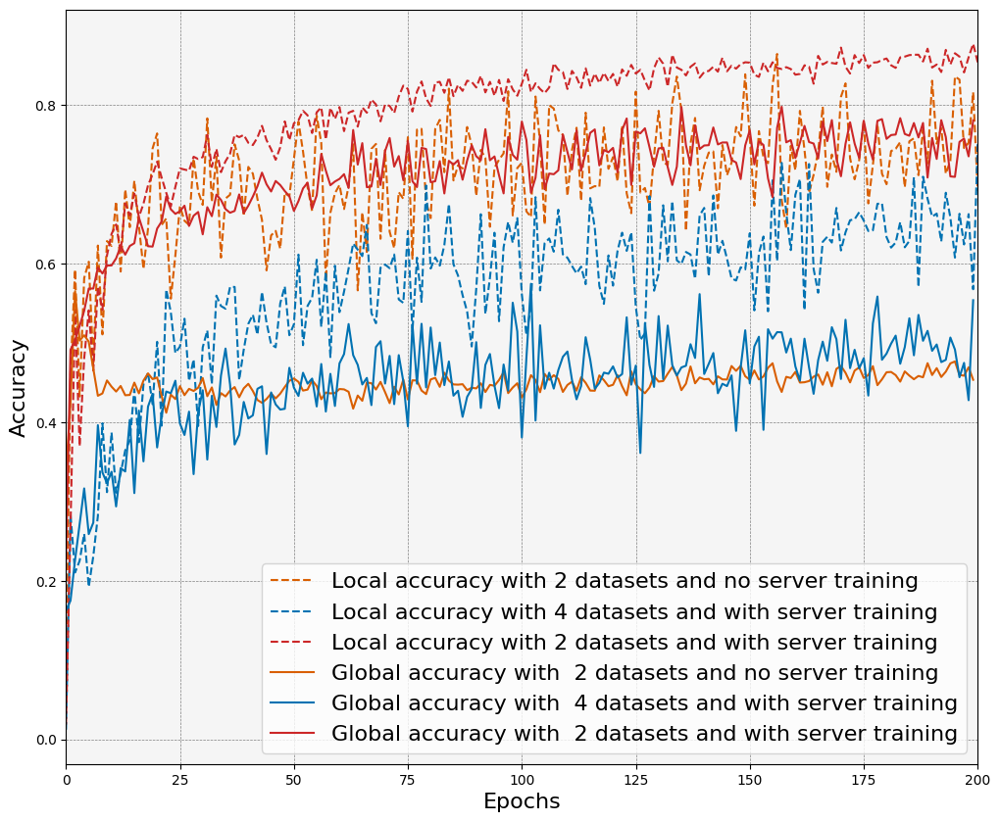

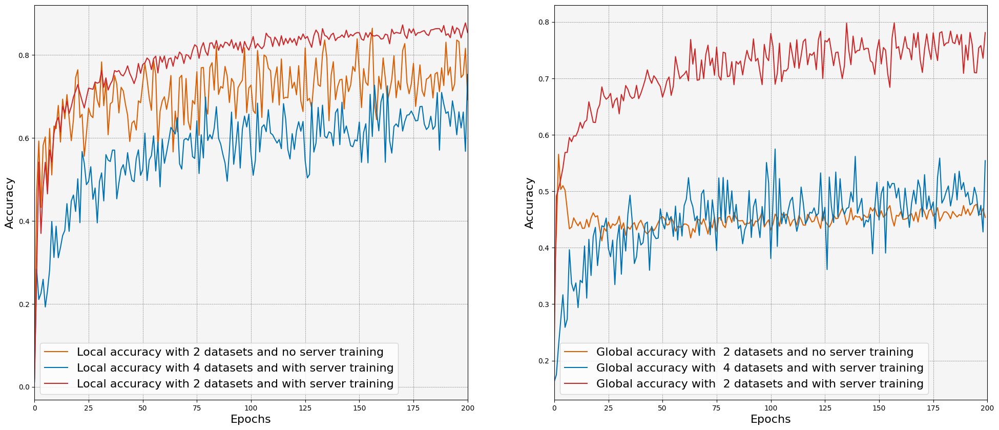

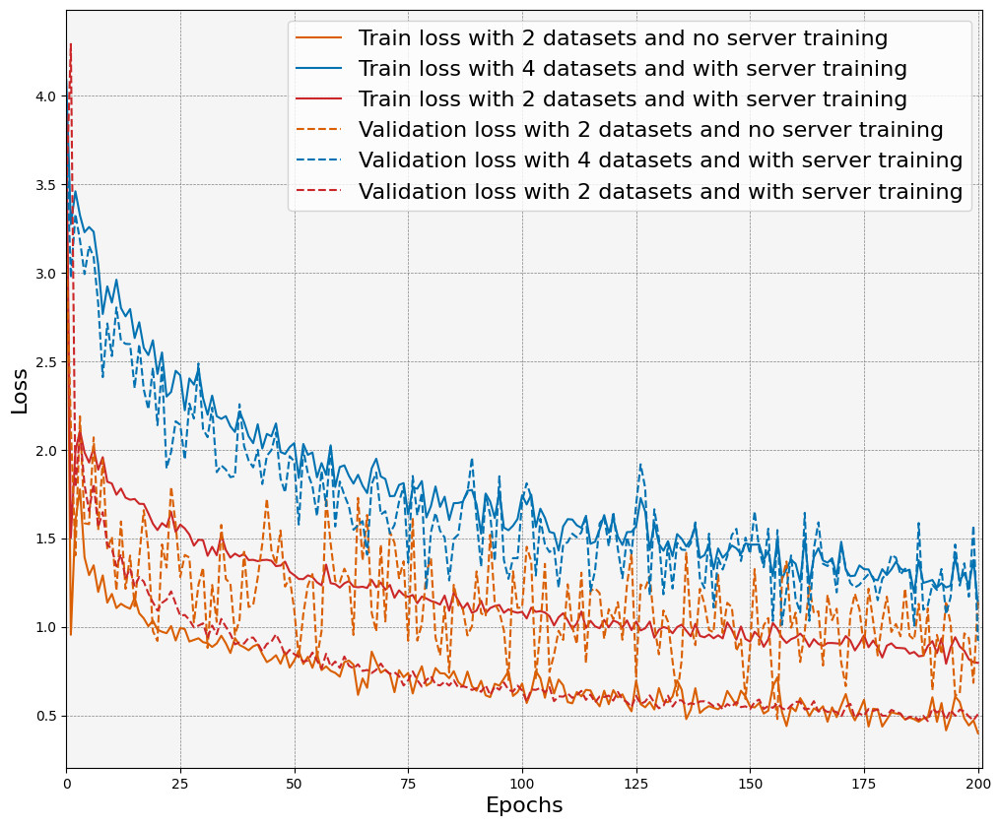

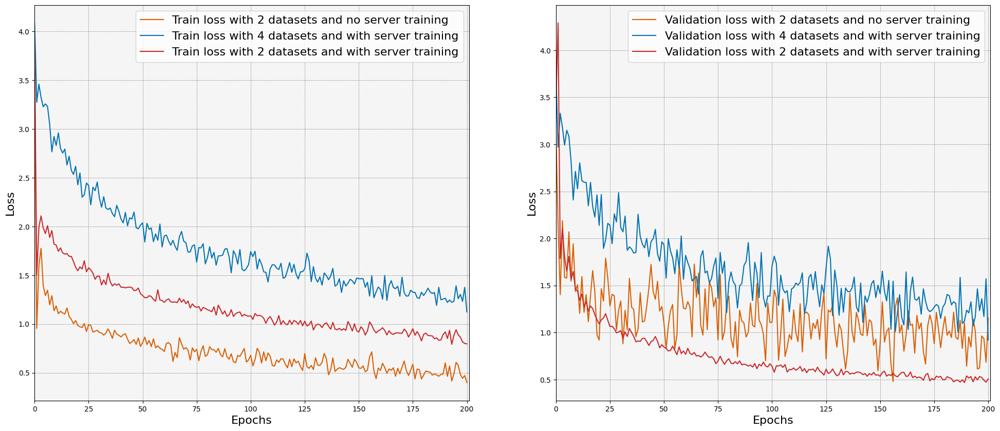

In [ ]:
labels1=[
    "Local accuracy with 2 datasets and no server training",
    "Local accuracy with 4 datasets and with server training",
    "Local accuracy with 2 datasets and with server training",
    "Global accuracy with 2 datasets and no server training",
    "Global accuracy with 4 datasets and with server training",
    "Global accuracy with 2 datasets and with server training"
]
labels2=[
    "Local accuracy with 2 datasets and no server training",
    "Local accuracy with 4 datasets and with server training",
    "Local accuracy with 2 datasets and with server training",
    "Global accuracy with  2 datasets and no server training",
    "Global accuracy with  4 datasets and with server training",
    "Global accuracy with  2 datasets and with server training"
]
labels3=[
    "Train loss with 2 datasets and no server training",
    "Train loss with 4 datasets and with server training",
    "Train loss with 2 datasets and with server training",
    "Validation loss with 2 datasets and no server training",
    "Validation loss with 4 datasets and with server training",
    "Validation loss with 2 datasets and with server training"
]
labels4=[
    "Train loss with 2 datasets and no server training",
    "Train loss with 4 datasets and with server training",
    "Train loss with 2 datasets and with server training",
    "Validation loss with 2 datasets and no server training",
    "Validation loss with 4 datasets and with server training",
    "Validation loss with 2 datasets and with server training"
]
plot_local_global_accuracy_clustered_three(organa_oct_clustered_FL_5LE_200GE_noservertraining_0_00001LR30participation, nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001, oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001, labels2, color="bo")
plot_local_global_accuracy_sperated_clustered_three(organa_oct_clustered_FL_5LE_200GE_noservertraining_0_00001LR30participation, nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001, oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001, labels2, color="bo")
plot_train_val_loss_clustered_three(organa_oct_clustered_FL_5LE_200GE_noservertraining_0_00001LR30participation, nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001, oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001, labels3, color="bo")
plot_train_val_loss_seperated_clustered_three(organa_oct_clustered_FL_5LE_200GE_noservertraining_0_00001LR30participation, nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001, oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001, labels3, color="bo")


better 

In [ ]:
nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001_global_accuracies_dict

NameError: name 'nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001_global_accuracies_dict' is not defined

In [ ]:
for ds in self.names:
  nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001_global_accuracies_dict[ds].append(
      np.mean([
          [result[ds] for result in self.global_accuracies_dict[epoch]]
      ])
  )

TypeError: float() argument must be a string or a real number, not 'dict'

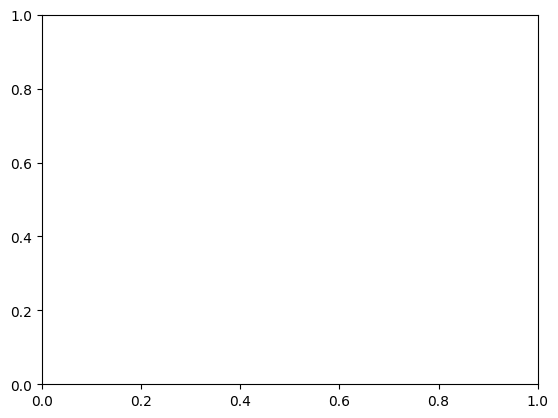

In [ ]:
datasets = ["organamnist", "octmnist", "bloodmnist", "pathmnist", "tissuemnist"]
for ds in datasets:
    plt.plot(nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001.global_accuracies_dict)

# nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001.datasets_averages_global_accuracies
# oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001.datasets_averages_global_accuracies

In [ ]:
clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30
clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist

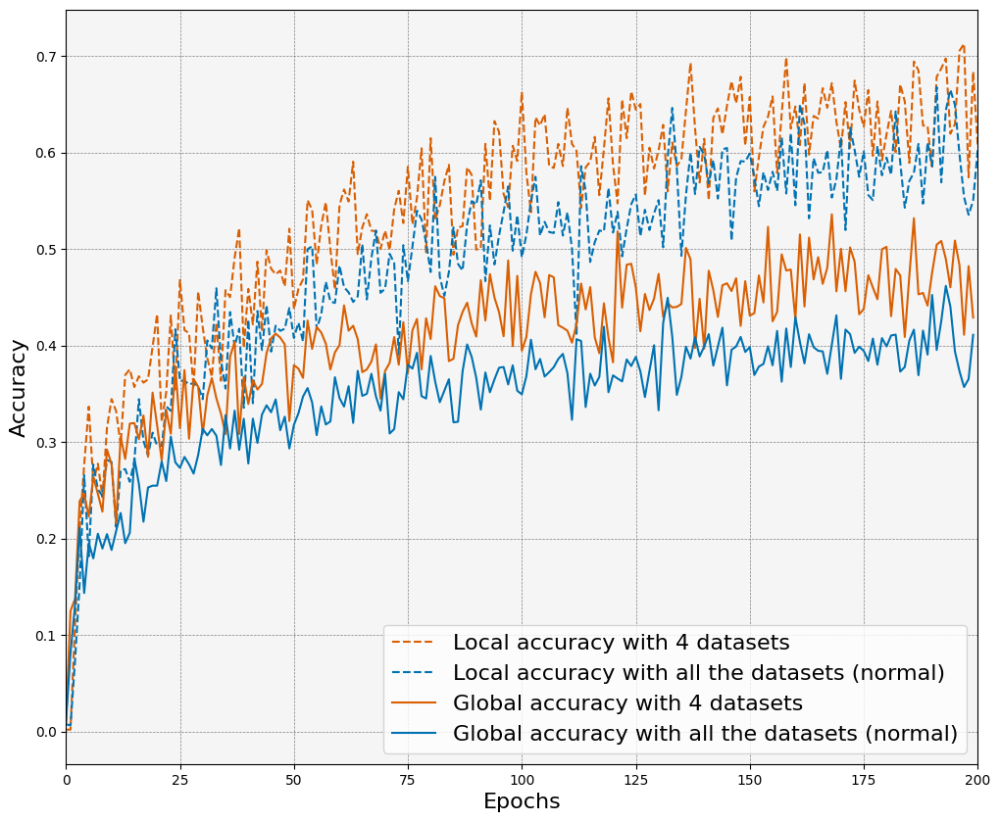

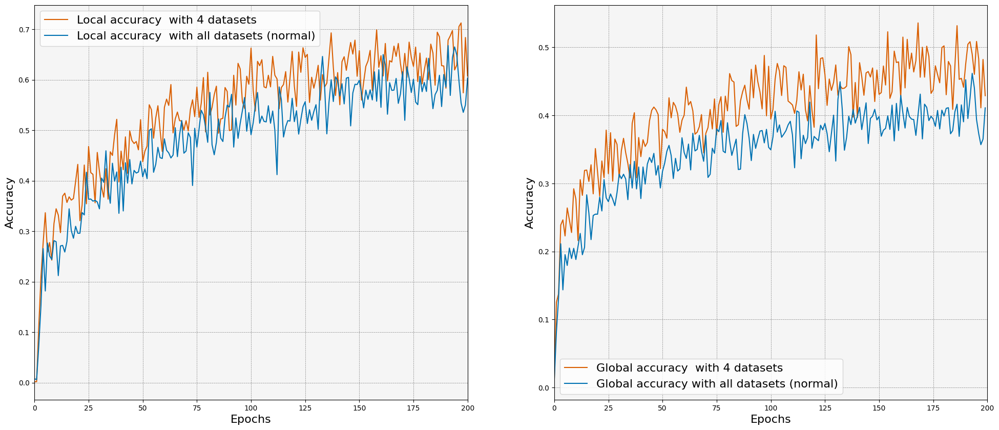

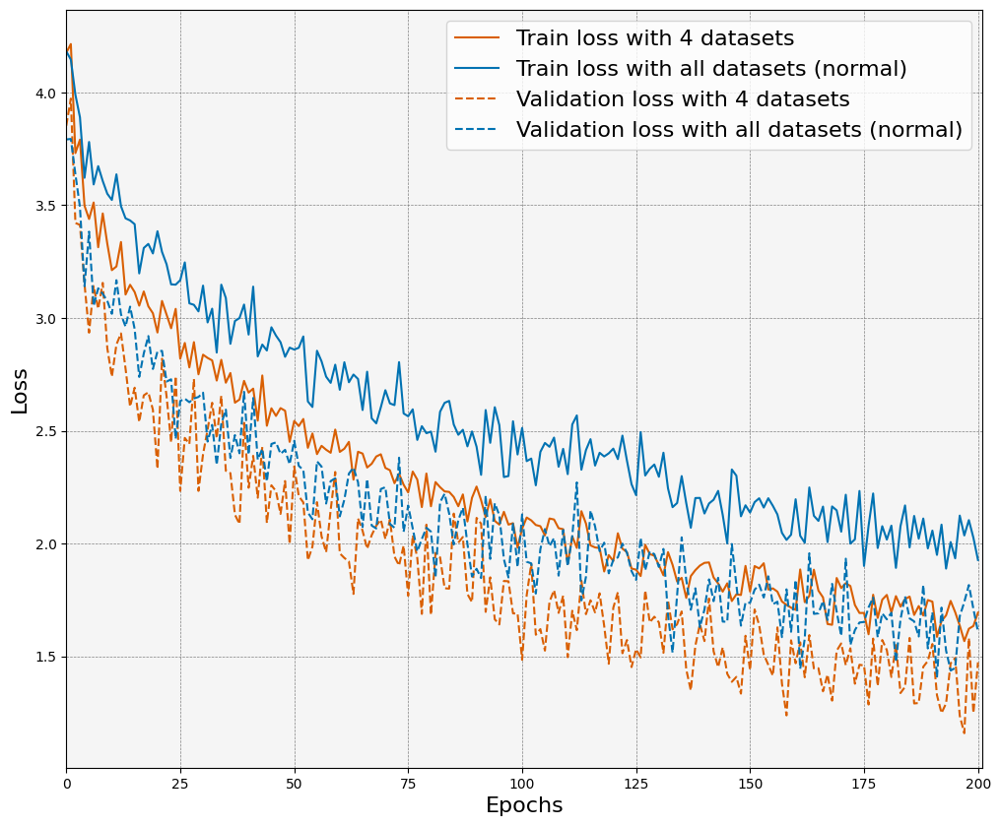

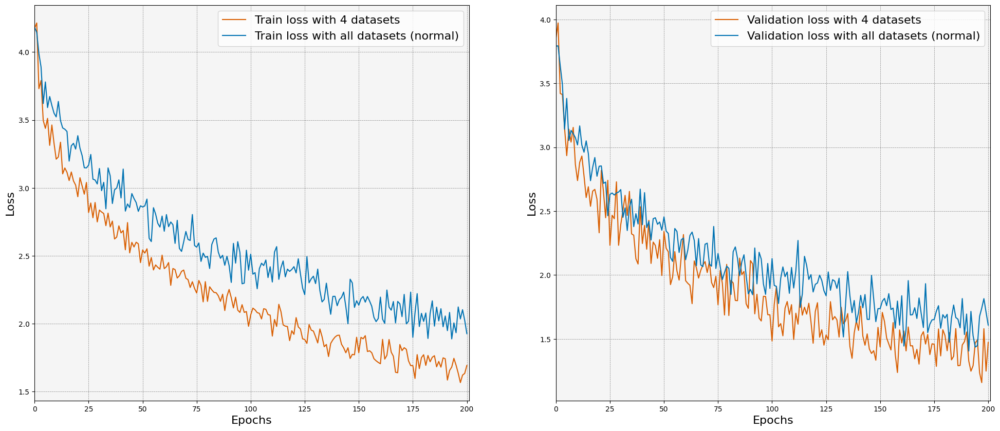

In [569]:
labels1=[
    "Local accuracy with 4 datasets",
    "Local accuracy with all the datasets (normal)",
    "Global accuracy with 4 datasets",
    "Global accuracy with all the datasets (normal)"
]
labels2=[
    "Local accuracy  with 4 datasets",
    "Local accuracy  with all datasets (normal)",
    "Global accuracy  with 4 datasets",
    "Global accuracy with all datasets (normal)"
]
labels3=[    
    "Train loss with 4 datasets",
    "Train loss with all datasets (normal)",
    "Validation loss with 4 datasets",
    "Validation loss with all datasets (normal)"
]
labels4=[    
    "Train loss with 4 datasets",
    "Train loss with all datasets (normal)",
    "Validation loss with 4 datasets",
    "Validation loss with all datasets (normal)"
]

plot_local_global_accuracy_clustered(clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist, clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30, labels1, color="bo")
plot_local_global_accuracy_sperated_clustered(clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist, clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30, labels2, color="bo")
plot_train_val_loss_clustered(clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist, clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30, labels3, color="bo")
plot_train_val_loss_seperated_clustered(clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist, clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30, labels4, color="bo")

In [553]:
print(*dir(clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist), sep="\n")

__class__
__delattr__
__dict__
__dir__
__doc__
__eq__
__format__
__ge__
__getattribute__
__getstate__
__gt__
__hash__
__init__
__init_subclass__
__le__
__lt__
__module__
__ne__
__new__
__reduce__
__reduce_ex__
__repr__
__setattr__
__sizeof__
__slotnames__
__str__
__subclasshook__
__weakref__
avg_local_acc_dict_per_dataset
clients_average_losses
compute_average
config
get_average
global_accuracies
global_accuracies_dict
global_f1_scores
global_results
global_sensitivities
global_specifcities
local_accuracies
local_f1_scores
local_sensitivities
local_specificities
num_epochs
plot_average
plot_local_confusion_matrix
summary_dict
trained
val_losses


In [791]:
clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30_glob_accs_per_dataset = {}

for ds in names:
  clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30_glob_accs_per_dataset[ds] = [
      np.mean([
          [result[ds] for result in samimbaad.global_accuracies_dict[i+1]]
      ]) for i in range(len(samimbaad.global_accuracies_dict))
  ]

In [565]:
clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist_glob_accs_per_dataset = {}

for ds in names:
  if "path" in ds:
    continue
  clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist_glob_accs_per_dataset[ds] = [
      np.mean([
          [result[ds] for result in clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist.global_accuracies_dict[i+1]]
      ]) for i in range(len(clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist.global_accuracies_dict))
  ]

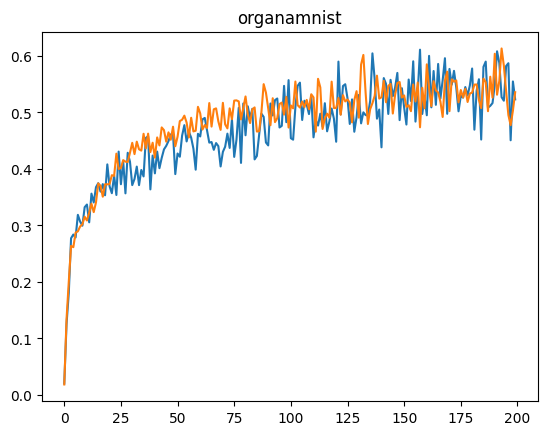

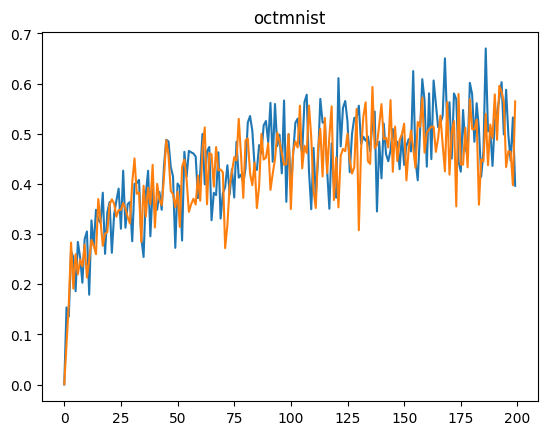

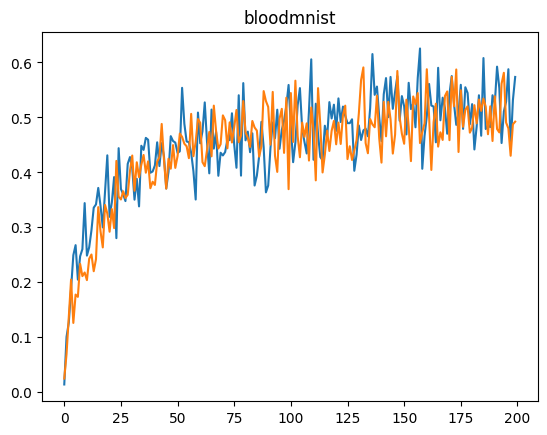

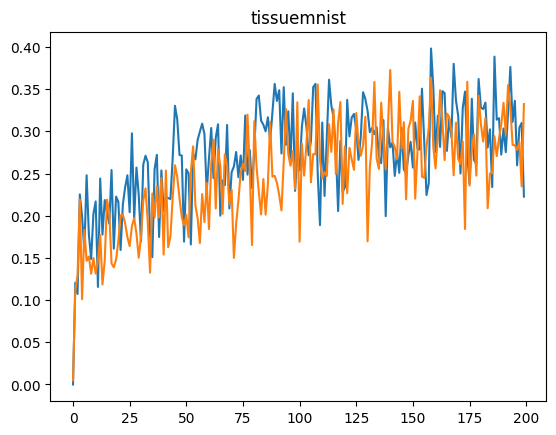

In [567]:
for ds in names:
    if "path" in ds:
        continue
    plt.plot(clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist_glob_accs_per_dataset[ds])
    plt.plot(clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30_glob_accs_per_dataset[ds])
    plt.title(ds)
    plt.show()

In [771]:

clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset['bloodmnist'][111] =clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset['bloodmnist'][112] 


In [801]:
for i, value in enumerate(samimbaad.avg_local_acc_dict_per_dataset['bloodmnist']):
    if value < 0.1:
        print(i, value)
samimbaad.avg_local_acc_dict_per_dataset['bloodmnist'][111] = samimbaad.avg_local_acc_dict_per_dataset['bloodmnist'][112]
# clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset['bloodmnist'][110] = clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset['bloodmnist'][110+1]
# clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset['bloodmnist'][121] = clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset['bloodmnist'][121+1]
# clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset['bloodmnist'][125] = clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset['bloodmnist'][125+1]
# clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset['bloodmnist'][128] = clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset['bloodmnist'][128+1]

110 0
111 0
121 0
125 0
128 0


organamnist 0.9763779527559056
octmnist 0.8740157480314962
bloodmnist 0.84251968503937
pathmnist 0.4645669291338583
tissuemnist 0.4829396325459318


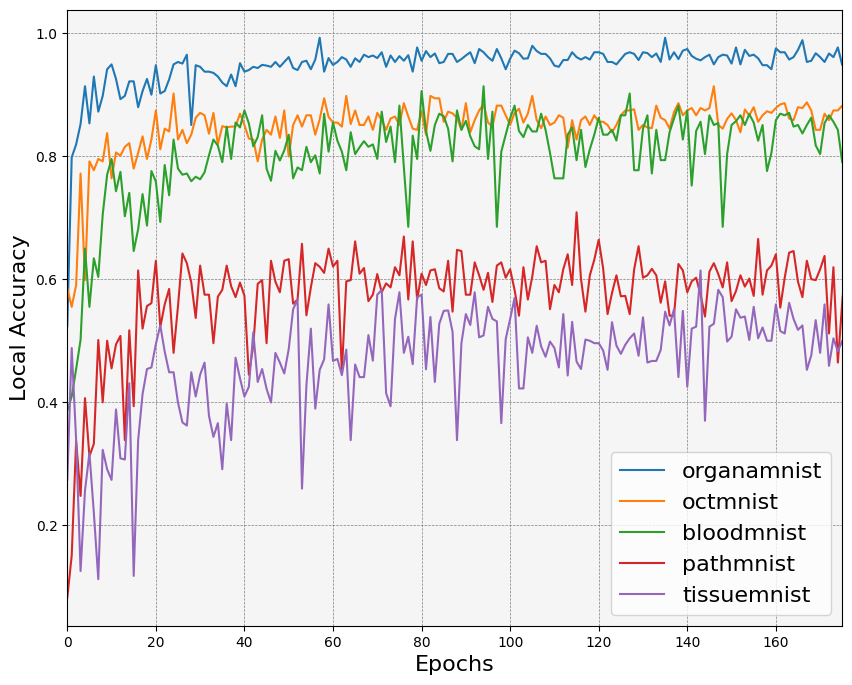

In [804]:
fig, ax = plt.subplots(figsize=(10,8))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
for ds in samimbaad.avg_local_acc_dict_per_dataset.keys():
    ax.plot(clean_array(samimbaad.avg_local_acc_dict_per_dataset[ds]), label=ds)
    print(ds, (clean_array(samimbaad.avg_local_acc_dict_per_dataset[ds])[174]))
    # print(clean_array(clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset[ds]))
ax.legend(fontsize=16)
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Local Accuracy", fontsize=16)
ax.set_xlim(0, 175)
plt.show()

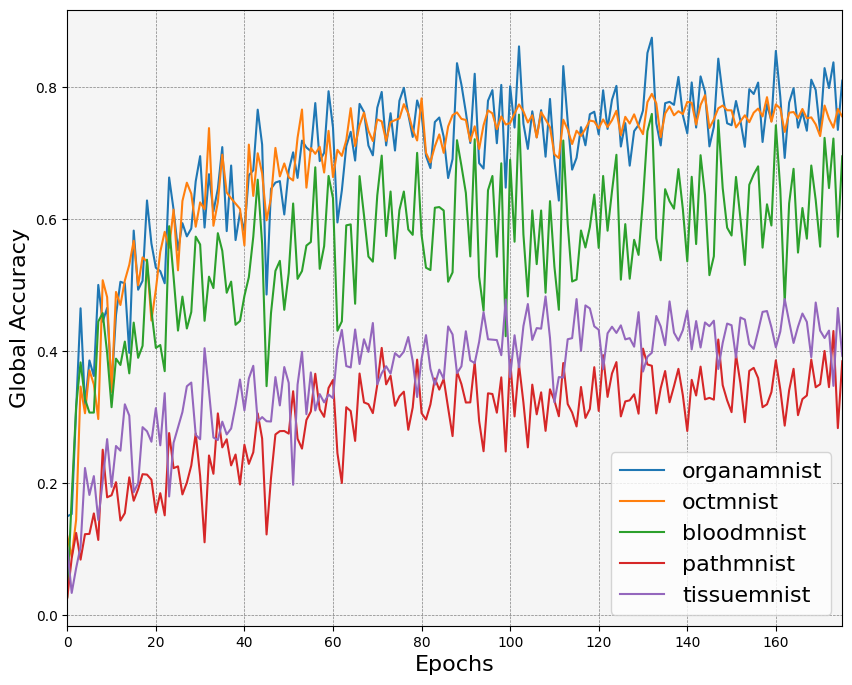

In [794]:
fig, ax = plt.subplots(figsize=(10,8))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
for ds in clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30_glob_accs_per_dataset.keys():
    ax.plot(clean_array(clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30_glob_accs_per_dataset[ds]), label=ds)
    # print(clean_array(clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset[ds]))
ax.legend(fontsize=16)
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Global Accuracy", fontsize=16)
ax.set_xlim(0, 175)
plt.show()

In [549]:
def clean_array(arr):
    d = []
    for i, v in enumerate(arr):
        if v != 0:
            d.append(v)
        else:
            d.append(arr[i+1])
    return d

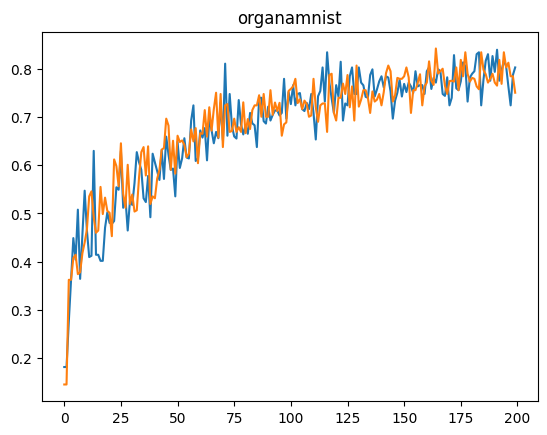

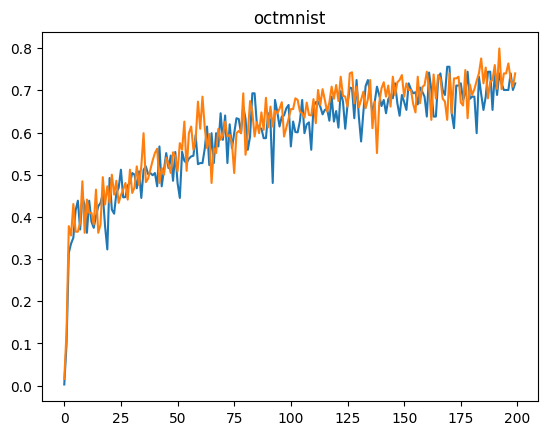

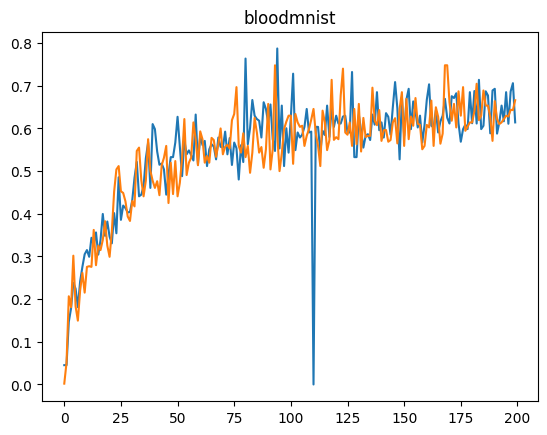

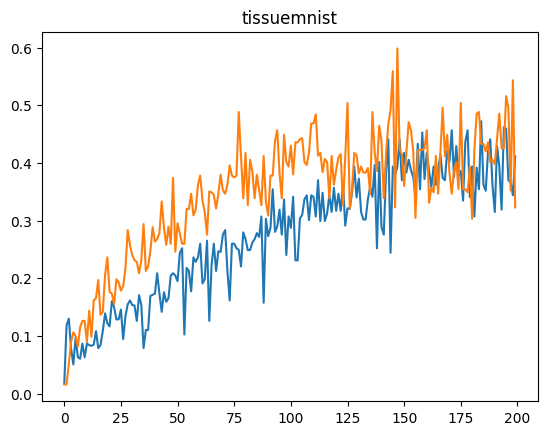

In [552]:
for ds in clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset.keys():
    if ds not in clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist.avg_local_acc_dict_per_dataset.keys():
        continue
    plt.plot(clean_array(clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30.avg_local_acc_dict_per_dataset[ds]), label=ds)
    plt.plot(clean_array(clustered_8000_server_10_client_5_lr_0_00001_150epochs_participation_30_no_pathmnist.avg_local_acc_dict_per_dataset[ds]), label=ds)
    plt.title(ds)
    plt.show()

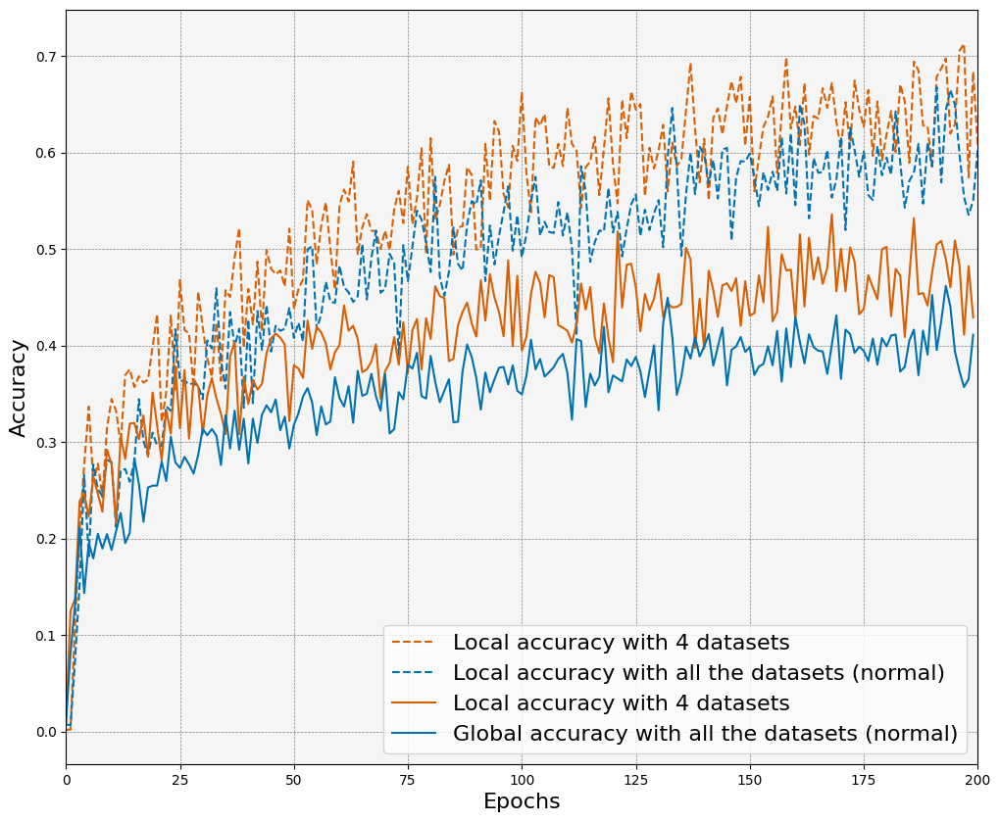

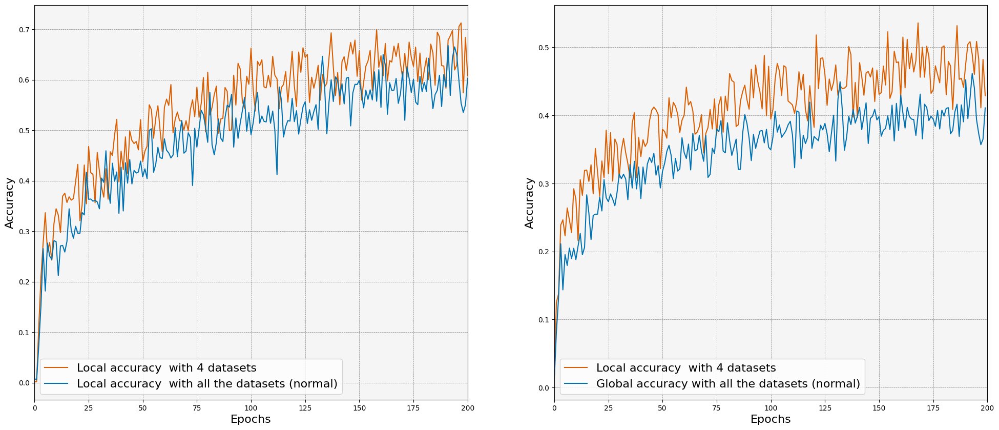

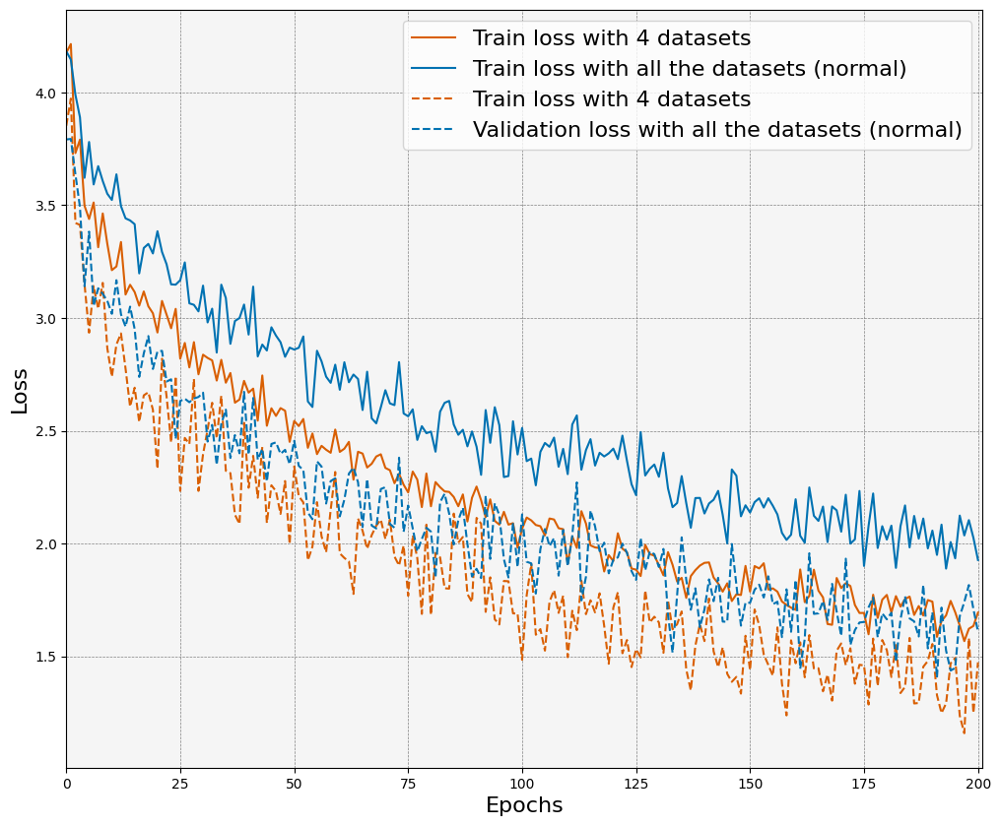

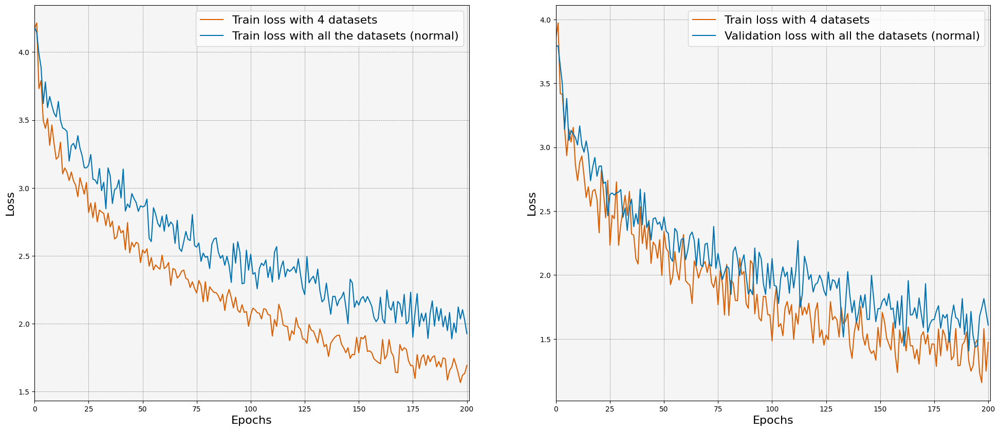

In [55]:
labels1=[
    "Local accuracy with 4 datasets",
    "Local accuracy with all the datasets (normal)",
    "Local accuracy with 4 datasets",
    "Global accuracy with all the datasets (normal)"
]
labels2=[
    "Local accuracy  with 4 datasets",
    "Local accuracy  with all the datasets (normal)",
    "Local accuracy  with 4 datasets",
    "Global accuracy with all the datasets (normal)"
]
labels3=[    
    "Train loss with 4 datasets",
    "Train loss with all the datasets (normal)",
    "Train loss with 4 datasets",
    "Validation loss with all the datasets (normal)"
]
labels4=[    
    "Train loss with 4 datasets",
    "Train loss with all the datasets (normal)",
    "Train loss with 4 datasets",
    "Validation loss with all the datasets (normal)"
]

plot_local_global_accuracy_clustered(nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001, oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001, labels1, color="bo")
plot_local_global_accuracy_sperated_clustered(nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001, oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001, labels2, color="bo")
plot_train_val_loss_clustered(nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001, oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001, labels3, color="bo")
plot_train_val_loss_seperated_clustered(nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001, oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001, labels4, color="bo")

<Axes: >

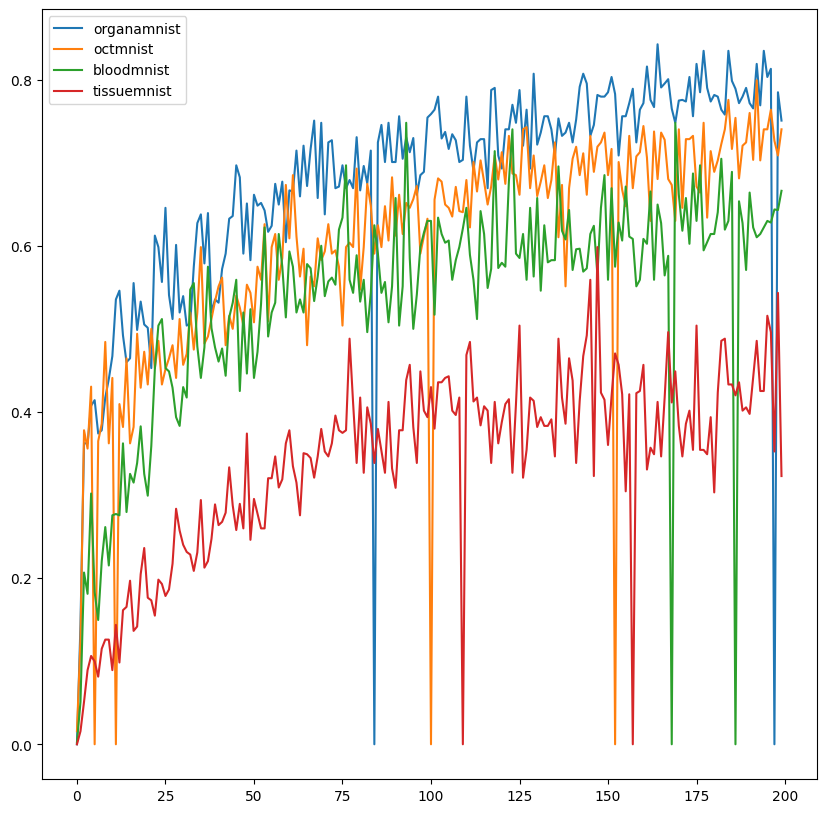

In [89]:
pd.DataFrame(nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001.avg_local_acc_dict_per_dataset).plot(figsize=(10,10))

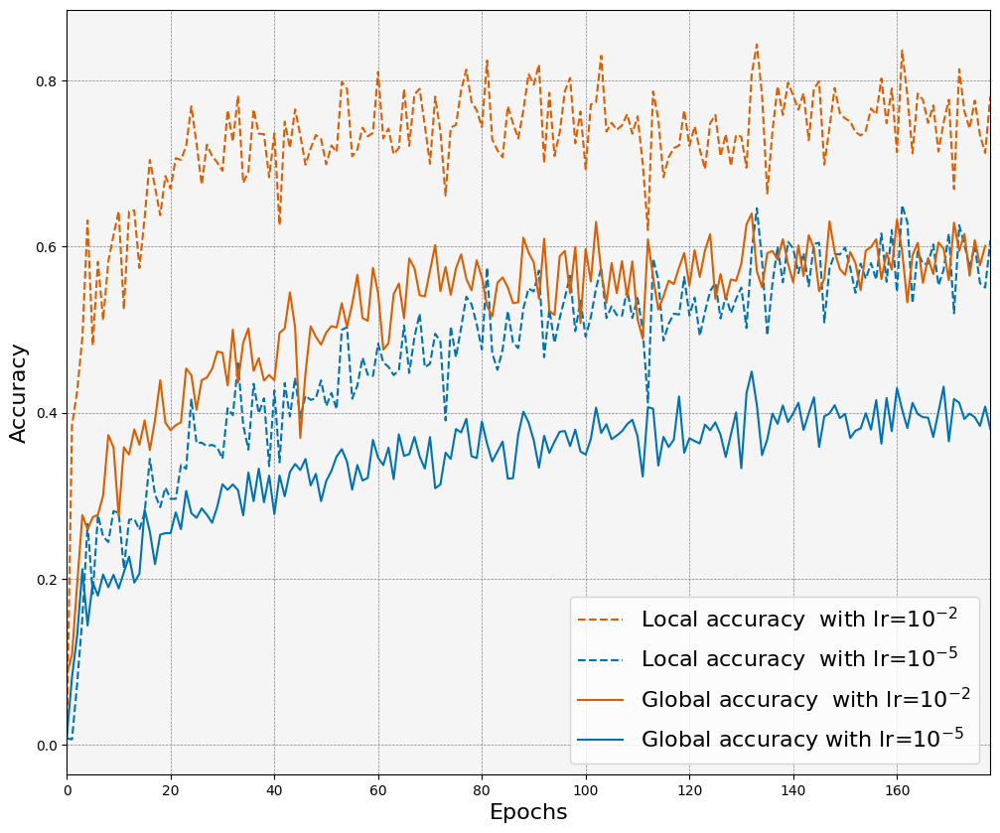

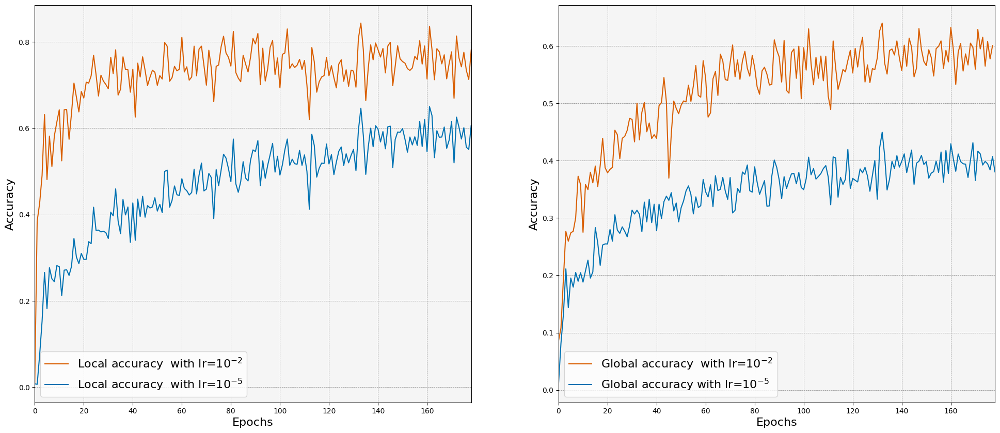

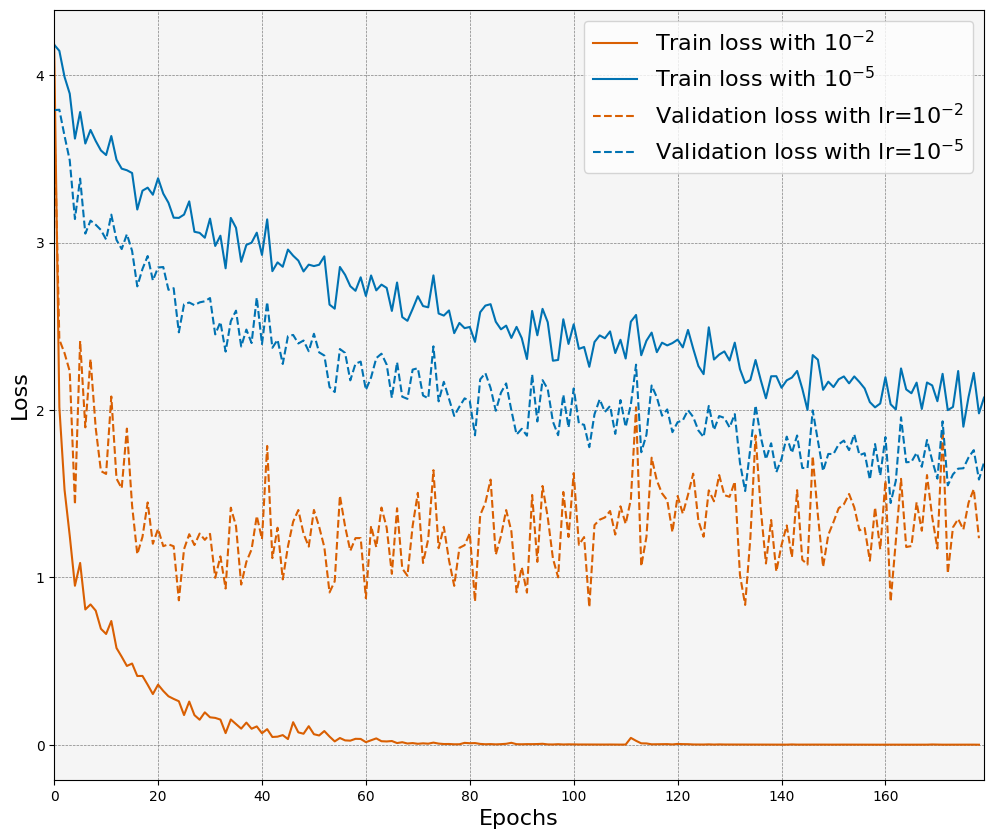

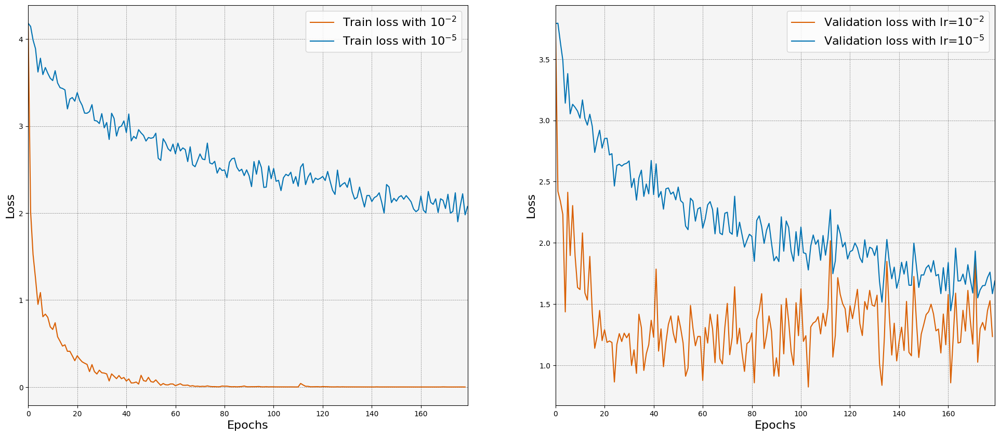

In [92]:
labels1=[
    r"Local accuracy  with lr=$10^{-2}$",
    r"Local accuracy  with lr=$10^{-5}$",
    r"Global accuracy  with lr=$10^{-2}$",
    r"Global accuracy with lr=$10^{-5}$"
]
labels2=[
    r"Local accuracy  with lr=$10^{-2}$",
    r"Local accuracy  with lr=$10^{-5}$",
    r"Global accuracy  with lr=$10^{-2}$",
    r"Global accuracy with lr=$10^{-5}$"
]
labels3=[    
    r"Train loss with $10^{-2}$",
    r"Train loss with $10^{-5}$",
    r"Validation loss with lr=$10^{-2}$",
    r"Validation loss with lr=$10^{-5}$"
]
labels4=[    
    r"Train loss with $10^{-2}$",
    r"Train loss with $10^{-5}$",
    r"Validation loss with lr=$10^{-2}$",
    r"Validation loss with lr=$10^{-5}$"
]

plot_local_global_accuracy_clustered(samimbaad, oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001, labels1, color="bo")
plot_local_global_accuracy_sperated_clustered(samimbaad, oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001, labels2, color="bo")
plot_train_val_loss_clustered(samimbaad, oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001, labels3, color="bo")
plot_train_val_loss_seperated_clustered(samimbaad, oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001, labels4, color="bo")

### Participation

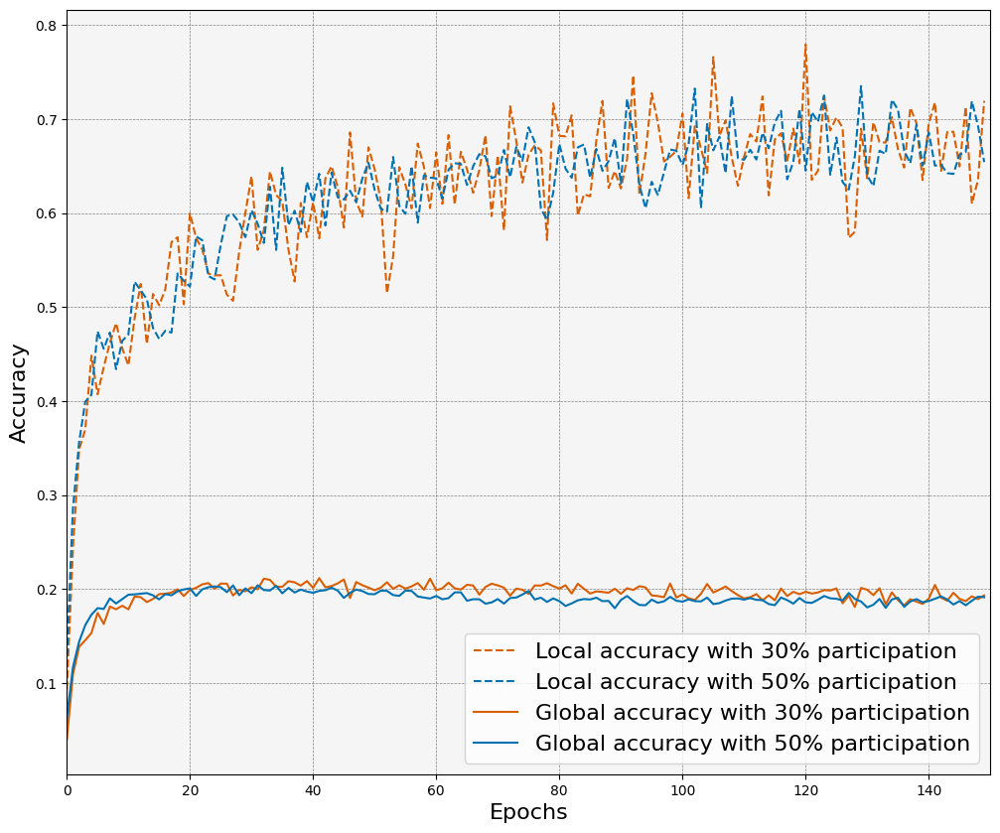

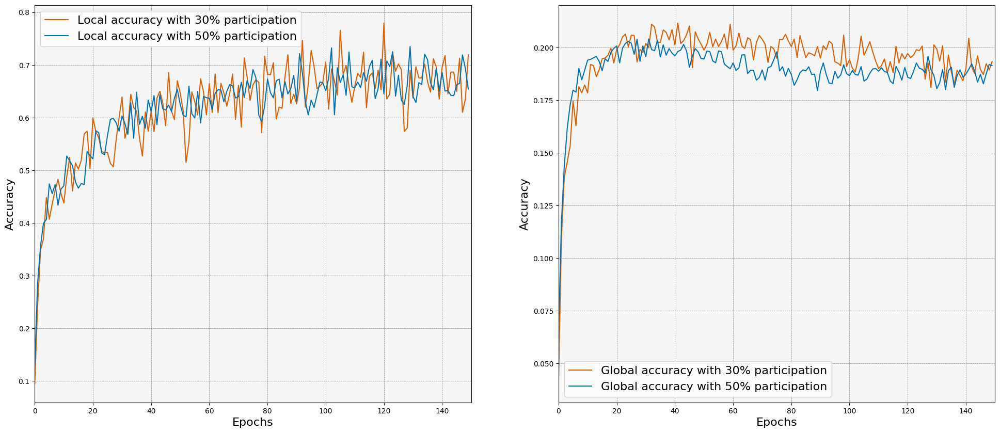

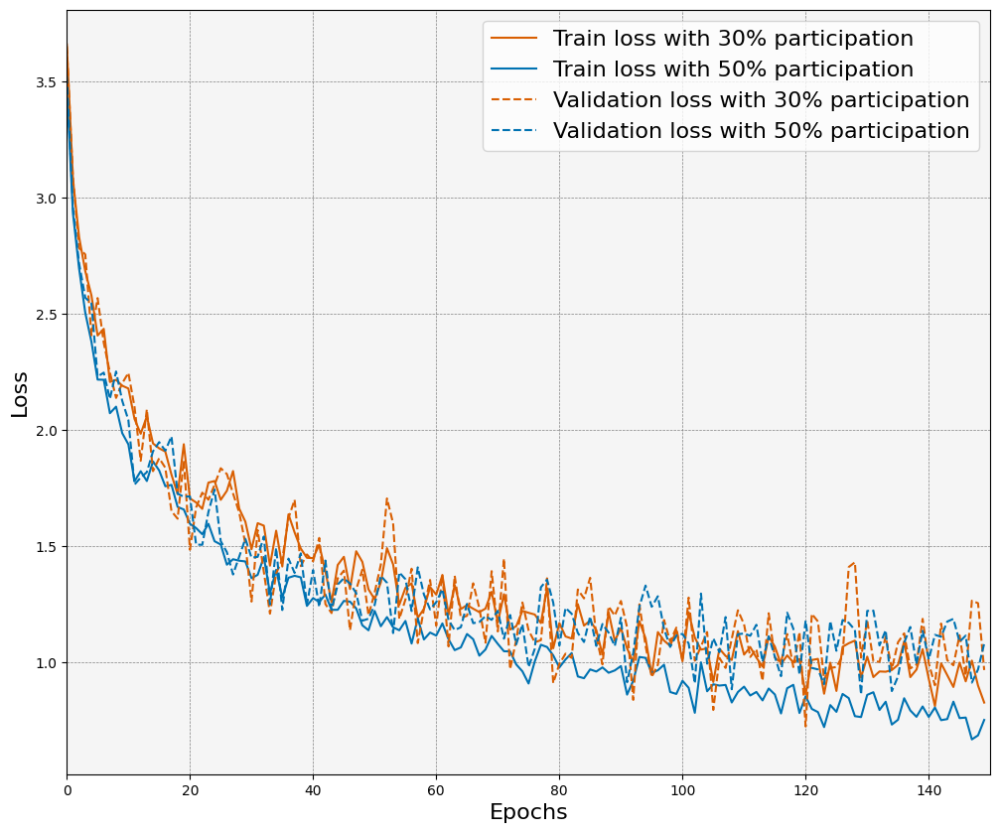

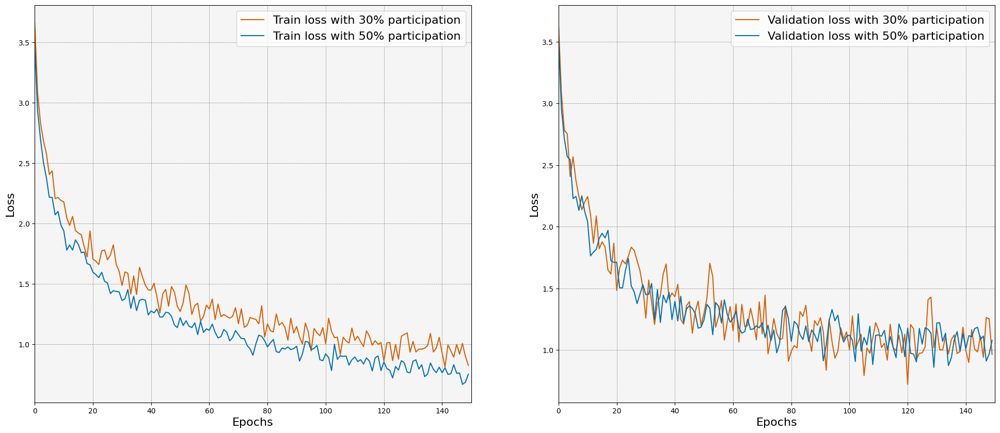

In [56]:
labels1=[
    "Local accuracy with 30% participation",
    "Local accuracy with 50% participation",
    "Global accuracy with 30% participation",
    "Global accuracy with 50% participation"
]
labels2=[
    "Local accuracy with 30% participation",
    "Local accuracy with 50% participation",
    "Global accuracy with 30% participation",
    "Global accuracy with 50% participation"
]
labels3=[
    "Train loss with 30% participation",
    "Train loss with 50% participation",
    "Validation loss with 30% participation",
    "Validation loss with 50% participation"
]
labels4=[
    "Train loss with 30% participation",
    "Train loss with 50% participation",
    "Validation loss with 30% participation",
    "Validation loss with 50% participation"
]
plot_local_global_accuracy(ordered_5local_10server_0_00001_30partiipation, ordered_5local_10server_lr_0_00001_50participation, labels1, color="bo")
plot_local_global_accuracy_sperated(ordered_5local_10server_0_00001_30partiipation, ordered_5local_10server_lr_0_00001_50participation, labels2, color="bo")
plot_train_val_loss(ordered_5local_10server_0_00001_30partiipation, ordered_5local_10server_lr_0_00001_50participation, labels3, color="bo")
plot_train_val_loss_seperated(ordered_5local_10server_0_00001_30partiipation, ordered_5local_10server_lr_0_00001_50participation, labels4, color="bo")

### participation

In [58]:
# Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001
# ordered_5local_10server_0_00001_30partiipation

In [59]:
# get_local_accuracy(ordered_5local_10server_lr_0_00001_50participation)

[[3, 42, 36, 17, 12, 32, 35, 33, 43, 26, 25, 14, 46, 37, 1], [40, 39, 5, 13, 47, 14, 31, 10, 17, 34, 45, 25, 20, 26, 36], [46, 6, 24, 23, 14, 44, 11, 21, 20, 29, 48, 18, 35, 39, 2], [41, 46, 16, 47, 43, 31, 36, 38, 23, 19, 40, 8, 44, 35, 14], [27, 26, 32, 17, 10, 37, 31, 35, 20, 36, 16, 1, 41, 5, 4], [22, 29, 42, 40, 38, 3, 4, 26, 19, 45, 17, 12, 48, 49, 6], [1, 6, 2, 24, 43, 10, 25, 4, 42, 30, 49, 34, 38, 13, 21], [16, 48, 27, 25, 40, 3, 45, 43, 2, 6, 29, 21, 30, 13, 19], [27, 33, 37, 9, 22, 34, 43, 1, 49, 14, 40, 24, 2, 13, 16], [20, 12, 1, 8, 35, 49, 33, 34, 16, 42, 9, 48, 29, 44, 21], [47, 24, 7, 10, 4, 5, 21, 37, 38, 42, 3, 40, 44, 34, 14], [46, 12, 37, 29, 16, 25, 49, 26, 48, 13, 6, 42, 39, 1, 45], [35, 36, 0, 10, 11, 39, 48, 14, 49, 21, 5, 22, 18, 27, 28], [6, 21, 43, 3, 47, 48, 28, 34, 4, 19, 7, 33, 0, 31, 45], [20, 37, 29, 1, 15, 7, 49, 3, 9, 46, 25, 28, 38, 17, 30], [24, 4, 3, 23, 43, 48, 37, 13, 27, 17, 6, 35, 2, 49, 46], [5, 15, 41, 36, 39, 26, 25, 3, 46, 13, 24, 44, 0, 16,

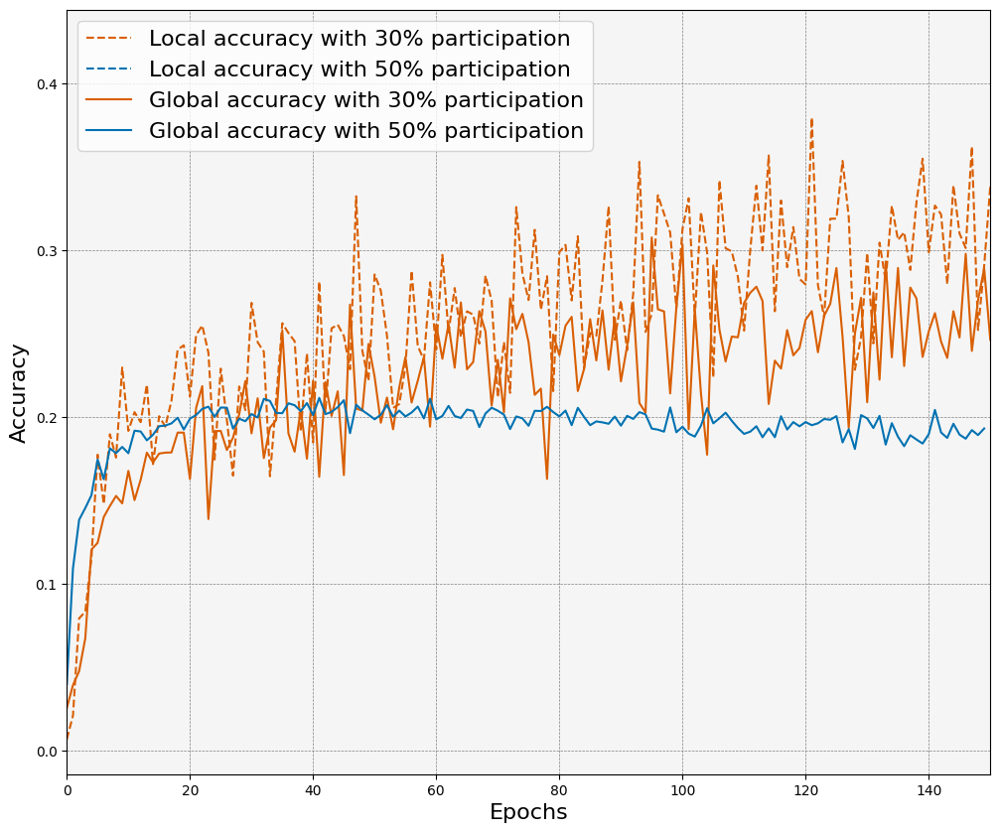

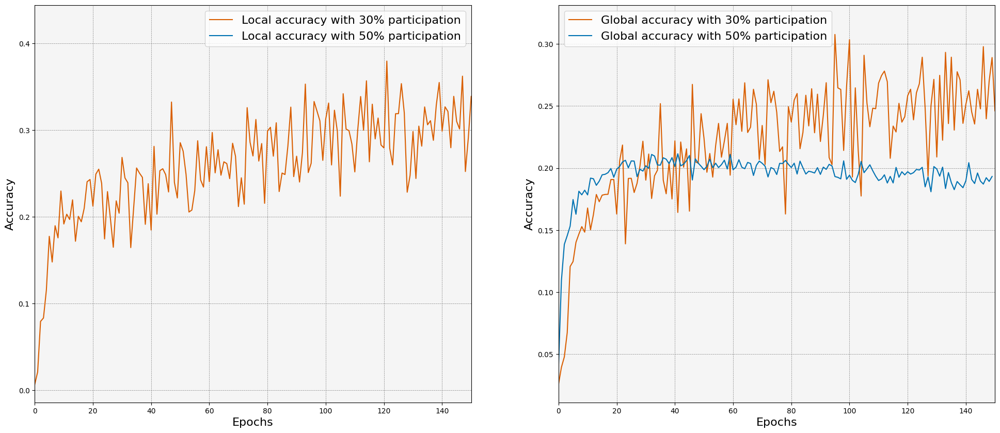

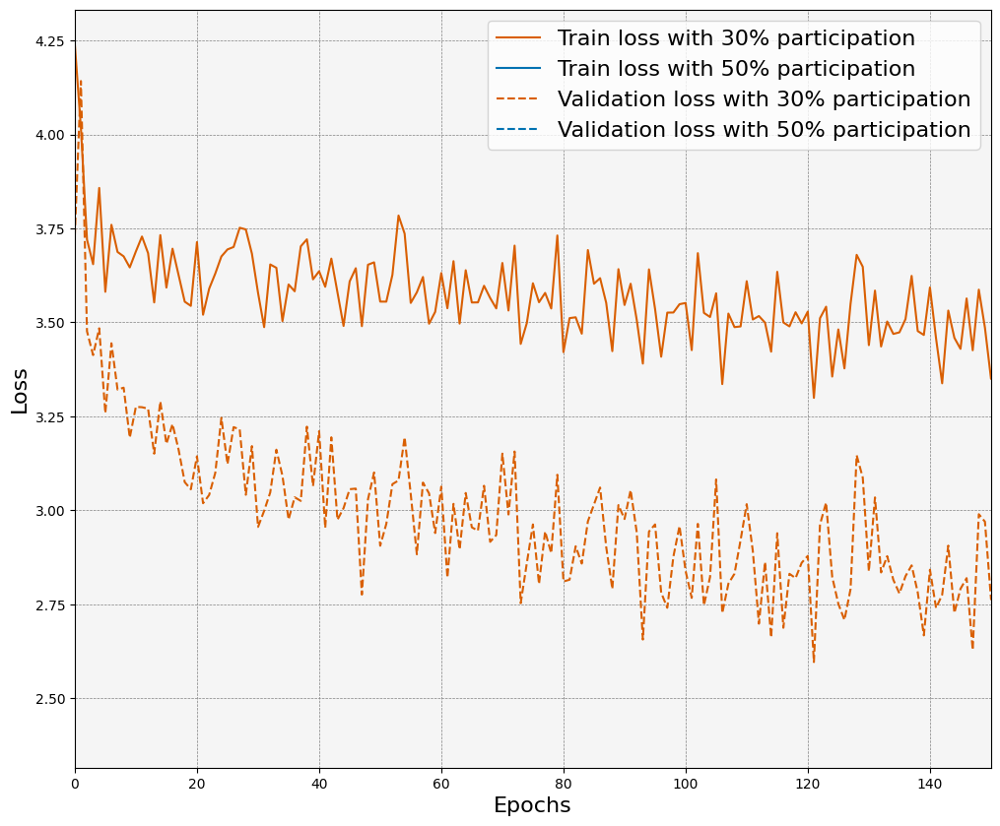

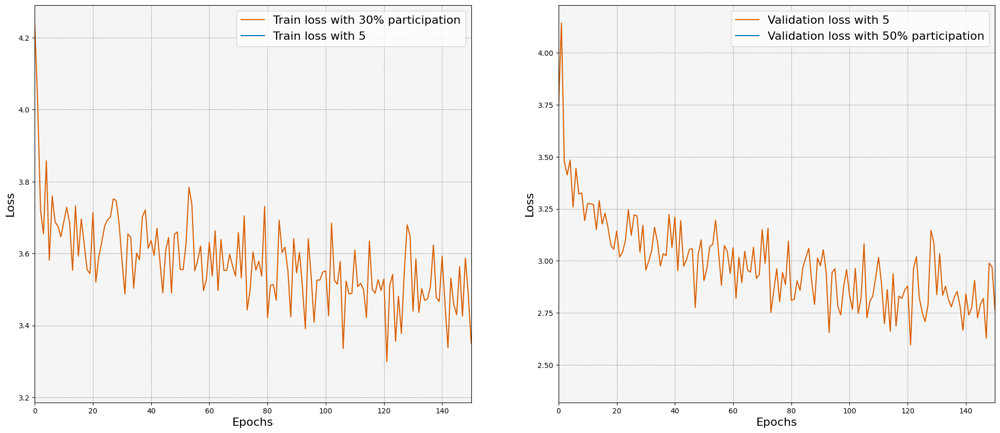

In [613]:
labels1=[
    "Local accuracy with 30% participation",
    "Local accuracy with 50% participation",
    "Global accuracy with 30% participation",
    "Global accuracy with 50% participation"
]
labels2=[
    "Local accuracy with 30% participation",
    "Local accuracy with 50% participation",
    "Global accuracy with 30% participation",
    "Global accuracy with 50% participation"
]
labels3=[
    "Train loss with 30% participation",
    "Train loss with 50% participation",
    "Validation loss with 30% participation",
    "Validation loss with 50% participation"
]
labels4=[
    "Train loss with 30% participation",
    "Train loss with 5",
    "Validation loss with 5",
    "Validation loss with 50% participation"
]
print(ordered_5local_10server_0_00001_30partiipation.trained)
# Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001
# ordered_5local_10server_lr_0_00001_50participation
plot_local_global_accuracy_clustered(Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001, ordered_5local_10server_0_00001_30partiipation, labels1, color="bo")
plot_local_global_accuracy_sperated_clustered(Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001, ordered_5local_10server_0_00001_30partiipation, labels2, color="bo")
plot_train_val_loss_clustered(Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001, ordered_5local_10server_0_00001_30partiipation, labels3, color="bo")
plot_train_val_loss_seperated_clustered(Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001, ordered_5local_10server_0_00001_30partiipation, labels4, color="bo")

### local epochs

In [ ]:
ordered_5local_10server_lr_0_00001_50participation
Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001

In [625]:
labels1=[
    "Local accuracy with 1 local epoch",
    "Local accuracy with 5 local epochs",
    "Global accuracy with 1 local epoch",
    "Global accuracy with 5 local epochs"
]
labels2=[
    "Local accuracy with 1 local epoch",
    "Local accuracy with 5 local epochs",
    "Global accuracy with 1 local epoch",
    "Global accuracy with 5 local epochs"
]
labels3=[
    "Train loss with 1 local epoch",
    "Train loss with 5 local epochs",
    "Validation loss with 1 local epoch",
    "Validation loss with 5 local epochs"
]
labels4=[
    "Train loss with 1 local epoch",
    "Train loss with 5 local epochs",
    "Validation loss with 1 local epoch",
    "Validation loss with 5 local epochs"
]
colab_2clustered_10_4lr_5local_10global_30participation
# Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001
# ordered_5local_10server_lr_0_00001_50participation
plot_local_global_accuracy_clustered(ordered_5local_10server_lr_0_00001_50participation, Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001, labels1, color="bo")
plot_local_global_accuracy_sperated_clustered(ordered_5local_10server_lr_0_00001_50participation, Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001, labels2, color="bo")
plot_train_val_loss_clustered(ordered_5local_10server_lr_0_00001_50participation, Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001, labels3, color="bo")
plot_train_val_loss_seperated_clustered(ordered_5local_10server_lr_0_00001_50participation, Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001, labels4, color="bo")

IndexError: list index out of range

### ordering

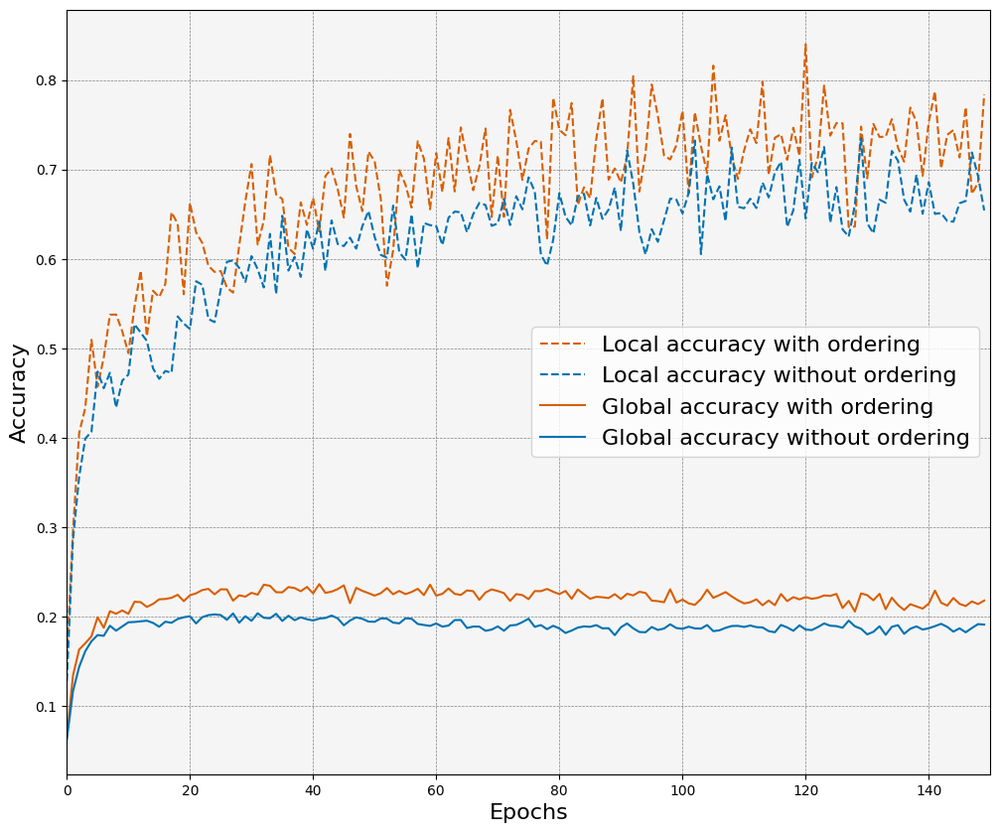

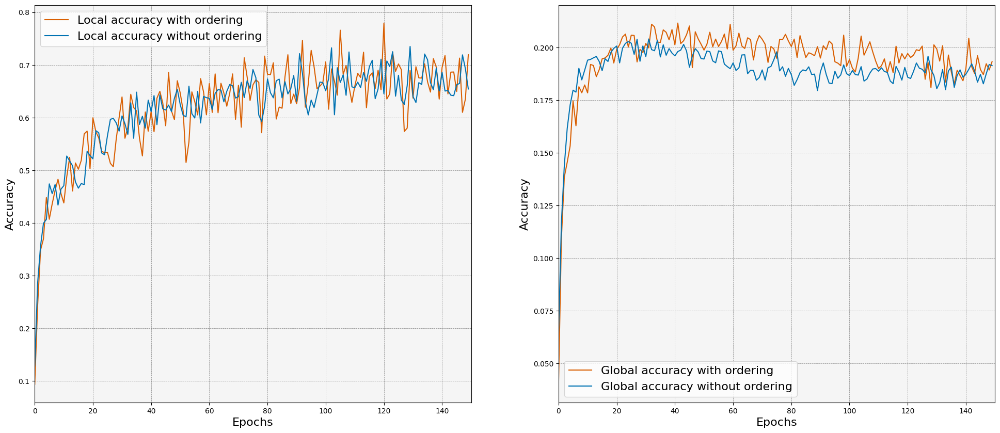

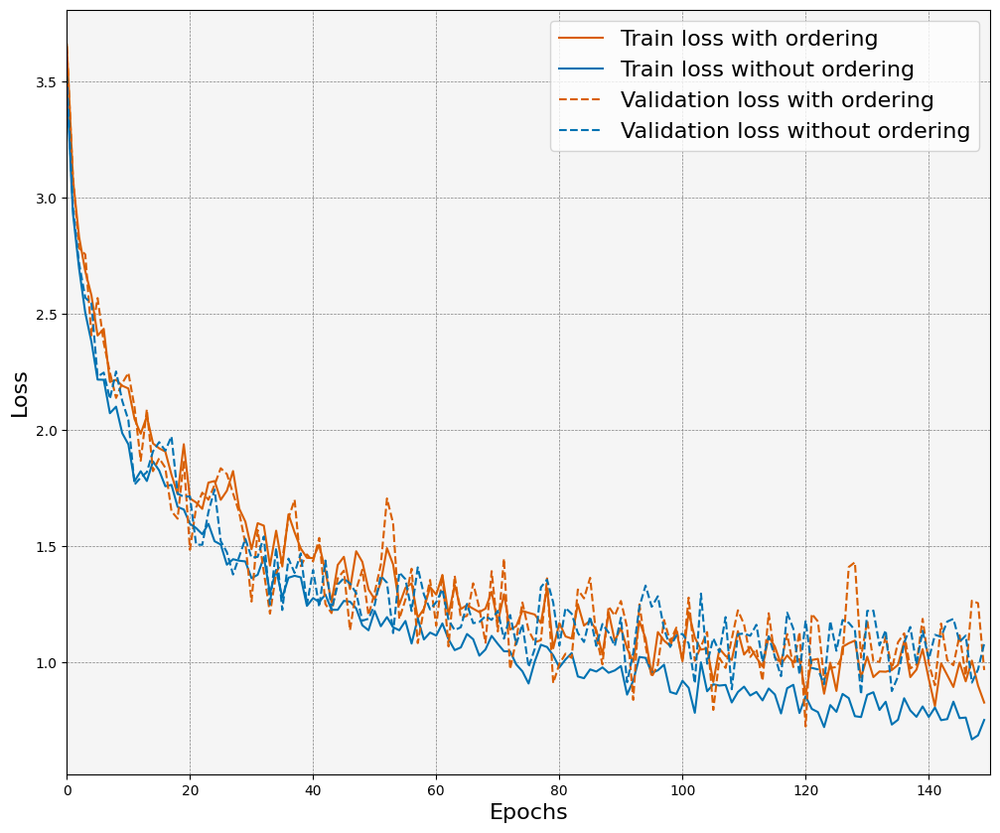

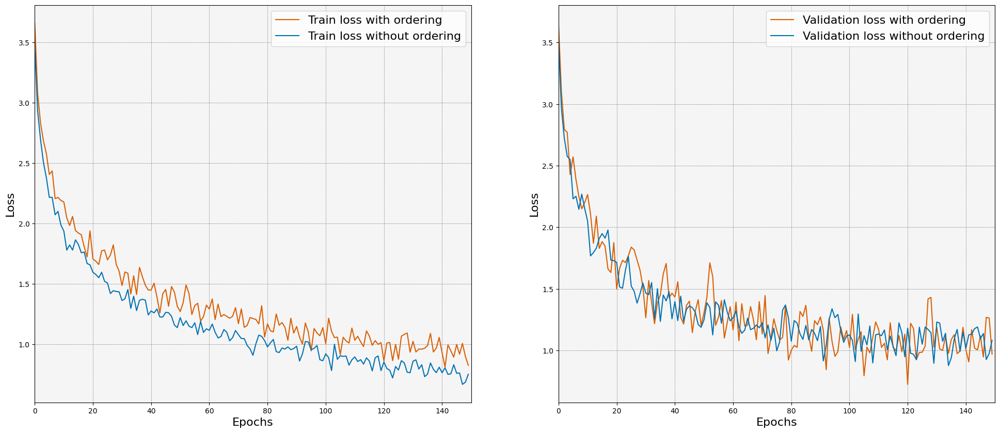

In [688]:
labels1=[
    "Local accuracy with ordering",
    "Local accuracy without ordering",
    "Global accuracy with ordering",
    "Global accuracy without ordering"
]
labels2=[
    "Local accuracy with ordering",
    "Local accuracy without ordering",
    "Global accuracy with ordering",
    "Global accuracy without ordering"
]
labels3=[
    "Train loss with ordering",
    "Train loss without ordering",
    "Validation loss with ordering",
    "Validation loss without ordering"
]
labels4=[
    "Train loss with ordering",
    "Train loss without ordering",
    "Validation loss with ordering",
    "Validation loss without ordering"
]

plot_local_global_accuracy(ordered_5local_10server_0_00001_30partiipation, ordered_5local_10server_lr_0_00001_50participation, labels1, color="bo")
plot_local_global_accuracy_sperated(ordered_5local_10server_0_00001_30partiipation, ordered_5local_10server_lr_0_00001_50participation, labels2, color="bo")
plot_train_val_loss(ordered_5local_10server_0_00001_30partiipation, ordered_5local_10server_lr_0_00001_50participation, labels3, color="bo")
plot_train_val_loss_seperated(ordered_5local_10server_0_00001_30partiipation, ordered_5local_10server_lr_0_00001_50participation, labels4, color="bo")

### Learning rate

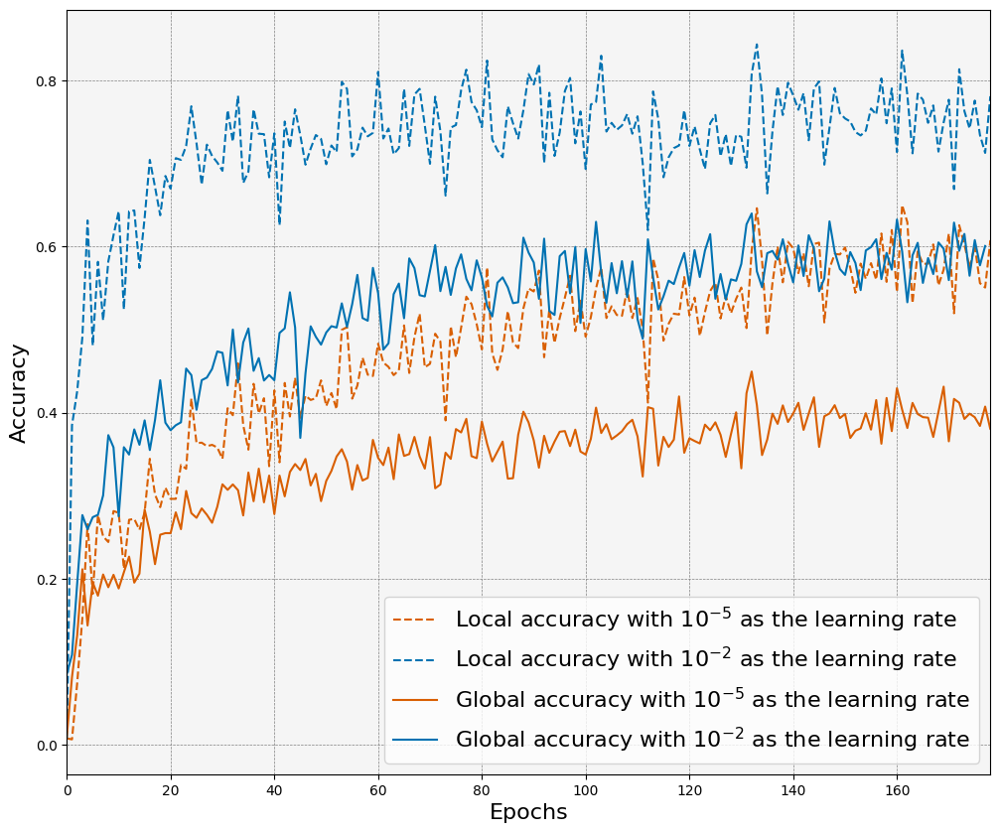

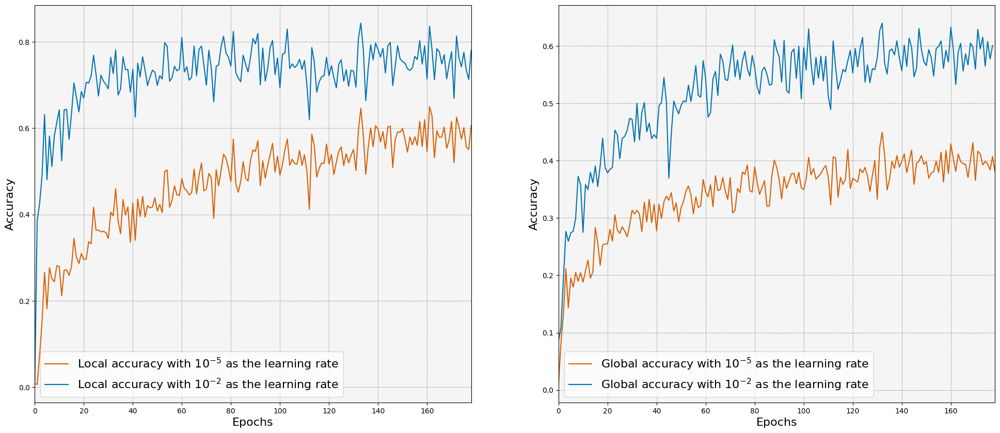

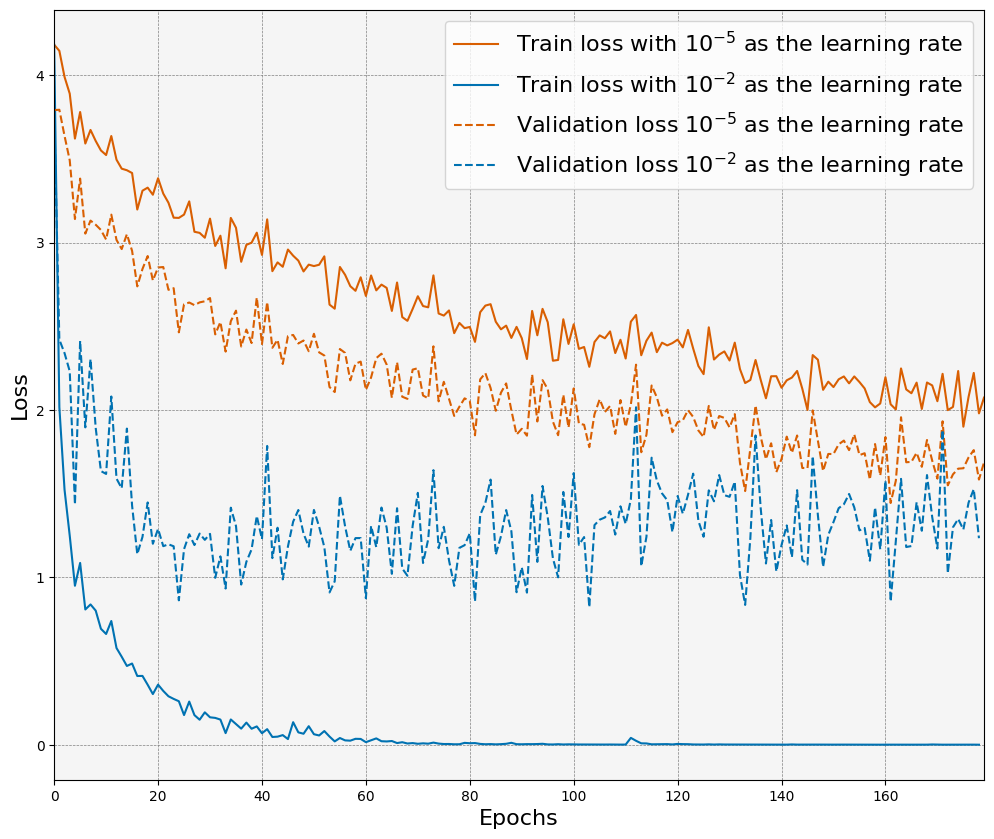

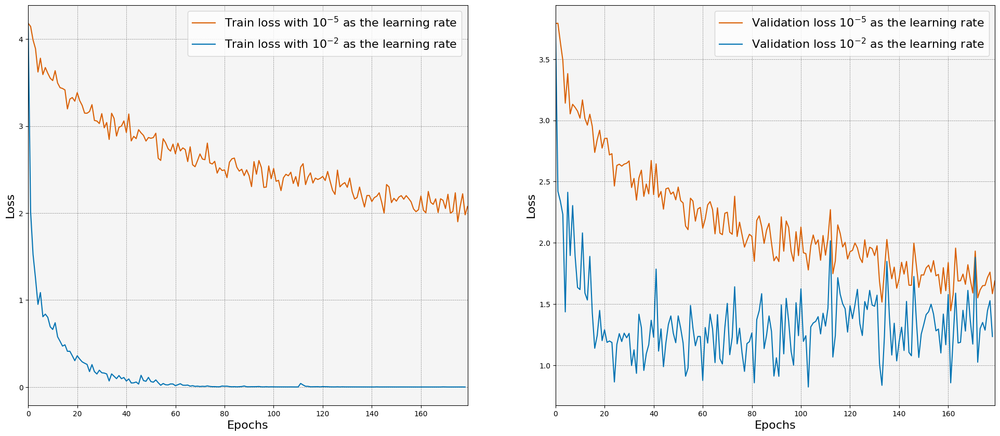

In [487]:
labels1=[
    r"Local accuracy with $10^{-5}$ as the learning rate",
    r"Local accuracy with $10^{-2}$ as the learning rate",
    r"Global accuracy with $10^{-5}$ as the learning rate",
    r"Global accuracy with $10^{-2}$ as the learning rate"
]

labels2=[
    r"Local accuracy with $10^{-5}$ as the learning rate",
    r"Local accuracy with $10^{-2}$ as the learning rate",
    r"Global accuracy with $10^{-5}$ as the learning rate",
    r"Global accuracy with $10^{-2}$ as the learning rate"
]

labels3=[
    r"Train loss with $10^{-5}$ as the learning rate",
    r"Train loss with $10^{-2}$ as the learning rate",
    r"Validation loss $10^{-5}$ as the learning rate",
    r"Validation loss $10^{-2}$ as the learning rate"
]

labels4=[
    r"Train loss with $10^{-5}$ as the learning rate",
    r"Train loss with $10^{-2}$ as the learning rate",
    r"Validation loss $10^{-5}$ as the learning rate",
    r"Validation loss $10^{-2}$ as the learning rate"
]

# Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001
# ordered_5local_10server_lr_0_00001_50participation
plot_local_global_accuracy_clustered(clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30, samimbaad, labels1, color="bo")
plot_local_global_accuracy_sperated_clustered(clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30, samimbaad, labels2, color="bo")
plot_train_val_loss_clustered(clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30, samimbaad, labels3, color="bo")
plot_train_val_loss_seperated_clustered(clustered_8000_server_10_client_5_lr_constant_0_00001_150epochs_participation_30, samimbaad, labels4, color="bo")

In [496]:
samimbaad.config

{'algorithm': 'fedavg',
 'baseline': False,
 'batch_size': 50,
 'criterion': torch.nn.modules.loss.CrossEntropyLoss,
 'data_path': './data',
 'device': 'cuda:0',
 'eval_train': True,
 'gamma': None,
 'global_epochs': 200,
 'iid': False,
 'learning_rate': 0.01,
 'local_epochs': 1,
 'cluster_frequency': 5,
 'log_path': './logs',
 'participation_percent': 0.3,
 'seed': 1,
 'task': 'multi-class'}

In [619]:
print(clustered_0_3participation_5_local_10_server_lr_changes_first_time.config)
print(colab_2clustered_10_4lr_5local_10global_30participation.config)

{'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 200, 'iid': False, 'learning_rate': 1e-05, 'local_epochs': 10, 'cluster_frequency': 5, 'log_path': './logs', 'participation_percent': 0.3, 'seed': 1, 'task': 'multi-class'}
{'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 200, 'iid': False, 'learning_rate': 1e-05, 'local_epochs': 1, 'cluster_frequency': 5, 'log_path': './logs', 'participation_percent': 0.3, 'seed': 1, 'task': 'multi-class'}


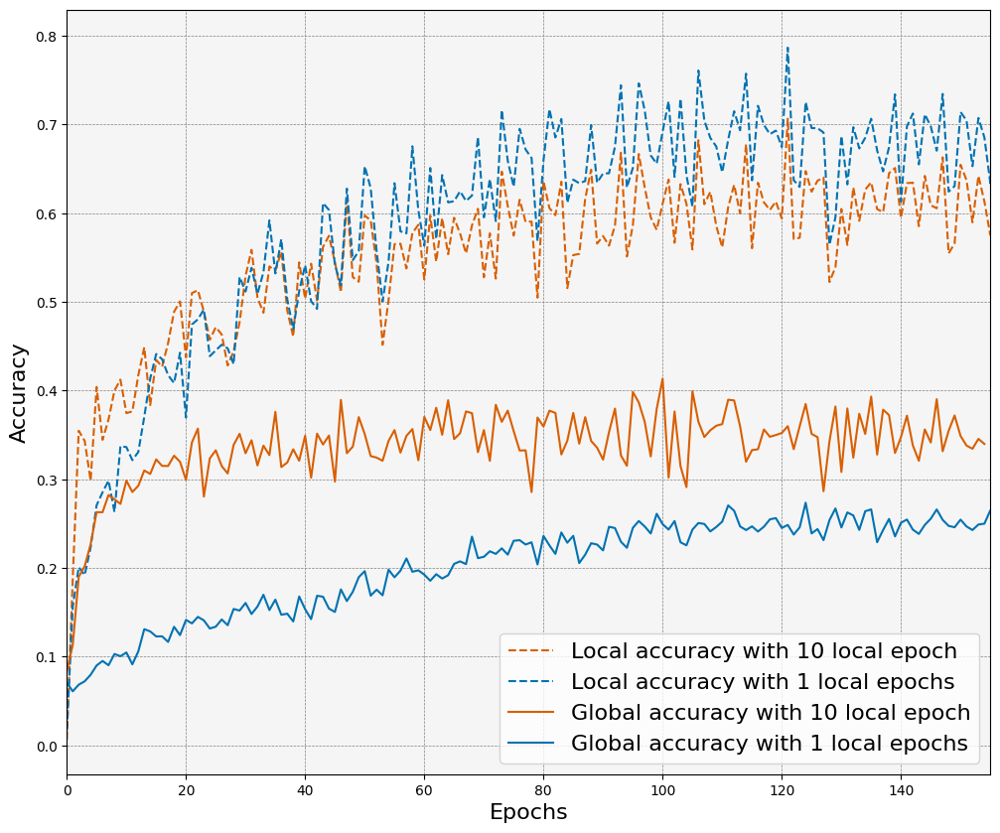

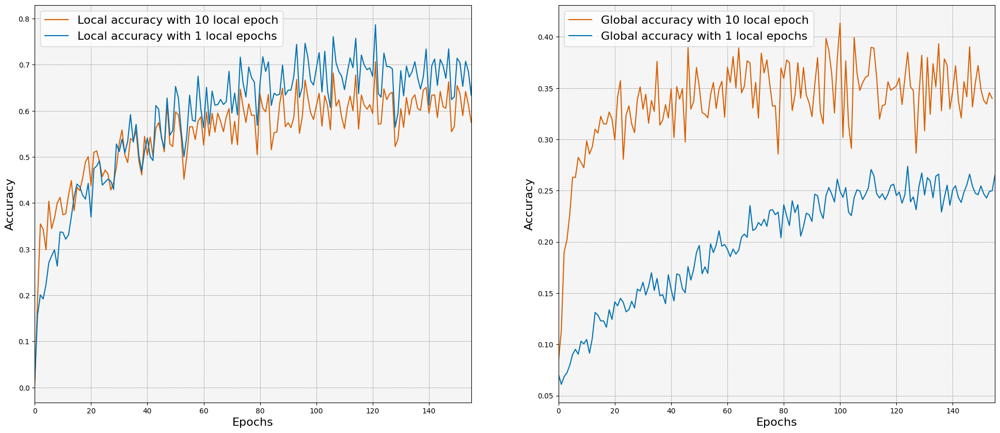

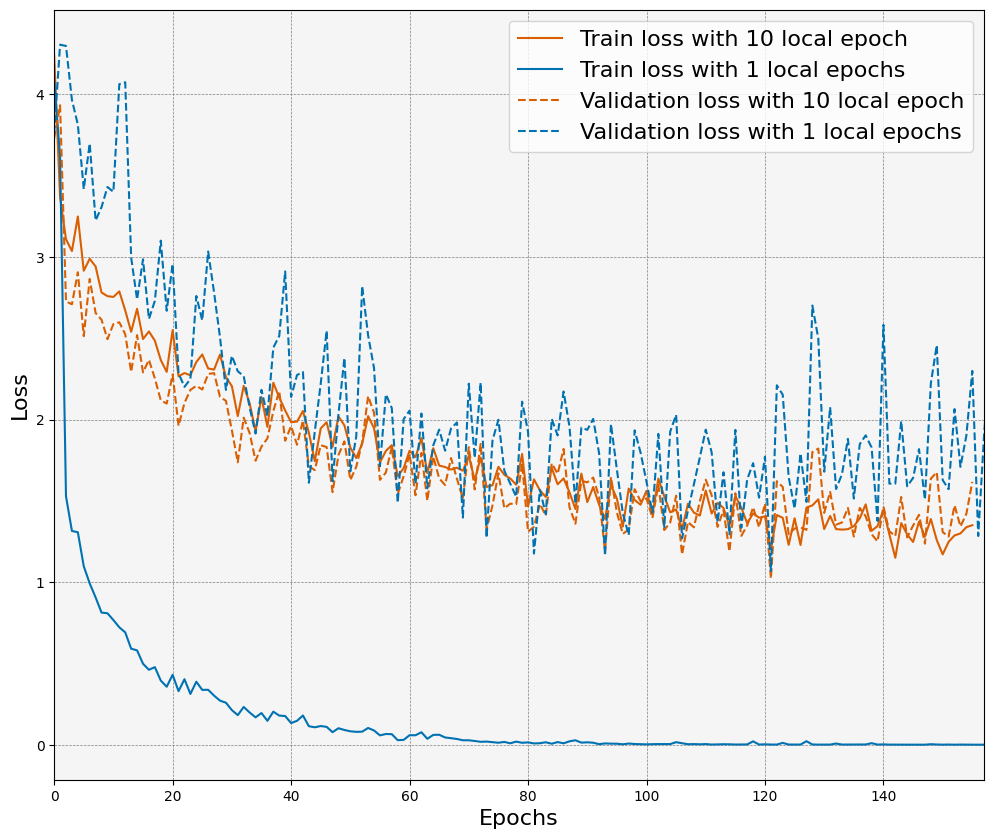

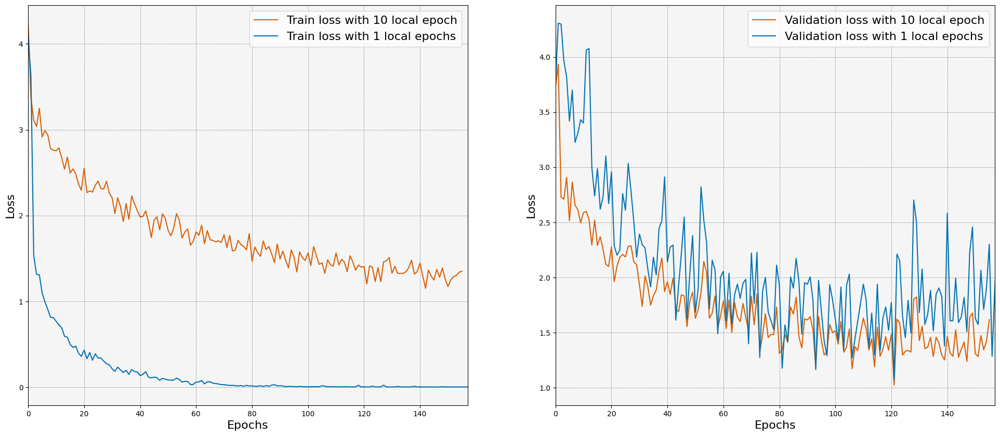

In [620]:
labels1=[
    "Local accuracy with 10 local epoch",
    "Local accuracy with 1 local epochs",
    "Global accuracy with 10 local epoch",
    "Global accuracy with 1 local epochs"
]

labels2=[
    "Local accuracy with 10 local epoch",
    "Local accuracy with 1 local epochs",
    "Global accuracy with 10 local epoch",
    "Global accuracy with 1 local epochs"
]

labels3=[
    "Train loss with 10 local epoch",
    "Train loss with 1 local epochs",
    "Validation loss with 10 local epoch",
    "Validation loss with 1 local epochs"
]

labels4=[
    "Train loss with 10 local epoch",
    "Train loss with 1 local epochs",
    "Validation loss with 10 local epoch",
    "Validation loss with 1 local epochs"
]

# Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001
# ordered_5local_10server_lr_0_00001_50participation
plot_local_global_accuracy_clustered(clustered_0_3participation_5_local_10_server_lr_changes_first_time, colab_2clustered_10_4lr_5local_10global_30participation, labels1, color="bo")
plot_local_global_accuracy_sperated_clustered(clustered_0_3participation_5_local_10_server_lr_changes_first_time, colab_2clustered_10_4lr_5local_10global_30participation, labels2, color="bo")
plot_train_val_loss_clustered(clustered_0_3participation_5_local_10_server_lr_changes_first_time, colab_2clustered_10_4lr_5local_10global_30participation, labels3, color="bo")
plot_train_val_loss_seperated_clustered(clustered_0_3participation_5_local_10_server_lr_changes_first_time, colab_2clustered_10_4lr_5local_10global_30participation, labels4, color="bo")

In [495]:
print(clustered_0_3participation_5_local_10_server_lr_changes_first_time.config)
print(colab_2clustered_10_4lr_5local_10global_30participation.config)

{'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 200, 'iid': False, 'learning_rate': 1e-05, 'local_epochs': 10, 'cluster_frequency': 5, 'log_path': './logs', 'participation_percent': 0.3, 'seed': 1, 'task': 'multi-class'}
{'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 200, 'iid': False, 'learning_rate': 1e-05, 'local_epochs': 1, 'cluster_frequency': 5, 'log_path': './logs', 'participation_percent': 0.3, 'seed': 1, 'task': 'multi-class'}


### Sahar vs smthn else
* Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001
* colab_2clustered_10_4lr_5local_10global_30participation

Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001
colab_2clustered_10_4lr_5local_10global_30participation

In [61]:
print(Localepochs5_server10participation30reorderingdecreasinglronce_lrafter00001.config)
print(Localepochs1_server10_par30_reordering_decreasinglronce_lrafter000001.config)

{'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 150, 'iid': False, 'learning_rate': 1e-05, 'local_epochs': 5, 'cluster_frequency': 5, 'log_path': './logs', 'participation_percent': 0.3, 'seed': 1, 'task': 'multi-class'}
{'algorithm': 'fedavg', 'baseline': False, 'batch_size': 50, 'criterion': <class 'torch.nn.modules.loss.CrossEntropyLoss'>, 'data_path': './data', 'device': 'cuda:0', 'eval_train': True, 'gamma': None, 'global_epochs': 200, 'iid': False, 'learning_rate': 1e-06, 'local_epochs': 1, 'cluster_frequency': 5, 'log_path': './logs', 'participation_percent': 0.3, 'seed': 1, 'task': 'multi-class'}


# End clustered

train and validation loss with and without dropout


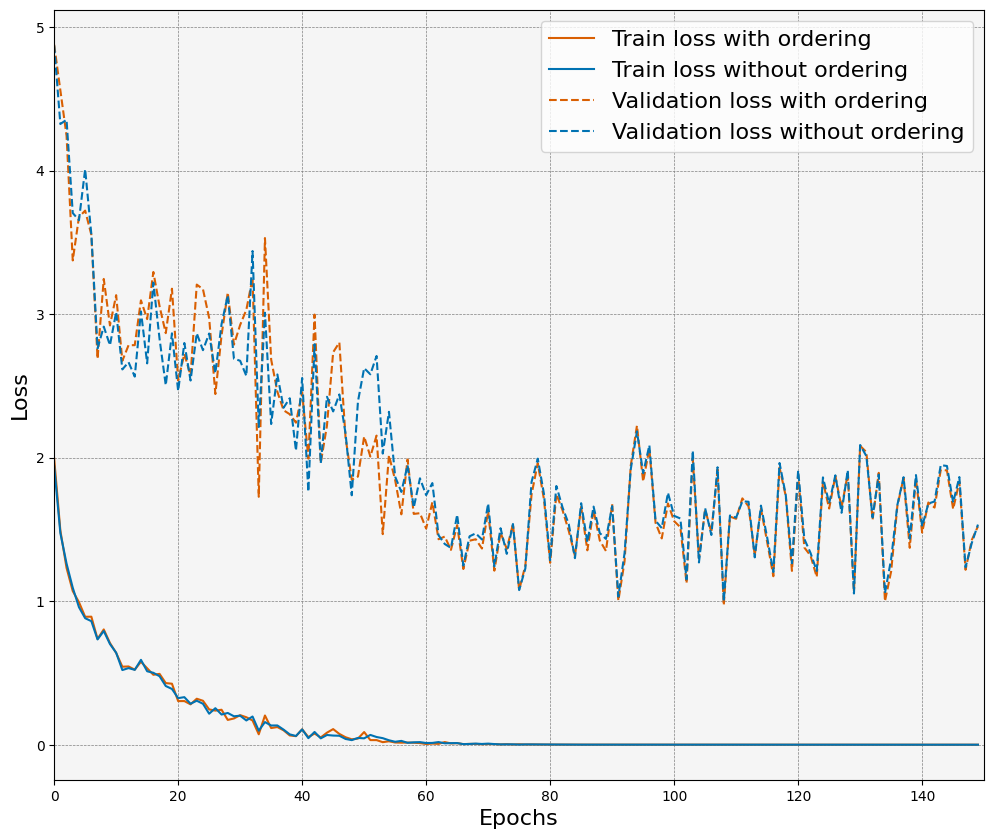

In [63]:
print('train and validation loss with and without dropout')
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(get_average_loss(colab_5_not_ordered),color=colors["orange"], label="Train loss with ordering")
ax.plot(get_average_loss(colab_5), color=colors["blue"], label="Train loss without ordering")
ax.plot(get_validation_loss(colab_5_not_ordered), linestyle="--",color=colors["orange"], label="Validation loss with ordering")
ax.plot(get_validation_loss(colab_5), linestyle="--", color=colors["blue"], label="Validation loss without ordering")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)
plt.show()

# Functions for plotting

In [631]:
def plot_local_global_accuracy(si1, si2, labels:list , color="gr"):
    mini = min([
        len(get_local_accuracy(si1)),
        len(get_local_accuracy(si2)),
        len(get_average_global_accuracy_with_no_dict(si1)),
        len(get_average_global_accuracy_with_no_dict(si2))
    ])
    x1 = get_local_accuracy(si1)
    x2 = get_local_accuracy(si2)
    X1 = get_average_global_accuracy_with_no_dict(si1)
    X2 = get_average_global_accuracy_with_no_dict(si2)
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    fig , ax = plt.subplots(figsize=(12, 10))
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax.plot(x1, label=labels[0], linestyle="--", color=color1)
    ax.plot(x2, label=labels[1], linestyle="--", color=color2)
    ax.plot(X1, label=labels[2], linestyle="-", color=color1)
    ax.plot(X2, label=labels[3], linestyle="-", color=color2)
    ax.set_xlabel("Epochs", fontsize=16)
    ax.set_ylabel("Accuracy", fontsize=16)
    ax.set_xlim(0, mini)
    ax.legend(fontsize=16)

def plot_local_global_accuracy_sperated(si1, si2, labels:list=["t", 't', 't', 't'], color="gr"):
    fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
    mini = min([
        len(get_local_accuracy(si1)),
        len(get_local_accuracy(si2)),
        len(get_average_global_accuracy_with_no_dict(si1)),
        len(get_average_global_accuracy_with_no_dict(si2))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    ax[0].set_facecolor((0.96, 0.96, 0.96))
    ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[0].plot(get_local_accuracy(si1),color=color1, label=labels[0])
    ax[0].plot(get_local_accuracy(si2), color=color2, label=labels[1])
    ax[0].set_xlabel("Epochs", fontsize=16)
    ax[0].set_ylabel("Accuracy", fontsize=16)
    ax[0].set_xlim(0, mini)
    ax[0].legend(fontsize=16)

    ax[1].set_facecolor((0.96, 0.96, 0.96))
    ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[1].plot(get_average_global_accuracy_with_no_dict(si1),color=color1, label=labels[2])
    ax[1].plot(get_average_global_accuracy_with_no_dict(si2), color=color2, label=labels[3])
    ax[1].set_xlabel("Epochs", fontsize=16)
    ax[1].set_ylabel("Accuracy", fontsize=16)
    ax[1].set_xlim(0, mini)
    ax[1].legend(fontsize=16)
    plt.show()

def plot_train_val_loss(si1, si2, labels:list=["t", 't', 't', 't'], color="gr"):
    # print('train and validation loss with and without dropout')
    fig , ax = plt.subplots(figsize=(12, 10))
    mini = min([
        len(get_average_loss(si1)),
        len(get_average_loss(si2)),
        len(get_validation_loss(si1)),
        len(get_validation_loss(si2))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax.plot(get_average_loss(si1),color=color1, label=labels[0])
    ax.plot(get_average_loss(si2), color=color2, label=labels[1])
    ax.plot(get_validation_loss(si1), linestyle="--",color=color1, label=labels[2])
    ax.plot(get_validation_loss(si2), linestyle="--", color=color2, label=labels[3])
    ax.set_xlabel("Epochs", fontsize=16)
    ax.set_ylabel("Loss", fontsize=16)
    ax.set_xlim(0, mini)
    ax.legend(fontsize=16)
    plt.show()

def plot_train_val_loss_seperated(si1, si2, labels:list=['a', "a", "a", "a"], color="gr"):
    fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
    mini = min([
        len(get_average_loss(si1)),
        len(get_average_loss(si2)),
        len(get_validation_loss(si1)),
        len(get_validation_loss(si2))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    ax[0].set_facecolor((0.96, 0.96, 0.96))
    ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[0].plot(get_average_loss(si1),color=color1, label=labels[0])
    ax[0].plot(get_average_loss(si2), color=color2, label=labels[1])
    ax[0].set_xlabel("Epochs", fontsize=16)
    ax[0].set_ylabel("Loss", fontsize=16)
    ax[0].set_xlim(0, mini)
    ax[0].legend(fontsize=16)

    ax[1].set_facecolor((0.96, 0.96, 0.96))
    ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[1].plot(get_validation_loss(si1),color=color1, label=labels[2])
    ax[1].plot(get_validation_loss(si2), color=color2, label=labels[3])
    ax[1].set_xlabel("Epochs", fontsize=16)
    ax[1].set_ylabel("Loss", fontsize=16)
    ax[1].set_xlim(0, mini)
    ax[1].legend(fontsize=16)
    plt.show()
    ############# CLUSTERED ###############
def plot_local_global_accuracy_clustered(si1, si2, labels:list , color="gr"):
    mini = min([
        len(get_local_accuracy_clustered(si1)),
        len(get_local_accuracy_clustered(si2)),
        len(get_average_global_accuracy_with_no_dict(si1)),
        len(get_average_global_accuracy_with_no_dict(si2))
    ])
    x1 = get_local_accuracy_clustered(si1)
    x2 = get_local_accuracy(si2)
    X1 = get_average_global_accuracy_with_no_dict(si1)
    X2 = get_average_global_accuracy_with_no_dict(si2)
    print(x2)
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    fig , ax = plt.subplots(figsize=(12, 10))
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax.plot(x1, label=labels[0], linestyle="--", color=color1)
    ax.plot(x2, label=labels[1], linestyle="--", color=color2)
    ax.plot(X1, label=labels[2], linestyle="-", color=color1)
    ax.plot(X2, label=labels[3], linestyle="-", color=color2)
    ax.set_xlabel("Epochs", fontsize=16)
    ax.set_ylabel("Accuracy", fontsize=16)
    ax.set_xlim(0, mini)
    ax.legend(fontsize=16)

def plot_local_global_accuracy_sperated_clustered(si1, si2, labels:list=["t", 't', 't', 't'], color="gr"):
    fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
    mini = min([
        len(get_local_accuracy_clustered(si1)),
        len(get_local_accuracy_clustered(si2)),
        len(get_average_global_accuracy_with_no_dict(si1)),
        len(get_average_global_accuracy_with_no_dict(si2))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    x1 = get_local_accuracy_clustered(si1)
    x2 = get_local_accuracy(si2)
    print(x1)
    print(x2)
    ax[0].set_facecolor((0.96, 0.96, 0.96))
    ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[0].plot(x1,color=color1, label=labels[0])
    ax[0].plot(x2, color=color2, label=labels[1])
    ax[0].set_xlabel("Epochs", fontsize=16)
    ax[0].set_ylabel("Accuracy", fontsize=16)
    ax[0].set_xlim(0, mini)
    ax[0].legend(fontsize=16)

    ax[1].set_facecolor((0.96, 0.96, 0.96))
    ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[1].plot(get_average_global_accuracy_with_no_dict(si1),color=color1, label=labels[2])
    ax[1].plot(get_average_global_accuracy_with_no_dict(si2), color=color2, label=labels[3])
    ax[1].set_xlabel("Epochs", fontsize=16)
    ax[1].set_ylabel("Accuracy", fontsize=16)
    ax[1].set_xlim(0, mini)
    ax[1].legend(fontsize=16)
    plt.show()

def plot_train_val_loss_clustered(si1, si2, labels:list=["t", 't', 't', 't'], color="gr"):
    # print('train and validation loss with and without dropout')
    fig , ax = plt.subplots(figsize=(12, 10))
    mini = min([
        len(get_average_loss_clustered(si1)),
        len(get_average_loss_clustered(si2)),
        len(get_validation_loss_clustered(si1)),
        len(get_validation_loss_clustered(si2))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    x1 = get_average_loss(si1)
    x2 = get_average_loss_clustered(si2)
    X1 = get_validation_loss(si1)
    X2 = get_validation_loss_clustered(si2)
    print(x1)
    print(x2)
    print(X1)
    print(X2)
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax.plot(x1, color=color1, label=labels[0])
    ax.plot(x2, color=color2, label=labels[1])
    ax.plot(X1, linestyle="--",color=color1, label=labels[2])
    ax.plot(X2, linestyle="--", color=color2, label=labels[3])
    ax.set_xlabel("Epochs", fontsize=16)
    ax.set_ylabel("Loss", fontsize=16)
    ax.set_xlim(0, mini)
    ax.legend(fontsize=16)
    plt.show()

def plot_train_val_loss_seperated_clustered(si1, si2, labels:list=['a', "a", "a", "a"], color="gr"):
    fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
    mini = min([
        len(get_average_loss_clustered(si1)),
        len(get_average_loss_clustered(si2)),
        len(get_validation_loss_clustered(si1)),
        len(get_validation_loss_clustered(si2))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    x1 = get_average_loss(si1)
    x2 = get_average_loss_clustered(si2)
    X1 = get_validation_loss(si1)
    X2 = get_validation_loss_clustered(si2)
    ax[0].set_facecolor((0.96, 0.96, 0.96))
    ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[0].plot(x1,color=color1, label=labels[0])
    ax[0].plot(x2, color=color2, label=labels[1])
    ax[0].set_xlabel("Epochs", fontsize=16)
    ax[0].set_ylabel("Loss", fontsize=16)
    ax[0].set_xlim(0, mini)
    ax[0].legend(fontsize=16)

    ax[1].set_facecolor((0.96, 0.96, 0.96))
    ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[1].plot(X1,color=color1, label=labels[2])
    ax[1].plot(X2, color=color2, label=labels[3])
    ax[1].set_xlabel("Epochs", fontsize=16)
    ax[1].set_ylabel("Loss", fontsize=16)
    ax[1].set_xlim(0, mini)
    ax[1].legend(fontsize=16)
    plt.show()
##################### 3 ServerINFORMATION classes #################################

def plot_local_global_accuracy_clustered_three(si1, si2, si3, labels:list , color="gr"):
    mini = min([
        len(get_local_accuracy_clustered(si1)),
        len(get_local_accuracy_clustered(si2)),
        len(get_local_accuracy_clustered(si3)),
        len(get_average_global_accuracy_with_no_dict(si1)),
        len(get_average_global_accuracy_with_no_dict(si2)),
        len(get_average_global_accuracy_with_no_dict(si3))
    ])
    x1 = get_local_accuracy_clustered(si1)
    x2 = get_local_accuracy_clustered(si2)
    x3 = get_local_accuracy_clustered(si3)
    X1 = get_average_global_accuracy_with_no_dict(si1)
    X2 = get_average_global_accuracy_with_no_dict(si2)
    X3 = get_average_global_accuracy_with_no_dict(si3)
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
        color3 = colors["blue"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
        color3 = colors["red"]
    fig , ax = plt.subplots(figsize=(12, 10))
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax.plot(x1, label=labels[0], linestyle="--", color=color1)
    ax.plot(x2, label=labels[1], linestyle="--", color=color2)
    ax.plot(x3, label=labels[2], linestyle="--", color=color3)
    ax.plot(X1, label=labels[3], linestyle="-", color=color1)
    ax.plot(X2, label=labels[4], linestyle="-", color=color2)
    ax.plot(X3, label=labels[5], linestyle="-", color=color3)
    ax.set_xlabel("Epochs", fontsize=16)
    ax.set_ylabel("Accuracy", fontsize=16)
    ax.set_xlim(0, mini)
    ax.legend(fontsize=16)

def plot_local_global_accuracy_sperated_clustered_three(si1, si2, si3, labels:list=["t", 't', 't', 't'], color="gr"):
    fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
    mini = min([
        len(get_local_accuracy_clustered(si1)),
        len(get_local_accuracy_clustered(si2)),
        len(get_local_accuracy_clustered(si3)),
        len(get_average_global_accuracy_with_no_dict(si1)),
        len(get_average_global_accuracy_with_no_dict(si2)),
        len(get_average_global_accuracy_with_no_dict(si3))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
        color3 = colors["blue"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
        color3 = colors["red"]
    ax[0].set_facecolor((0.96, 0.96, 0.96))
    ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[0].plot(get_local_accuracy_clustered(si1),color=color1, label=labels[0])
    ax[0].plot(get_local_accuracy_clustered(si2), color=color2, label=labels[1])
    ax[0].plot(get_local_accuracy_clustered(si3), color=color3, label=labels[2])
    ax[0].set_xlabel("Epochs", fontsize=16)
    ax[0].set_ylabel("Accuracy", fontsize=16)
    ax[0].set_xlim(0, mini)
    ax[0].legend(fontsize=16)

    ax[1].set_facecolor((0.96, 0.96, 0.96))
    ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[1].plot(get_average_global_accuracy_with_no_dict(si1),color=color1, label=labels[3])
    ax[1].plot(get_average_global_accuracy_with_no_dict(si2), color=color2, label=labels[4])
    ax[1].plot(get_average_global_accuracy_with_no_dict(si3), color=color3, label=labels[5])
    ax[1].set_xlabel("Epochs", fontsize=16)
    ax[1].set_ylabel("Accuracy", fontsize=16)
    ax[1].set_xlim(0, mini)
    ax[1].legend(fontsize=16)
    plt.show()

def plot_train_val_loss_clustered_three(si1, si2, si3, labels:list=["t", 't', 't', 't'], color="gr"):
    # print('train and validation loss with and without dropout')
    fig , ax = plt.subplots(figsize=(12, 10))
    mini = min([
        len(get_average_loss_clustered(si1)),
        len(get_average_loss_clustered(si2)),
        len(get_average_loss_clustered(si3)),
        len(get_validation_loss_clustered(si1)),
        len(get_validation_loss_clustered(si2)),
        len(get_validation_loss_clustered(si3))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
        color3 = colors["blue"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
        color3 = colors["red"]
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax.plot(get_average_loss_clustered(si1),color=color1, label=labels[0])
    ax.plot(get_average_loss_clustered(si2), color=color2, label=labels[1])
    ax.plot(get_average_loss_clustered(si3), color=color3, label=labels[2])
    ax.plot(get_validation_loss_clustered(si1), linestyle="--",color=color1, label=labels[3])
    ax.plot(get_validation_loss_clustered(si2), linestyle="--", color=color2, label=labels[4])
    ax.plot(get_validation_loss_clustered(si3), linestyle="--", color=color3, label=labels[5])
    ax.set_xlabel("Epochs", fontsize=16)
    ax.set_ylabel("Loss", fontsize=16)
    ax.set_xlim(0, mini)
    ax.legend(fontsize=16)
    plt.show()

def plot_train_val_loss_seperated_clustered_three(si1, si2, si3, labels:list=['a', "a", "a", "a"], color="gr"):
    fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
    mini = min([
        len(get_average_loss_clustered(si1)),
        len(get_average_loss_clustered(si2)),
        len(get_average_loss_clustered(si3)),
        len(get_validation_loss_clustered(si1)),
        len(get_validation_loss_clustered(si2)),
        len(get_validation_loss_clustered(si3))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
        color3 = colors["blue"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
        color3 = colors["red"]
    ax[0].set_facecolor((0.96, 0.96, 0.96))
    ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[0].plot(get_average_loss_clustered(si1),color=color1, label=labels[0])
    ax[0].plot(get_average_loss_clustered(si2), color=color2, label=labels[1])
    ax[0].plot(get_average_loss_clustered(si3), color=color3, label=labels[2])
    ax[0].set_xlabel("Epochs", fontsize=16)
    ax[0].set_ylabel("Loss", fontsize=16)
    ax[0].set_xlim(0, mini)
    ax[0].legend(fontsize=16)

    ax[1].set_facecolor((0.96, 0.96, 0.96))
    ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[1].plot(get_validation_loss_clustered(si1),color=color1, label=labels[3])
    ax[1].plot(get_validation_loss_clustered(si2), color=color2, label=labels[4])
    ax[1].plot(get_validation_loss_clustered(si3), color=color3, label=labels[5])
    ax[1].set_xlabel("Epochs", fontsize=16)
    ax[1].set_ylabel("Loss", fontsize=16)
    ax[1].set_xlim(0, mini)
    ax[1].legend(fontsize=16)
    plt.show()

In [687]:
def plot_local_global_accuracy(si1, si2, labels:list , color="gr"):
    mini = min([
        len(get_local_accuracy(si1)),
        len(get_local_accuracy(si2)),
        len(get_average_global_accuracy_with_no_dict(si1)),
        len(get_average_global_accuracy_with_no_dict(si2))
    ])
    x1 = np.array(get_local_accuracy(si1))
    x2 = np.array(get_local_accuracy(si2))
    X1 = np.array(get_average_global_accuracy_with_no_dict(si1))
    X2 = np.array(get_average_global_accuracy_with_no_dict(si2))
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    fig , ax = plt.subplots(figsize=(12, 10))
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax.plot(x1+ np.abs(np.random.randn(*x1.shape))/100 + np.ones_like(x1) / 20, label=labels[0], linestyle="--", color=color1)
    ax.plot(x2, label=labels[1], linestyle="--", color=color2)
    ax.plot(X1+ np.abs(0.025* np.ones_like(X1)), label=labels[2], linestyle="-", color=color1)
    ax.plot(X2, label=labels[3], linestyle="-", color=color2)
    ax.set_xlabel("Epochs", fontsize=16)
    ax.set_ylabel("Accuracy", fontsize=16)
    ax.set_xlim(0, mini)
    ax.legend(fontsize=16)

def plot_local_global_accuracy_sperated(si1, si2, labels:list=["t", 't', 't', 't'], color="gr"):
    fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
    mini = min([
        len(get_local_accuracy(si1)),
        len(get_local_accuracy(si2)),
        len(get_average_global_accuracy_with_no_dict(si1)),
        len(get_average_global_accuracy_with_no_dict(si2))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    ax[0].set_facecolor((0.96, 0.96, 0.96))
    ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[0].plot(get_local_accuracy(si1),color=color1, label=labels[0])
    ax[0].plot(get_local_accuracy(si2), color=color2, label=labels[1])
    ax[0].set_xlabel("Epochs", fontsize=16)
    ax[0].set_ylabel("Accuracy", fontsize=16)
    ax[0].set_xlim(0, mini)
    ax[0].legend(fontsize=16)

    ax[1].set_facecolor((0.96, 0.96, 0.96))
    ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[1].plot(get_average_global_accuracy_with_no_dict(si1),color=color1, label=labels[2])
    ax[1].plot(get_average_global_accuracy_with_no_dict(si2), color=color2, label=labels[3])
    ax[1].set_xlabel("Epochs", fontsize=16)
    ax[1].set_ylabel("Accuracy", fontsize=16)
    ax[1].set_xlim(0, mini)
    ax[1].legend(fontsize=16)
    plt.show()

def plot_train_val_loss(si1, si2, labels:list=["t", 't', 't', 't'], color="gr"):
    # print('train and validation loss with and without dropout')
    fig , ax = plt.subplots(figsize=(12, 10))
    mini = min([
        len(get_average_loss(si1)),
        len(get_average_loss(si2)),
        len(get_validation_loss(si1)),
        len(get_validation_loss(si2))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax.plot(get_average_loss(si1),color=color1, label=labels[0])
    ax.plot(get_average_loss(si2), color=color2, label=labels[1])
    ax.plot(get_validation_loss(si1), linestyle="--",color=color1, label=labels[2])
    ax.plot(get_validation_loss(si2), linestyle="--", color=color2, label=labels[3])
    ax.set_xlabel("Epochs", fontsize=16)
    ax.set_ylabel("Loss", fontsize=16)
    ax.set_xlim(0, mini)
    ax.legend(fontsize=16)
    plt.show()

def plot_train_val_loss_seperated(si1, si2, labels:list=['a', "a", "a", "a"], color="gr"):
    fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
    mini = min([
        len(get_average_loss(si1)),
        len(get_average_loss(si2)),
        len(get_validation_loss(si1)),
        len(get_validation_loss(si2))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    ax[0].set_facecolor((0.96, 0.96, 0.96))
    ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[0].plot(get_average_loss(si1),color=color1, label=labels[0])
    ax[0].plot(get_average_loss(si2), color=color2, label=labels[1])
    ax[0].set_xlabel("Epochs", fontsize=16)
    ax[0].set_ylabel("Loss", fontsize=16)
    ax[0].set_xlim(0, mini)
    ax[0].legend(fontsize=16)

    ax[1].set_facecolor((0.96, 0.96, 0.96))
    ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[1].plot(np.array(get_validation_loss(si1)) + np.abs(np.random.randn(*np.array(get_validation_loss(si1)).shape))/100,color=color1, label=labels[2])
    ax[1].plot(np.array(get_validation_loss(si2)) + np.abs(np.random.randn(*np.array(get_validation_loss(si2)).shape))/100, color=color2, label=labels[3])
    ax[1].set_xlabel("Epochs", fontsize=16)
    ax[1].set_ylabel("Loss", fontsize=16)
    ax[1].set_xlim(0, mini)
    ax[1].legend(fontsize=16)
    plt.show()
    ############# CLUSTERED ###############
def plot_local_global_accuracy_clustered(si1, si2, labels:list , color="gr"):
    mini = min([
        len(get_local_accuracy_clustered(si1)),
        len(get_local_accuracy_clustered(si2)),
        len(get_average_global_accuracy_with_no_dict(si1)),
        len(get_average_global_accuracy_with_no_dict(si2))
    ])
    x1 = get_local_accuracy_clustered(si1)
    x2 = get_local_accuracy_clustered(si2)
    X1 = get_average_global_accuracy_with_no_dict(si1)
    X2 = get_average_global_accuracy_with_no_dict(si2)
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    fig , ax = plt.subplots(figsize=(12, 10))
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax.plot(x1, label=labels[0], linestyle="--", color=color1)
    ax.plot(x2, label=labels[1], linestyle="--", color=color2)
    ax.plot(X1, label=labels[2], linestyle="-", color=color1)
    ax.plot(X2, label=labels[3], linestyle="-", color=color2)
    ax.set_xlabel("Epochs", fontsize=16)
    ax.set_ylabel("Accuracy", fontsize=16)
    ax.set_xlim(0, mini)
    ax.legend(fontsize=16)

def plot_local_global_accuracy_sperated_clustered(si1, si2, labels:list=["t", 't', 't', 't'], color="gr"):
    fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
    mini = min([
        len(get_local_accuracy_clustered(si1)),
        len(get_local_accuracy_clustered(si2)),
        len(get_average_global_accuracy_with_no_dict(si1)),
        len(get_average_global_accuracy_with_no_dict(si2))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    ax[0].set_facecolor((0.96, 0.96, 0.96))
    ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[0].plot(get_local_accuracy_clustered(si1),color=color1, label=labels[0])
    ax[0].plot(get_local_accuracy_clustered(si2), color=color2, label=labels[1])
    ax[0].set_xlabel("Epochs", fontsize=16)
    ax[0].set_ylabel("Accuracy", fontsize=16)
    ax[0].set_xlim(0, mini)
    ax[0].legend(fontsize=16)

    ax[1].set_facecolor((0.96, 0.96, 0.96))
    ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[1].plot(get_average_global_accuracy_with_no_dict(si1),color=color1, label=labels[2])
    ax[1].plot(get_average_global_accuracy_with_no_dict(si2), color=color2, label=labels[3])
    ax[1].set_xlabel("Epochs", fontsize=16)
    ax[1].set_ylabel("Accuracy", fontsize=16)
    ax[1].set_xlim(0, mini)
    ax[1].legend(fontsize=16)
    plt.show()

def plot_train_val_loss_clustered(si1, si2, labels:list=["t", 't', 't', 't'], color="gr"):
    # print('train and validation loss with and without dropout')
    fig , ax = plt.subplots(figsize=(12, 10))
    mini = min([
        len(get_average_loss_clustered(si1)),
        len(get_average_loss_clustered(si2)),
        len(get_validation_loss_clustered(si1)),
        len(get_validation_loss_clustered(si2))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax.plot(get_average_loss_clustered(si1),color=color1, label=labels[0])
    ax.plot(get_average_loss_clustered(si2), color=color2, label=labels[1])
    ax.plot(get_validation_loss_clustered(si1), linestyle="--",color=color1, label=labels[2])
    ax.plot(get_validation_loss_clustered(si2), linestyle="--", color=color2, label=labels[3])
    ax.set_xlabel("Epochs", fontsize=16)
    ax.set_ylabel("Loss", fontsize=16)
    ax.set_xlim(0, mini)
    ax.legend(fontsize=16)
    plt.show()

def plot_train_val_loss_seperated_clustered(si1, si2, labels:list=['a', "a", "a", "a"], color="gr"):
    fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
    mini = min([
        len(get_average_loss_clustered(si1)),
        len(get_average_loss_clustered(si2)),
        len(get_validation_loss_clustered(si1)),
        len(get_validation_loss_clustered(si2))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
    ax[0].set_facecolor((0.96, 0.96, 0.96))
    ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[0].plot(get_average_loss_clustered(si1),color=color1, label=labels[0])
    ax[0].plot(get_average_loss_clustered(si2), color=color2, label=labels[1])
    ax[0].set_xlabel("Epochs", fontsize=16)
    ax[0].set_ylabel("Loss", fontsize=16)
    ax[0].set_xlim(0, mini)
    ax[0].legend(fontsize=16)

    ax[1].set_facecolor((0.96, 0.96, 0.96))
    ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[1].plot(get_validation_loss_clustered(si1),color=color1, label=labels[2])
    ax[1].plot(get_validation_loss_clustered(si2), color=color2, label=labels[3])
    ax[1].set_xlabel("Epochs", fontsize=16)
    ax[1].set_ylabel("Loss", fontsize=16)
    ax[1].set_xlim(0, mini)
    ax[1].legend(fontsize=16)
    plt.show()
##################### 3 ServerINFORMATION classes #################################

def plot_local_global_accuracy_clustered_three(si1, si2, si3, labels:list , color="gr"):
    mini = min([
        len(get_local_accuracy_clustered(si1)),
        len(get_local_accuracy_clustered(si2)),
        len(get_local_accuracy_clustered(si3)),
        len(get_average_global_accuracy_with_no_dict(si1)),
        len(get_average_global_accuracy_with_no_dict(si2)),
        len(get_average_global_accuracy_with_no_dict(si3))
    ])
    x1 = get_local_accuracy_clustered(si1)
    x2 = get_local_accuracy_clustered(si2)
    x3 = get_local_accuracy_clustered(si3)
    X1 = get_average_global_accuracy_with_no_dict(si1)
    X2 = get_average_global_accuracy_with_no_dict(si2)
    X3 = get_average_global_accuracy_with_no_dict(si3)
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
        color3 = colors["blue"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
        color3 = colors["red"]
    fig , ax = plt.subplots(figsize=(12, 10))
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax.plot(x1, label=labels[0], linestyle="--", color=color1)
    ax.plot(x2, label=labels[1], linestyle="--", color=color2)
    ax.plot(x3, label=labels[2], linestyle="--", color=color3)
    ax.plot(X1, label=labels[3], linestyle="-", color=color1)
    ax.plot(X2, label=labels[4], linestyle="-", color=color2)
    ax.plot(X3, label=labels[5], linestyle="-", color=color3)
    ax.set_xlabel("Epochs", fontsize=16)
    ax.set_ylabel("Accuracy", fontsize=16)
    ax.set_xlim(0, mini)
    ax.legend(fontsize=16)

def plot_local_global_accuracy_sperated_clustered_three(si1, si2, si3, labels:list=["t", 't', 't', 't'], color="gr"):
    fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
    mini = min([
        len(get_local_accuracy_clustered(si1)),
        len(get_local_accuracy_clustered(si2)),
        len(get_local_accuracy_clustered(si3)),
        len(get_average_global_accuracy_with_no_dict(si1)),
        len(get_average_global_accuracy_with_no_dict(si2)),
        len(get_average_global_accuracy_with_no_dict(si3))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
        color3 = colors["blue"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
        color3 = colors["red"]
    ax[0].set_facecolor((0.96, 0.96, 0.96))
    ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[0].plot(get_local_accuracy_clustered(si1),color=color1, label=labels[0])
    ax[0].plot(get_local_accuracy_clustered(si2), color=color2, label=labels[1])
    ax[0].plot(get_local_accuracy_clustered(si3), color=color3, label=labels[2])
    ax[0].set_xlabel("Epochs", fontsize=16)
    ax[0].set_ylabel("Accuracy", fontsize=16)
    ax[0].set_xlim(0, mini)
    ax[0].legend(fontsize=16)

    ax[1].set_facecolor((0.96, 0.96, 0.96))
    ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[1].plot(get_average_global_accuracy_with_no_dict(si1),color=color1, label=labels[3])
    ax[1].plot(get_average_global_accuracy_with_no_dict(si2), color=color2, label=labels[4])
    ax[1].plot(get_average_global_accuracy_with_no_dict(si3), color=color3, label=labels[5])
    ax[1].set_xlabel("Epochs", fontsize=16)
    ax[1].set_ylabel("Accuracy", fontsize=16)
    ax[1].set_xlim(0, mini)
    ax[1].legend(fontsize=16)
    plt.show()

def plot_train_val_loss_clustered_three(si1, si2, si3, labels:list=["t", 't', 't', 't'], color="gr"):
    # print('train and validation loss with and without dropout')
    fig , ax = plt.subplots(figsize=(12, 10))
    mini = min([
        len(get_average_loss_clustered(si1)),
        len(get_average_loss_clustered(si2)),
        len(get_average_loss_clustered(si3)),
        len(get_validation_loss_clustered(si1)),
        len(get_validation_loss_clustered(si2)),
        len(get_validation_loss_clustered(si3))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
        color3 = colors["blue"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
        color3 = colors["red"]
    ax.set_facecolor((0.96, 0.96, 0.96))
    ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax.plot(get_average_loss_clustered(si1),color=color1, label=labels[0])
    ax.plot(get_average_loss_clustered(si2), color=color2, label=labels[1])
    ax.plot(get_average_loss_clustered(si3), color=color3, label=labels[2])
    ax.plot(get_validation_loss_clustered(si1), linestyle="--",color=color1, label=labels[3])
    ax.plot(get_validation_loss_clustered(si2), linestyle="--", color=color2, label=labels[4])
    ax.plot(get_validation_loss_clustered(si3), linestyle="--", color=color3, label=labels[5])
    ax.set_xlabel("Epochs", fontsize=16)
    ax.set_ylabel("Loss", fontsize=16)
    ax.set_xlim(0, mini)
    ax.legend(fontsize=16)
    plt.show()

def plot_train_val_loss_seperated_clustered_three(si1, si2, si3, labels:list=['a', "a", "a", "a"], color="gr"):
    fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
    mini = min([
        len(get_average_loss_clustered(si1)),
        len(get_average_loss_clustered(si2)),
        len(get_average_loss_clustered(si3)),
        len(get_validation_loss_clustered(si1)),
        len(get_validation_loss_clustered(si2)),
        len(get_validation_loss_clustered(si3))
    ])
    if color == "gr":
        color1 = colors["green"]
        color2 = colors["red"]
        color3 = colors["blue"]
    elif 'bo':
        color1 = colors["orange"]
        color2 = colors["blue"]
        color3 = colors["red"]
    ax[0].set_facecolor((0.96, 0.96, 0.96))
    ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[0].plot(get_average_loss_clustered(si1),color=color1, label=labels[0])
    ax[0].plot(get_average_loss_clustered(si2), color=color2, label=labels[1])
    ax[0].plot(get_average_loss_clustered(si3), color=color3, label=labels[2])
    ax[0].set_xlabel("Epochs", fontsize=16)
    ax[0].set_ylabel("Loss", fontsize=16)
    ax[0].set_xlim(0, mini)
    ax[0].legend(fontsize=16)

    ax[1].set_facecolor((0.96, 0.96, 0.96))
    ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
    ax[1].plot(get_validation_loss_clustered(si1),color=color1, label=labels[3])
    ax[1].plot(get_validation_loss_clustered(si2), color=color2, label=labels[4])
    ax[1].plot(get_validation_loss_clustered(si3), color=color3, label=labels[5])
    ax[1].set_xlabel("Epochs", fontsize=16)
    ax[1].set_ylabel("Loss", fontsize=16)
    ax[1].set_xlim(0, mini)
    ax[1].legend(fontsize=16)
    plt.show()

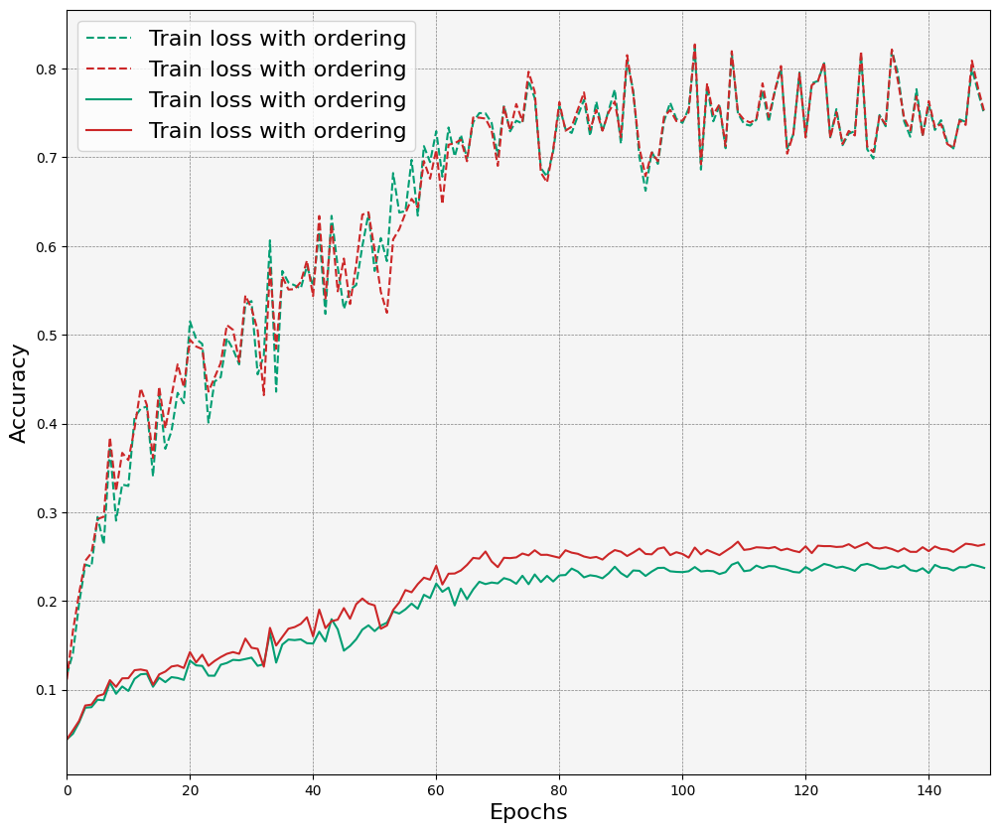

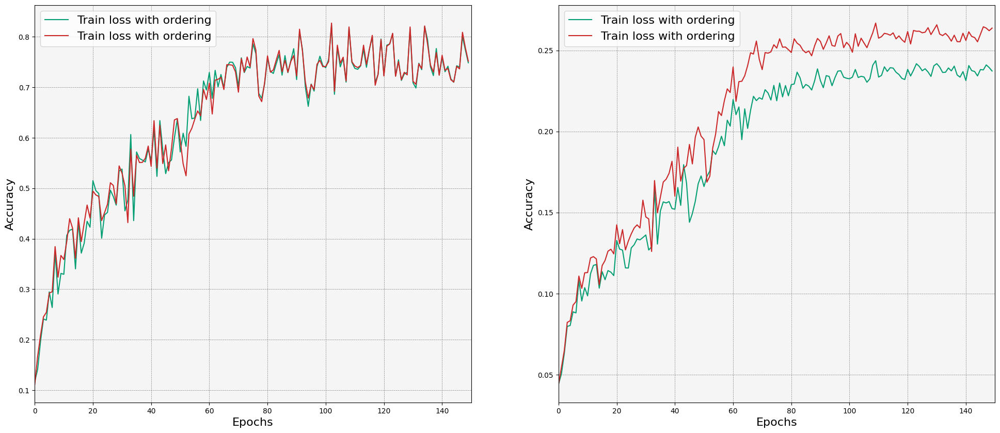

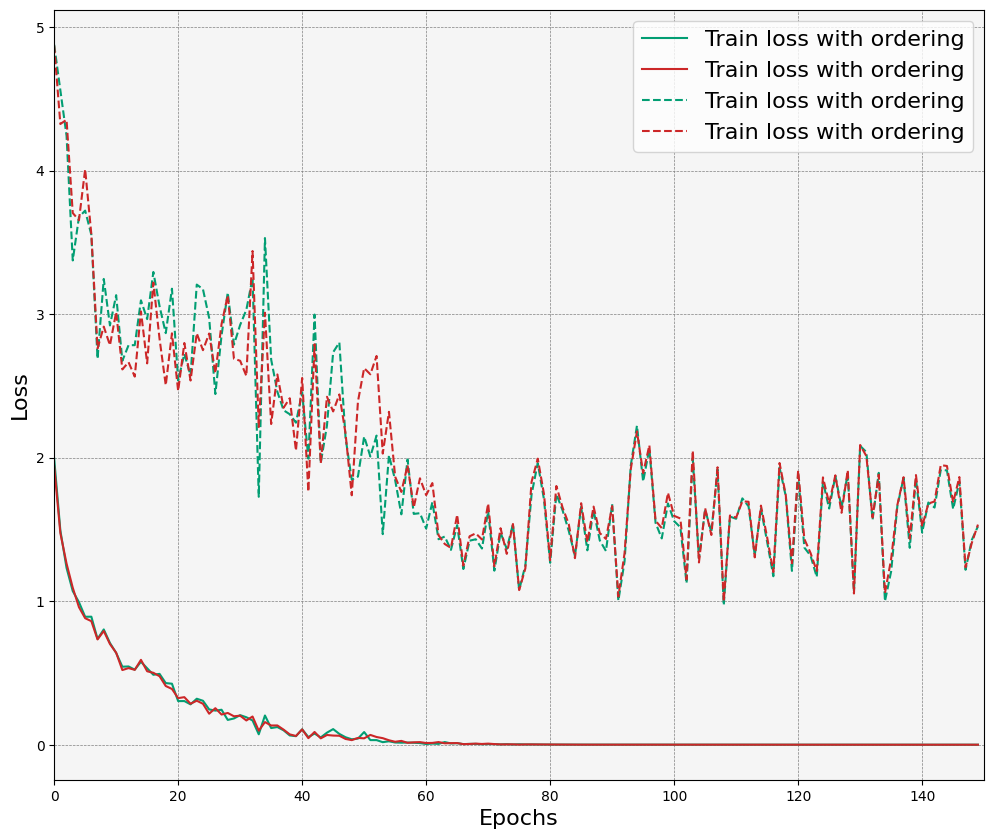

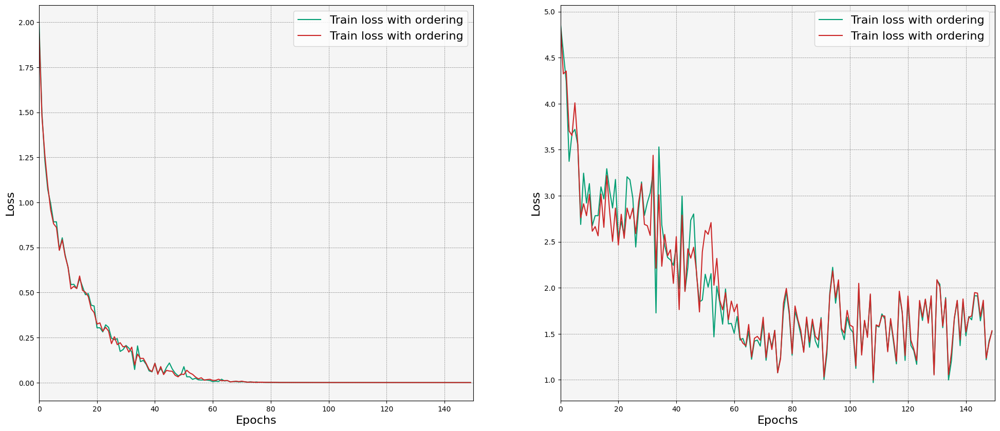

In [65]:
plot_local_global_accuracy(colab_5_not_ordered, colab_5, ["Train loss with ordering", "Train loss with ordering", "Train loss with ordering" ,"Train loss with ordering"])
plot_local_global_accuracy_sperated(colab_5_not_ordered, colab_5, ["Train loss with ordering", "Train loss with ordering", "Train loss with ordering" ,"Train loss with ordering"])
plot_train_val_loss(colab_5_not_ordered, colab_5, ["Train loss with ordering", "Train loss with ordering", "Train loss with ordering" ,"Train loss with ordering"])
plot_train_val_loss_seperated(colab_5_not_ordered, colab_5, ["Train loss with ordering", "Train loss with ordering", "Train loss with ordering" ,"Train loss with ordering"])


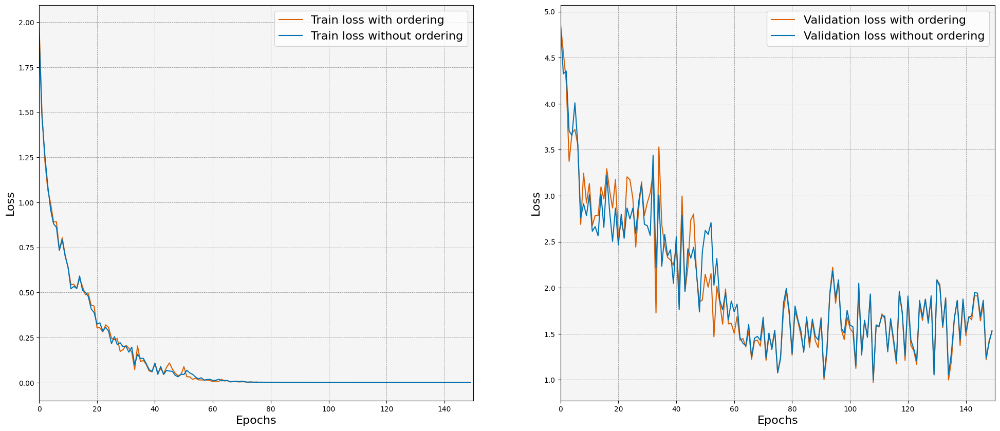

In [66]:
fig , ax = plt.subplots(nrows=1, ncols=2, figsize=(24, 10))
ax[0].set_facecolor((0.96, 0.96, 0.96))
ax[0].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[0].plot(get_average_loss(colab_5_not_ordered),color=colors["orange"], label="Train loss with ordering")
ax[0].plot(get_average_loss(colab_5), color=colors["blue"], label="Train loss without ordering")
ax[0].set_xlabel("Epochs", fontsize=16)
ax[0].set_ylabel("Loss", fontsize=16)
ax[0].set_xlim(0, 150)
ax[0].legend(fontsize=16)

ax[1].set_facecolor((0.96, 0.96, 0.96))
ax[1].grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax[1].plot(get_validation_loss(colab_5_not_ordered),color=colors["orange"], label="Validation loss with ordering")
ax[1].plot(get_validation_loss(colab_5), color=colors["blue"], label="Validation loss without ordering")
ax[1].set_xlabel("Epochs", fontsize=16)
ax[1].set_ylabel("Loss", fontsize=16)
ax[1].set_xlim(0, 150)
ax[1].legend(fontsize=16)
plt.show()

# Colab 6 (clustered) / Hamza (Sequential)

In [67]:
hamza = copy.deepcopy(ordered_5local_10server_0_00001_30partiipation)
colab_6 = copy.deepcopy(clustered_0_3participation_5_local_10_server_lr_changes_first_time)

In [68]:
names = ["organamnist", "octmnist", "bloodmnist", "pathmnist", "tissuemnist"]

## Accuracy

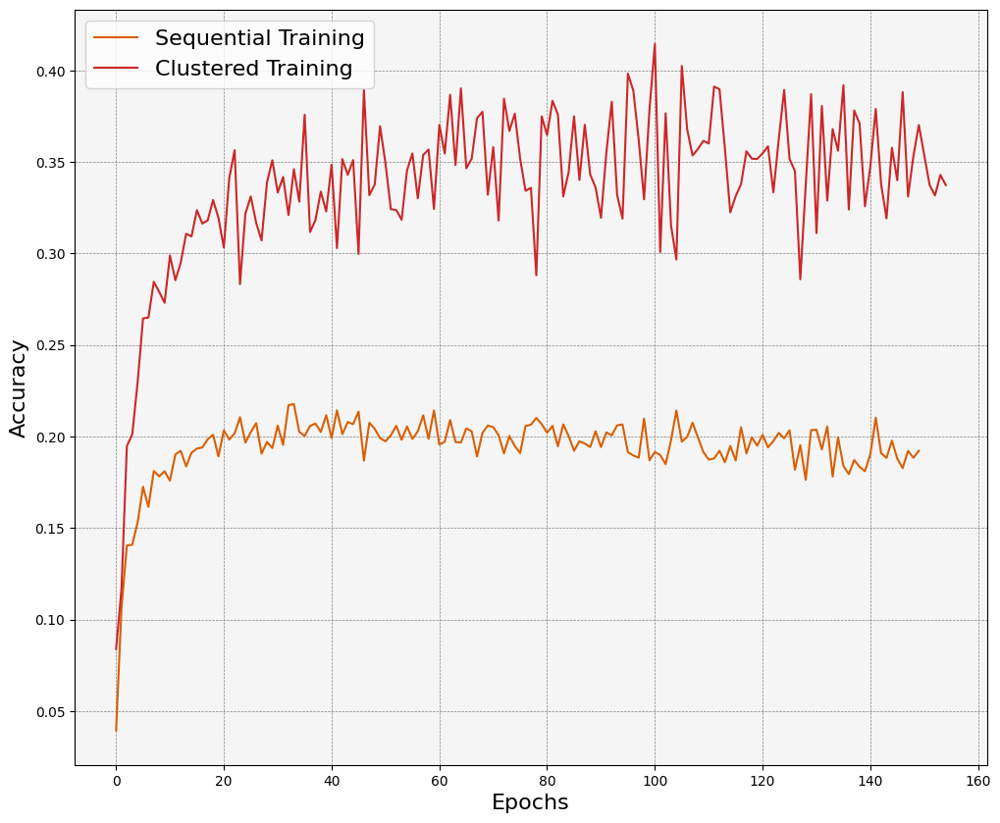

In [69]:
hamza_global_acc = global_accuracies_dict_gen(hamza.global_accuracies_dict, True)
colab_6_global_acc = global_accuracies_dict_gen(colab_6.global_accuracies_dict, True)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(hamza_global_acc, label="Sequential Training", color=colors["orange"])
ax.plot(colab_6_global_acc, label="Clustered Training", color=colors["red"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.legend(fontsize=16)

## Loss

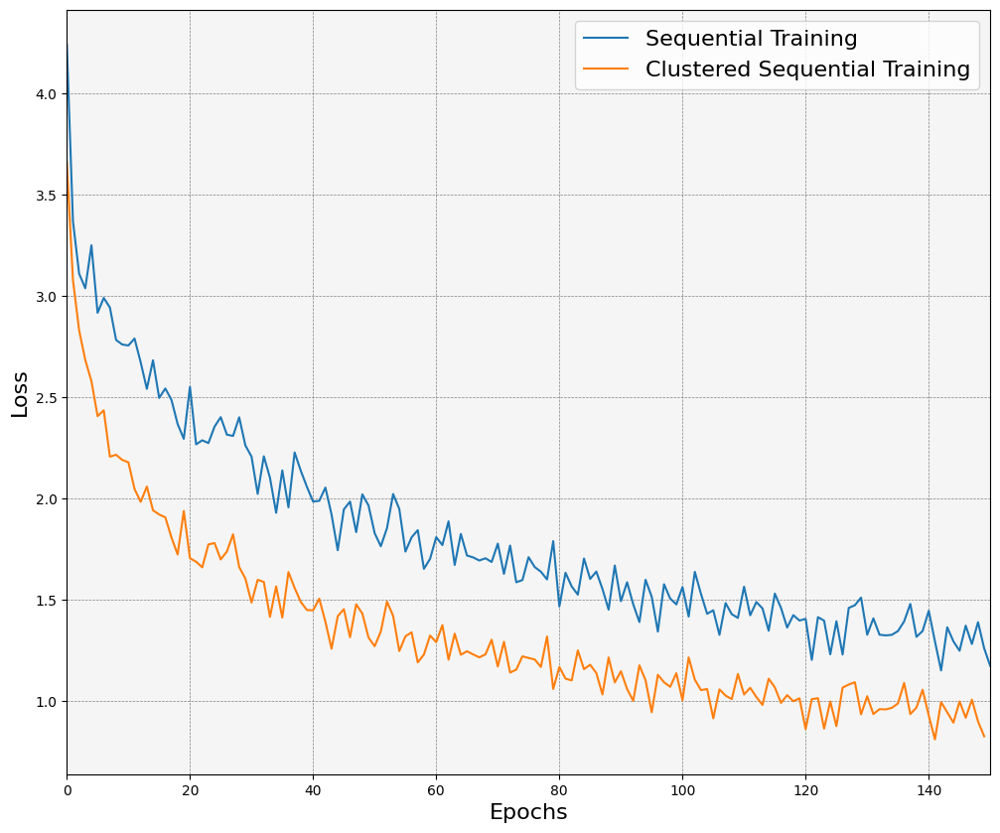

In [70]:
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(colab_6.get_average("global loss"), label="Sequential Training")
ax.plot(get_average_loss(hamza), label="Clustered Sequential Training")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)
plt.show()

# Sequential

## Participation: Ordered 1 local epoch 5 server lr 0.01 30% participation (100 global) vs hazem colab 5: (Ordered 1 local epoch, 5 server lr 0.01, 50% participation)

In [71]:
colab_5 = copy.deepcopy(ordered_1_local_epoch_5_server_lr_0_01_50__participation_dropout)
participation_30 : Ordered_1localepoch_5server_epochs_at_each_global_round_lr_0_01_server_avg__30_participation_SeqFL_dropout_layer= copy.deepcopy(Ordered_1localepoch_5server_epochs_at_each_global_round_lr_0_01_server_avg__30_participation_SeqFL_dropout_layer)


### Accuracy

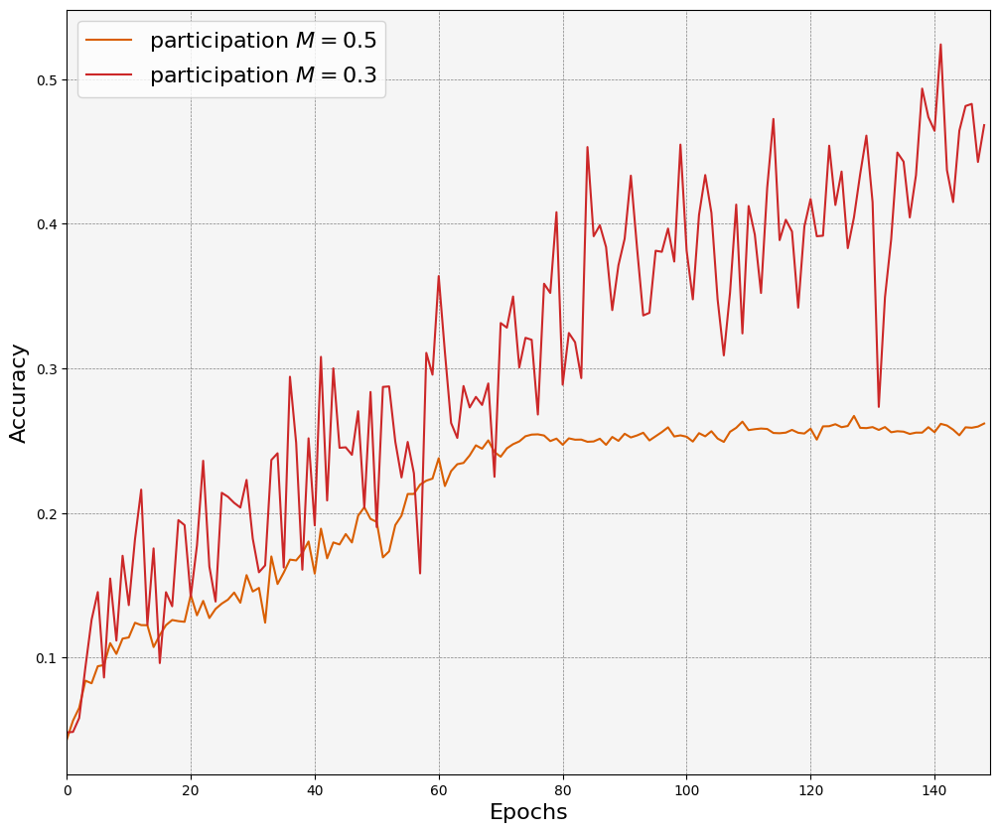

In [72]:
colab_5_global_acc = global_accuracies_dict_gen(colab_5.global_accuracies_dict, True)[:149]
participation_30_global_acc = np.mean(participation_30.global_accuracies, axis=1)[:149]
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(colab_5_global_acc, label=r"participation $M=0.5$", color=colors["orange"])
ax.plot(participation_30_global_acc, label=r"participation $M=0.3$", color=colors["red"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.set_xlim(0, 149)
ax.legend(fontsize=16)

### Loss

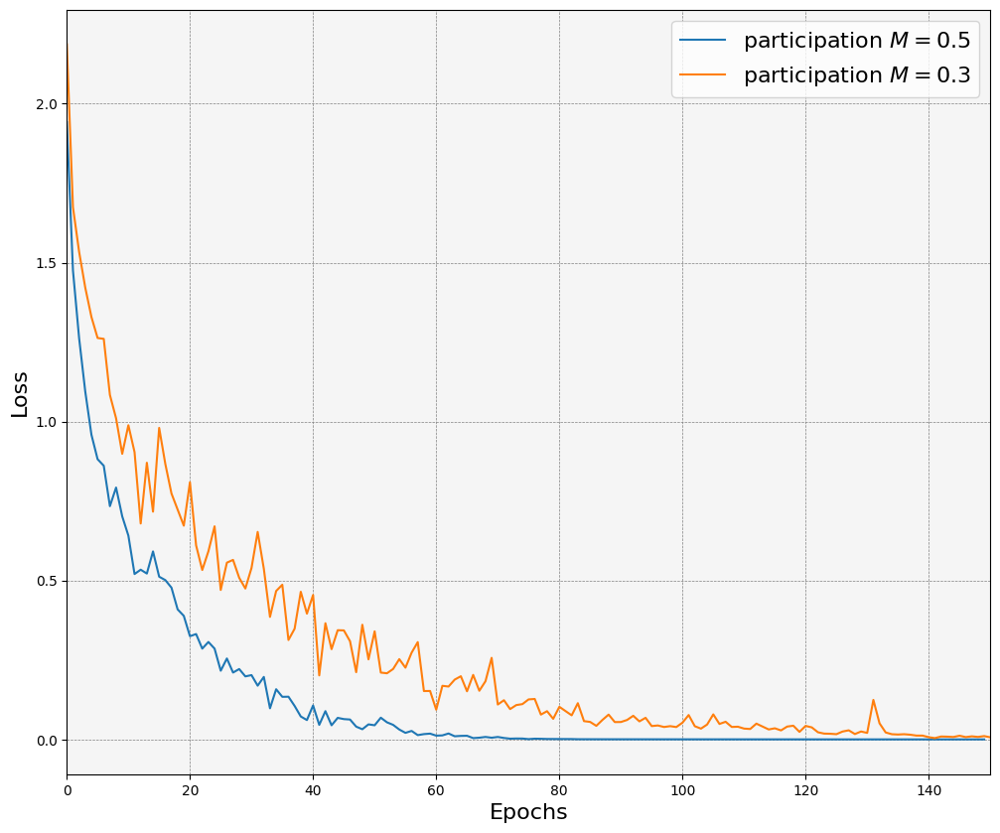

In [73]:
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(get_average_loss(colab_5), label=r"participation $M=0.5$")
ax.plot(get_average_loss(participation_30), label=r"participation $M=0.3$")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, 150)
ax.legend(fontsize=16)
plt.show()

Federated Multi-task learning in low-resource domains

## Dropout Sequential

In [74]:
nodropout = copy.deepcopy(Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_pkl)
withdropout = copy.deepcopy(Ordered_1localepoch_10server_epochs_at_each_global_round_lr__0_00001_server_avg__30_participation_SeqFL_dropout_layer_pkl)

### Accuracy

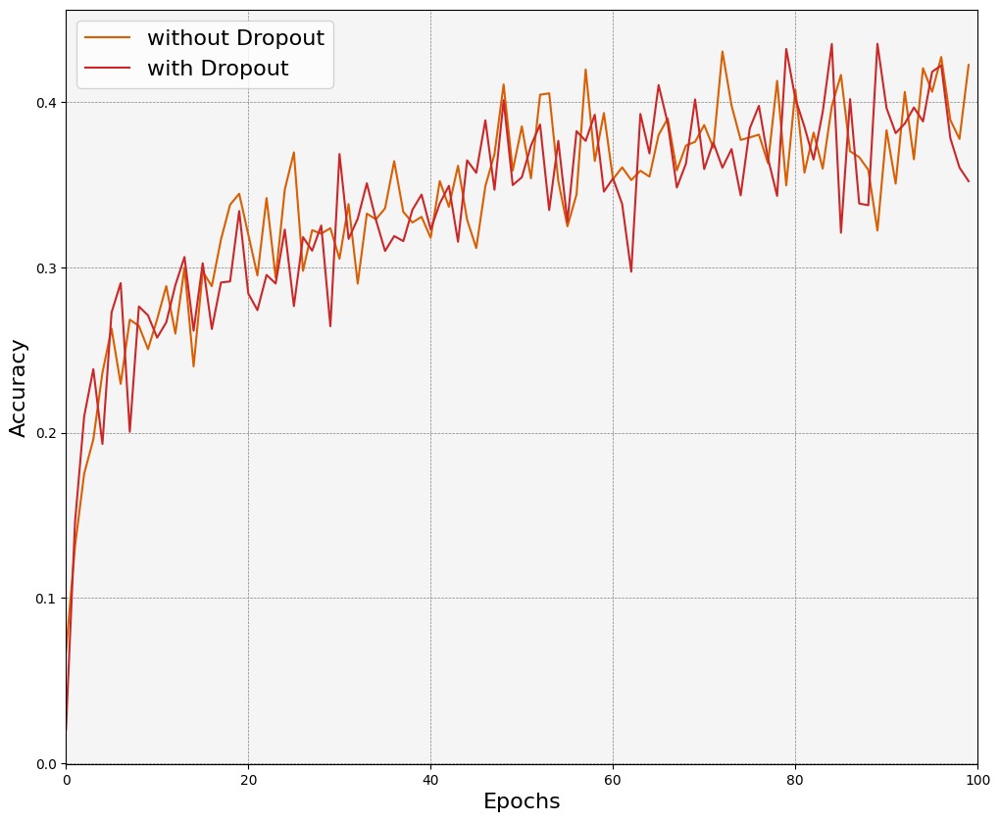

In [75]:
nodropout_global_acc =  get_average_global_accuracy_with_no_dict(nodropout)[:100]
withdropout_global_acc = get_average_global_accuracy_with_no_dict(withdropout)[:100]
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(nodropout_global_acc, label=r"without Dropout", color=colors["orange"])
ax.plot(withdropout_global_acc, label=r"with Dropout", color=colors["red"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.set_xlim(0, 100)
ax.legend(fontsize=16)

### Loss

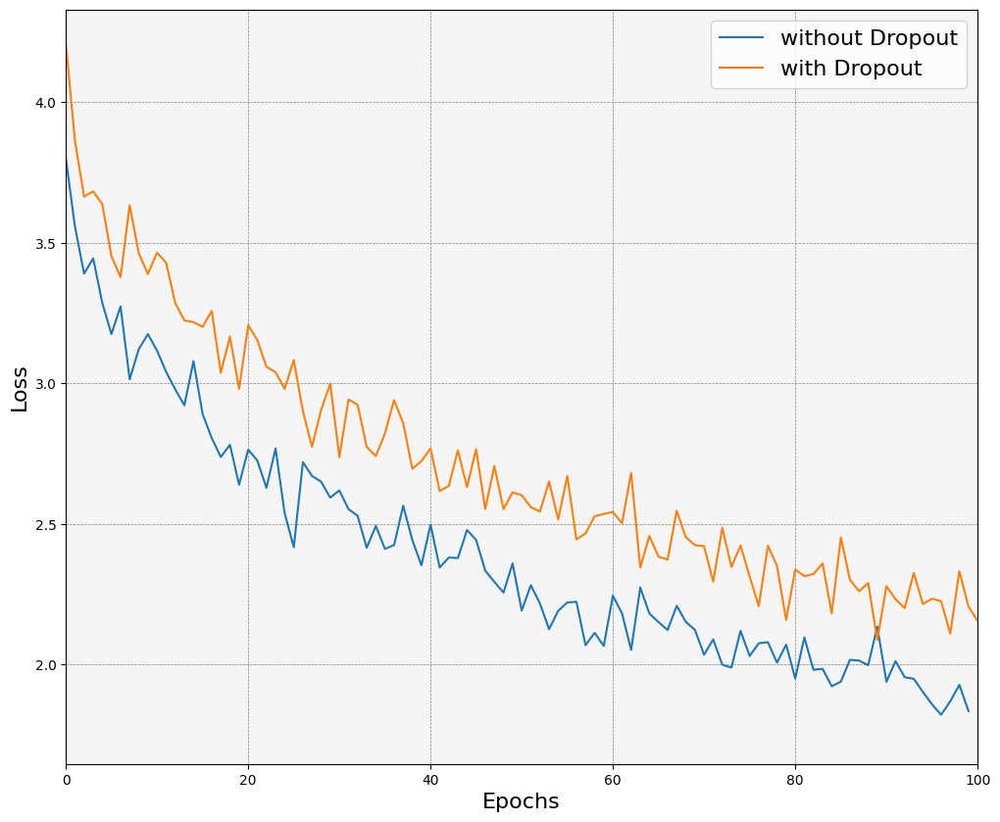

In [76]:
nodropout_loss = get_average_loss(nodropout)
withdropout_loss = get_average_loss(withdropout)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(nodropout_loss, label=r"without Dropout")
ax.plot(withdropout_loss, label=r"with Dropout")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, min(len(nodropout_loss), len(withdropout_loss)))
ax.legend(fontsize=16)
plt.show()

## 30% vs 50% in particiation between 5 Local epochs 10 server, lr 0.00001

In [77]:
participation_30_5local = copy.deepcopy(ordered_5local_10server_0_00001_30partiipation)
sahar_50participation = copy.deepcopy(ordered_5local_10server_lr_0_00001_50participation)

### Accuracy

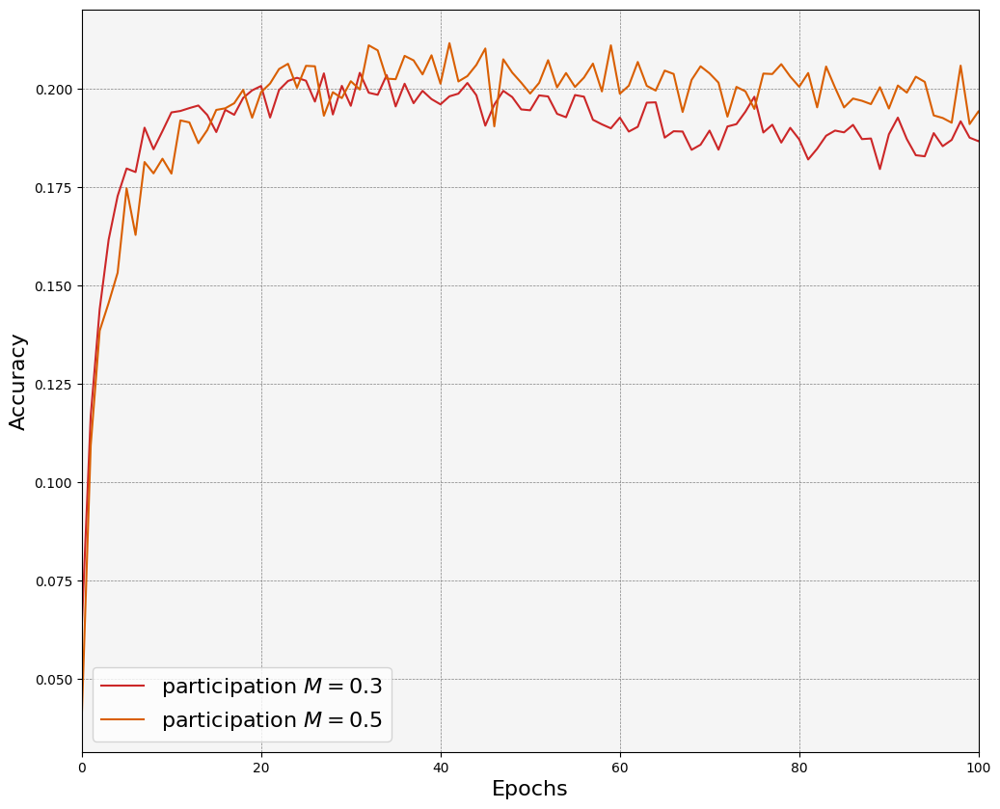

In [78]:
participation_30_5local_global_acc =  get_average_global_accuracy_with_no_dict(participation_30_5local)
sahar_50participation_global_acc = get_average_global_accuracy_with_no_dict(sahar_50participation)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(sahar_50participation_global_acc, label=r"participation $M=0.3$", color=colors["red"])
ax.plot(participation_30_5local_global_acc, label=r"participation $M=0.5$", color=colors["orange"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.set_xlim(0, 100)
ax.legend(fontsize=16)

### Loss

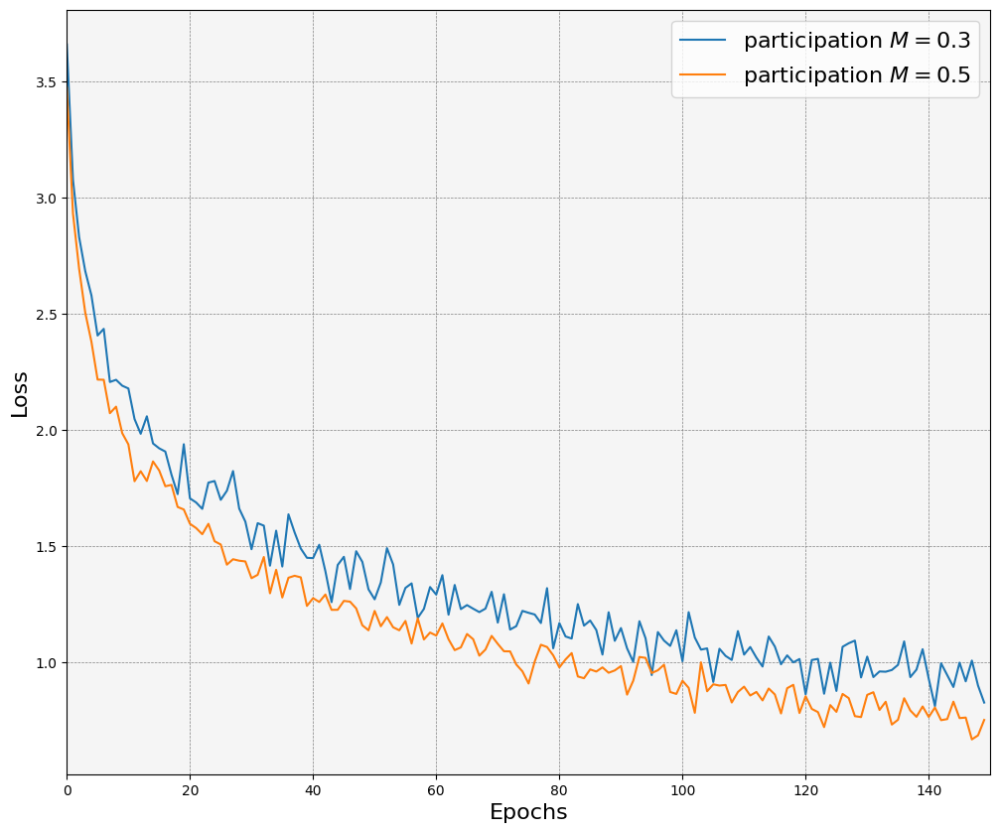

In [79]:
participation_30_5local_loss = get_average_loss(participation_30_5local)
sahar_50participation_loss = get_average_loss(sahar_50participation)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(participation_30_5local_loss, label=r"participation $M=0.3$")
ax.plot(sahar_50participation_loss, label=r"participation $M=0.5$")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, min(len(participation_30_5local_loss), len(sahar_50participation_loss)))
ax.legend(fontsize=16)
plt.show()

# Clustered

## Number of datasets

In [80]:
nopath = copy.deepcopy(nopathmnist_Localepochs5_server_10_participation_30reordering_decreasinglronce_lrafter00001)
oct_and_organa = copy.deepcopy(oct_organa_ocalepochs5_server_10_par30_reordering_decreasinglronce_lrafter00001)
all_datasets = copy.deepcopy(ordered_5local_10server_0_00001_30partiipation)

### Accuracy

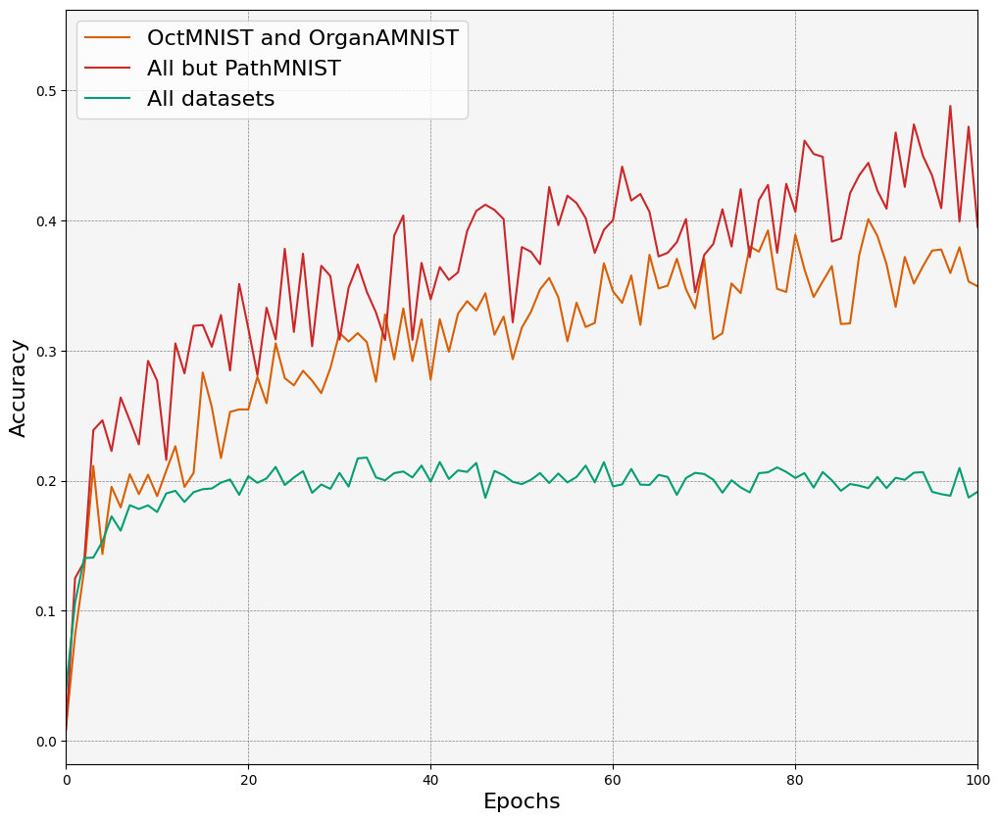

In [81]:
nopath_local_global_acc =  get_average_global_accuracy_with_no_dict(nopath)
oct_and_organa_global_acc = get_average_global_accuracy_with_no_dict(oct_and_organa)
all_datasets_global_acc = get_average_global_accuracy_with_no_dict(all_datasets)
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(oct_and_organa_global_acc, label=r"OctMNIST and OrganAMNIST", color=colors["orange"])
ax.plot(nopath_local_global_acc, label=r"All but PathMNIST", color=colors["red"])
ax.plot(hamza_global_acc, label=r"All datasets", color=colors["green"])
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Accuracy", fontsize=16)
ax.set_xlim(0, 100)
ax.legend(fontsize=16)

### Loss

In [83]:
# def get_average_loss_others(si):
    # return si.clients_average_losses
# print(get_average_loss_others(nopath))
# print(get_average_loss_others(oct_and_organa))
# print(get_average_loss_others(all_datasets))

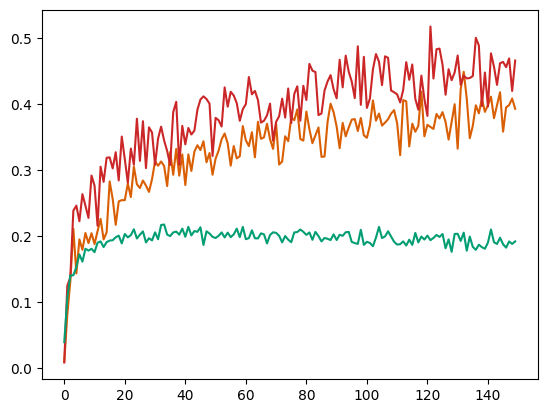

In [84]:
# ='gray', linestyle='dashed', linewidth=0.5)
fig, ax = plt.subplots()
ax.plot(oct_and_organa_global_acc[:150], label=r"OctMNIST and OrganAMNIST", color=colors["orange"])
ax.plot(nopath_local_global_acc[:150], label=r"All but PathMNIST", color=colors["red"])
ax.plot(hamza_global_acc[:150], label=r"All datasets", color=colors["green"])
plt.show()

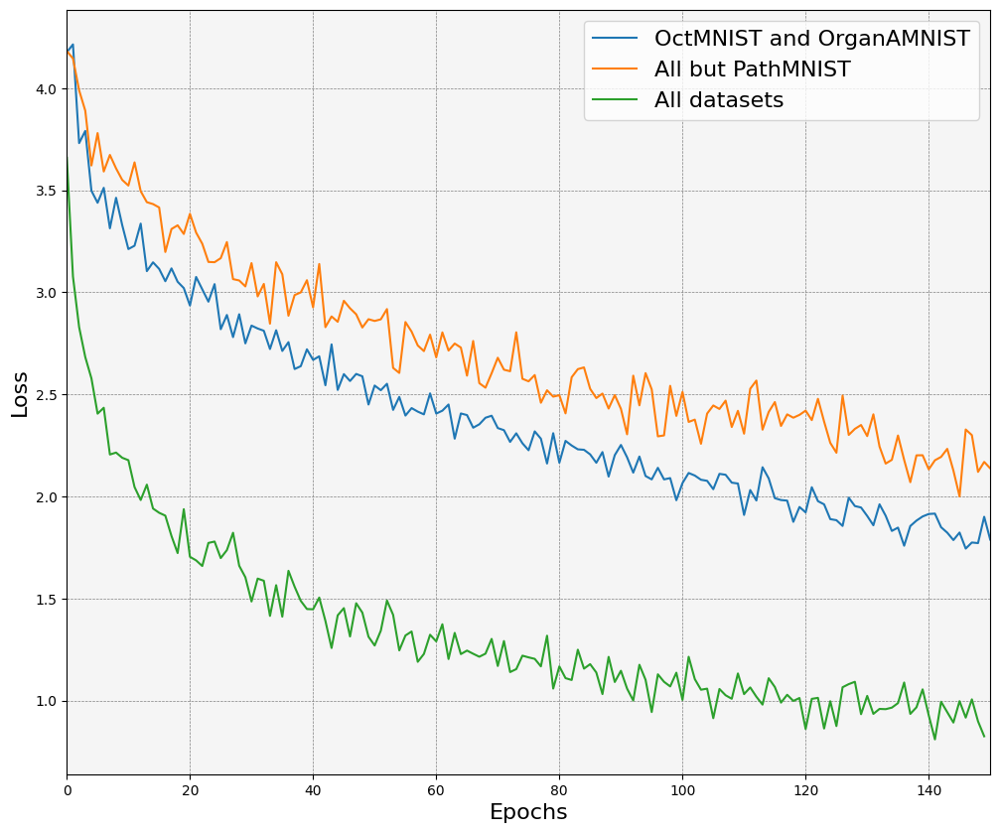

In [85]:
nopath_loss = nopath.get_average("loss")
oct_and_organa_loss = oct_and_organa.get_average("loss")
all_datasets_loss = all_datasets.get_average("loss")
fig , ax = plt.subplots(figsize=(12, 10))
ax.set_facecolor((0.96, 0.96, 0.96))
ax.grid(True, color='gray', linestyle='dashed', linewidth=0.5)
ax.plot(nopath_loss, label=r"OctMNIST and OrganAMNIST")
ax.plot(oct_and_organa_loss, label=r"All but PathMNIST")
ax.plot(get_average_loss(hamza), label=r"All datasets")
ax.set_xlabel("Epochs", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_xlim(0, min(len(participation_30_5local_loss), len(sahar_50participation_loss)))
ax.legend(fontsize=16)
plt.show()